In [1]:
import numpy as np
import tensorflow as tf
import sklearn.pipeline
import sklearn.preprocessing
import matplotlib.pyplot as plt

from sklearn.kernel_approximation import RBFSampler

def sampler(range_pos,range_vel,n_samples):
    
    position = (np.max(range_pos)-np.min(range_pos))*np.random.rand(n_samples) - np.min(range_pos)
    velocity = (np.max(range_vel)-np.min(range_vel))*np.random.rand(n_samples) - np.min(range_vel)
    
    samples = [position,velocity]
    
    return np.asarray(samples).T


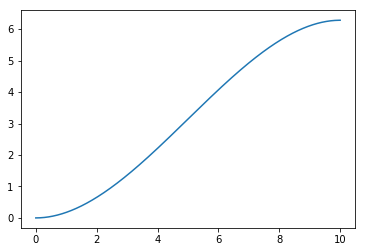

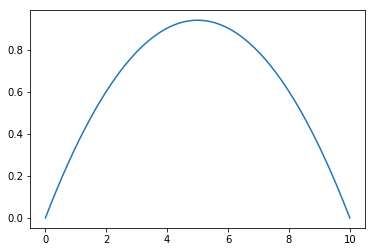

In [2]:
#TIME
T=10
steps = 1000
time = np.linspace(0,T,steps)
step_size = T/steps

#Timing Law

def s(t): return -4*np.pi*(t/T)**3 + 6*np.pi*(t/T)**2
def s_dot(t): return (-12*np.pi*(t/T)**2 + 12*np.pi*t/T)/T
def s_2dot(t): return (-24*np.pi*t/T + 12*np.pi)/(T**2)

#Path
def q_d(t): return np.array([s(t)])
def q_d_dot(t): return np.array([s_dot(t)])


plt.plot(time,q_d(time).reshape(np.shape(time)))
plt.show()
plt.plot(time,q_d_dot(time).reshape(np.shape(time)))
plt.show()

In [3]:
#Dynamic Parameters
m = 5
g0 = 0.981
I = 0.025

In [4]:
range_position_error = [-0.15,0.15]
range_velocity_error = [-0.3,0.3]

observation = sampler(range_position_error,range_velocity_error,100000)

scaler = sklearn.preprocessing.StandardScaler()

scaler.fit(observation)

featurizer = sklearn.pipeline.FeatureUnion([
        ("rbf1", RBFSampler(gamma=5.0, n_components=100)),
        ("rbf2", RBFSampler(gamma=2.0, n_components=100)),
        ("rbf3", RBFSampler(gamma=1.0, n_components=100)),
        ("rbf4", RBFSampler(gamma=0.5, n_components=100))
        ])

featurizer.fit(scaler.transform(observation))

FeatureUnion(n_jobs=1,
       transformer_list=[('rbf1', RBFSampler(gamma=5.0, n_components=100, random_state=None)), ('rbf2', RBFSampler(gamma=2.0, n_components=100, random_state=None)), ('rbf3', RBFSampler(gamma=1.0, n_components=100, random_state=None)), ('rbf4', RBFSampler(gamma=0.5, n_components=100, random_state=None))],
       transformer_weights=None)

In [5]:
def featurize_state(state):
    """
    Returns the featurized representation for a state.
    """
    scaled = scaler.transform([state])
    featurized = featurizer.transform(scaled)
    return featurized[0]

In [6]:
class ValueEstimator():
    
    def __init__(self,learning_rate=0.01,scope="value_estimator"):
        
        with tf.variable_scope(scope):
            self.state=tf.placeholder(tf.float32,[400],"state")
            self.target=tf.placeholder(dtype=tf.float32,name="target")
            
            self.outlayer = tf.contrib.layers.fully_connected(
                inputs=tf.expand_dims(self.state, 0),
                num_outputs=1,
                activation_fn=None,
                weights_initializer=tf.contrib.layers.xavier_initializer())
            
            self.value_estimate = tf.squeeze(self.outlayer)
            self.loss = tf.squared_difference(self.value_estimate,self.target)
            
            self.optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
            self.train_op = self.optimizer.minimize(
                self.loss, global_step=tf.contrib.framework.get_global_step())        
    
    def predict(self, state, sess=None):
        sess = sess or tf.get_default_session()
        state = featurize_state(state)
        return sess.run(self.value_estimate, { self.state: state })

    def update(self, state, target, sess=None):
        sess = sess or tf.get_default_session()
        state = featurize_state(state)
        feed_dict = { self.state: state, self.target: target }
        _, loss = sess.run([self.train_op, self.loss], feed_dict)
        return loss




In [7]:
class PolicyEstimator():
        
        def __init__(self, learning_rate=0.01, scope="policy_estimator"):
            with tf.variable_scope(scope):
                self.state = tf.placeholder(tf.float32, [400], "state")
                self.target = tf.placeholder(dtype=tf.float32, name="target")

                # This is just linear classifier
                self.mu = tf.contrib.layers.fully_connected(
                    inputs=tf.expand_dims(self.state, 0),
                    num_outputs=1,
                    activation_fn=None,
                    weights_initializer=tf.zeros_initializer)
                self.mu = tf.squeeze(self.mu)
            
                self.sigma = tf.contrib.layers.fully_connected(
                    inputs=tf.expand_dims(self.state, 0),
                    num_outputs=1,
                    activation_fn=None,
                    weights_initializer=tf.zeros_initializer)
            
                self.sigma = tf.squeeze(self.sigma)
                self.sigma = tf.nn.softplus(self.sigma) + 1e-5
                self.normal_dist = tf.contrib.distributions.Normal(self.mu, self.sigma)
                self.action = self.normal_dist._sample_n(1)
             #   print("ACTION SELF: " + str(self.action))
                self.action = tf.clip_by_value(self.action,-1, 1)

                # Loss and train op
                self.loss = -self.normal_dist.log_prob(self.action) * self.target
                # Add cross entropy cost to encourage exploration
                self.loss -= 1e-2 * self.normal_dist.entropy()
            
                self.optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
                self.train_op = self.optimizer.minimize(
                    self.loss, global_step=tf.contrib.framework.get_global_step())
    
        def predict(self, state, sess=None):
            sess = sess or tf.get_default_session()
            state = featurize_state(state)
            return sess.run(self.action, { self.state: state })

        def update(self, state, target, action, sess=None):
            sess = sess or tf.get_default_session()
            state = featurize_state(state)
            feed_dict = { self.state: state, self.target: target, self.action: action  }
            _, loss = sess.run([self.train_op, self.loss], feed_dict)
            return loss

In [8]:
class Robot():
    
    def __init__(self,position,velocity,Kp,Kd):
        
        self.q = 0
        self.q_dot = 0

        self.Kp = Kp
        self.Kd = Kd
        
    def reward(self,t):
        
        err = q_d(t)-self.q
        err_vel = q_d_dot(t)- self.q_dot
        
        return np.exp(-np.abs(err)) + np.exp(-np.abs(err_vel))
        
    def transition(self,u,t):
    
        q_ddot = (1/I)*u - m*g0*np.sin(self.q)
    
        self.q += (self.q_dot*step_size + ( q_ddot*step_size**2) /2)
        self.q_dot += step_size*q_ddot

        return np.asarray([self.q,self.q_dot]).reshape(2),self.reward(t)
    
    def reset(self):
        self.q = q_d(0)
        self.q_dot = q_d_dot(0)
        
    def state(self):
        
        return np.asarray([self.q,self.q_dot]).reshape(2)
    
    def PD(self,t): 
        
        return self.Kp*(q_d(t)-self.q) + self.Kd*(q_d_dot(t) - self.q_dot)

In [9]:
def run(Kp,Kd,pendolum,value_estimator,policy_estimator,num_episodes,discout_factor=0.99):
    
    episodes_total_reward = []
    
    for episode in range(num_episodes):
        
        positions = []
        torque_PD = []
        torque_AC = []
        
        reward_episode = 0
        
        pendolum.reset()
        total_loss_value = 0
        total_loss_policy = 0
        for t_step in enumerate(time):
            
            t = t_step[1]
            
            state = pendolum.state()
            
            state = np.asarray([q_d(t),q_d_dot(t)]).reshape(2) - state
            
            u_nn = policy_estimator.predict(state)
            
            u_pd = pendolum.PD(t)
            
            action = u_nn 
            
            u =  action + u_pd

            next_state,reward = pendolum.transition(u,t)
            
            reward_episode += reward
            
            positions.append(next_state[0])
            
            torque_PD.append(u_pd)
            
            torque_AC.append(u_nn)
            
            next_state = np.asarray([q_d(t+step_size),q_d_dot(t+step_size)]).reshape(2) - next_state
            
            td_target = reward + discout_factor*value_estimator.predict(next_state)
            
            advantage = td_target - value_estimator.predict(state)
            
            total_loss_value += value_estimator.update(state,td_target)
            
            print("\rEPISODE {} STATE {} REWARD  {} ACTION ({})".format(episode+1,next_state, reward, u), end=" ")
                
            total_loss_policy += policy_estimator.update(state,advantage,action)
                
            
        
        #Plot Trajectory and Robot
        plt.figure(1)
        plt.title("Trajectory")
        plt.plot(time,positions,color='red')
        plt.plot(time,q_d(time).reshape(np.shape(time)),color='blue')
        plt.show()
        #Plot torque behaviour
        plt.figure(2)
        plt.title("Torque")
        plt.plot(time,torque_PD,color='red')
        plt.plot(time,torque_AC,color='blue')
        plt.show()
        print("Value Loss : " + str(total_loss_value))
        print("Policy Loss : " + str(total_loss_policy))
        episodes_total_reward.append(reward_episode)
    
    # Plot Total reward for episode
    plt.plot(np.linspace(1,num_episodes,num_episodes),episodes_total_reward)
    plt.show()
    return np.asarray(episodes_total_reward)
           

EPISODE 1 STATE [-0.01670986 -0.31608239] REWARD  [ 1.71520312] ACTION ([-0.38188104]) 160069])         

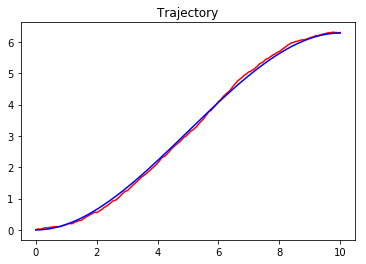

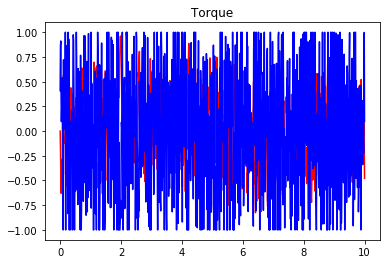

Value Loss : [ 4862.16308594]
Policy Loss : [ 1101.39404297]
EPISODE 2 STATE [-0.03940178 -0.19411883] REWARD  [ 1.78805627] ACTION ([-0.03776707]) 3305195])       

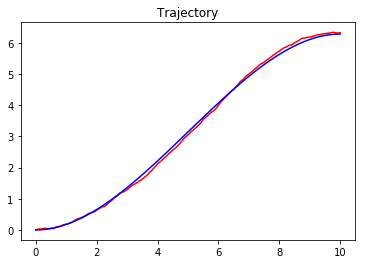

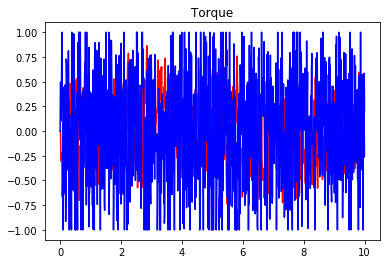

Value Loss : [ 7249.953125]
Policy Loss : [ 513.684021]
EPISODE 3 STATE [-0.00429244 -0.05010299] REWARD  [ 1.95046305] ACTION ([-1.50858436]) 639693])   

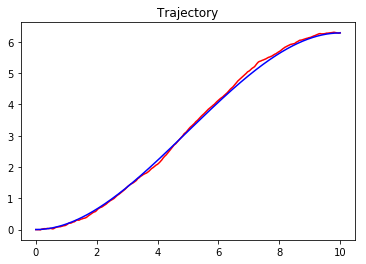

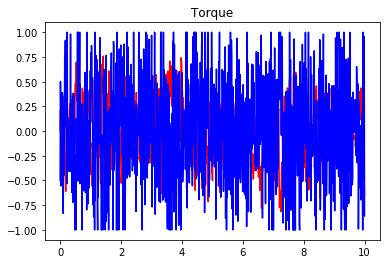

Value Loss : [ 8443.69628906]
Policy Loss : [ 103.94186401]
EPISODE 4 STATE [-0.09210663  0.21323744] REWARD  [ 1.71694612] ACTION ([ 0.2169339])              

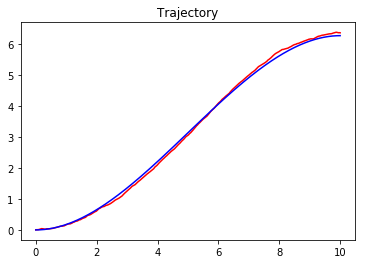

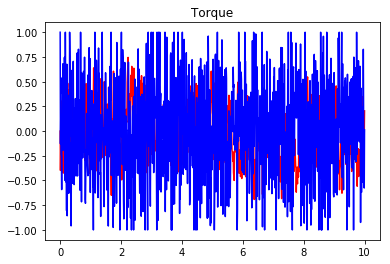

Value Loss : [ 5185.72607422]
Policy Loss : [-14.18287563]
EPISODE 5 STATE [-0.06306746  0.04253376] REWARD  [ 1.89364623] ACTION ([-0.86789107]) 8294965])      

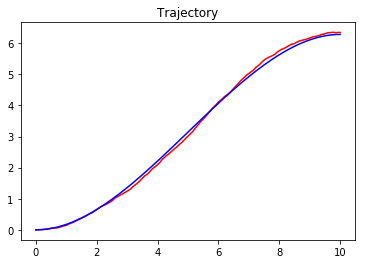

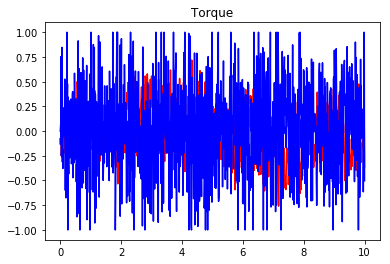

Value Loss : [ 4159.40283203]
Policy Loss : [-163.22943115]
EPISODE 6 STATE [-0.0412211   0.19931195] REWARD  [ 1.77584338] ACTION ([ 0.09659735]) 2700807])   

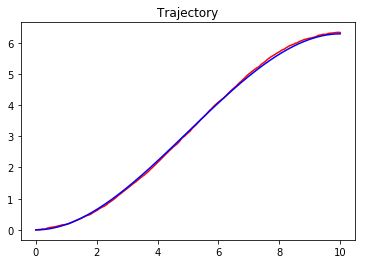

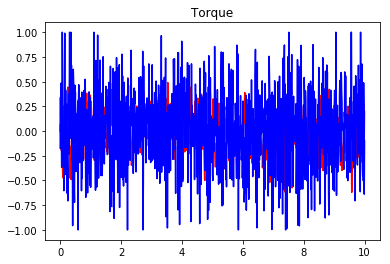

Value Loss : [ 2381.7746582]
Policy Loss : [-180.70718384]
EPISODE 7 STATE [-0.04282003  0.11705832] REWARD  [ 1.8442847] ACTION ([-0.4615301]) ) 6515706])      

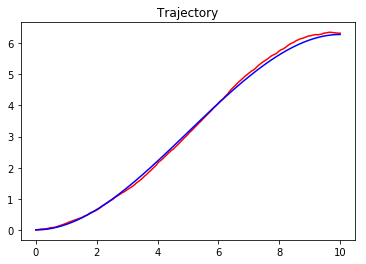

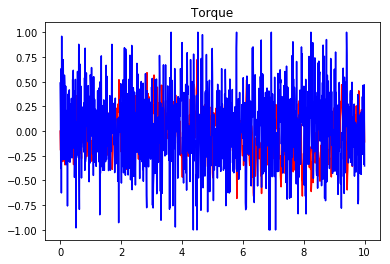

Value Loss : [ 5199.62402344]
Policy Loss : [-485.66043091]
EPISODE 8 STATE [-0.03522786  0.03541643] REWARD  [ 1.92697152] ACTION ([ 0.08629552]) 1261479])       

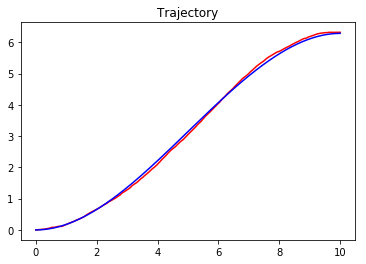

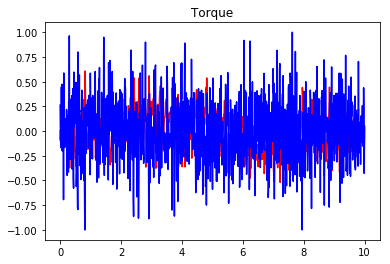

Value Loss : [ 3010.1340332]
Policy Loss : [-472.29129028]
EPISODE 9 STATE [-0.00806605 -0.02504396] REWARD  [ 1.97093944] ACTION ([-0.00270739]) 7846389])           

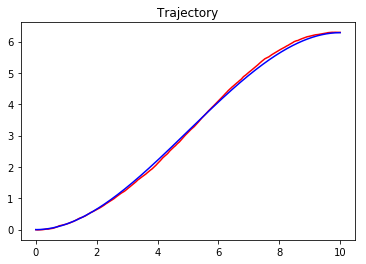

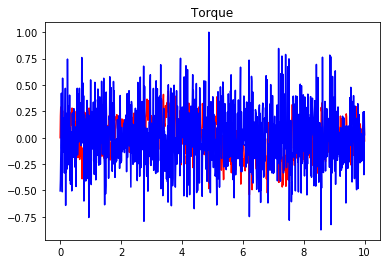

Value Loss : [ 1518.04699707]
Policy Loss : [-370.9229126]
EPISODE 10 STATE [-0.02041002 -0.04410773] REWARD  [ 1.94028388] ACTION ([ 0.21209232]) 05]) 58])              

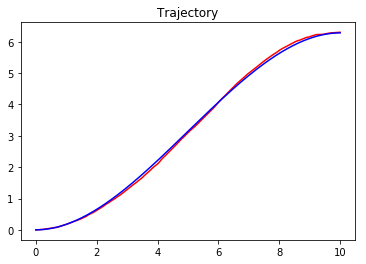

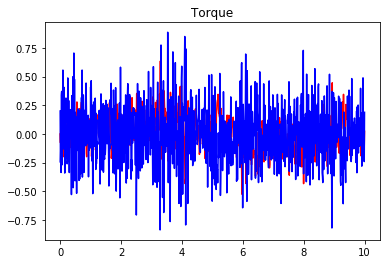

Value Loss : [ 1447.94384766]
Policy Loss : [-364.61392212]
EPISODE 11 STATE [-0.03268224 -0.14504668] REWARD  [ 1.83611656] ACTION ([ 0.12586394]) 7931071])  

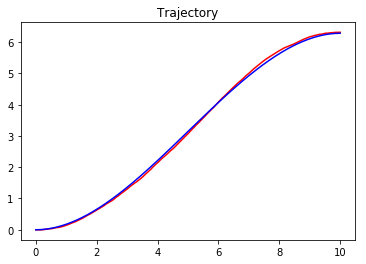

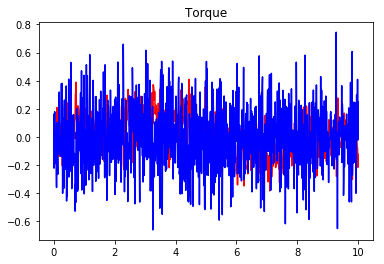

Value Loss : [ 560.80151367]
Policy Loss : [-259.00640869]
EPISODE 12 STATE [-0.02835053  0.10504114] REWARD  [ 1.86896239] ACTION ([-0.23166615]) 817238])            

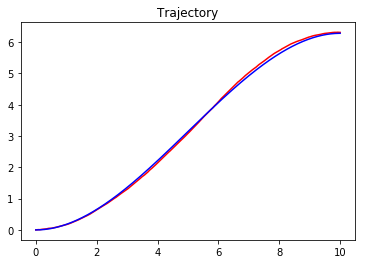

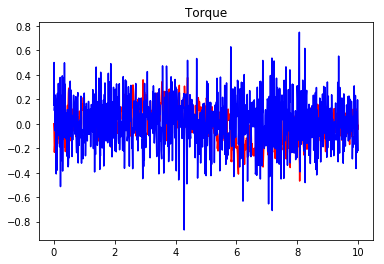

Value Loss : [ 561.77905273]
Policy Loss : [-199.97080994]
EPISODE 13 STATE [-0.0462454   0.01617198] REWARD  [ 1.93507757] ACTION ([-0.00353321]) 05]) 61])      

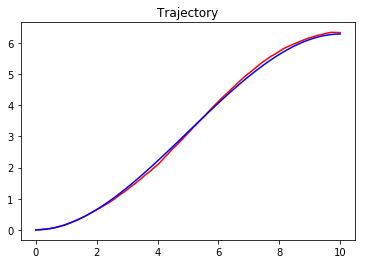

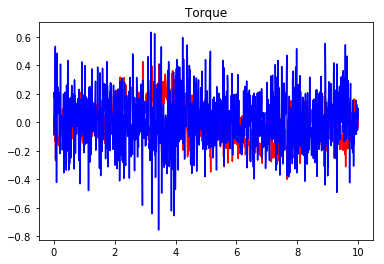

Value Loss : [ 631.73504639]
Policy Loss : [-237.78631592]
EPISODE 14 STATE [-0.01714188  0.15969566] REWARD  [ 1.83221528] ACTION ([-0.27614821]) 8015707])           

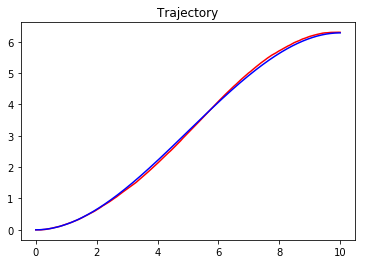

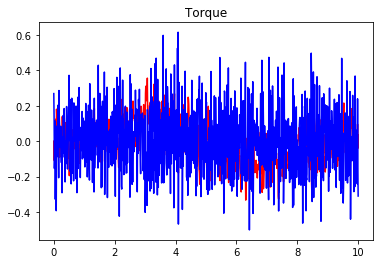

Value Loss : [ 243.01670837]
Policy Loss : [-80.7335434]
EPISODE 15 STATE [-0.0454808 -0.0882145] REWARD  [ 1.87458202] ACTION ([ 0.23247227]) ) 8791545])        

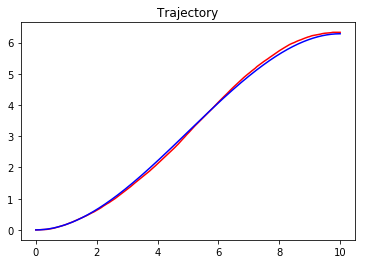

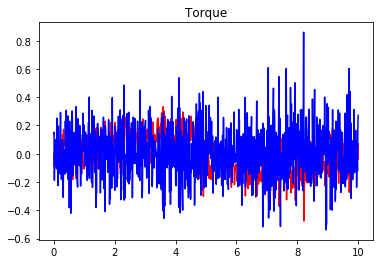

Value Loss : [ 506.34136963]
Policy Loss : [-255.06112671]
EPISODE 16 STATE [-0.037821    0.02345777] REWARD  [ 1.93603942] ACTION ([ 0.03993277]) 3334525])        

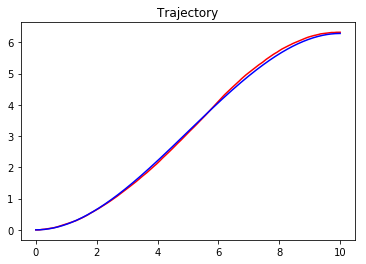

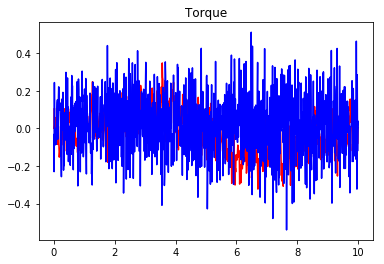

Value Loss : [ 212.28572083]
Policy Loss : [-70.90827179]
EPISODE 17 STATE [-0.0314926   0.03802218] REWARD  [ 1.92808195] ACTION ([ 0.16771448]) 7245424])        

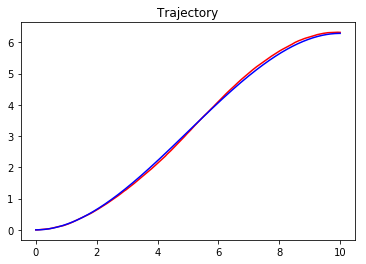

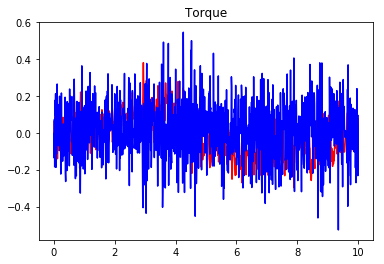

Value Loss : [ 192.41520691]
Policy Loss : [-71.28353882]
EPISODE 18 STATE [-0.0553353  -0.01988673] REWARD  [ 1.93020177] ACTION ([ 0.04393456]) 8827434])                  

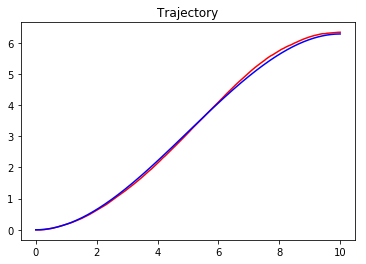

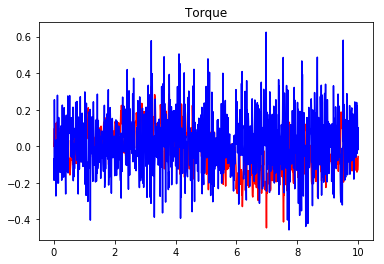

Value Loss : [ 370.0758667]
Policy Loss : [-150.53329468]
EPISODE 19 STATE [-0.0359092   0.00093868] REWARD  [ 1.96004481] ACTION ([-0.06606064]) 3072877])          

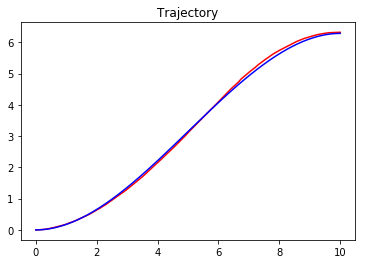

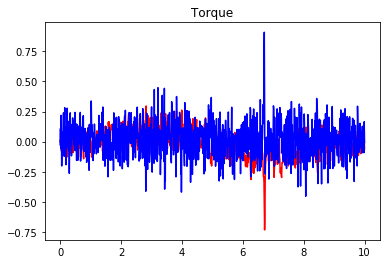

Value Loss : [ 1155.87255859]
Policy Loss : [-266.5803833]
EPISODE 20 STATE [-0.04422263 -0.00798024] REWARD  [ 1.95256126] ACTION ([ 0.34272437]) 7988124])            

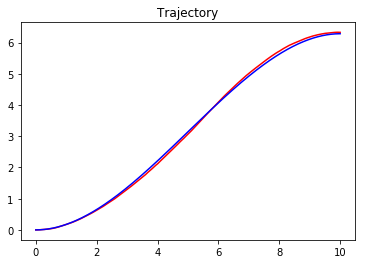

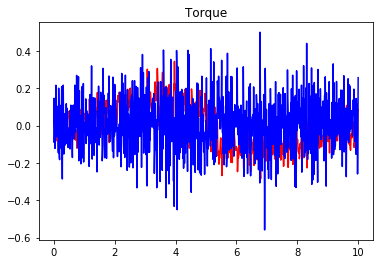

Value Loss : [ 130.16157532]
Policy Loss : [-68.09506989]
EPISODE 21 STATE [-0.03621271  0.01625409] REWARD  [ 1.94462477] ACTION ([-0.11070946]) 3820984])                   

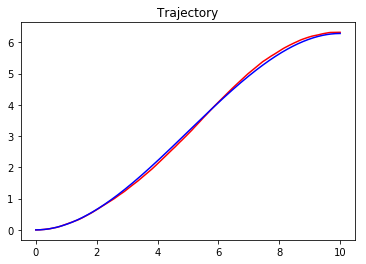

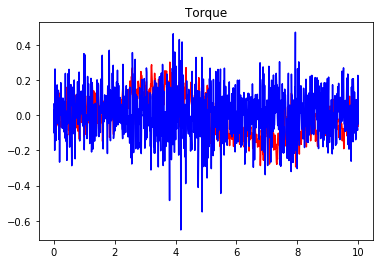

Value Loss : [ 191.30877686]
Policy Loss : [-84.42539215]
EPISODE 22 STATE [-0.03812739  0.0695046 ] REWARD  [ 1.89195065] ACTION ([-0.05687315]) 5212435])              

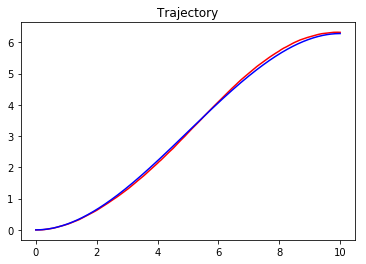

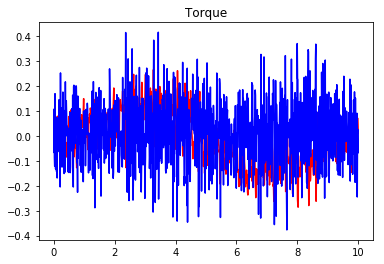

Value Loss : [ 153.35437012]
Policy Loss : [-51.60478592]
EPISODE 23 STATE [-0.02843674 -0.05455161] REWARD  [ 1.92247184] ACTION ([ 0.13622793]) 0755015])            

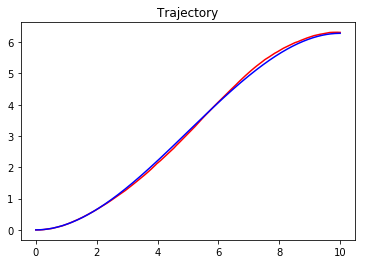

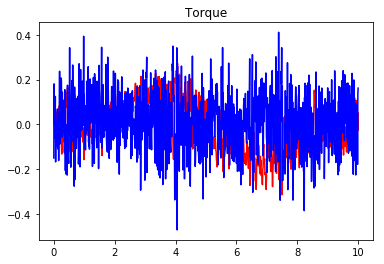

Value Loss : [ 178.44126892]
Policy Loss : [-56.96252823]
EPISODE 24 STATE [-0.03056199 -0.0913445 ] REWARD  [ 1.88607259] ACTION ([-0.10533351]) 8139549])             

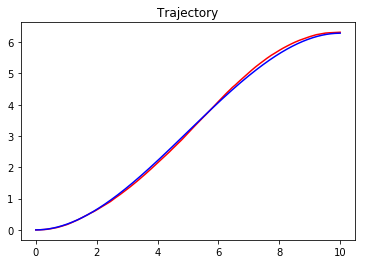

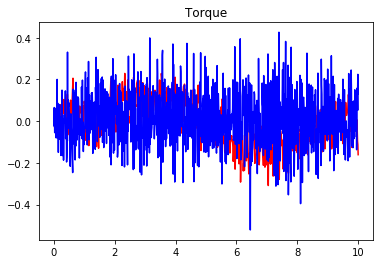

Value Loss : [ 187.87611389]
Policy Loss : [-27.90784645]
EPISODE 25 STATE [-0.04013576  0.12129114] REWARD  [ 1.84311683] ACTION ([-0.14380864])                       

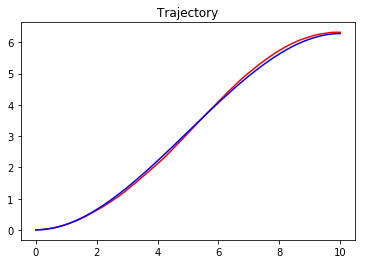

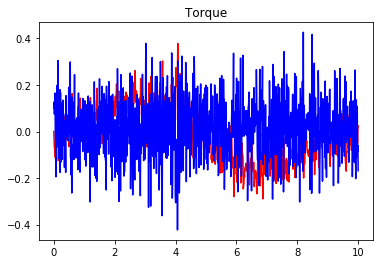

Value Loss : [ 161.68983459]
Policy Loss : [-80.048172]
EPISODE 26 STATE [-0.03943357 -0.03658871] REWARD  [ 1.92906948] ACTION ([ 0.03848061]) 3978563])                

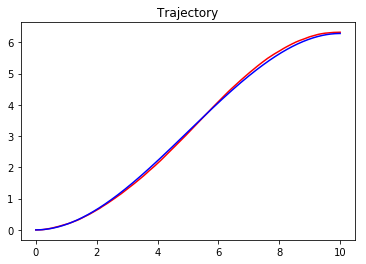

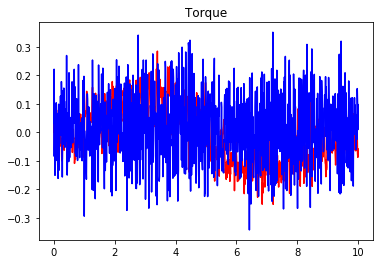

Value Loss : [ 97.15309143]
Policy Loss : [-20.8065834]
EPISODE 27 STATE [-0.04768488 -0.00170901] REWARD  [ 1.95138962] ACTION ([-0.03492349]) 0265979])                 

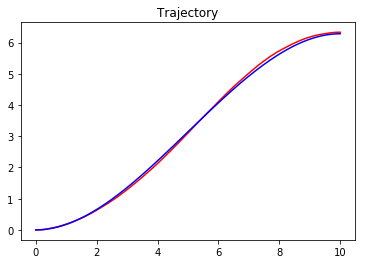

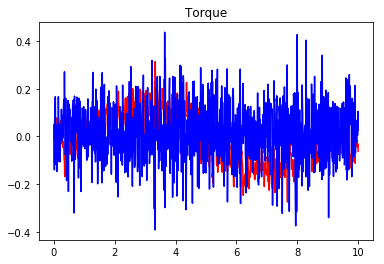

Value Loss : [ 110.47899628]
Policy Loss : [-26.73728561]
EPISODE 28 STATE [-0.0361177   0.03314212] REWARD  [ 1.92830224] ACTION ([ 0.07239836])               

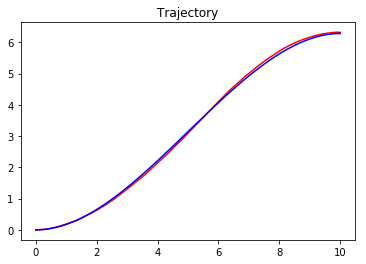

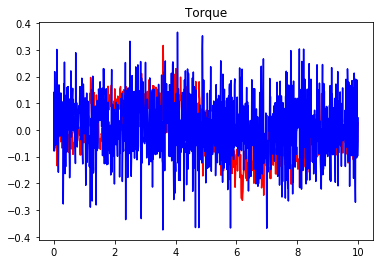

Value Loss : [ 61.38102341]
Policy Loss : [-19.48507118]
EPISODE 29 STATE [-0.03906888 -0.03453163] REWARD  [ 1.93141287] ACTION ([ 0.13827909]) 5794179])                   

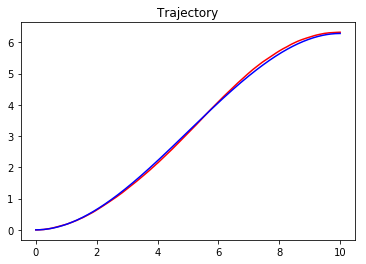

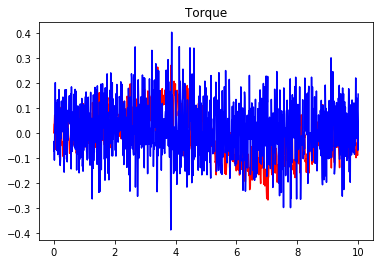

Value Loss : [ 65.8112793]
Policy Loss : [-5.06667614]
EPISODE 30 STATE [-0.02764175 -0.04625796] REWARD  [ 1.93116067] ACTION ([ 0.11536578]) 2273862])                 

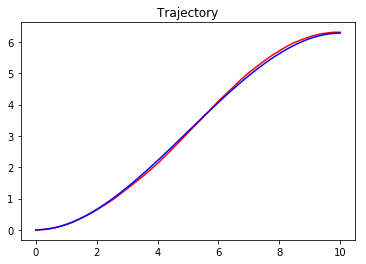

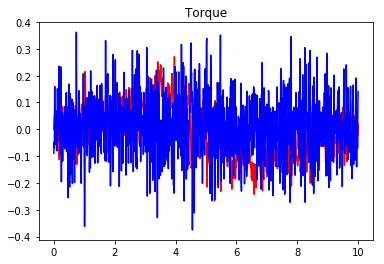

Value Loss : [ 63.20554733]
Policy Loss : [-15.26590347]
EPISODE 31 STATE [-0.03137475 -0.02921907] REWARD  [ 1.94400623] ACTION ([ 0.05960203]) 6281345])             

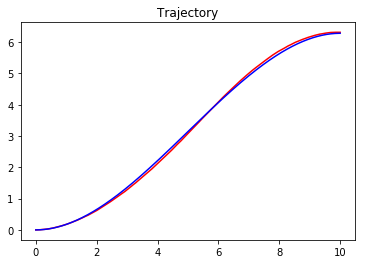

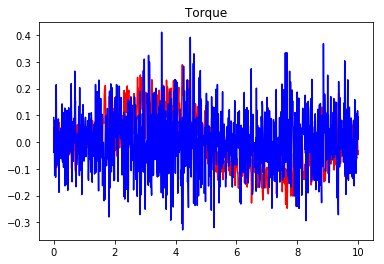

Value Loss : [ 85.06635284]
Policy Loss : [-38.18232727]
EPISODE 32 STATE [-0.03604287  0.07049445] REWARD  [ 1.89303986] ACTION ([-0.08888172]) 3014393])             

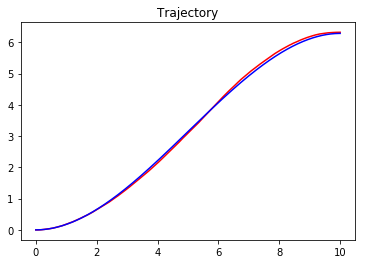

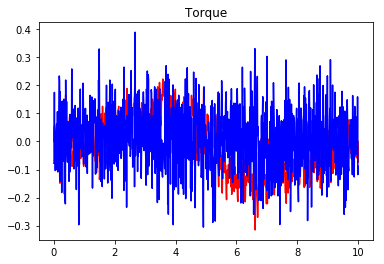

Value Loss : [ 80.77532196]
Policy Loss : [-22.11301994]
EPISODE 33 STATE [-0.03841519  0.0384623 ] REWARD  [ 1.92097499] ACTION ([-0.1555238])  05]) 39])               

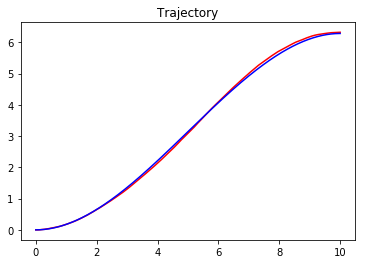

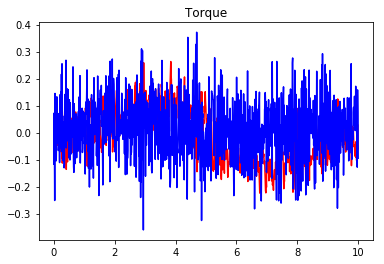

Value Loss : [ 54.80810165]
Policy Loss : [-15.23743629]
EPISODE 34 STATE [-0.03895515 -0.04124921] REWARD  [ 1.92502997] ACTION ([ 0.06926566]) 05]) 1])                 

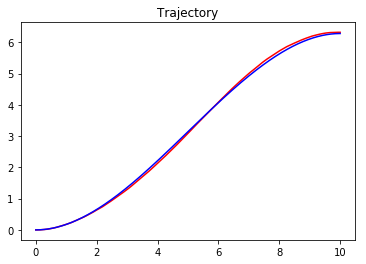

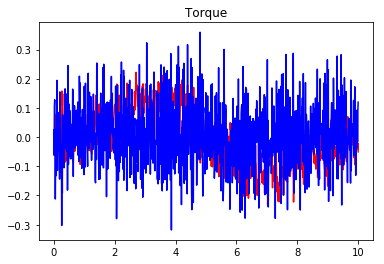

Value Loss : [ 50.50538254]
Policy Loss : [ 2.00750184]
EPISODE 35 STATE [-0.03163926 -0.02459424] REWARD  [ 1.94826898] ACTION ([ 0.13591721]) 5])  31])                   

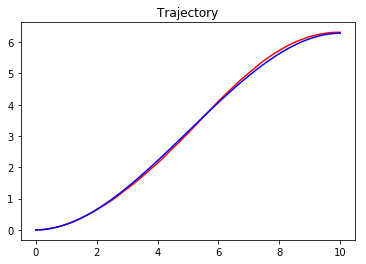

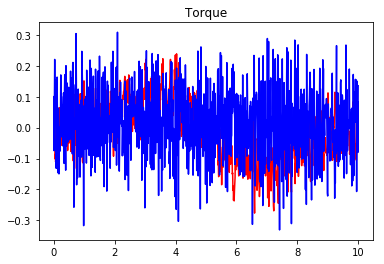

Value Loss : [ 75.32391357]
Policy Loss : [-28.17774582]
EPISODE 36 STATE [-0.03742242 -0.0150876 ] REWARD  [ 1.95203716] ACTION ([-0.07254635]) 05]) 89])                   

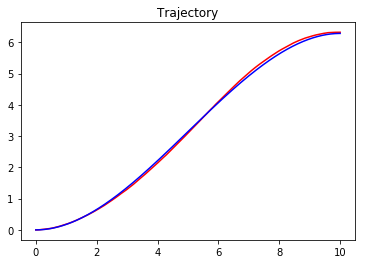

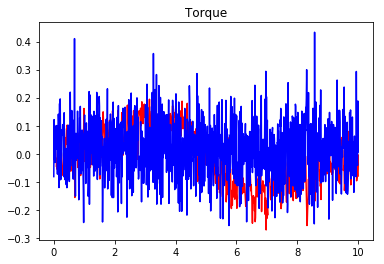

Value Loss : [ 69.05532074]
Policy Loss : [-32.43816376]
EPISODE 37 STATE [-0.04086098  0.01244782] REWARD  [ 1.94389004] ACTION ([ 0.03820136]) 2145881])           

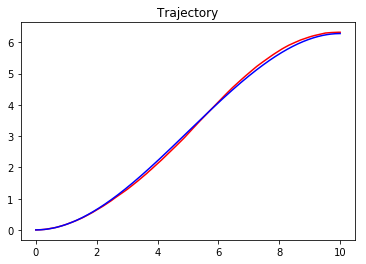

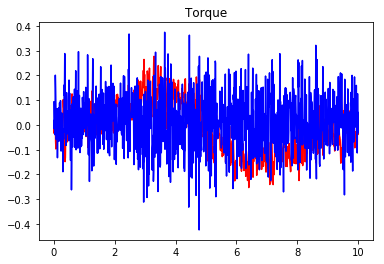

Value Loss : [ 91.97651672]
Policy Loss : [-56.84040833]
EPISODE 38 STATE [-0.03681024  0.01319726] REWARD  [ 1.94704945] ACTION ([ 0.0441894])  05])                  

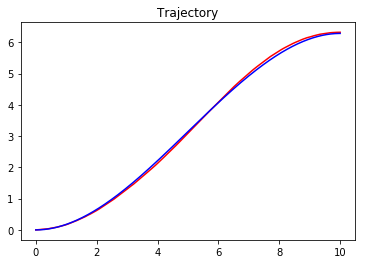

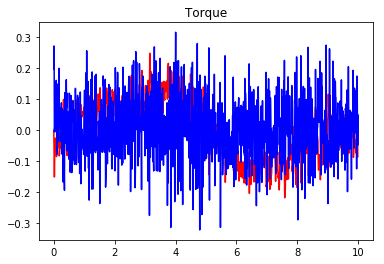

Value Loss : [ 48.55918884]
Policy Loss : [-14.26434517]
EPISODE 39 STATE [-0.03325597 -0.05778535] REWARD  [ 1.91473023] ACTION ([ 0.11809976]) 05]) 57])                        

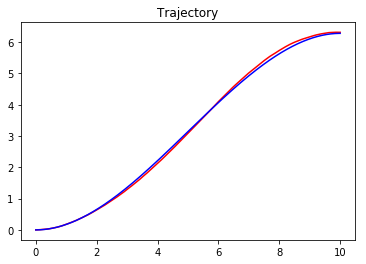

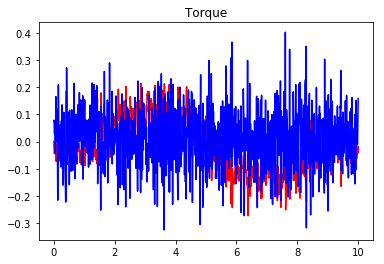

Value Loss : [ 73.78370667]
Policy Loss : [-45.00970459]
EPISODE 40 STATE [-0.03950985  0.0846075 ] REWARD  [ 1.87669049] ACTION ([-0.07020831]) 3879304])              

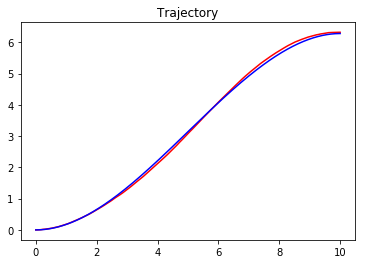

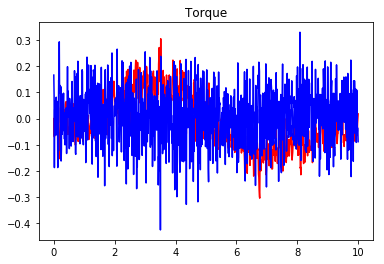

Value Loss : [ 79.50953674]
Policy Loss : [-48.68136597]
EPISODE 41 STATE [-0.02887177  0.0190289 ] REWARD  [ 1.9490148] ACTION ([-0.00375122])  5338633])                      

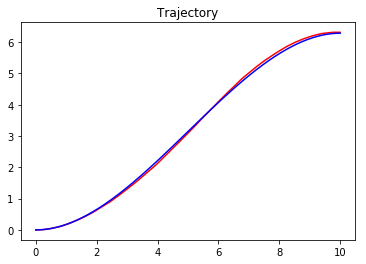

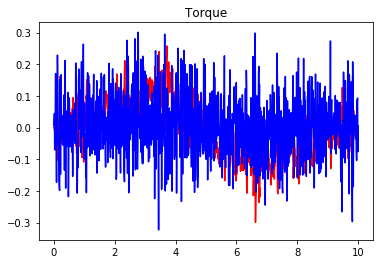

Value Loss : [ 55.18698502]
Policy Loss : [-5.46272993]
EPISODE 42 STATE [-0.0287123   0.01738664] REWARD  [ 1.9507763] ACTION ([ 0.02344471])  598223])                     

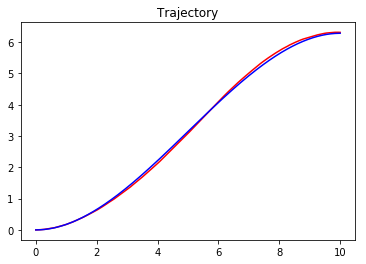

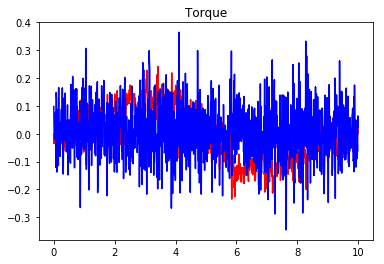

Value Loss : [ 48.6445694]
Policy Loss : [-17.14077187]
EPISODE 43 STATE [-0.04114776 -0.00111001] REWARD  [ 1.95704529] ACTION ([-0.14873939]) 4506304])                         

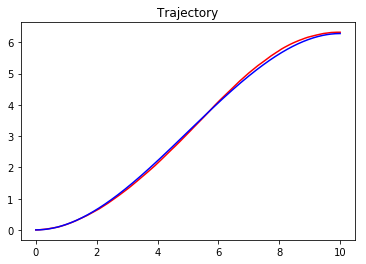

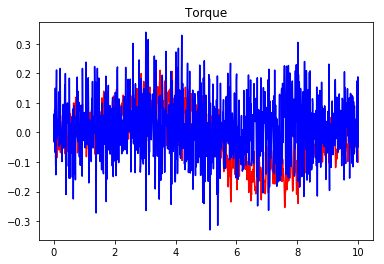

Value Loss : [ 61.01585007]
Policy Loss : [-22.52748108]
EPISODE 44 STATE [-0.03978162 -0.00296255] REWARD  [ 1.96020661] ACTION ([-0.00809317]) 06]) 81])           

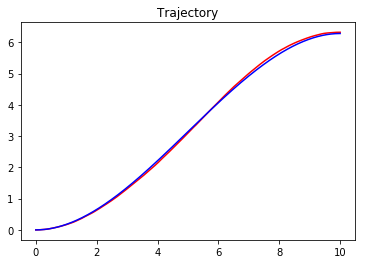

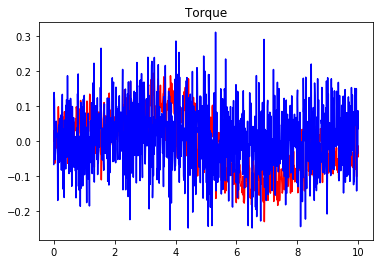

Value Loss : [ 29.1043396]
Policy Loss : [ 3.44763112]
EPISODE 45 STATE [-0.02834667  0.05656372] REWARD  [ 1.9135165] ACTION ([-0.02032829])  3220003])                       

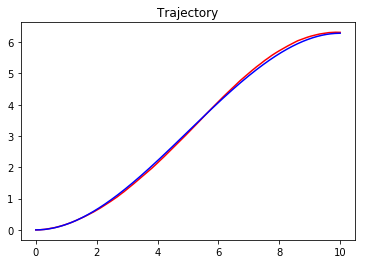

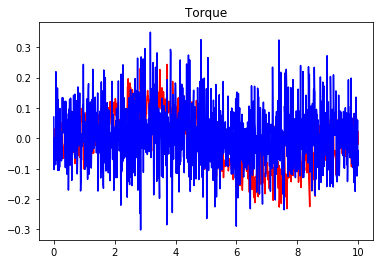

Value Loss : [ 43.47535706]
Policy Loss : [-23.92382431]
EPISODE 46 STATE [-0.03066179  0.08132766] REWARD  [ 1.88824102] ACTION ([-0.10574042]) 7221686])            

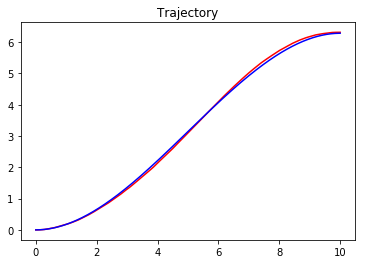

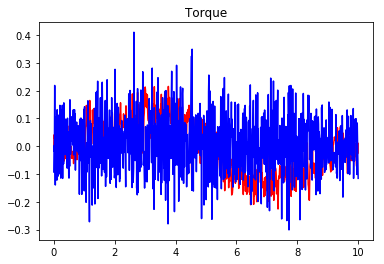

Value Loss : [ 42.56795502]
Policy Loss : [-12.9493885]
EPISODE 47 STATE [-0.04022589 -0.00072885] REWARD  [ 1.95755035] ACTION ([-0.02453397]) 1878876])                   

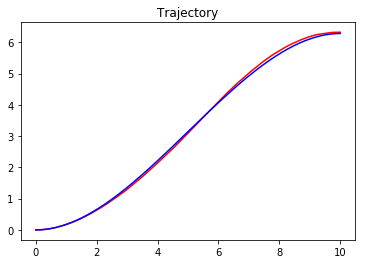

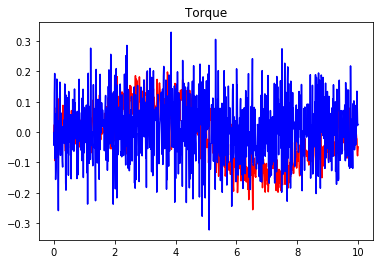

Value Loss : [ 38.3572197]
Policy Loss : [-11.96904755]
EPISODE 48 STATE [-0.03168009 -0.02363526] REWARD  [ 1.94916911] ACTION ([ 0.1896148])  ]) 9314])                

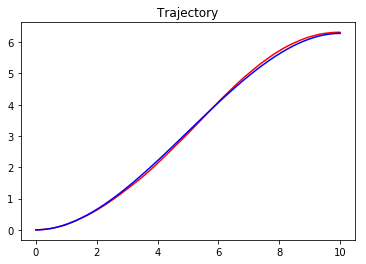

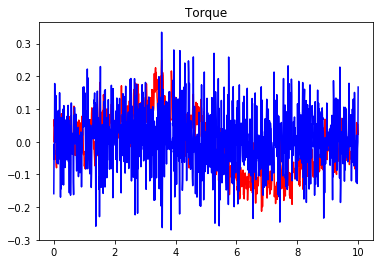

Value Loss : [ 39.93781281]
Policy Loss : [-12.37892723]
EPISODE 49 STATE [-0.0370485   0.01343787] REWARD  [ 1.94658329] ACTION ([ 0.01676823]) 1299987])                       

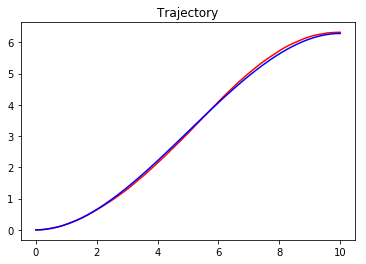

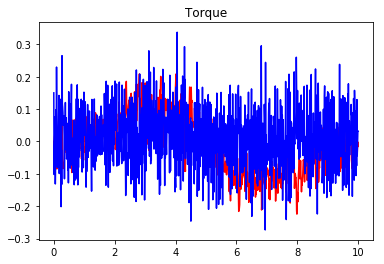

Value Loss : [ 35.64762497]
Policy Loss : [-4.54012108]
EPISODE 50 STATE [-0.03841874  0.04085838] REWARD  [ 1.91867734] ACTION ([ 0.09084638]) 4791075])            

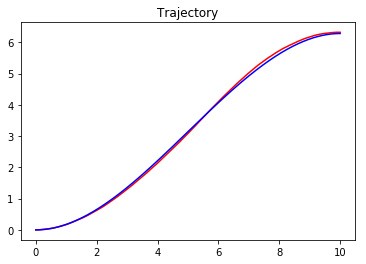

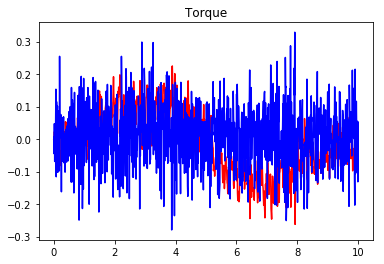

Value Loss : [ 68.99508667]
Policy Loss : [-28.34630585]
EPISODE 51 STATE [-0.03099814  0.01603657] REWARD  [ 1.94988035] ACTION ([ 0.03432379]) 05]) 48])                

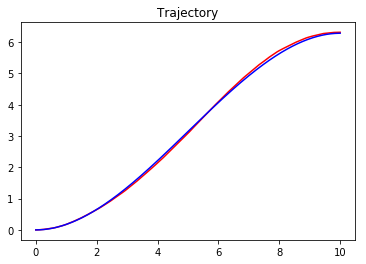

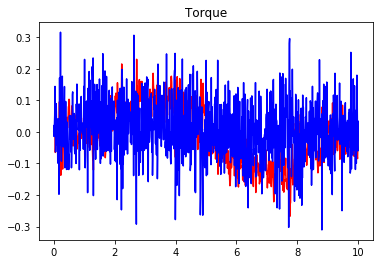

Value Loss : [ 42.67446899]
Policy Loss : [-3.29657793]
EPISODE 52 STATE [-0.03471241  0.04143434] REWARD  [ 1.92170001] ACTION ([-0.10018334]) 6527757])             

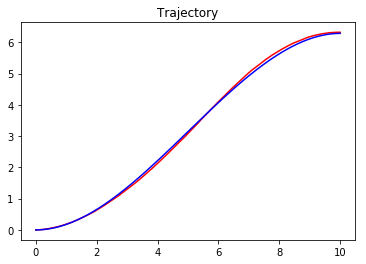

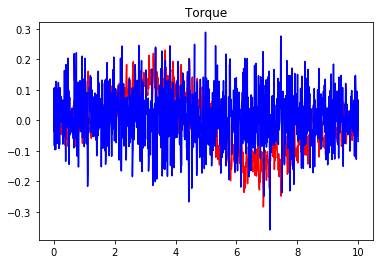

Value Loss : [ 68.80698395]
Policy Loss : [-18.58520508]
EPISODE 53 STATE [-0.04330603 -0.00459851] REWARD  [ 1.95681186] ACTION ([-0.04112382]) 1190593])              

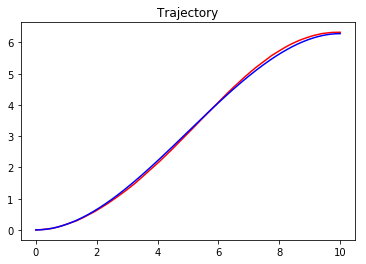

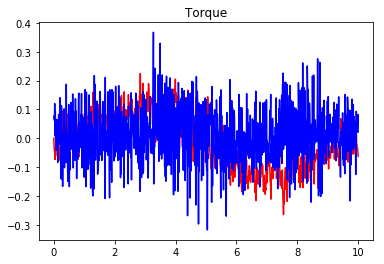

Value Loss : [ 60.42707825]
Policy Loss : [-23.36743546]
EPISODE 54 STATE [-0.04295    -0.03304446] REWARD  [ 1.92913082] ACTION ([ 0.07515402]) 3196]) ])                 

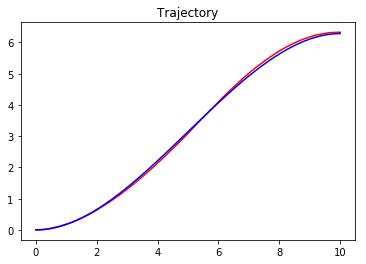

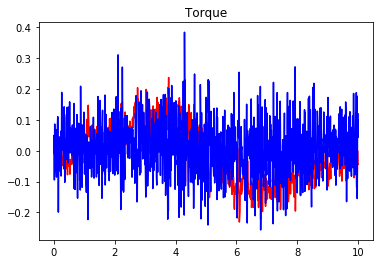

Value Loss : [ 40.01691818]
Policy Loss : [ 0.17190868]
EPISODE 55 STATE [-0.03656153  0.03632543] REWARD  [ 1.92481118] ACTION ([-0.01913339]) 748676])                      

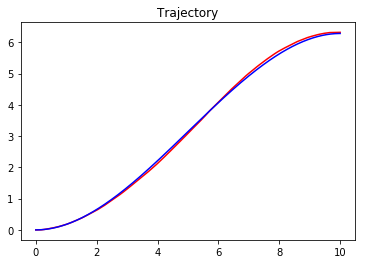

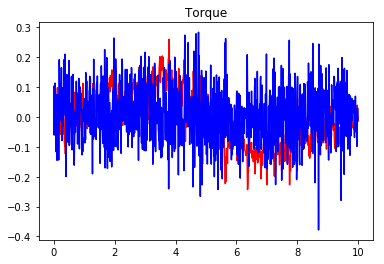

Value Loss : [ 40.28409195]
Policy Loss : [ 1.52635825]
EPISODE 56 STATE [-0.03700826 -0.012757  ] REWARD  [ 1.95474325] ACTION ([ 0.05246353]) 6060983])           

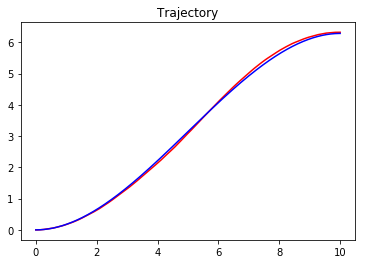

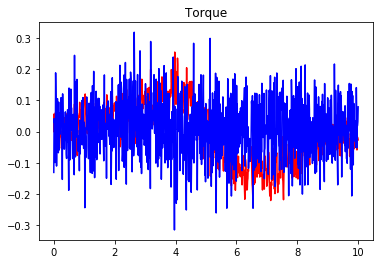

Value Loss : [ 45.11796951]
Policy Loss : [-20.92940712]
EPISODE 57 STATE [-0.03475062 -0.02625164] REWARD  [ 1.94363726] ACTION ([ 0.08067748]) 106691])                

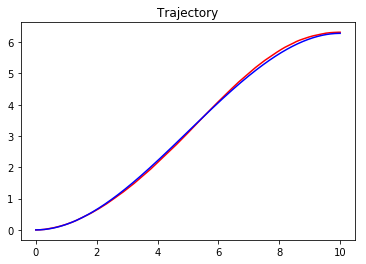

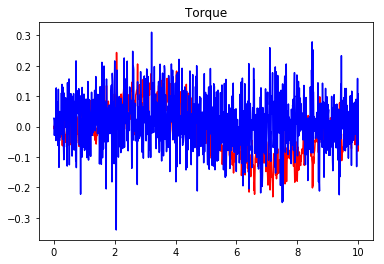

Value Loss : [ 36.10707474]
Policy Loss : [-2.280195]
EPISODE 58 STATE [-0.03500871  0.06774529] REWARD  [ 1.89659384] ACTION ([-0.14319539]) 650002])            

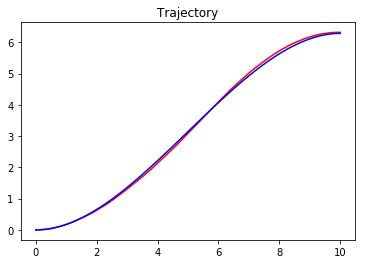

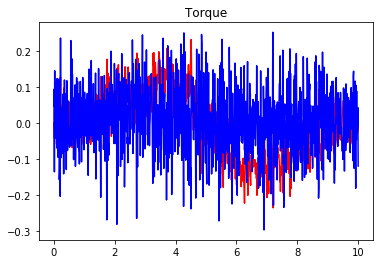

Value Loss : [ 38.69973755]
Policy Loss : [-5.31099033]
EPISODE 59 STATE [-0.03975573  0.00972551] REWARD  [ 1.9476338] ACTION ([ 0.04299921])  9322277])               

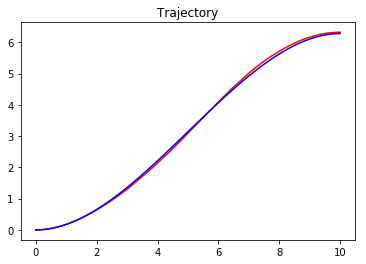

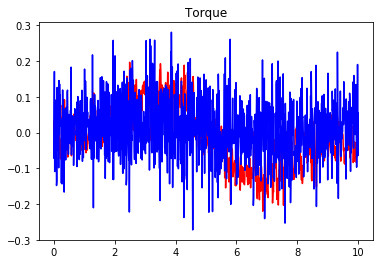

Value Loss : [ 30.44618034]
Policy Loss : [ 3.56680036]
EPISODE 60 STATE [-0.04192066  0.0085592 ] REWARD  [ 1.9467068] ACTION ([ 0.01993694])  555446])              

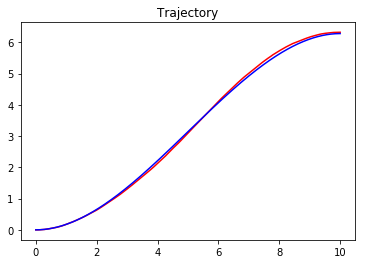

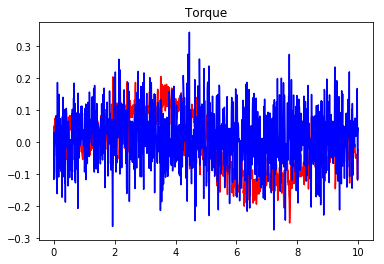

Value Loss : [ 41.07910156]
Policy Loss : [-3.93559885]
EPISODE 61 STATE [-0.03486052  0.06282611] REWARD  [ 1.90132788] ACTION ([-0.05701382]) 3404372])                         

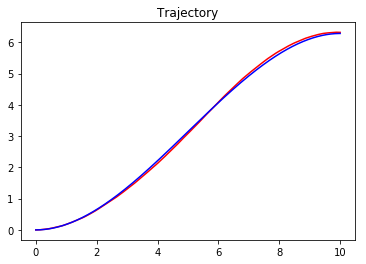

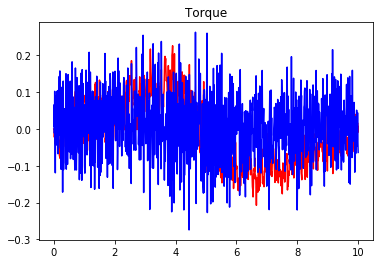

Value Loss : [ 29.66105652]
Policy Loss : [-3.66303062]
EPISODE 62 STATE [-0.04726202  0.00790744] REWARD  [ 1.94224227] ACTION ([-0.02445448]) ]) 531])                   

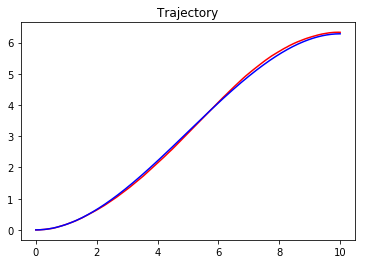

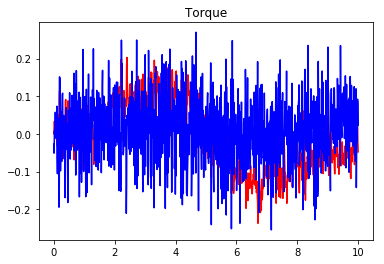

Value Loss : [ 31.04519272]
Policy Loss : [-5.59576654]
EPISODE 63 STATE [-0.02736782 -0.03431207] REWARD  [ 1.94294483] ACTION ([ 0.12481094]) 277234])                

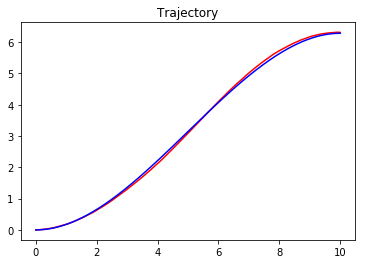

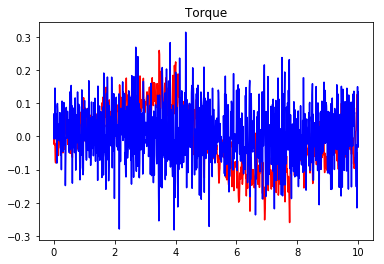

Value Loss : [ 53.44063187]
Policy Loss : [-13.8165493]
EPISODE 64 STATE [-0.03866007  0.04681202] REWARD  [ 1.9127683] ACTION ([-0.03485287])  806143])                         

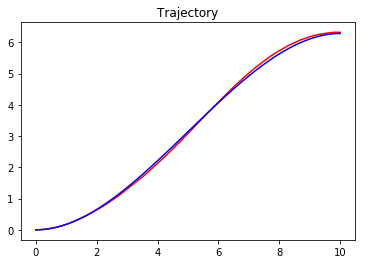

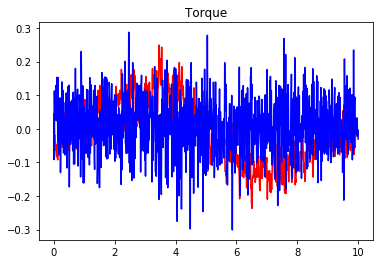

Value Loss : [ 45.39656448]
Policy Loss : [-21.13980103]
EPISODE 65 STATE [-0.04275081 -0.00494594] REWARD  [ 1.95699663] ACTION ([ 0.03463415]) 1080919])                  

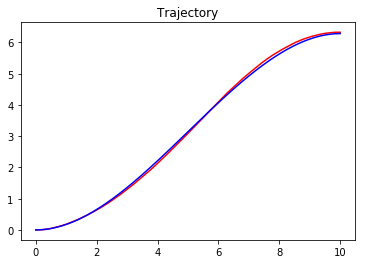

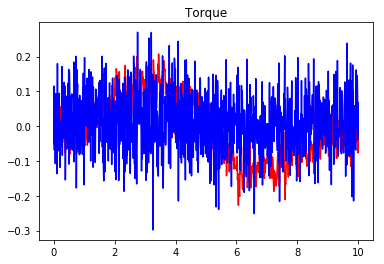

Value Loss : [ 34.83703232]
Policy Loss : [-5.79055786]
EPISODE 66 STATE [-0.03349211 -0.03809646] REWARD  [ 1.93334036] ACTION ([ 0.00079052]) 4356005])                 

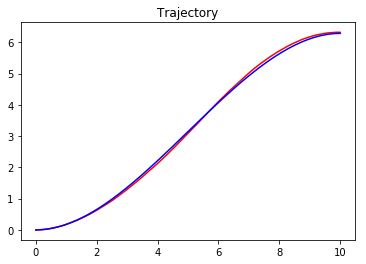

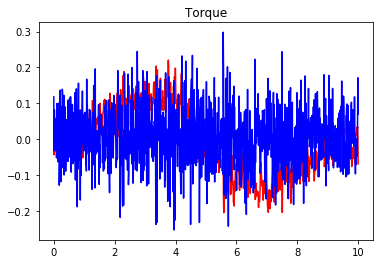

Value Loss : [ 35.78978348]
Policy Loss : [-17.49868774]
EPISODE 67 STATE [-0.04096361  0.06575702] REWARD  [ 1.89271366] ACTION ([-0.19774528]) 2735273])                     

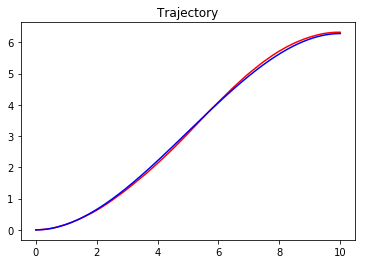

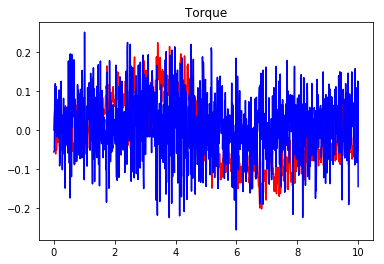

Value Loss : [ 29.03297806]
Policy Loss : [ 2.96205616]
EPISODE 68 STATE [-0.0297801   0.00555087] REWARD  [ 1.96139605] ACTION ([ 0.03408435]) 8894749])                        

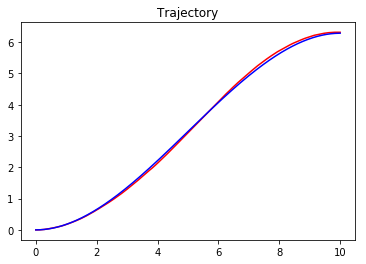

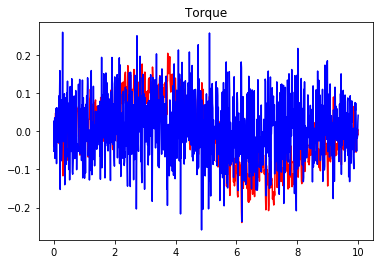

Value Loss : [ 25.58311272]
Policy Loss : [ 3.37847185]
EPISODE 69 STATE [-0.03554184 -0.0103451 ] REWARD  [ 1.95855069] ACTION ([ 0.21996504]) 05]) 68])                      

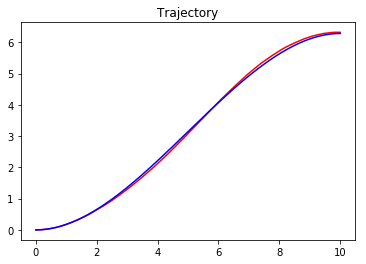

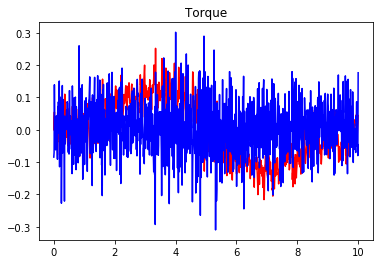

Value Loss : [ 39.76470947]
Policy Loss : [-23.12638092]
EPISODE 70 STATE [-0.03442298  0.05066292] REWARD  [ 1.91319952] ACTION ([-0.17104135]) 1050951])             

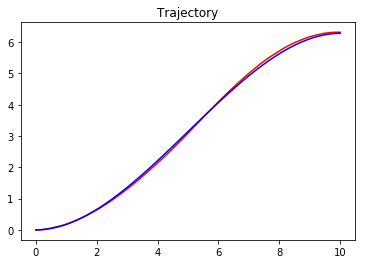

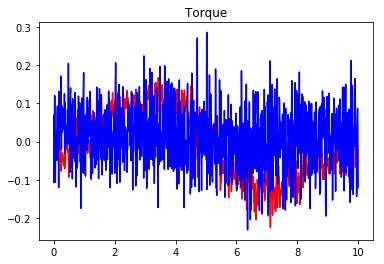

Value Loss : [ 27.91435814]
Policy Loss : [ 10.4428091]
EPISODE 71 STATE [-0.03825046  0.04957027] REWARD  [ 1.91054387] ACTION ([-0.18079056]) 2277538])       

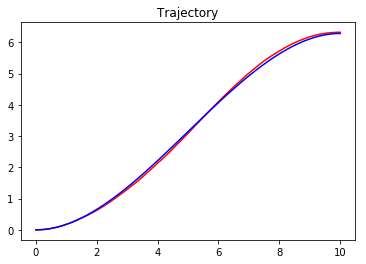

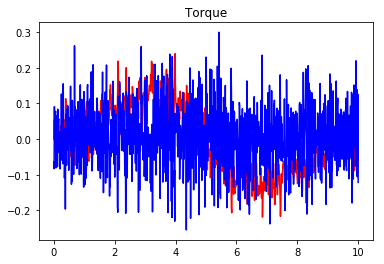

Value Loss : [ 36.25405884]
Policy Loss : [-4.29591179]
EPISODE 72 STATE [-0.03944951  0.0351084 ] REWARD  [ 1.92320074] ACTION ([ 0.01377114]) 96583]) )                

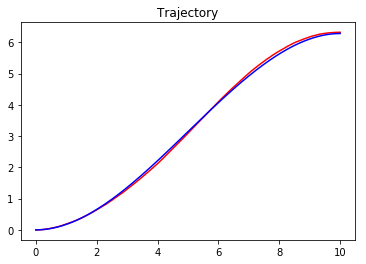

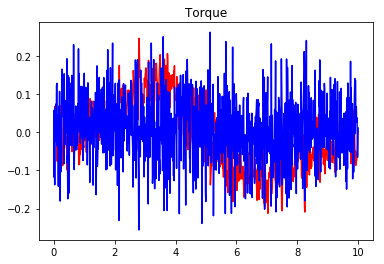

Value Loss : [ 34.80178833]
Policy Loss : [-14.85749722]
EPISODE 73 STATE [-0.02995749  0.05809817] REWARD  [ 1.91050844] ACTION ([-0.05031971]) 150573])            

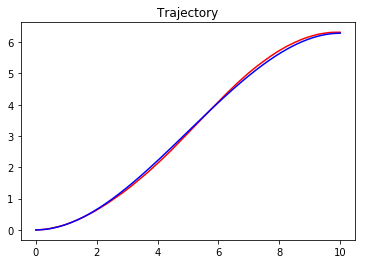

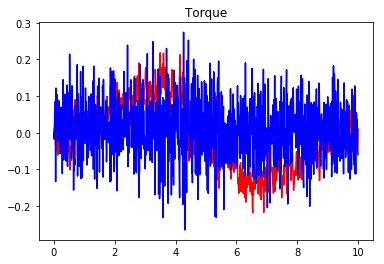

Value Loss : [ 35.68638229]
Policy Loss : [-10.86765194]
EPISODE 74 STATE [-0.03481319  0.00331167] REWARD  [ 1.95874373] ACTION ([-0.01603018]) 05]) 49])            

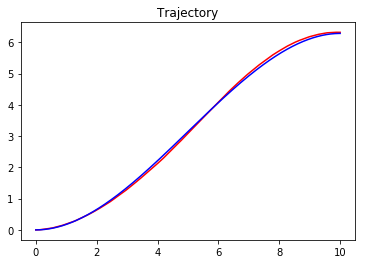

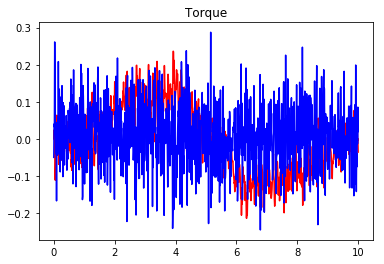

Value Loss : [ 39.25054932]
Policy Loss : [-15.64138412]
EPISODE 75 STATE [-0.0346095   0.08683217] REWARD  [ 1.87937843] ACTION ([-0.04310825]) 4350612])               

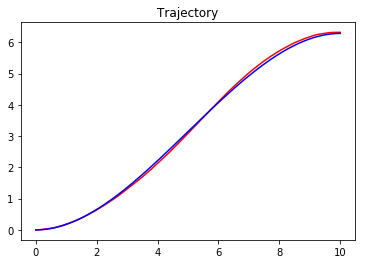

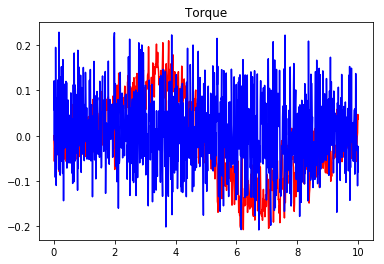

Value Loss : [ 35.40259933]
Policy Loss : [-7.98515081]
EPISODE 76 STATE [-0.03022002 -0.02414927] REWARD  [ 1.95008093] ACTION ([ 0.12324774]) 1980251])                 

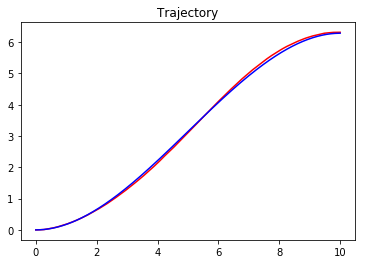

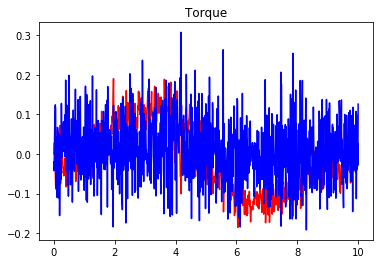

Value Loss : [ 27.21764374]
Policy Loss : [ 0.37198907]
EPISODE 77 STATE [-0.03812958  0.02604247] REWARD  [ 1.93323032] ACTION ([ 0.06959309]) 3508564])                  

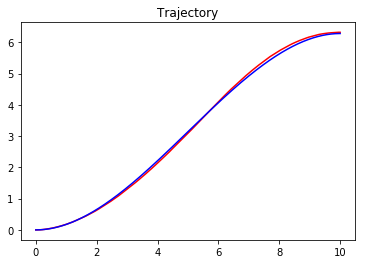

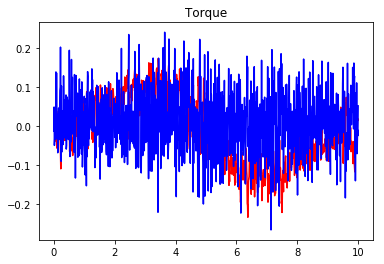

Value Loss : [ 28.1447258]
Policy Loss : [ 2.3429029]
EPISODE 78 STATE [-0.03824324  0.04825821] REWARD  [ 1.91179554] ACTION ([-0.03058469]) 05]) ])])                   

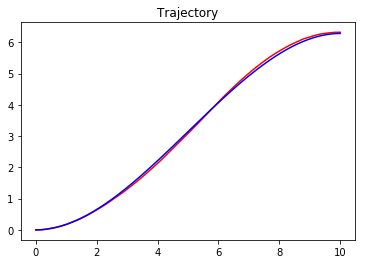

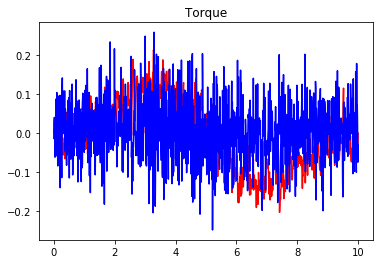

Value Loss : [ 27.24902344]
Policy Loss : [-1.863047]
EPISODE 79 STATE [-0.03321314  0.01850651] REWARD  [ 1.94531679] ACTION ([ 0.04391916]) 0329613])         

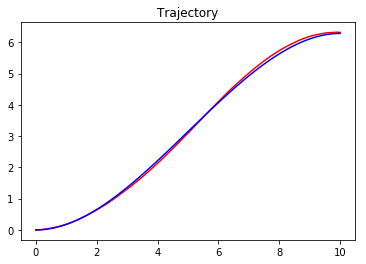

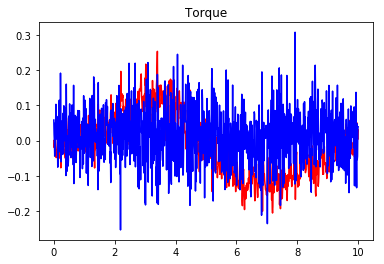

Value Loss : [ 34.38846207]
Policy Loss : [-13.99350452]
EPISODE 80 STATE [-0.03961015 -0.00705285] REWARD  [ 1.95790841] ACTION ([-0.05779273]) 4558063])               

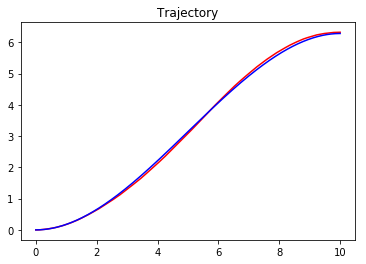

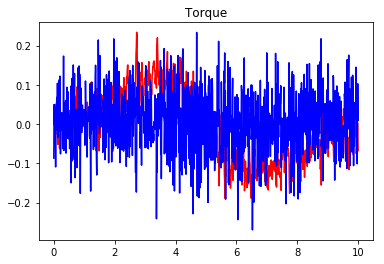

Value Loss : [ 29.78074455]
Policy Loss : [-1.78059793]
EPISODE 81 STATE [-0.03780119  0.0556284 ] REWARD  [ 1.90525032] ACTION ([-0.03405742]) 1926385])                

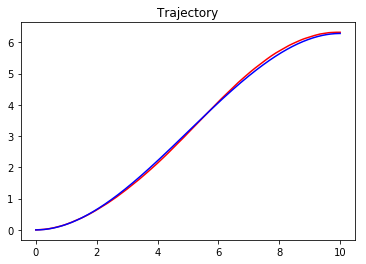

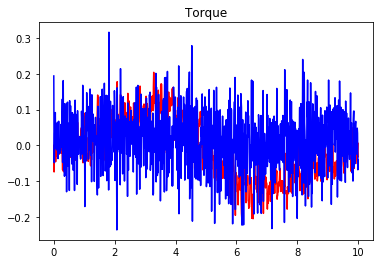

Value Loss : [ 22.70895576]
Policy Loss : [ 8.32546234]
EPISODE 82 STATE [-0.03825696 -0.02290916] REWARD  [ 1.94353019] ACTION ([ 0.08633563]) 1530868])              

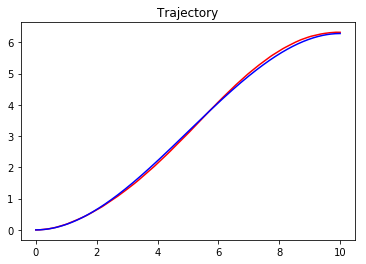

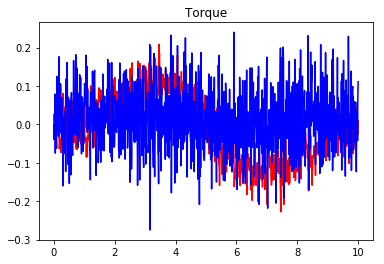

Value Loss : [ 31.99168777]
Policy Loss : [-17.80300522]
EPISODE 83 STATE [-0.03787022  0.04458745] REWARD  [ 1.9156457] ACTION ([-0.04571964])  8881107])             

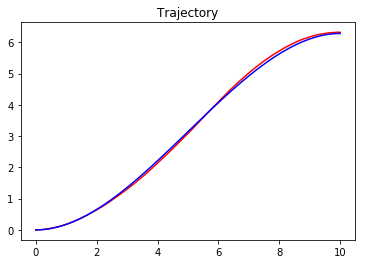

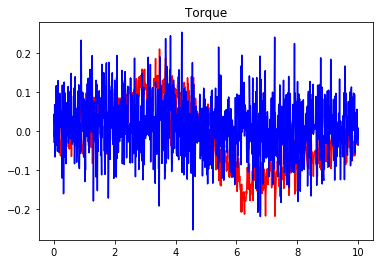

Value Loss : [ 26.25594711]
Policy Loss : [-6.51674652]
EPISODE 84 STATE [-0.02771591 -0.02178514] REWARD  [ 1.95483278] ACTION ([-0.00805002]) 0327047])                 

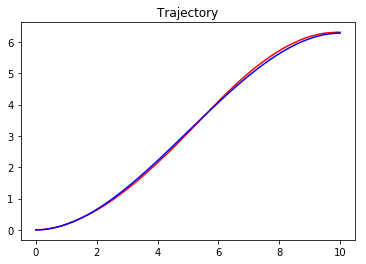

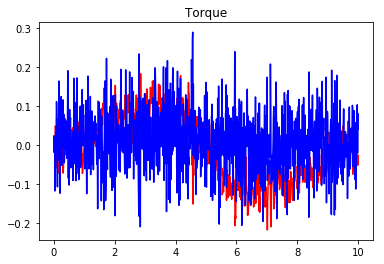

Value Loss : [ 23.20090103]
Policy Loss : [ 3.95793796]
EPISODE 85 STATE [-0.0368181   0.00811427] REWARD  [ 1.95205205] ACTION ([-0.08004625]) 4131181])                 

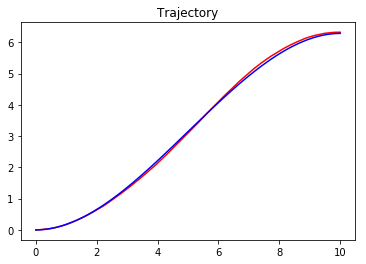

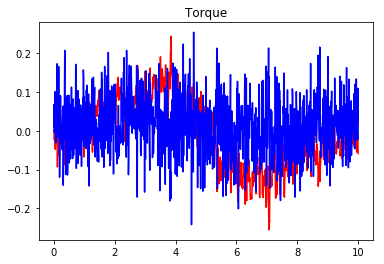

Value Loss : [ 32.68508911]
Policy Loss : [-12.37774563]
EPISODE 86 STATE [-0.03416738  0.00449581] REWARD  [ 1.95819257] ACTION ([-0.00970478]) 7968743])              

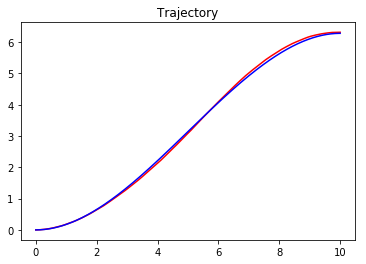

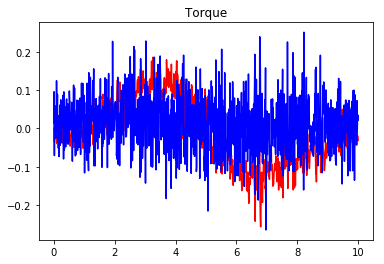

Value Loss : [ 30.51167488]
Policy Loss : [-11.56920433]
EPISODE 87 STATE [-0.03786626  0.00183993] REWARD  [ 1.95726198] ACTION ([ 0.14484651]) 0840431])           

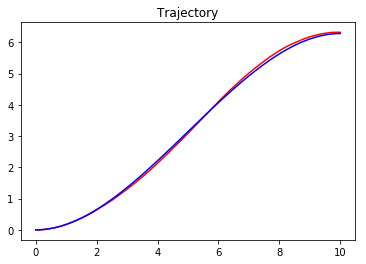

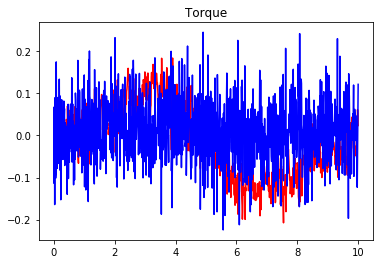

Value Loss : [ 32.3289299]
Policy Loss : [ 0.81852269]
EPISODE 88 STATE [-0.02998952 -0.00830359] REWARD  [ 1.96595434] ACTION ([ 0.06733189]) 05]) 68])                 

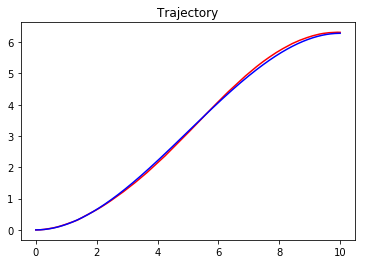

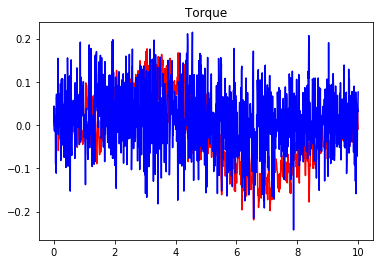

Value Loss : [ 25.30307388]
Policy Loss : [ 7.08376646]
EPISODE 89 STATE [-0.03562583  0.03419734] REWARD  [ 1.92776035] ACTION ([-0.04472021]) 05]) 99])                    

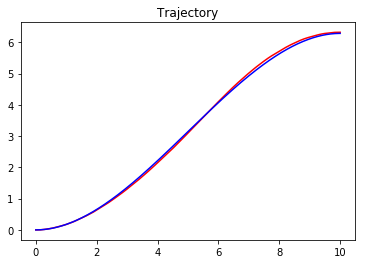

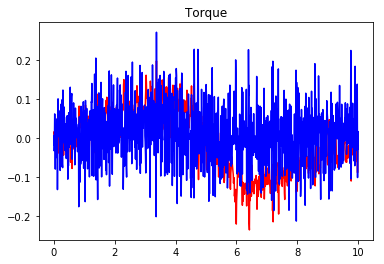

Value Loss : [ 26.73948288]
Policy Loss : [-2.99071264]
EPISODE 90 STATE [-0.03631673 -0.01753699] REWARD  [ 1.95068398] ACTION ([-0.00394932]) 9711773])           

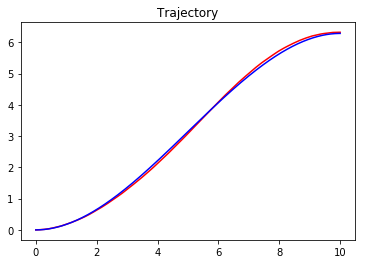

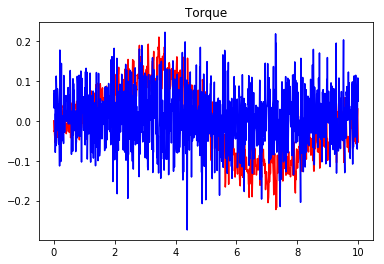

Value Loss : [ 31.3776989]
Policy Loss : [-18.93953133]
EPISODE 91 STATE [-0.03877743  0.02834054] REWARD  [ 1.9303789] ACTION ([ 0.02790796])  05]) 06])               

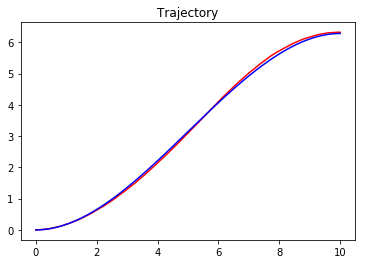

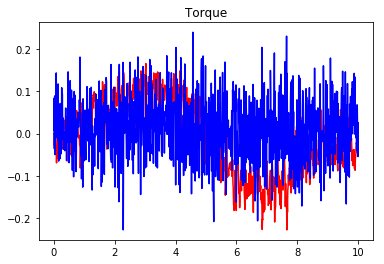

Value Loss : [ 35.67369843]
Policy Loss : [-15.82470798]
EPISODE 92 STATE [-0.04101118  0.0566158 ] REWARD  [ 1.90123431] ACTION ([-0.09843468]) 05]) 98])                 

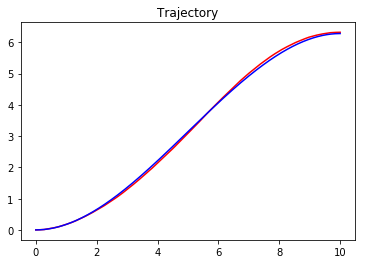

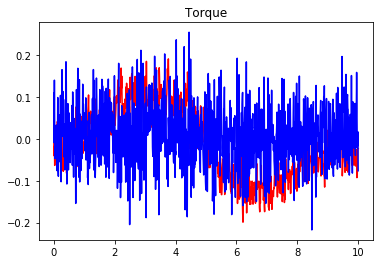

Value Loss : [ 25.18272781]
Policy Loss : [-6.3481164]
EPISODE 93 STATE [-0.03419844  0.04134653] REWARD  [ 1.92228051] ACTION ([-0.00615296]) 05]) 03])                  

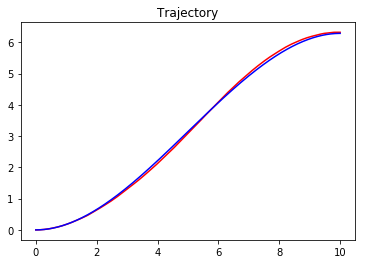

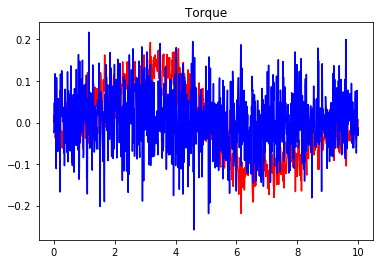

Value Loss : [ 25.43881989]
Policy Loss : [-13.05809021]
EPISODE 94 STATE [-0.03337703  0.0042039 ] REWARD  [ 1.95924623] ACTION ([ 0.04011299]) 2238877])            

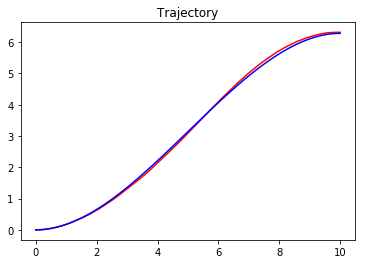

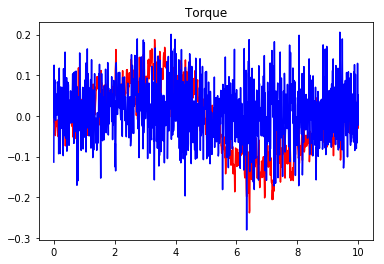

Value Loss : [ 26.93776131]
Policy Loss : [-2.88969493]
EPISODE 95 STATE [-0.02938864  0.09219324] REWARD  [ 1.87955139] ACTION ([-0.11114246]) 7398806])          

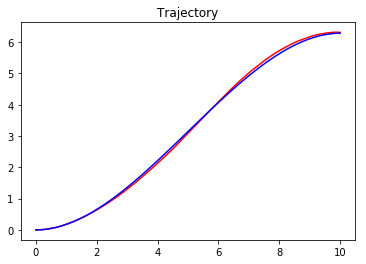

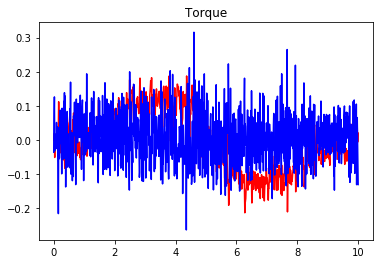

Value Loss : [ 35.40917206]
Policy Loss : [-20.36862755]
EPISODE 96 STATE [-0.03066633  0.00539875] REWARD  [ 1.96068691] ACTION ([-0.02354287]) 05]) 5])                

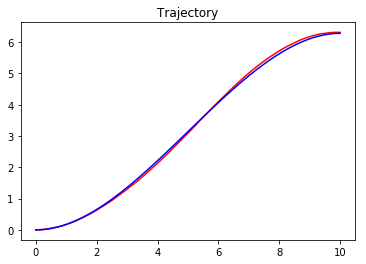

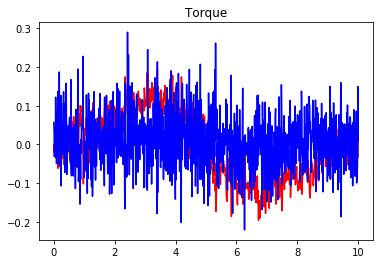

Value Loss : [ 26.39666367]
Policy Loss : [ 15.0247221]
EPISODE 97 STATE [-0.03038867  0.01311864] REWARD  [ 1.95333628] ACTION ([-0.01330351]) 06]) 5])                 

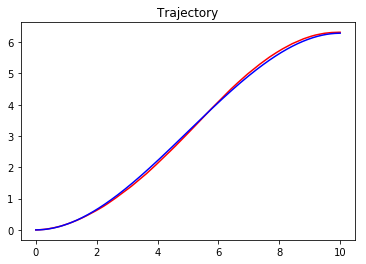

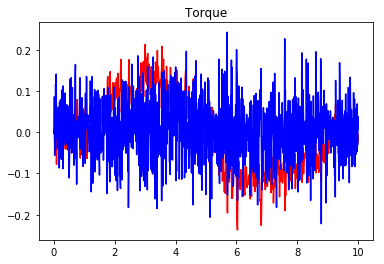

Value Loss : [ 32.28208923]
Policy Loss : [-16.14108849]
EPISODE 98 STATE [-0.04270548 -0.06950566] REWARD  [ 1.89459343] ACTION ([-0.00554976]) 8817663])                 

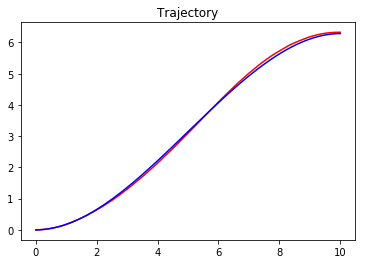

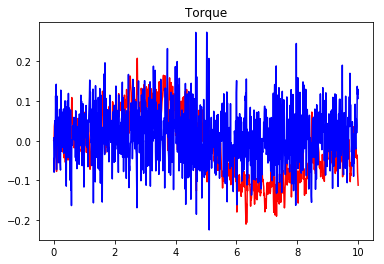

Value Loss : [ 24.13749123]
Policy Loss : [-1.6969291]
EPISODE 99 STATE [-0.03961177 -0.02430069] REWARD  [ 1.94086289] ACTION ([-0.02389723]) 05]) 59])             

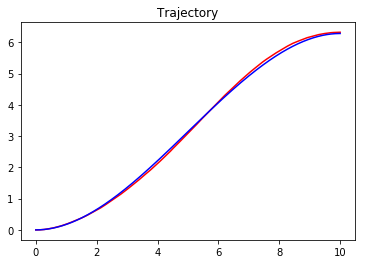

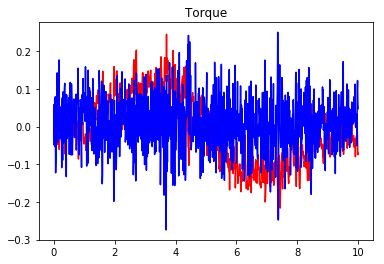

Value Loss : [ 47.37269974]
Policy Loss : [-30.63825417]
EPISODE 100 STATE [-0.0313297   0.01620094] REWARD  [ 1.94939782] ACTION ([-0.01531712]) 05]) 63])            

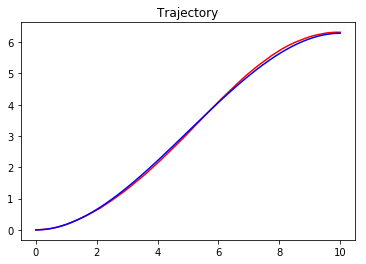

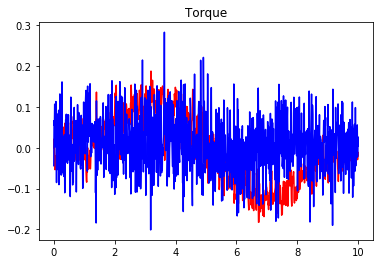

Value Loss : [ 26.278965]
Policy Loss : [ 19.63322067]
EPISODE 101 STATE [-0.03600237 -0.00459511] REWARD  [ 1.96383511] ACTION ([-0.02788298]) 06]) 68])          

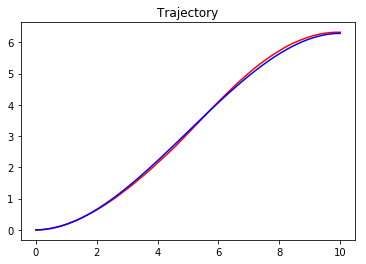

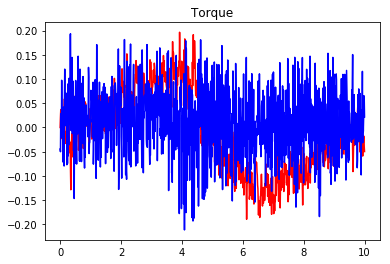

Value Loss : [ 26.86042213]
Policy Loss : [-12.2792635]
EPISODE 102 STATE [-0.03219531 -0.02450463] REWARD  [ 1.94781817] ACTION ([ 0.09005013]) 3942573])                   

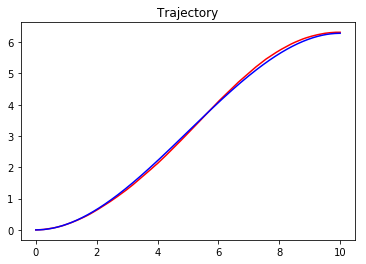

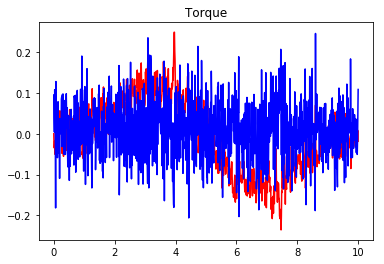

Value Loss : [ 39.24747467]
Policy Loss : [-14.07549477]
EPISODE 103 STATE [-0.03417385  0.03923802] REWARD  [ 1.9243219] ACTION ([-0.19381477])  3509504])                

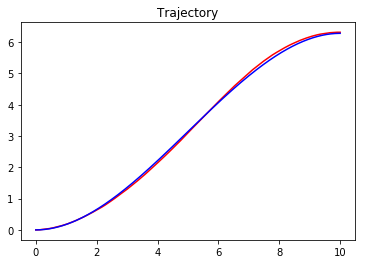

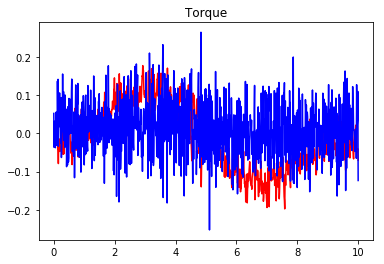

Value Loss : [ 36.97040939]
Policy Loss : [ 1.80793953]
EPISODE 104 STATE [-0.0357162  0.0328905] REWARD  [ 1.92893211] ACTION ([-0.05093698])   5963602])             

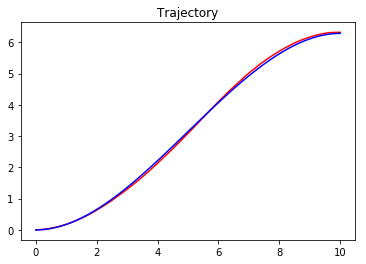

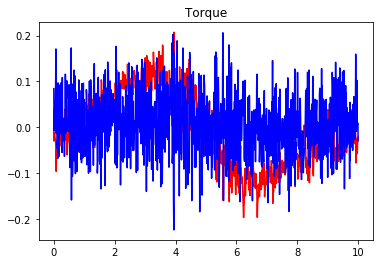

Value Loss : [ 28.81513786]
Policy Loss : [-2.93012238]
EPISODE 105 STATE [-0.03084119  0.04352305] REWARD  [ 1.92345217] ACTION ([ 0.01473922]) 4890681])             

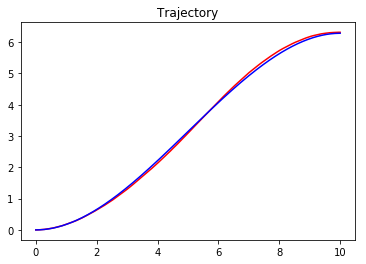

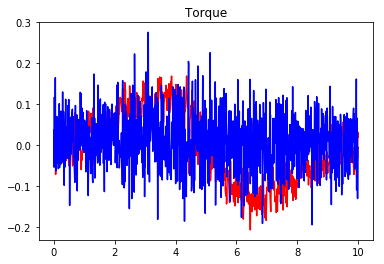

Value Loss : [ 26.30611038]
Policy Loss : [ 5.47424126]
EPISODE 106 STATE [-0.04282098  0.03053747] REWARD  [ 1.92437177] ACTION ([-0.06048733]) 05]) 73])           

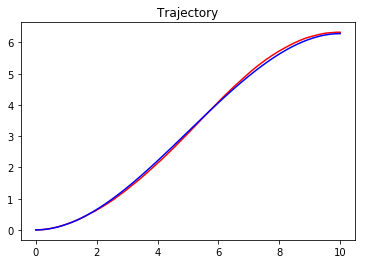

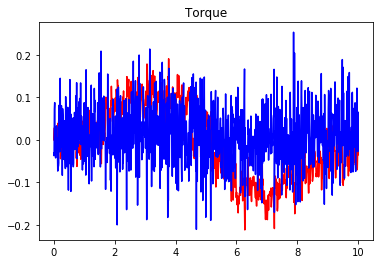

Value Loss : [ 31.54638863]
Policy Loss : [-22.26749039]
EPISODE 107 STATE [-0.03801122 -0.0005416 ] REWARD  [ 1.95949343] ACTION ([ 0.05880149]) 8938299])     

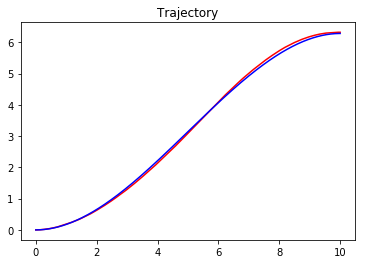

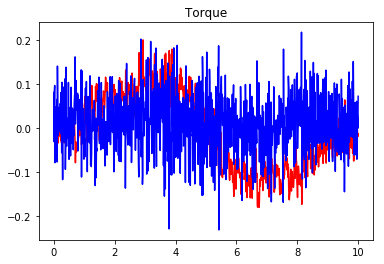

Value Loss : [ 23.27467918]
Policy Loss : [-0.64056623]
EPISODE 108 STATE [-0.04198181  0.05452935] REWARD  [ 1.90226934] ACTION ([-0.12676092]) 4924228])          

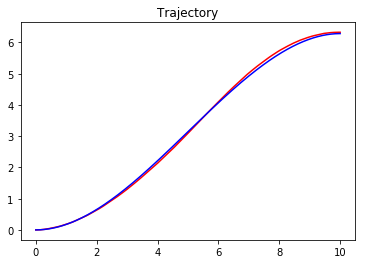

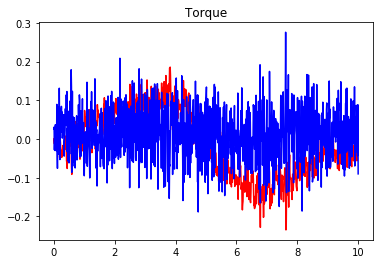

Value Loss : [ 38.76107788]
Policy Loss : [-30.45478058]
EPISODE 109 STATE [-0.03660478 -0.00807312] REWARD  [ 1.95978505] ACTION ([ 0.02788006]) 05]) 39])           

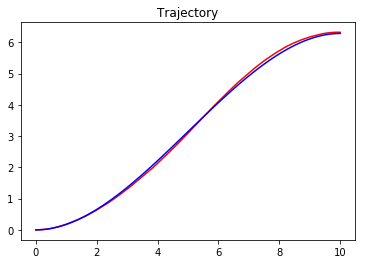

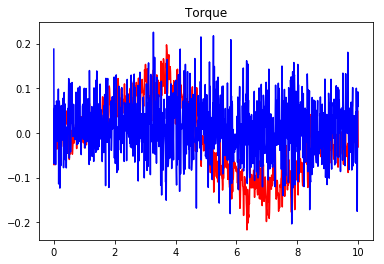

Value Loss : [ 34.70770645]
Policy Loss : [-1.21096909]
EPISODE 110 STATE [-0.03650975  0.00536348] REWARD  [ 1.95507134] ACTION ([ 0.01202546]) 8132777])           

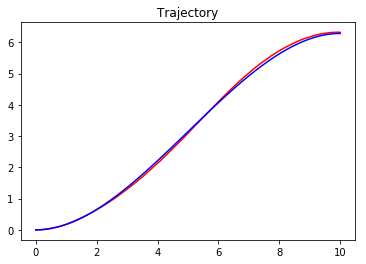

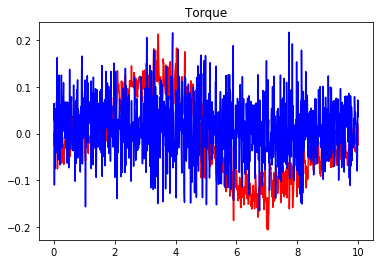

Value Loss : [ 31.78729057]
Policy Loss : [-14.35276031]
EPISODE 111 STATE [-0.03396314  0.00441935] REWARD  [ 1.95846581] ACTION ([ 0.01401844]) 1710196])           

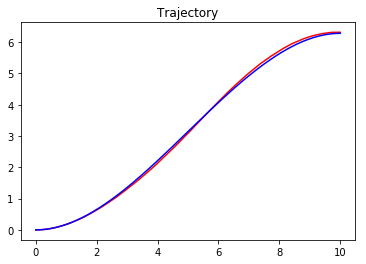

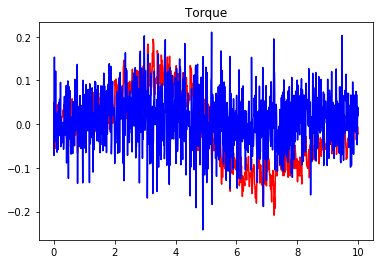

Value Loss : [ 29.40452957]
Policy Loss : [ 3.16705561]
EPISODE 112 STATE [-0.03341139  0.08864304] REWARD  [ 1.87888399] ACTION ([-0.09381312]) 5])  51])           

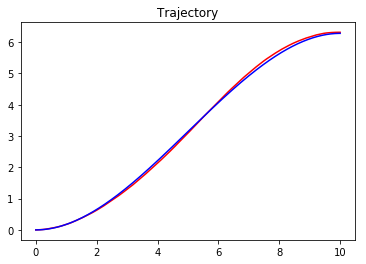

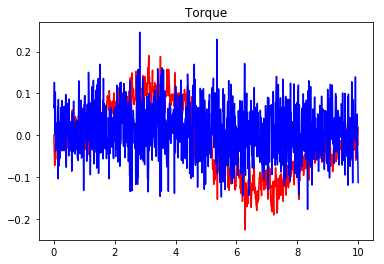

Value Loss : [ 31.4461937]
Policy Loss : [ 0.50133479]
EPISODE 113 STATE [-0.03983384  0.04636133] REWARD  [ 1.91206823] ACTION ([-0.05327251]) 05]) 02])               

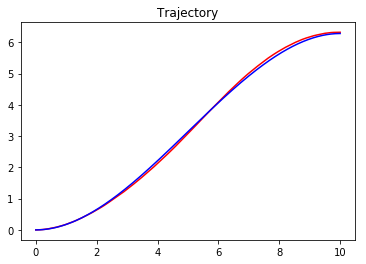

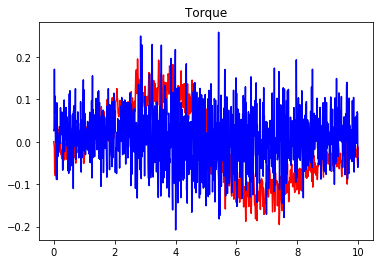

Value Loss : [ 32.8732338]
Policy Loss : [-11.15059185]
EPISODE 114 STATE [-0.03031434  0.01291424] REWARD  [ 1.95360939] ACTION ([ 0.09230765]) 085704])             

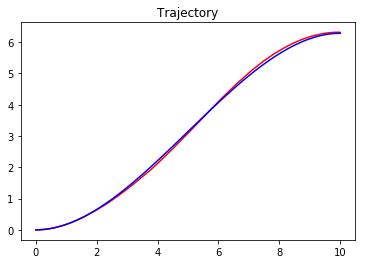

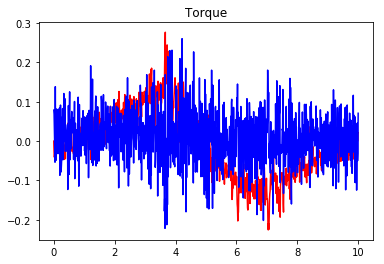

Value Loss : [ 44.99156952]
Policy Loss : [-4.45516825]
EPISODE 115 STATE [-0.03497231  0.03550143] REWARD  [ 1.92713652] ACTION ([-0.06471942]) 7822874])                   

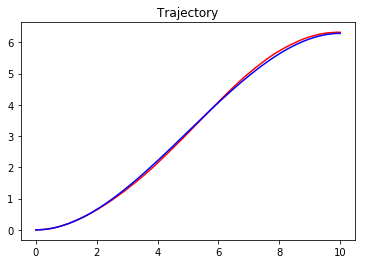

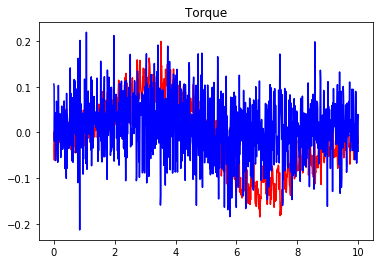

Value Loss : [ 31.30129051]
Policy Loss : [ 13.22878742]
EPISODE 116 STATE [-0.0391906   0.07926805] REWARD  [ 1.88189829] ACTION ([-0.01999995]) 615253])                  

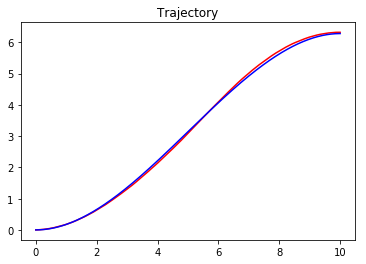

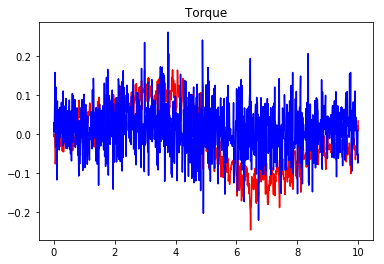

Value Loss : [ 28.65558434]
Policy Loss : [ 2.41347265]
EPISODE 117 STATE [-0.03162791 -0.00450705] REWARD  [ 1.9681522] ACTION ([-0.01315538])  083409])             

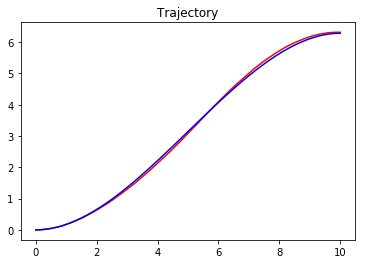

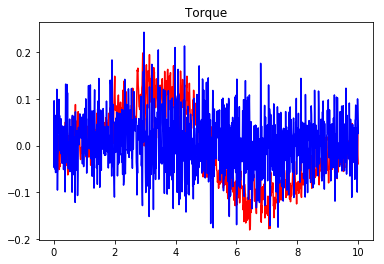

Value Loss : [ 26.33797836]
Policy Loss : [ 10.89253616]
EPISODE 118 STATE [-0.03275372  0.04626002] REWARD  [ 1.91899249] ACTION ([ 0.01673114]) 2162645])           

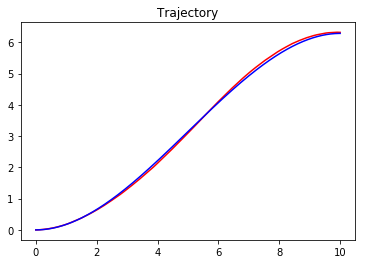

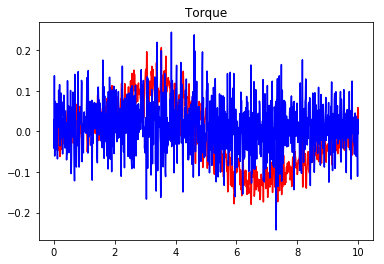

Value Loss : [ 26.34363365]
Policy Loss : [ 6.78153372]
EPISODE 119 STATE [-0.03466734  0.03384771] REWARD  [ 1.92902241] ACTION ([-0.04395326]) 3955009])          

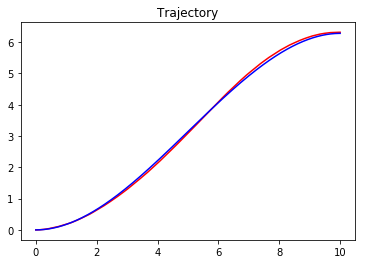

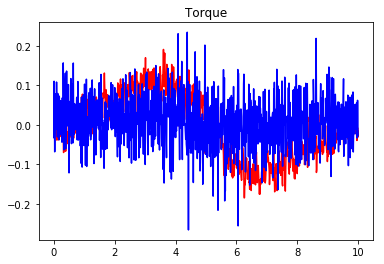

Value Loss : [ 27.05915451]
Policy Loss : [-2.50714374]
EPISODE 120 STATE [-0.03697793 -0.0262324 ] REWARD  [ 1.94150718] ACTION ([-0.09416884]) 05]) 54])                  

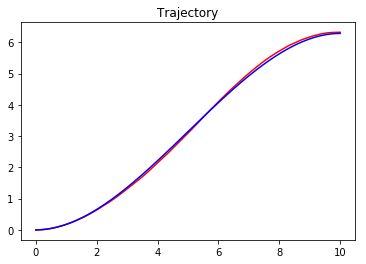

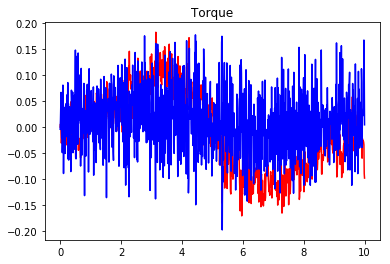

Value Loss : [ 23.96389771]
Policy Loss : [-0.71981901]
EPISODE 121 STATE [-0.04071538  0.00051485] REWARD  [ 1.95584111] ACTION ([-0.05287172]) 06]) 95])                

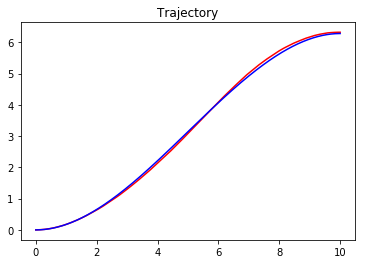

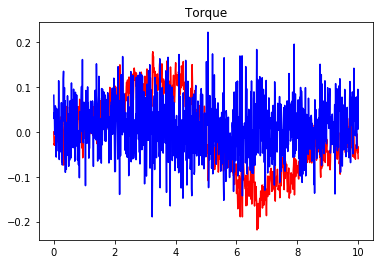

Value Loss : [ 22.00870705]
Policy Loss : [-3.66029]
EPISODE 122 STATE [-0.03362081  0.03744479] REWARD  [ 1.92657578] ACTION ([-0.0334374])  3607908])                   

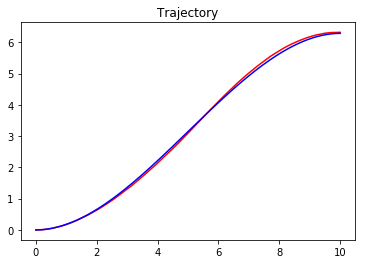

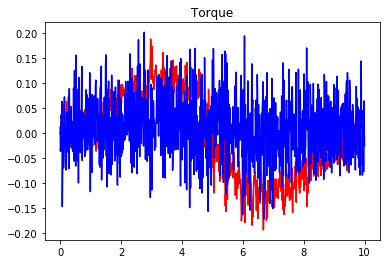

Value Loss : [ 23.8415699]
Policy Loss : [ 9.44089699]
EPISODE 123 STATE [-0.03917311  0.01013266] REWARD  [ 1.94779228] ACTION ([ 0.13400306]) 1073073])                      

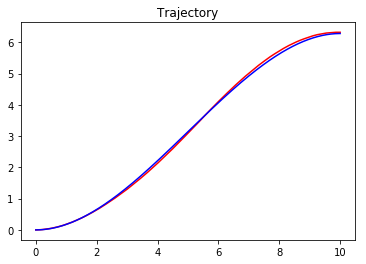

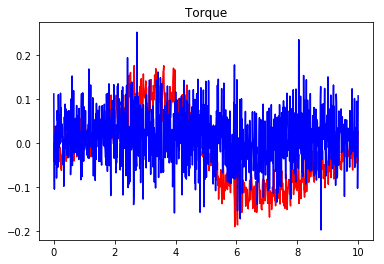

Value Loss : [ 24.89546967]
Policy Loss : [ 2.02818799]
EPISODE 124 STATE [-0.03195715  0.00591383] REWARD  [ 1.95892561] ACTION ([ 0.02032583]) 0369416])                 

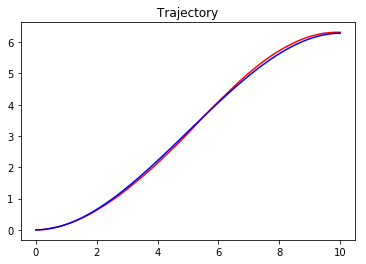

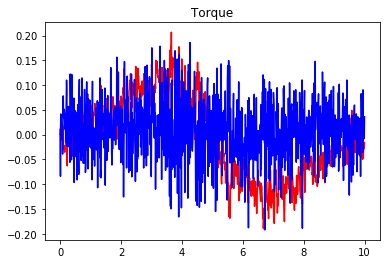

Value Loss : [ 23.44423294]
Policy Loss : [ 11.26718616]
EPISODE 125 STATE [-0.03661135  0.04788205] REWARD  [ 1.91372467] ACTION ([-0.06294419]) 1332153])               

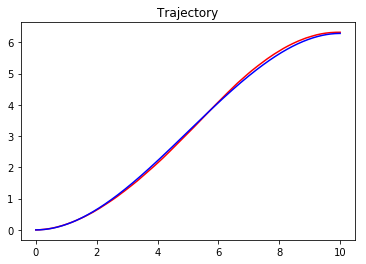

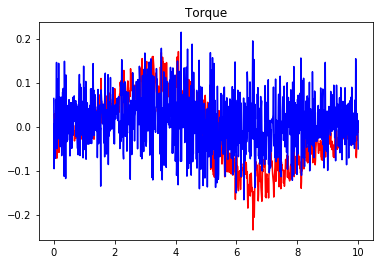

Value Loss : [ 24.27534294]
Policy Loss : [ 7.56557274]
EPISODE 126 STATE [-0.04127545  0.02700168] REWARD  [ 1.92927626] ACTION ([ 0.03083793]) 118906])              

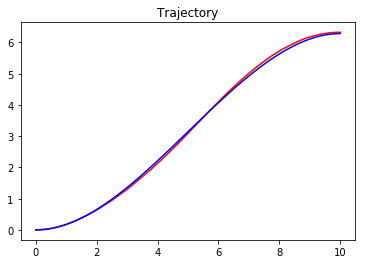

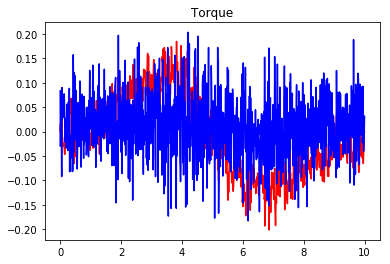

Value Loss : [ 28.65250397]
Policy Loss : [-5.19235086]
EPISODE 127 STATE [-0.03652723 -0.01637928] REWARD  [ 1.95162354] ACTION ([ 0.06828197]) 813661])             

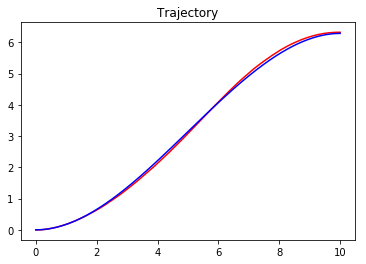

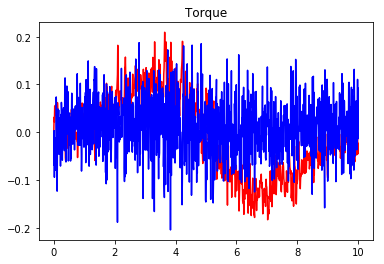

Value Loss : [ 26.32428551]
Policy Loss : [-13.20927238]
EPISODE 128 STATE [-0.03821493  0.00849691] REWARD  [ 1.95032858] ACTION ([ 0.02373333]) 05]) 43])          

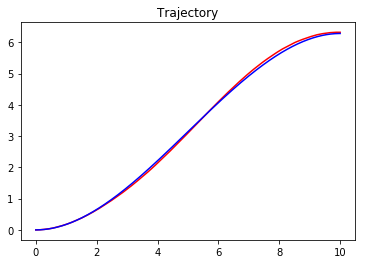

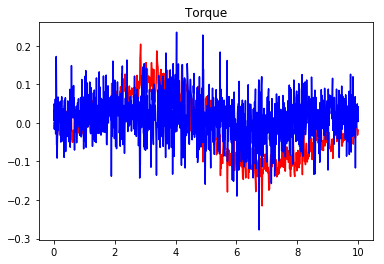

Value Loss : [ 29.49895477]
Policy Loss : [ 22.47042847]
EPISODE 129 STATE [-0.03535849  0.042514  ] REWARD  [ 1.92004478] ACTION ([ 0.03015021]) 1216642])          

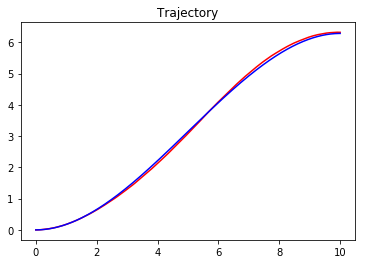

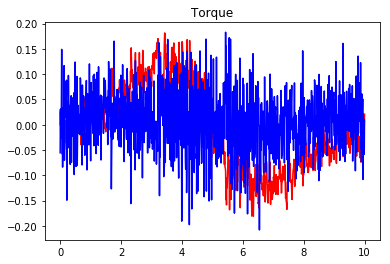

Value Loss : [ 29.20757484]
Policy Loss : [ 8.76481247]
EPISODE 130 STATE [-0.03320619  0.01362758] REWARD  [ 1.9501066] ACTION ([ 0.02804578])  620496])              

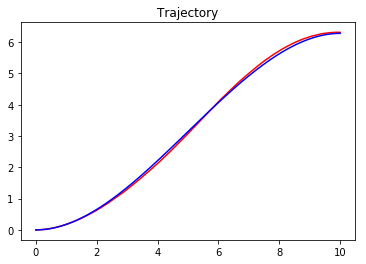

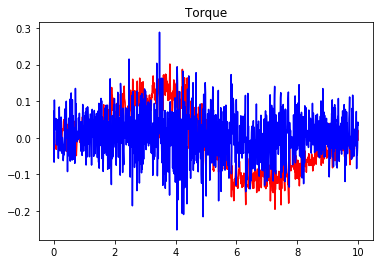

Value Loss : [ 32.04979706]
Policy Loss : [-14.49493408]
EPISODE 131 STATE [-0.03075494  0.02663955] REWARD  [ 1.93977607] ACTION ([-0.02515646]) 3555219])       

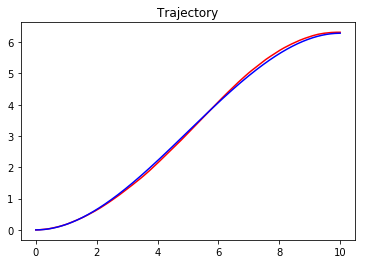

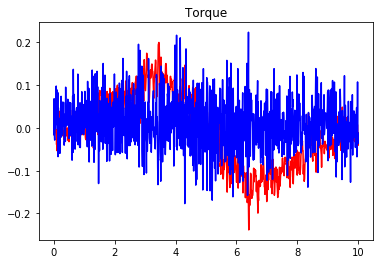

Value Loss : [ 31.28033447]
Policy Loss : [ 8.58816528]
EPISODE 132 STATE [-0.03587818  0.02046557] REWARD  [ 1.94082817] ACTION ([ 0.02197968]) 05]) 52])                         

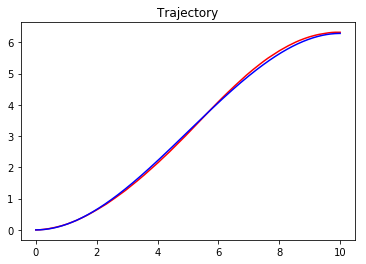

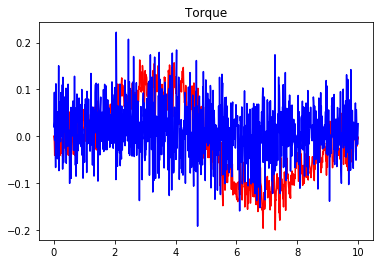

Value Loss : [ 26.69447899]
Policy Loss : [ 8.29780579]
EPISODE 133 STATE [-0.03347589  0.00285333] REWARD  [ 1.96049137] ACTION ([-0.05868671]) 05]) 58])                    

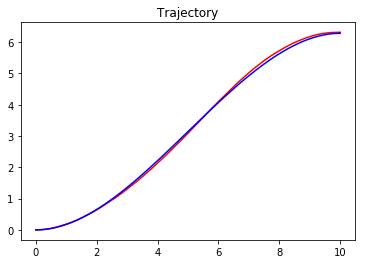

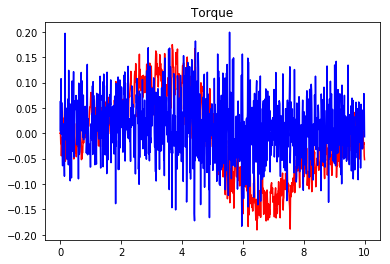

Value Loss : [ 28.33579636]
Policy Loss : [-6.49740028]
EPISODE 134 STATE [-0.02929445  0.04264135] REWARD  [ 1.92579447] ACTION ([-0.04986253]) 05]) 25])                   

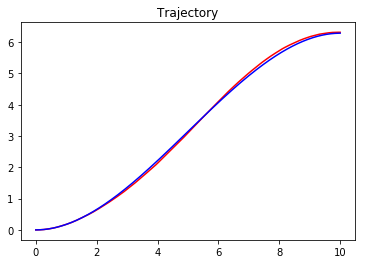

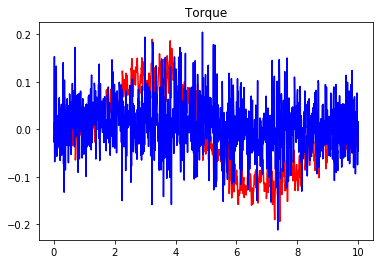

Value Loss : [ 31.43610001]
Policy Loss : [ 6.92172718]
EPISODE 135 STATE [-0.03541085  0.0323706 ] REWARD  [ 1.9297281] ACTION ([-0.02755747])  05]) 19])                

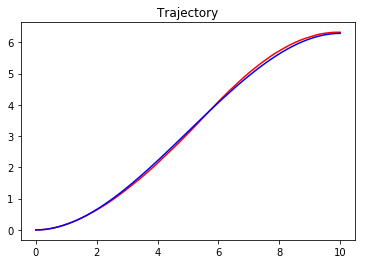

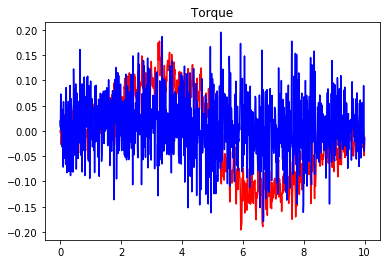

Value Loss : [ 27.84325981]
Policy Loss : [-0.13410012]
EPISODE 136 STATE [-0.03407266  0.03923745] REWARD  [ 1.92442023] ACTION ([-0.13879122]) 6904051])                       

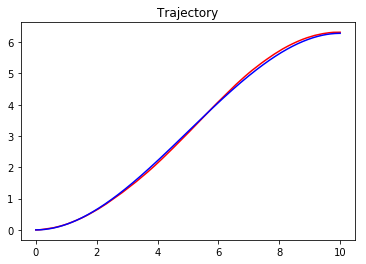

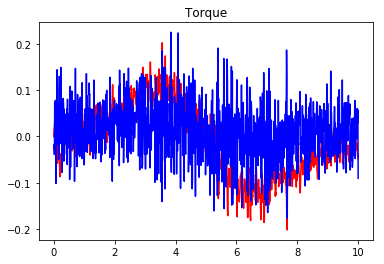

Value Loss : [ 31.81119919]
Policy Loss : [ 4.27419233]
EPISODE 137 STATE [-0.03865938  0.04092287] REWARD  [ 1.91838413] ACTION ([-0.00081912]) 05]) 59])                     

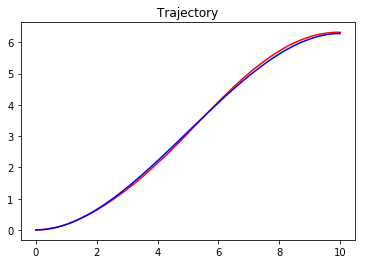

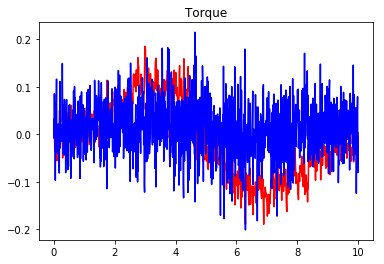

Value Loss : [ 24.96877098]
Policy Loss : [ 8.29175568]
EPISODE 138 STATE [-0.03656532  0.03762837] REWARD  [ 1.92355661] ACTION ([-0.04085258]) 4245806])                 

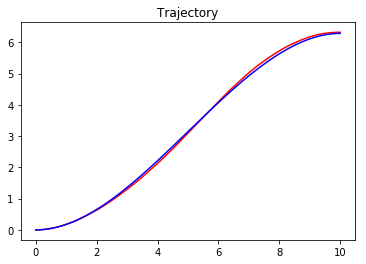

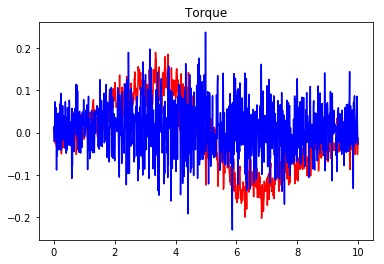

Value Loss : [ 28.66561317]
Policy Loss : [ 5.91425848]
EPISODE 139 STATE [-0.02957175  0.01317808] REWARD  [ 1.95407064] ACTION ([ 0.01232581]) 1293138])                 

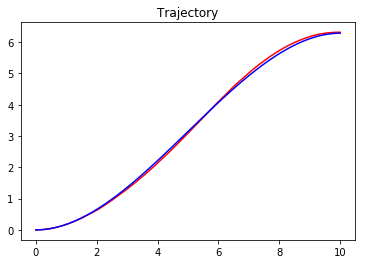

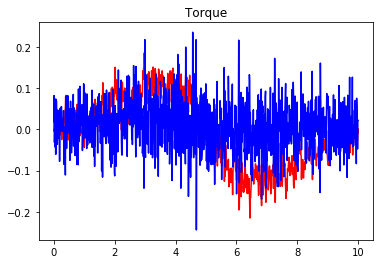

Value Loss : [ 28.1044426]
Policy Loss : [ 5.47997904]
EPISODE 140 STATE [-0.03404206 -0.00906087] REWARD  [ 1.96127585] ACTION ([ 0.02044317]) 05]) 65])                  

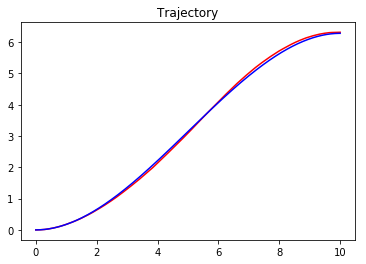

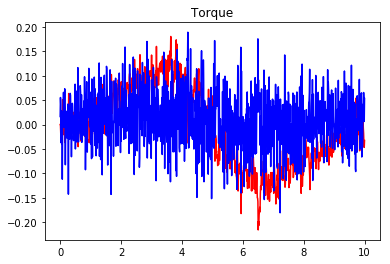

Value Loss : [ 26.69021988]
Policy Loss : [ 14.98867416]
EPISODE 141 STATE [-0.0389702   0.01752825] REWARD  [ 1.94072086] ACTION ([-0.02077897]) 0893159])               

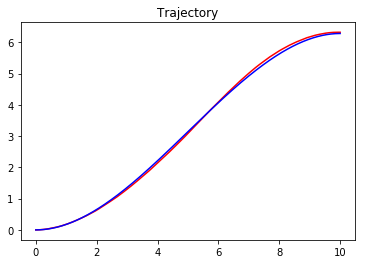

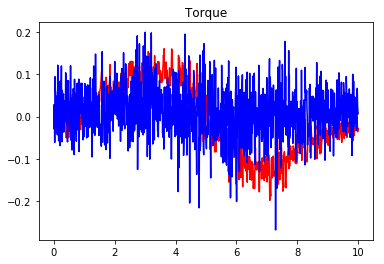

Value Loss : [ 30.10634804]
Policy Loss : [ 13.20785427]
EPISODE 142 STATE [-0.03566619  0.02404927] REWARD  [ 1.93754109] ACTION ([ 0.02554679]) 05]) 88])                   

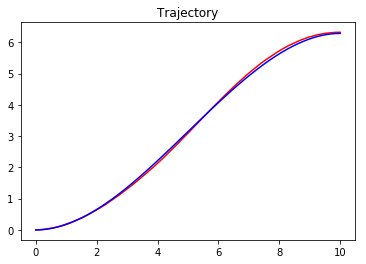

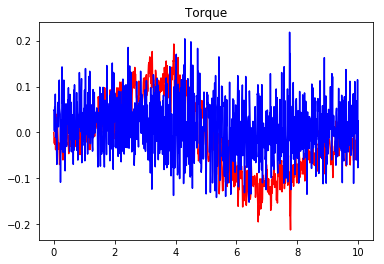

Value Loss : [ 32.04706573]
Policy Loss : [-7.53341866]
EPISODE 143 STATE [-0.03492853  0.01077102] REWARD  [ 1.9512532] ACTION ([ 0.02984413])  3490007])                         

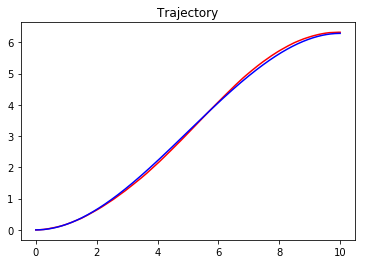

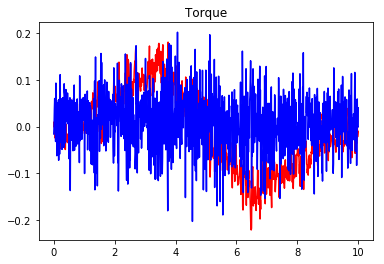

Value Loss : [ 27.23945618]
Policy Loss : [ 0.82702827]
EPISODE 144 STATE [-0.03370285 -0.00177365] REWARD  [ 1.96487897] ACTION ([ 0.05484601]) 05]) 99])          

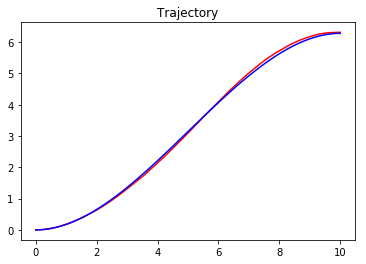

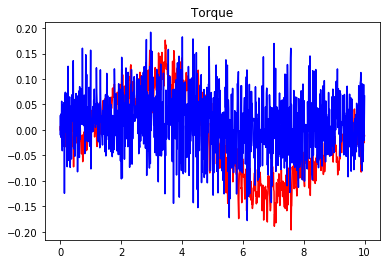

Value Loss : [ 29.26515388]
Policy Loss : [-3.07437301]
EPISODE 145 STATE [-0.03684121  0.0486191 ] REWARD  [ 1.91280341] ACTION ([ 0.00051182]) 255597])                    

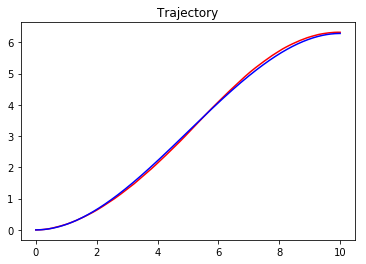

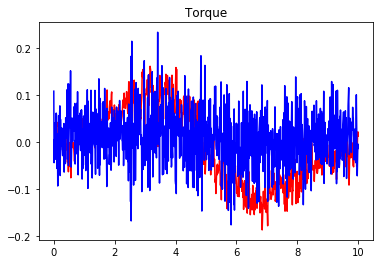

Value Loss : [ 26.77206802]
Policy Loss : [ 13.50107479]
EPISODE 146 STATE [-0.03255563 -0.00124267] REWARD  [ 1.96545904] ACTION ([ 0.08678111]) 05]) 16])             

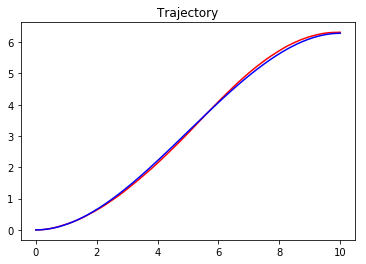

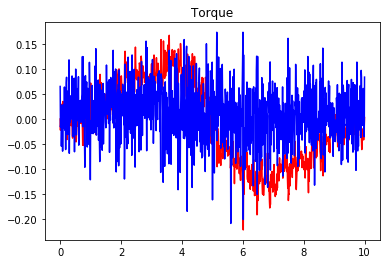

Value Loss : [ 21.67782593]
Policy Loss : [ 1.52925253]
EPISODE 147 STATE [-0.03423456  0.00392788] REWARD  [ 1.95869106] ACTION ([-0.08210228]) 558237])                      

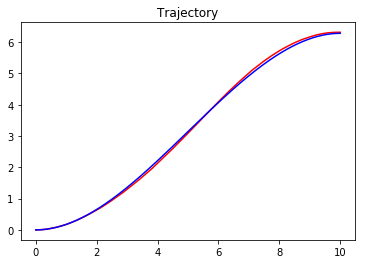

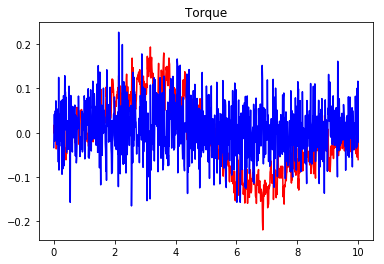

Value Loss : [ 26.40379715]
Policy Loss : [ 5.10341549]
EPISODE 148 STATE [-0.03144435  0.03258684] REWARD  [ 1.93335574] ACTION ([-0.00506483]) 1807077])                    

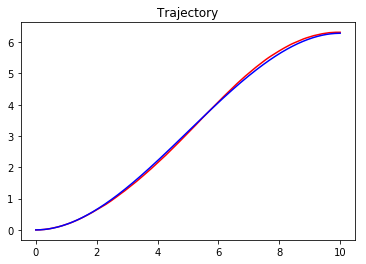

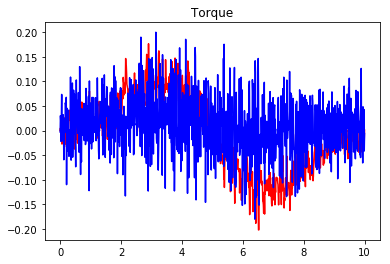

Value Loss : [ 27.66884422]
Policy Loss : [ 20.90418434]
EPISODE 149 STATE [-0.03588405  0.05312082] REWARD  [ 1.90946408] ACTION ([-0.03520439]) 8833265])              

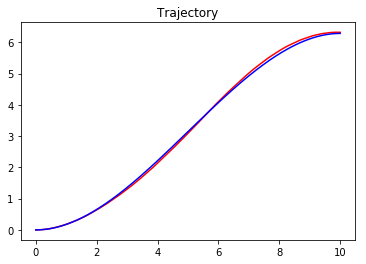

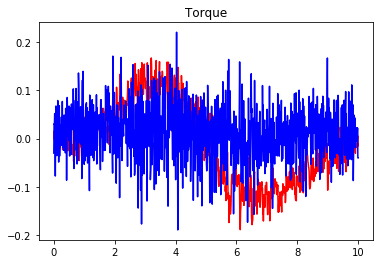

Value Loss : [ 25.54900551]
Policy Loss : [ 0.39541531]
EPISODE 150 STATE [-0.03260131  0.02910271] REWARD  [ 1.9356008] ACTION ([-0.00059141])  1479568])        

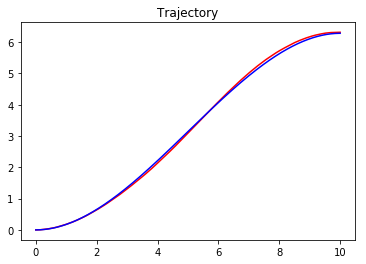

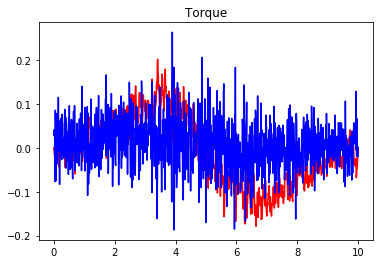

Value Loss : [ 26.59800148]
Policy Loss : [ 19.5616684]
EPISODE 151 STATE [-0.03810094  0.0382353 ] REWARD  [ 1.9214951] ACTION ([ 0.01728211])  613087])                    

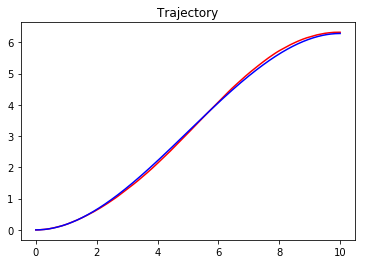

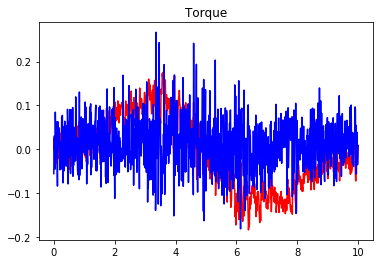

Value Loss : [ 28.58458138]
Policy Loss : [ 16.56464767]
EPISODE 152 STATE [-0.03671033  0.02011484] REWARD  [ 1.94036805] ACTION ([-0.1222558])  8650277])               

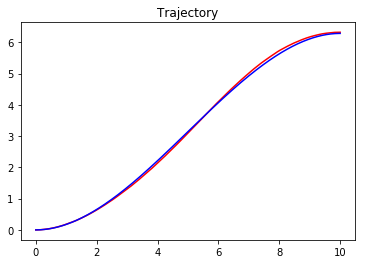

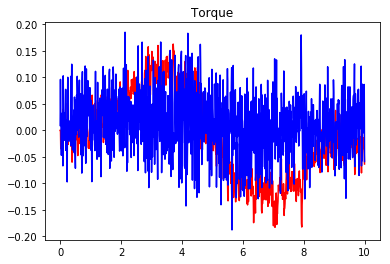

Value Loss : [ 34.10153198]
Policy Loss : [ 11.45148373]
EPISODE 153 STATE [-0.03374861  0.0237424 ] REWARD  [ 1.9396918] ACTION ([ 0.01195985])  3211853])                      

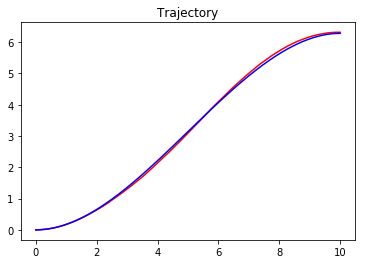

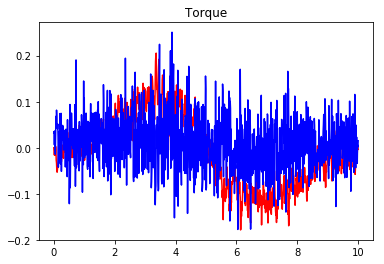

Value Loss : [ 25.63626862]
Policy Loss : [ 11.67197895]
EPISODE 154 STATE [-0.03379043  0.02373488] REWARD  [ 1.93965868] ACTION ([ 0.02913566]) 7688977])                       

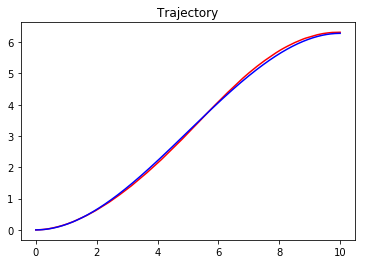

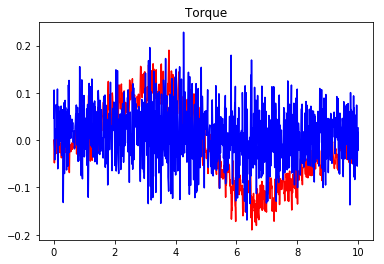

Value Loss : [ 24.81503105]
Policy Loss : [ 8.77441883]
EPISODE 155 STATE [-0.03422097 -0.00239296] REWARD  [ 1.9649964] ACTION ([ 0.05904593])  05]) 15])                 

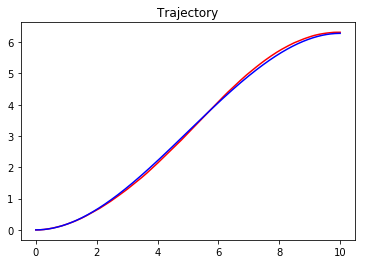

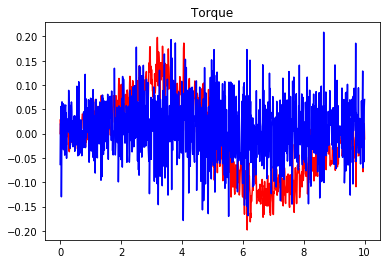

Value Loss : [ 29.07531357]
Policy Loss : [-0.05050609]
EPISODE 156 STATE [-0.03923229  0.04899165] REWARD  [ 1.91014806] ACTION ([-0.01438355]) 4530448])                

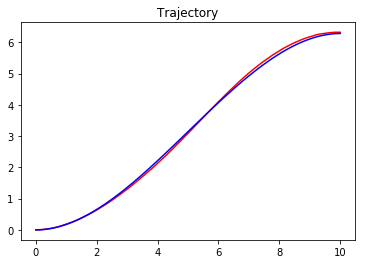

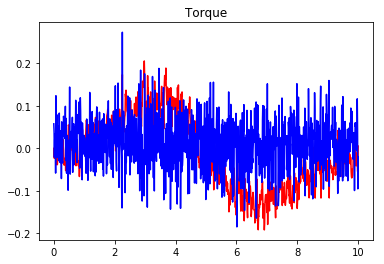

Value Loss : [ 27.42097664]
Policy Loss : [ 4.12252855]
EPISODE 157 STATE [-0.03609503  0.01176461] REWARD  [ 1.94914862] ACTION ([-0.04381011]) 05]) 43])       

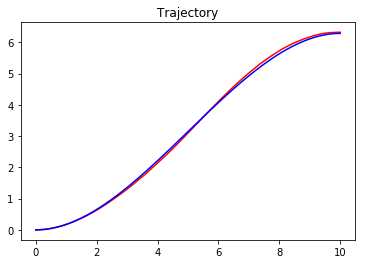

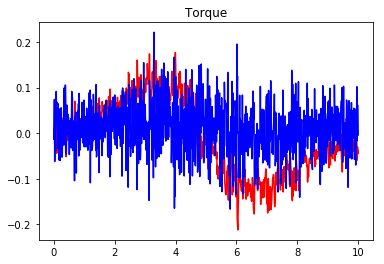

Value Loss : [ 25.40081215]
Policy Loss : [ 6.70776749]
EPISODE 158 STATE [-0.04142165 -0.01250207] REWARD  [ 1.95075219] ACTION ([ 0.07588312]) 653758])           

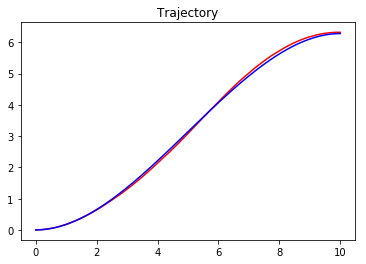

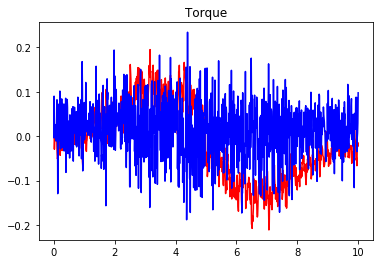

Value Loss : [ 32.41133118]
Policy Loss : [-0.00651522]
EPISODE 159 STATE [-0.03492983  0.028251  ] REWARD  [ 1.93417407] ACTION ([-0.05215691]) 05]) 72])                

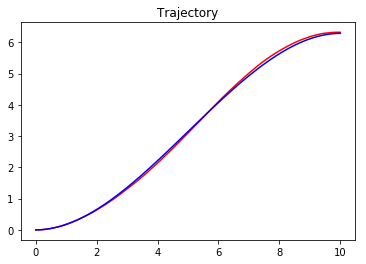

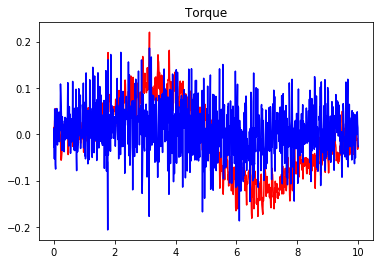

Value Loss : [ 27.24969864]
Policy Loss : [ 9.4841423]
EPISODE 160 STATE [-0.03955932  0.00750113] REWARD  [ 1.95001958] ACTION ([ 0.09929719]) 4596907])                 

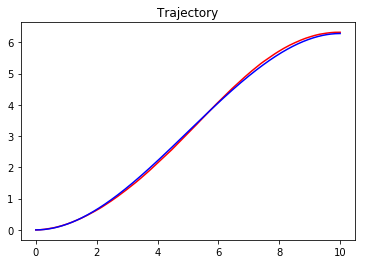

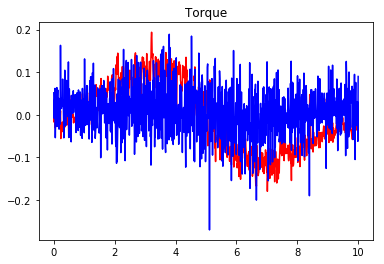

Value Loss : [ 29.68489456]
Policy Loss : [-1.43607378]
EPISODE 161 STATE [-0.03386691  0.04726498] REWARD  [ 1.91696032] ACTION ([-0.05237121]) 05]) 52])               

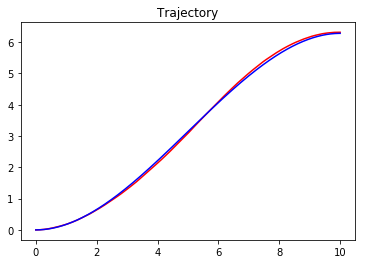

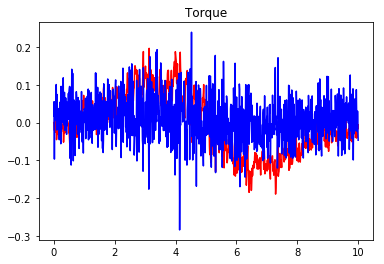

Value Loss : [ 27.98761368]
Policy Loss : [-7.02809668]
EPISODE 162 STATE [-0.0364897   0.02756997] REWARD  [ 1.93332868] ACTION ([ 0.02210085]) 0131059])                  

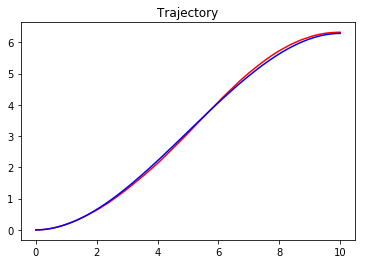

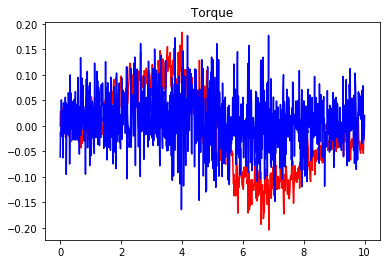

Value Loss : [ 22.89866829]
Policy Loss : [ 1.33733463]
EPISODE 163 STATE [-0.0345208   0.04986361] REWARD  [ 1.91386228] ACTION ([-0.09561115]) 2944565])                     

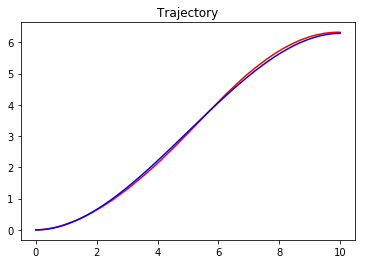

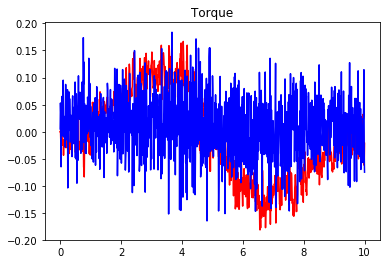

Value Loss : [ 29.18798637]
Policy Loss : [-0.79605669]
EPISODE 164 STATE [-0.03344962  0.01829846] REWARD  [ 1.94529154] ACTION ([-0.06844121]) 464457])                    

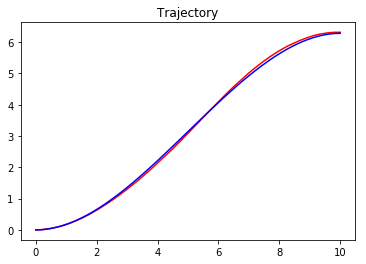

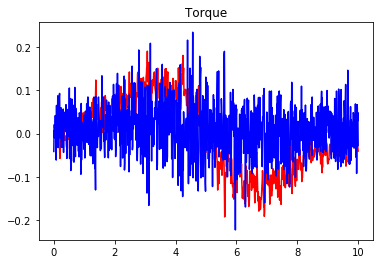

Value Loss : [ 29.01299858]
Policy Loss : [ 8.75259686]
EPISODE 165 STATE [-0.03590727  0.04179595] REWARD  [ 1.92020101] ACTION ([-0.02948834]) 0811995])                 

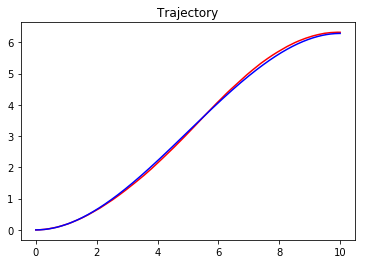

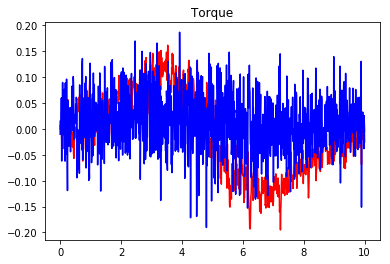

Value Loss : [ 29.46804237]
Policy Loss : [ 9.13415909]
EPISODE 166 STATE [-0.03939175  0.03473124] REWARD  [ 1.92361912] ACTION ([ 0.03475074]) 6352844])              

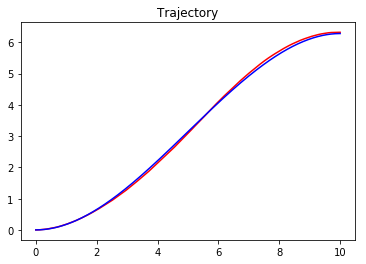

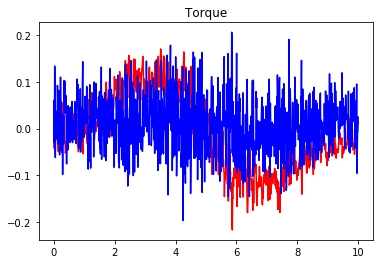

Value Loss : [ 26.00657654]
Policy Loss : [-6.71221399]
EPISODE 167 STATE [-0.03768441 -0.02627027] REWARD  [ 1.94078955] ACTION ([ 0.03798686]) 3761435])               

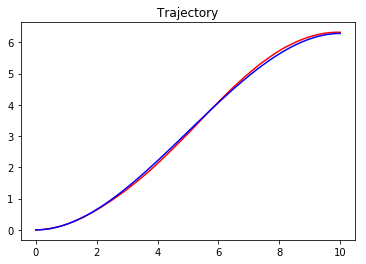

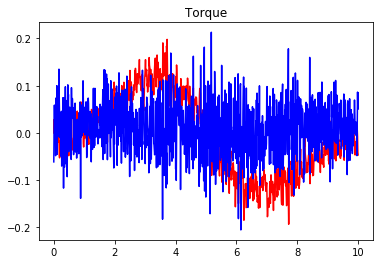

Value Loss : [ 29.38866425]
Policy Loss : [-2.16822505]
EPISODE 168 STATE [-0.03502462 -0.01341425] REWARD  [ 1.95600561] ACTION ([ 0.02231358]) 4761815])            

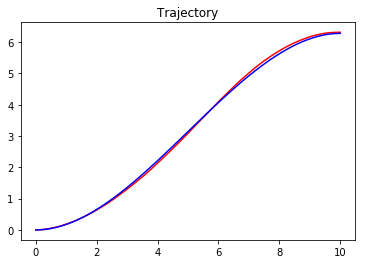

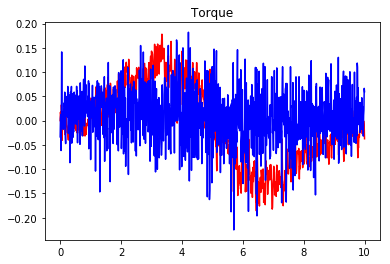

Value Loss : [ 29.61711311]
Policy Loss : [ 7.94111109]
EPISODE 169 STATE [-0.03768034  0.01453432] REWARD  [ 1.94489746] ACTION ([ 0.03197396]) 63786]) )                             

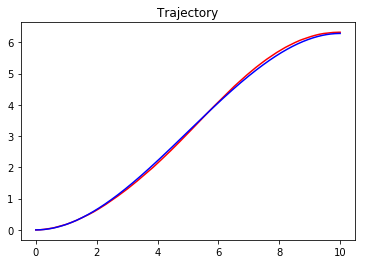

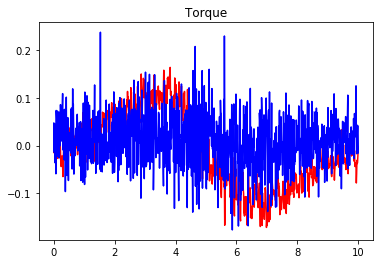

Value Loss : [ 27.78766632]
Policy Loss : [ 7.0246954]
EPISODE 170 STATE [-0.03512135  0.05415001] REWARD  [ 1.90922842] ACTION ([-0.01323389]) 3065]) ])                                     

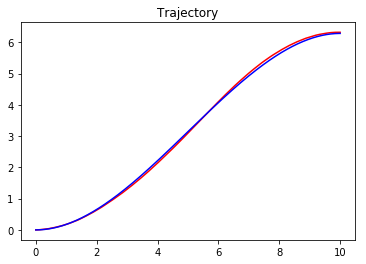

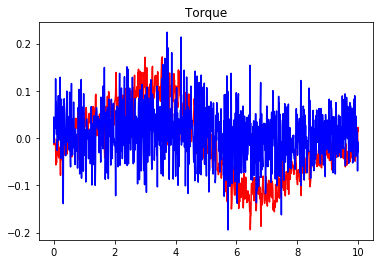

Value Loss : [ 24.54857445]
Policy Loss : [ 12.18384743]
EPISODE 171 STATE [-0.03290483  0.0284281 ] REWARD  [ 1.93596007] ACTION ([-0.01921753]) 05]) 27])                         

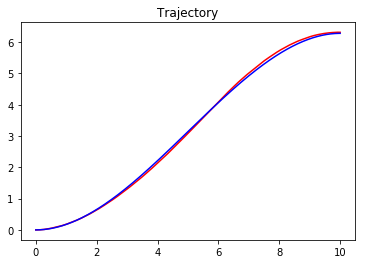

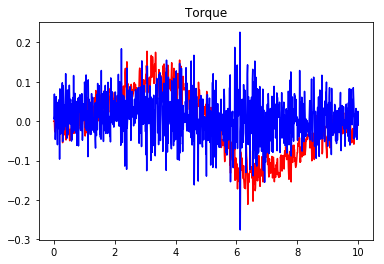

Value Loss : [ 26.08474922]
Policy Loss : [ 2.44343019]
EPISODE 172 STATE [-0.03361283  0.02232646] REWARD  [ 1.94120156] ACTION ([-0.0600254])  6439844])              

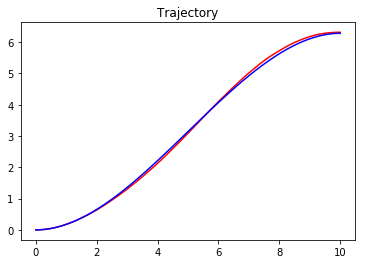

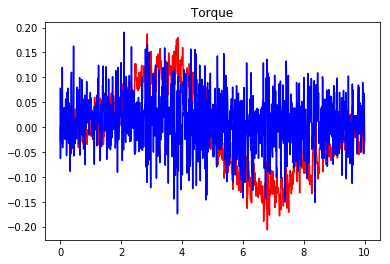

Value Loss : [ 33.24281311]
Policy Loss : [ 2.50515747]
EPISODE 173 STATE [-0.0385164   0.02364622] REWARD  [ 1.93518668] ACTION ([-0.03415679]) 05]) 6])                                

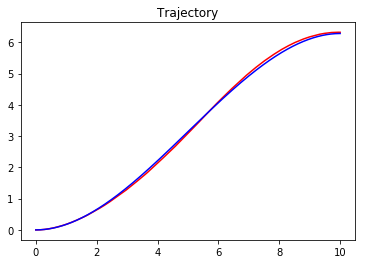

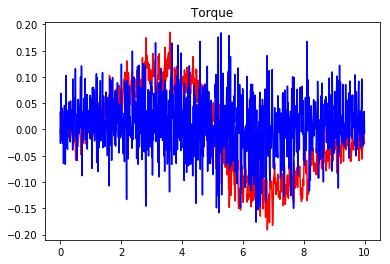

Value Loss : [ 29.10027122]
Policy Loss : [ 9.15399647]
EPISODE 174 STATE [-0.03362923  0.02830974] REWARD  [ 1.93537398] ACTION ([-0.07023853]) 05]) 52])                              

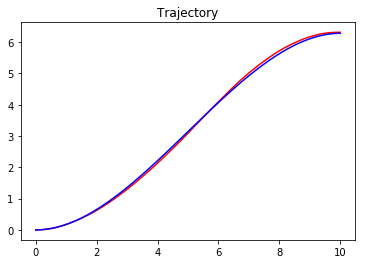

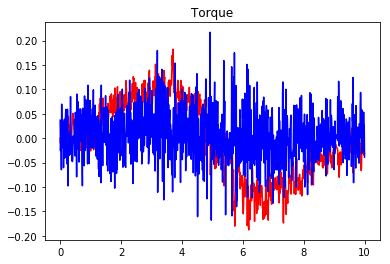

Value Loss : [ 25.06196976]
Policy Loss : [ 5.73139095]
EPISODE 175 STATE [-0.03518875  0.00028601] REWARD  [ 1.96138992] ACTION ([-0.01669871]) 2948105])                          

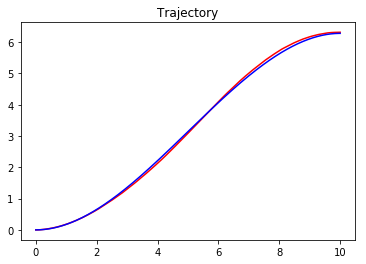

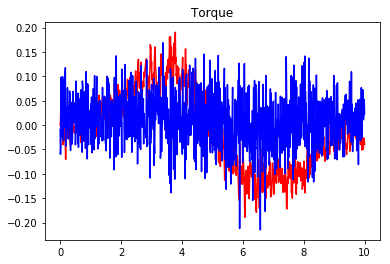

Value Loss : [ 30.19650459]
Policy Loss : [ 14.0039444]
EPISODE 176 STATE [-0.0360825   0.00634373] REWARD  [ 1.9545125] ACTION ([-0.00116915])  3261389])                      

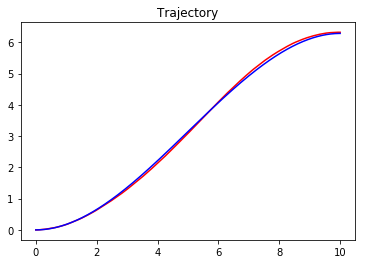

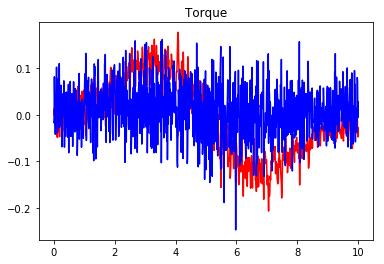

Value Loss : [ 29.08360863]
Policy Loss : [ 9.58236694]
EPISODE 177 STATE [-0.03505835 -0.00354524] REWARD  [ 1.96533887] ACTION ([-0.01918984]) 05]) 95])                               

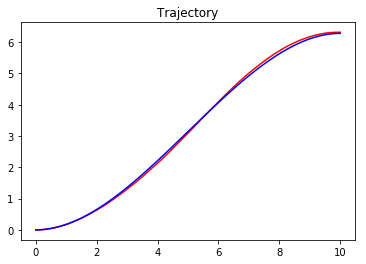

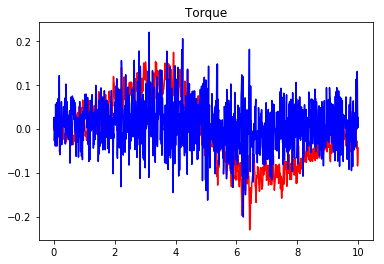

Value Loss : [ 31.70122528]
Policy Loss : [ 17.8765316]
EPISODE 178 STATE [-0.03670793  0.02476871] REWARD  [ 1.93583691] ACTION ([-0.01237552]) 7808874])                            

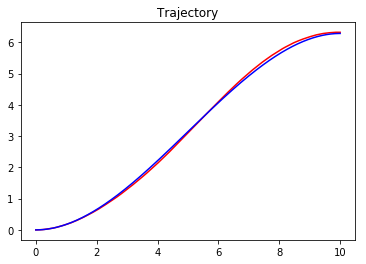

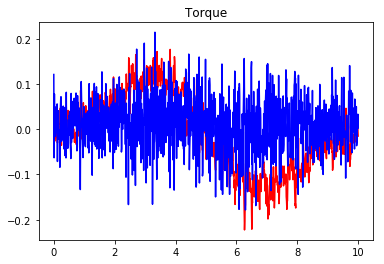

Value Loss : [ 34.60742188]
Policy Loss : [ 1.37140489]
EPISODE 179 STATE [-0.0357981   0.04093455] REWARD  [ 1.92112973] ACTION ([ 0.05248887]) 4138711])                           

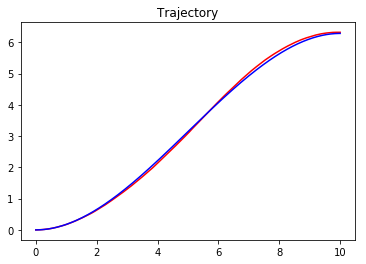

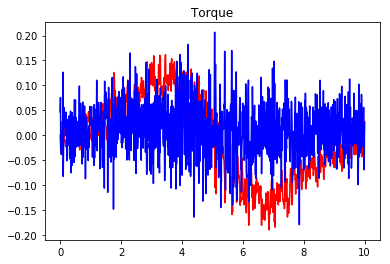

Value Loss : [ 26.82379532]
Policy Loss : [ 2.01983333]
EPISODE 180 STATE [-0.0364862   0.03852359] REWARD  [ 1.92277437] ACTION ([-0.03391741]) 06]) 87])                                   

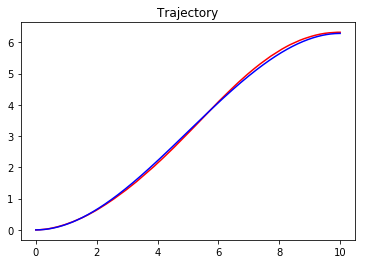

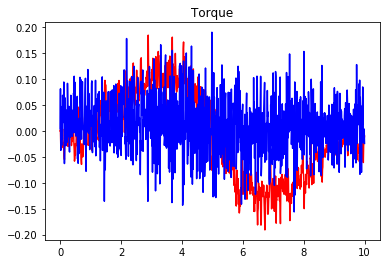

Value Loss : [ 33.0246315]
Policy Loss : [ 1.95688069]
EPISODE 181 STATE [-0.03592057  0.03081473] REWARD  [ 1.93073805] ACTION ([-0.07355351]) 05]) 96])                        

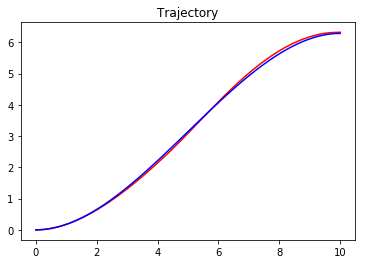

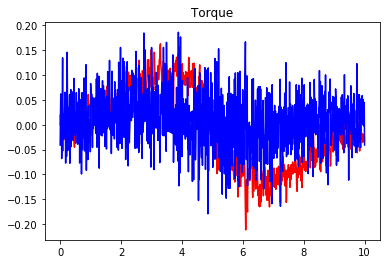

Value Loss : [ 29.78045654]
Policy Loss : [ 19.98815346]
EPISODE 182 STATE [-0.03392326  0.00801152] REWARD  [ 1.95494789] ACTION ([-0.02431605]) 1803306])                          

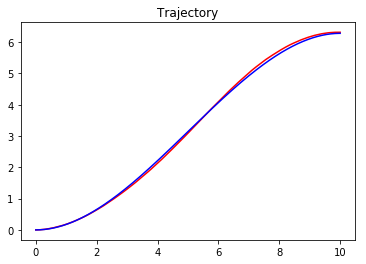

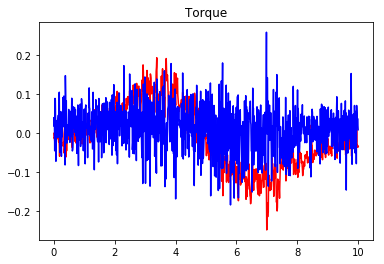

Value Loss : [ 40.85041046]
Policy Loss : [-8.53582287]
EPISODE 183 STATE [-0.03181911 -0.00599744] REWARD  [ 1.96647878] ACTION ([-0.00026444]) 4898101])                            

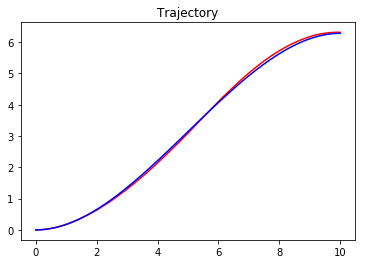

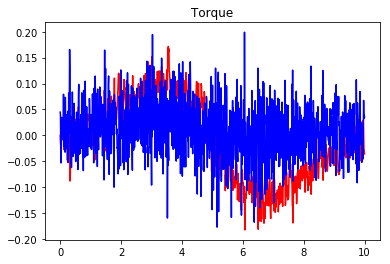

Value Loss : [ 28.02409172]
Policy Loss : [ 12.92109966]
EPISODE 184 STATE [-0.03623674  0.01274183] REWARD  [ 1.94805027] ACTION ([ 0.04123307]) 2670097])                             

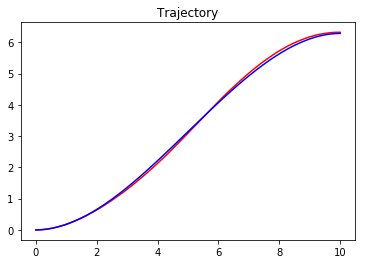

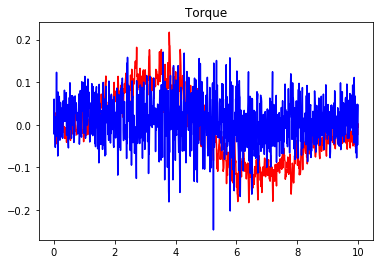

Value Loss : [ 31.37845993]
Policy Loss : [-5.46496296]
EPISODE 185 STATE [-0.03392639  0.01356481] REWARD  [ 1.94947184] ACTION ([ 0.1120019])  2296748])                              

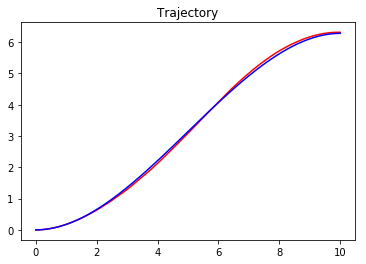

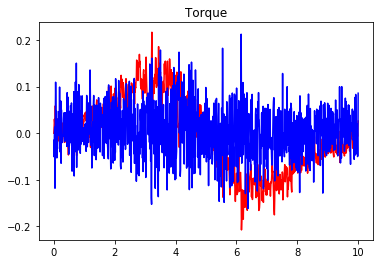

Value Loss : [ 28.15900993]
Policy Loss : [ 8.44703293]
EPISODE 186 STATE [-0.03655419  0.0368968 ] REWARD  [ 1.9242695] ACTION ([-0.04763943])  05])683])                          

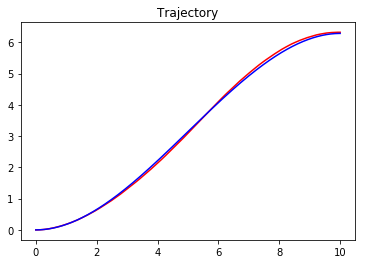

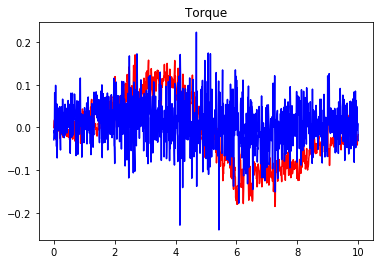

Value Loss : [ 27.07896805]
Policy Loss : [ 22.03494835]
EPISODE 187 STATE [-0.03749328  0.03172134] REWARD  [ 1.9283466] ACTION ([-0.06643757])  05]) 64])                

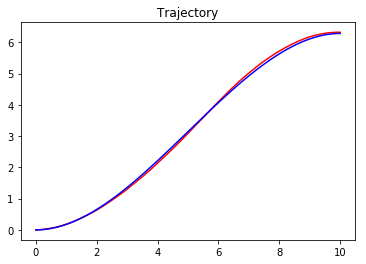

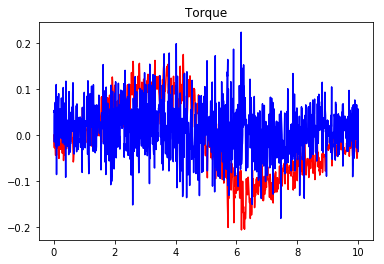

Value Loss : [ 29.79247665]
Policy Loss : [ 10.97632694]
EPISODE 188 STATE [-0.03615948  0.05214812] REWARD  [ 1.91011774] ACTION ([-0.01289969]) 05]) 69])                   

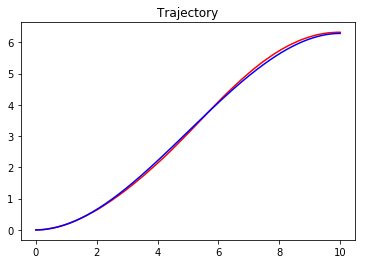

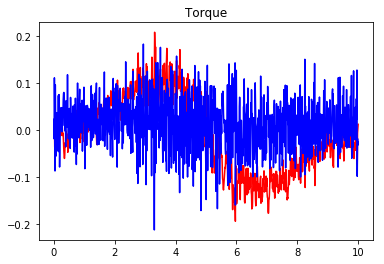

Value Loss : [ 26.65372658]
Policy Loss : [-5.72122478]
EPISODE 189 STATE [-0.03557352  0.00389748] REWARD  [ 1.95742818] ACTION ([-0.00976785]) 05]) 83])          

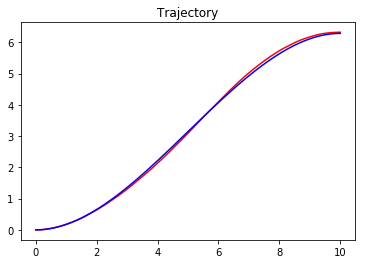

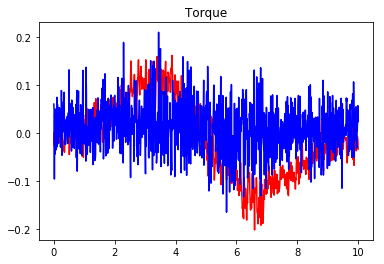

Value Loss : [ 27.93334198]
Policy Loss : [ 15.53295326]
EPISODE 190 STATE [-0.03424323  0.01369789] REWARD  [ 1.94903483] ACTION ([ 0.01028594]) 8123292])                 

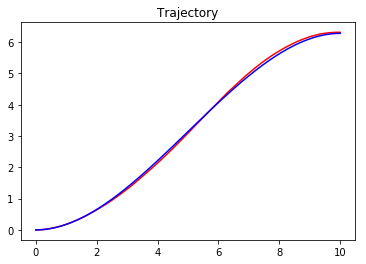

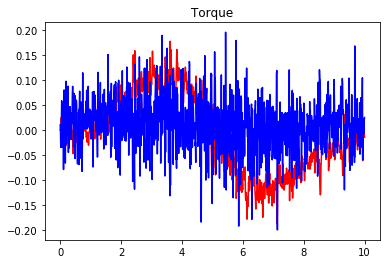

Value Loss : [ 30.9497509]
Policy Loss : [ 5.7777915]
EPISODE 191 STATE [-0.03627381  0.0148075 ] REWARD  [ 1.94598477] ACTION ([-0.03334238]) 148511])          

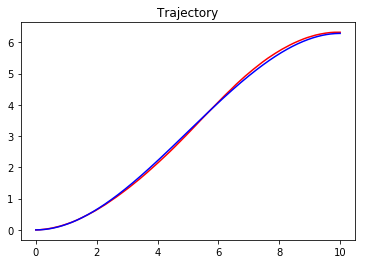

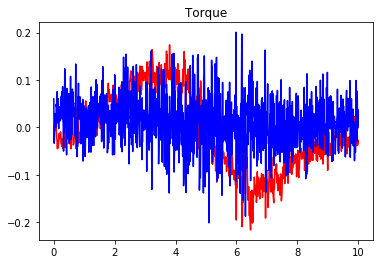

Value Loss : [ 29.39458466]
Policy Loss : [ 8.62838364]
EPISODE 192 STATE [-0.03579447  0.02089146] REWARD  [ 1.94049334] ACTION ([-0.0549437])  05]) 47])            

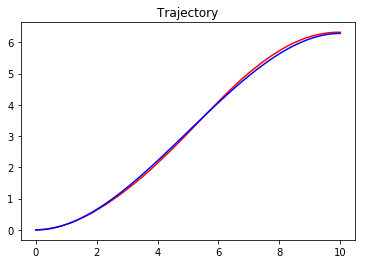

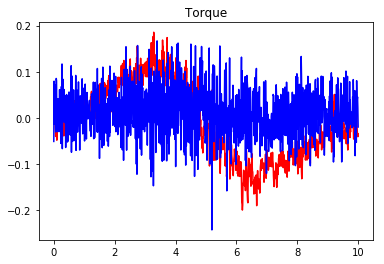

Value Loss : [ 26.24093819]
Policy Loss : [ 3.81584024]
EPISODE 193 STATE [-0.03774682  0.02067464] REWARD  [ 1.938823] ACTION ([-0.04110036]) ) 5393982])       

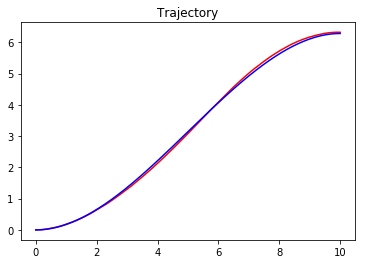

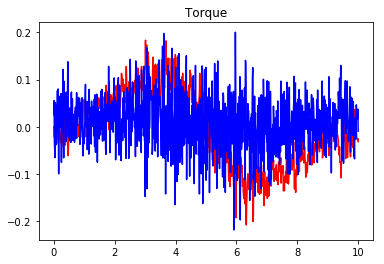

Value Loss : [ 33.7732048]
Policy Loss : [ 16.19947052]
EPISODE 194 STATE [-0.03415703 -0.00437361] REWARD  [ 1.96583821] ACTION ([ 0.07121912]) 5129646])             

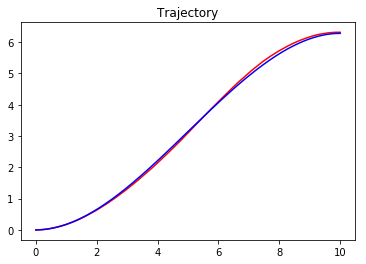

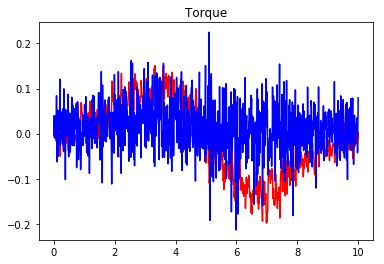

Value Loss : [ 33.49083328]
Policy Loss : [ 15.94534874]
EPISODE 195 STATE [-0.03978842  0.02128231] REWARD  [ 1.93626617] ACTION ([ 0.01477158]) 471322])          

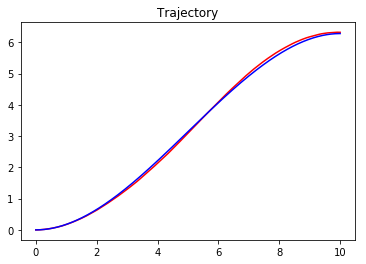

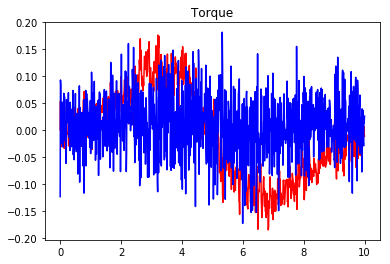

Value Loss : [ 31.86400604]
Policy Loss : [ 21.05317307]
EPISODE 196 STATE [-0.03583404  0.00131794] REWARD  [ 1.95973991] ACTION ([-0.05551891]) 074241])            

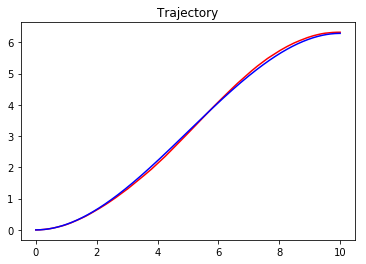

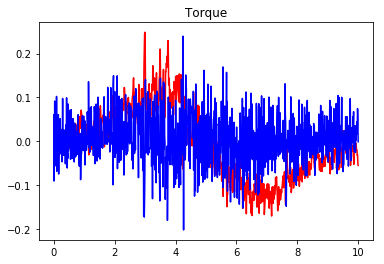

Value Loss : [ 36.05361557]
Policy Loss : [ 1.57418251]
EPISODE 197 STATE [-0.03354819  0.00715896] REWARD  [ 1.95615345] ACTION ([-0.02089465]) 410725])                 

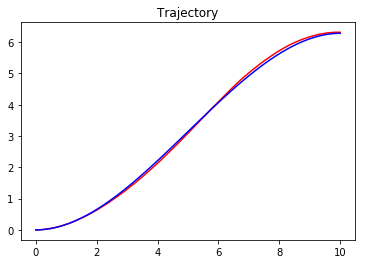

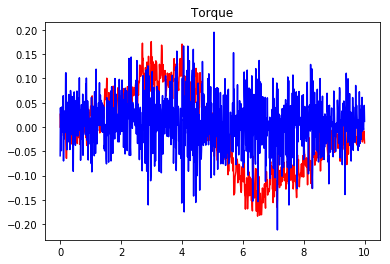

Value Loss : [ 24.45417404]
Policy Loss : [ 7.67731953]
EPISODE 198 STATE [-0.03395641  0.0067451 ] REWARD  [ 1.95616822] ACTION ([ 0.06396572]) 49399]) )          

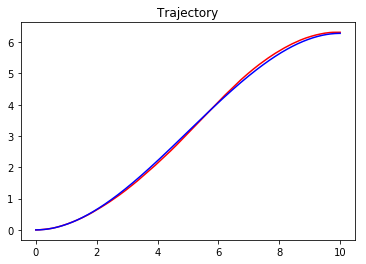

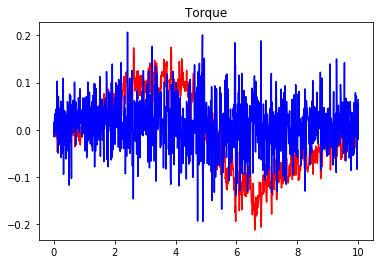

Value Loss : [ 29.11255836]
Policy Loss : [ 1.81936502]
EPISODE 199 STATE [-0.03196093 -0.01089248] REWARD  [ 1.96146917] ACTION ([-0.01235465]) 2684974])            

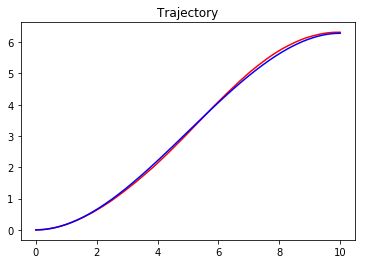

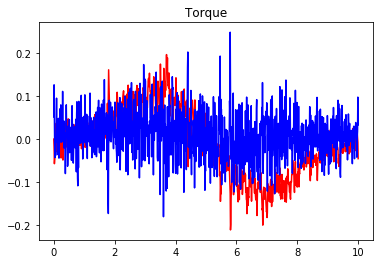

Value Loss : [ 31.62327194]
Policy Loss : [-6.68406057]
EPISODE 200 STATE [-0.03712838  0.02123495] REWARD  [ 1.93887209] ACTION ([ 0.0181947])  772725])               

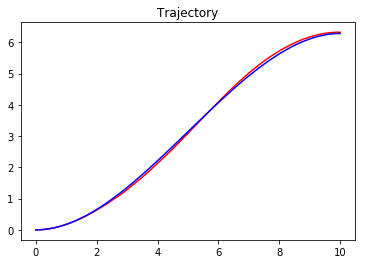

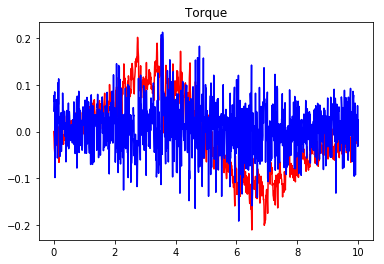

Value Loss : [ 33.62482452]
Policy Loss : [ 16.41537857]
EPISODE 201 STATE [-0.03607244  0.02228636] REWARD  [ 1.93886521] ACTION ([ 0.03575537]) 4508535])                  

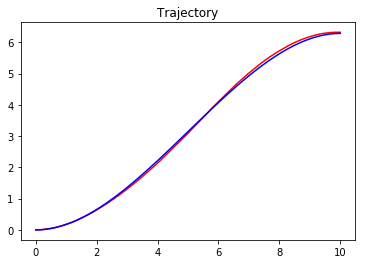

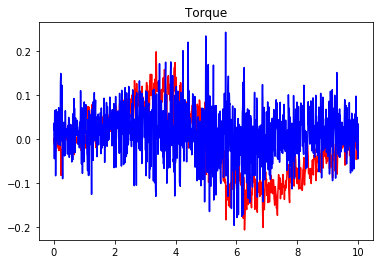

Value Loss : [ 40.56531525]
Policy Loss : [ 16.18169212]
EPISODE 202 STATE [-0.03288452  0.04647559] REWARD  [ 1.91866089] ACTION ([-0.05542671]) 06]) 12])              

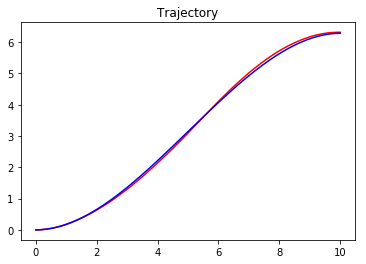

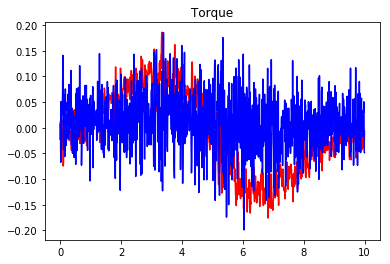

Value Loss : [ 29.7066555]
Policy Loss : [ 2.4633925]
EPISODE 203 STATE [-0.0367693   0.00617885] REWARD  [ 1.95401349] ACTION ([-0.03432894]) 2684834])                      

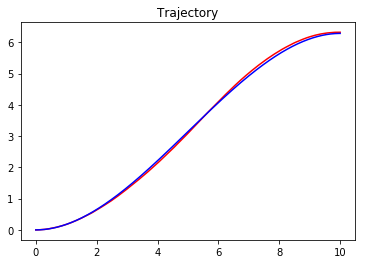

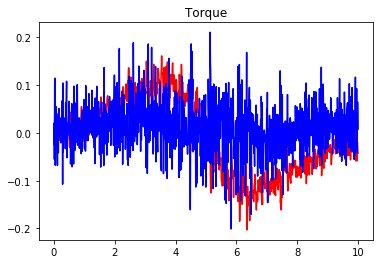

Value Loss : [ 31.35670853]
Policy Loss : [ 21.81933403]
EPISODE 204 STATE [-0.03318371  0.04676764] REWARD  [ 1.91809371] ACTION ([ 0.01326802]) 4111392])         

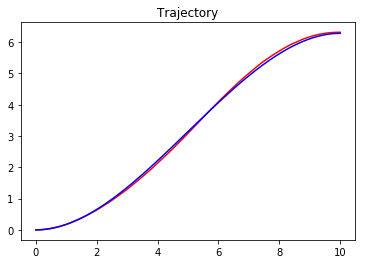

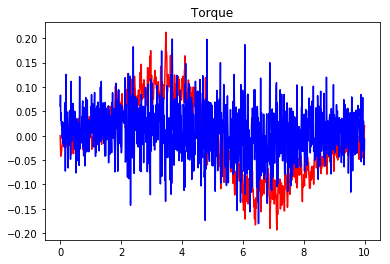

Value Loss : [ 28.23184967]
Policy Loss : [ 12.97538853]
EPISODE 205 STATE [-0.03373746  0.00197072] REWARD  [ 1.9611156] ACTION ([ 0.08020273])  9374803])             

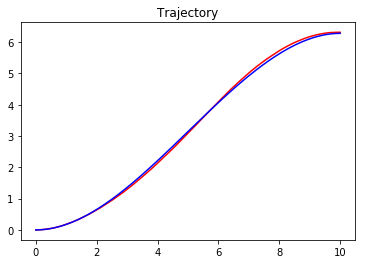

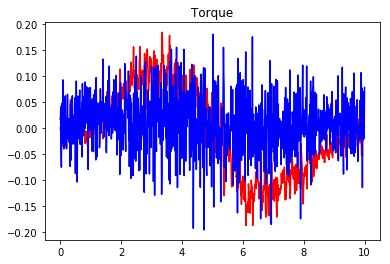

Value Loss : [ 25.82381248]
Policy Loss : [ 8.54432106]
EPISODE 206 STATE [-0.03348497  0.03436518] REWARD  [ 1.92966695] ACTION ([-0.00782737]) 06]) 55])             

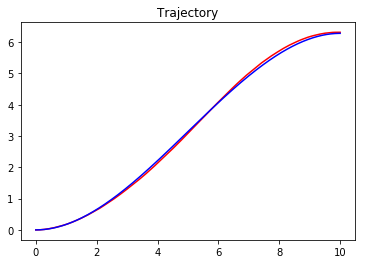

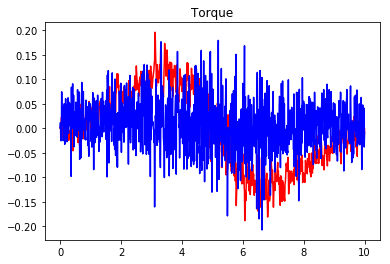

Value Loss : [ 23.96936607]
Policy Loss : [ 16.1664505]
EPISODE 207 STATE [-0.03709054  0.02294911] REWARD  [ 1.93723817] ACTION ([-0.03000814]) 1231914])                

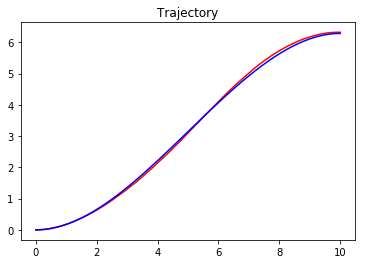

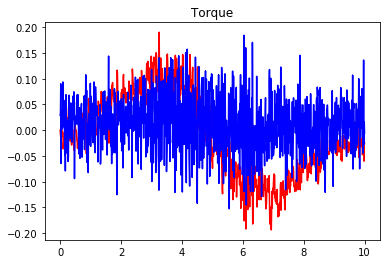

Value Loss : [ 27.28499794]
Policy Loss : [-4.13472605]
EPISODE 208 STATE [-0.03821026  0.04015032] REWARD  [ 1.91955538] ACTION ([-0.04394198]) 3944625])                    

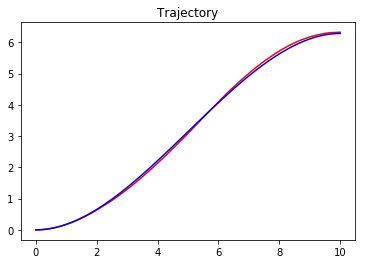

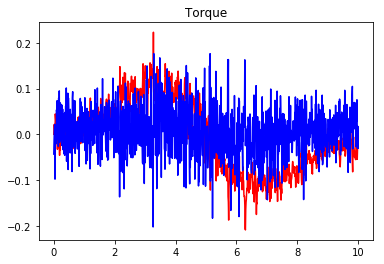

Value Loss : [ 32.04434204]
Policy Loss : [ 10.63534546]
EPISODE 209 STATE [-0.03771454  0.03111488] REWARD  [ 1.92871899] ACTION ([-0.03159064]) 637012])                             

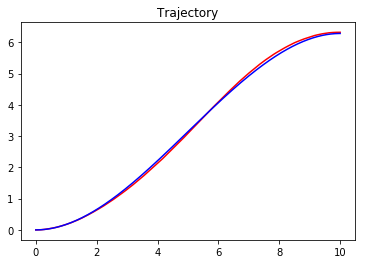

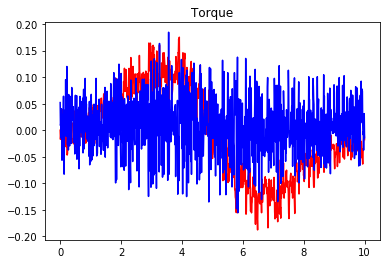

Value Loss : [ 29.71576118]
Policy Loss : [-5.61749077]
EPISODE 210 STATE [-0.03689465  0.03285777] REWARD  [ 1.92782721] ACTION ([-0.00523261]) 0172856])                         

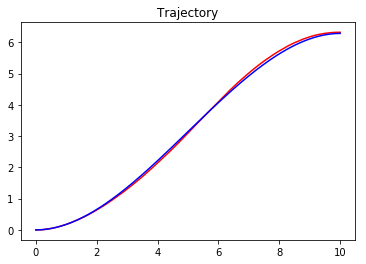

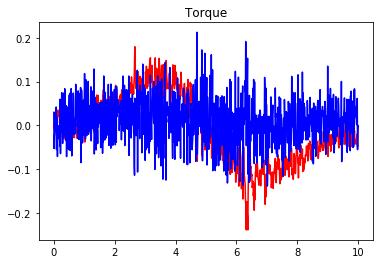

Value Loss : [ 31.45572281]
Policy Loss : [ 14.83283329]
EPISODE 211 STATE [-0.03240383 -0.00124952] REWARD  [ 1.96561283] ACTION ([ 0.01740488]) 07]) 11])                  

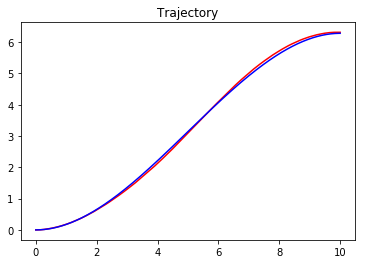

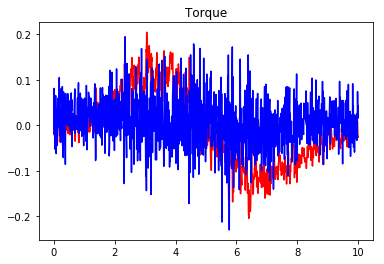

Value Loss : [ 31.82235336]
Policy Loss : [ 22.33582878]
EPISODE 212 STATE [-0.03612057 -0.00969396] REWARD  [ 1.9586394] ACTION ([-0.00986863])  05]) 86])                   

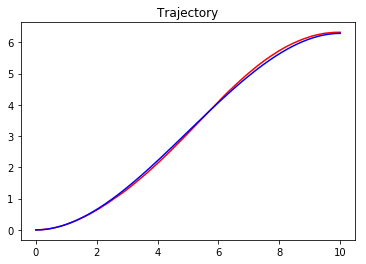

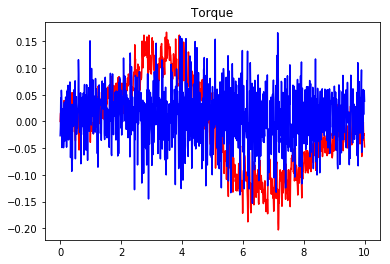

Value Loss : [ 30.2684536]
Policy Loss : [ 4.15846252]
EPISODE 213 STATE [-0.03475452  0.02983275] REWARD  [ 1.9328127] ACTION ([ 0.03240509])  06]) 91])              

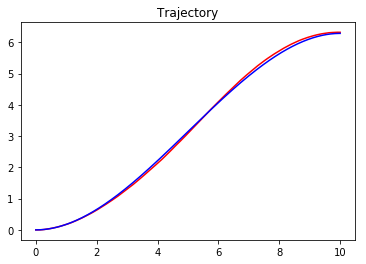

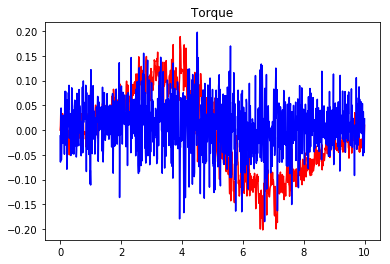

Value Loss : [ 32.71325302]
Policy Loss : [ 2.50682926]
EPISODE 214 STATE [-0.03553805  0.01731143] REWARD  [ 1.94423984] ACTION ([-0.01146623]) 05]) 02]) 05])          

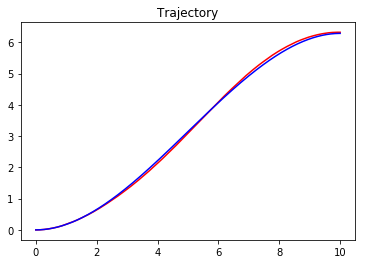

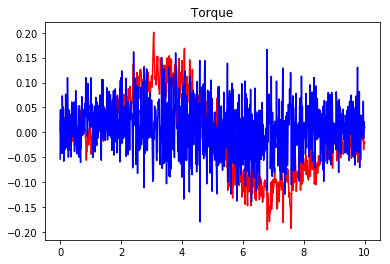

Value Loss : [ 30.77166176]
Policy Loss : [ 2.35930657]
EPISODE 215 STATE [-0.0357865   0.01375906] REWARD  [ 1.94748453] ACTION ([-0.02888134]) 2448883])           

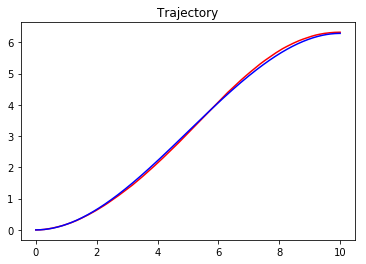

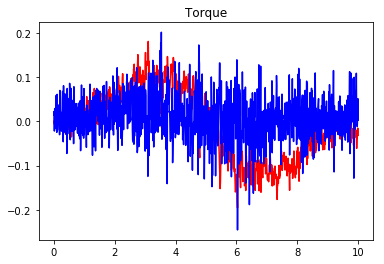

Value Loss : [ 26.97509193]
Policy Loss : [ 6.19854307]
EPISODE 216 STATE [-0.03789043  0.05719346] REWARD  [ 1.90369075] ACTION ([-0.07227368]) 8609278])                

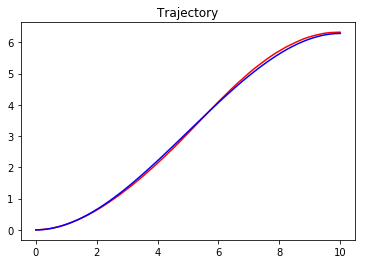

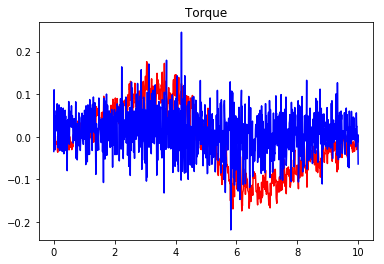

Value Loss : [ 27.83202744]
Policy Loss : [ 14.14305592]
EPISODE 217 STATE [-0.03315659  0.00321661] REWARD  [ 1.96043939] ACTION ([ 0.03471556]) 2941731])                    

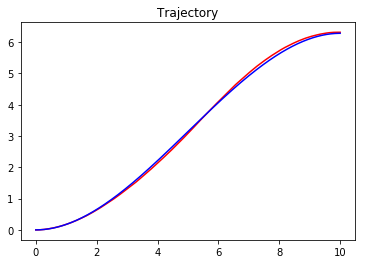

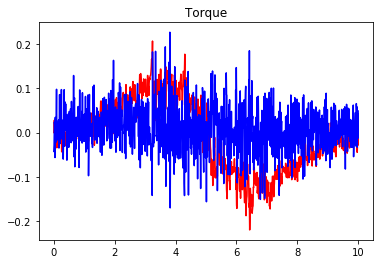

Value Loss : [ 27.87338448]
Policy Loss : [ 15.32627201]
EPISODE 218 STATE [-0.03314725  0.04014913] REWARD  [ 1.92444218] ACTION ([-0.02515842]) 05]) 74])           

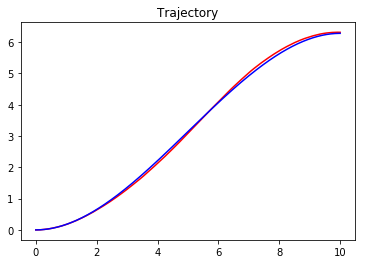

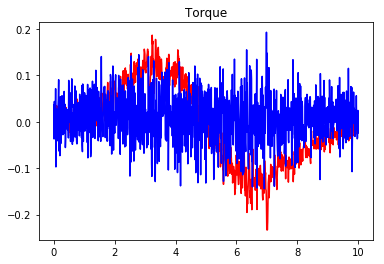

Value Loss : [ 35.85704041]
Policy Loss : [ 0.80898833]
EPISODE 219 STATE [-0.03666982  0.02428797] REWARD  [ 1.93634098] ACTION ([-0.01354286]) 930023])                 

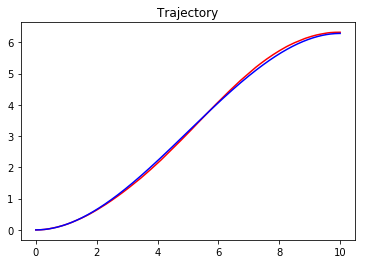

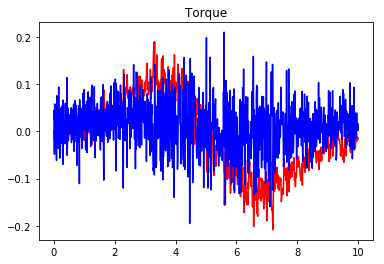

Value Loss : [ 39.48988724]
Policy Loss : [ 2.01908422]
EPISODE 220 STATE [-0.03554879  0.00333062] REWARD  [ 1.95801472] ACTION ([ 0.05405125]) 0232253])                    

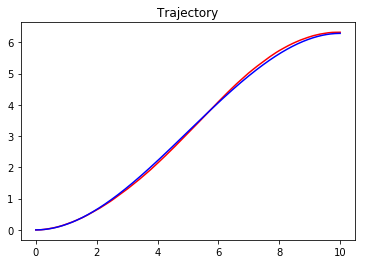

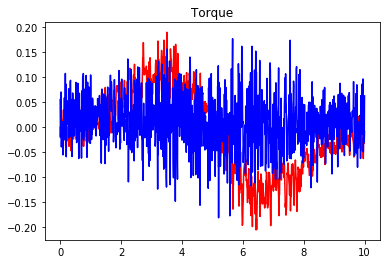

Value Loss : [ 38.27279282]
Policy Loss : [-19.92432976]
EPISODE 221 STATE [-0.03637481  0.04087514] REWARD  [ 1.92063026] ACTION ([-0.01153387]) 1884158])               

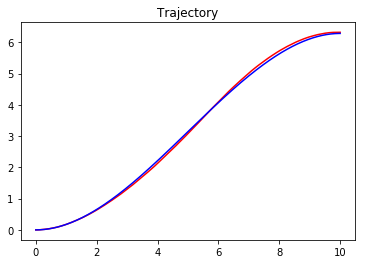

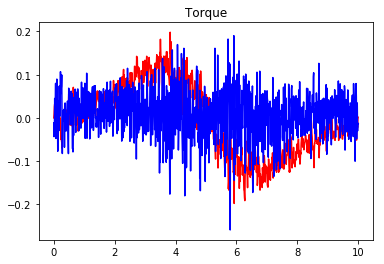

Value Loss : [ 37.85803604]
Policy Loss : [ 9.08932495]
EPISODE 222 STATE [-0.03506187  0.00353679] REWARD  [ 1.95828007] ACTION ([ 0.05065709]) 4739436])               

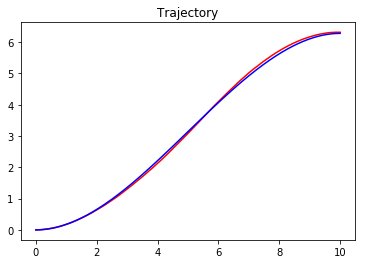

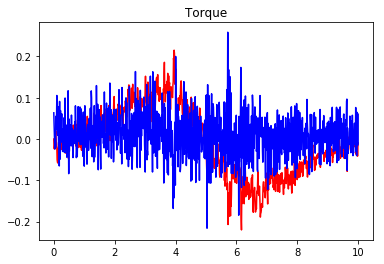

Value Loss : [ 37.14429092]
Policy Loss : [ 2.24700832]
EPISODE 223 STATE [-0.03793972  0.03825752] REWARD  [ 1.921629] ACTION ([-0.09288137]) ) 3205228])                     

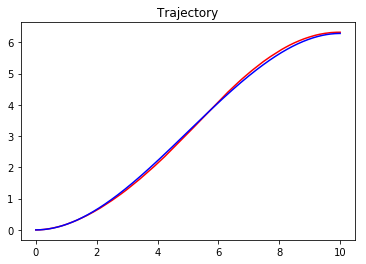

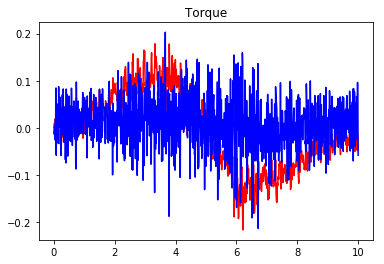

Value Loss : [ 35.24407578]
Policy Loss : [ 11.50656128]
EPISODE 224 STATE [-0.03758995  0.01018184] REWARD  [ 1.94926736] ACTION ([ 0.01801338]) 0443716])               

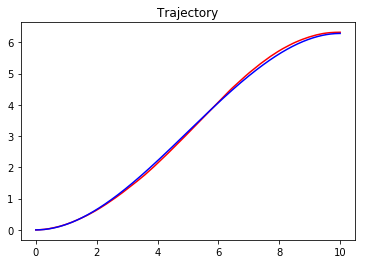

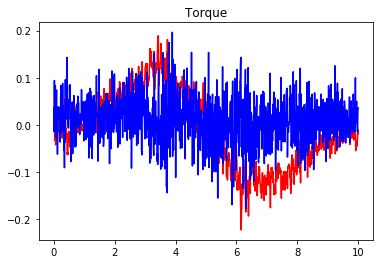

Value Loss : [ 32.24383926]
Policy Loss : [ 0.16363581]
EPISODE 225 STATE [-0.03612463  0.03892822] REWARD  [ 1.92273525] ACTION ([-0.00360696]) 05]) 5])            

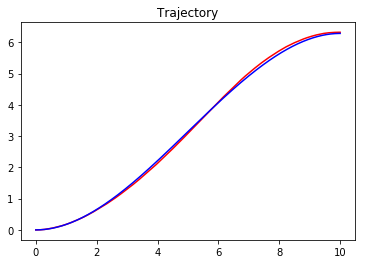

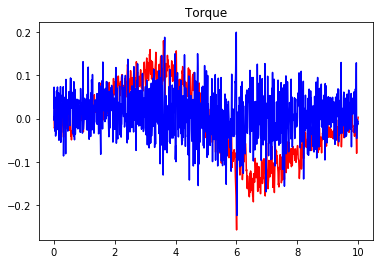

Value Loss : [ 34.06966782]
Policy Loss : [ 6.91577244]
EPISODE 226 STATE [-0.03634325  0.04787424] REWARD  [ 1.9139906] ACTION ([-0.02866605])  4512559])             

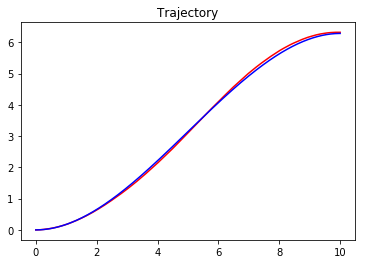

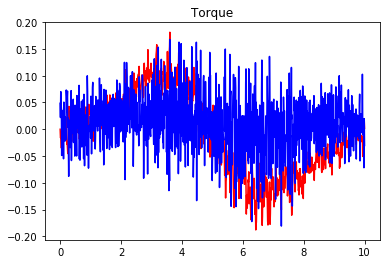

Value Loss : [ 34.75384903]
Policy Loss : [ 25.33267784]
EPISODE 227 STATE [-0.03301604  0.04273661] REWARD  [ 1.92209603] ACTION ([ 0.00674481]) 05]) 05])                  

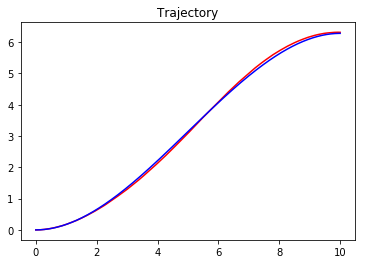

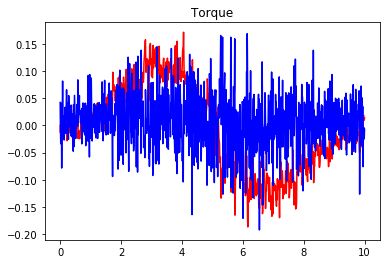

Value Loss : [ 30.93810463]
Policy Loss : [ 20.49659538]
EPISODE 228 STATE [-0.03673011  0.02900969] REWARD  [ 1.93170261] ACTION ([-0.02876617]) 2575421])                

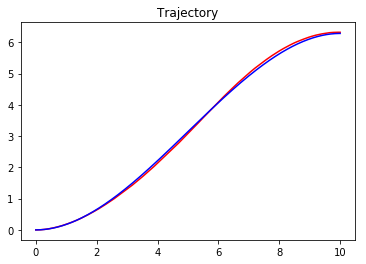

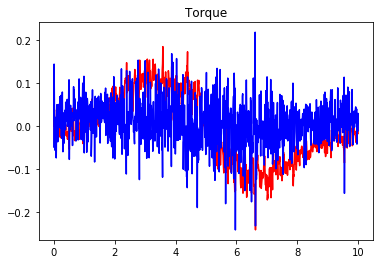

Value Loss : [ 33.73908997]
Policy Loss : [ 20.23516273]
EPISODE 229 STATE [-0.03625888  0.00656193] REWARD  [ 1.95412641] ACTION ([ 0.02843854]) 1661933])            

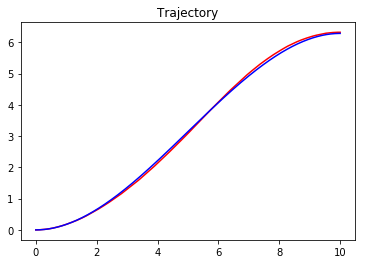

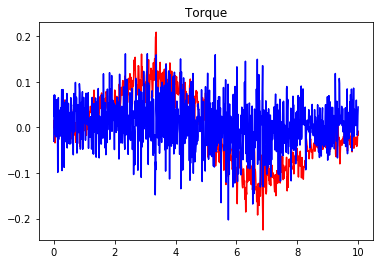

Value Loss : [ 29.30132294]
Policy Loss : [ 27.86379433]
EPISODE 230 STATE [-0.0335144   0.01505676] REWARD  [ 1.94840497] ACTION ([ 0.05330701]) 8658434])               

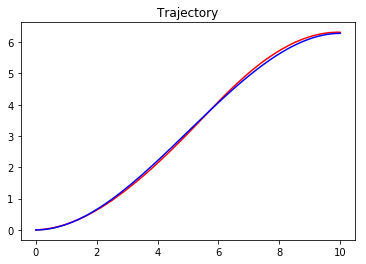

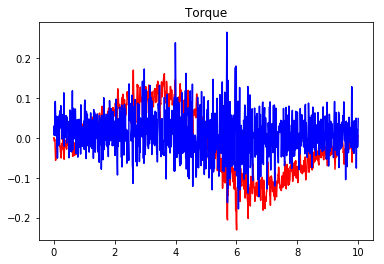

Value Loss : [ 31.3268261]
Policy Loss : [ 2.93293262]
EPISODE 231 STATE [-0.03592572 -0.03802572] REWARD  [ 1.93105807] ACTION ([ 0.071263]) ) 05]) ]) )               

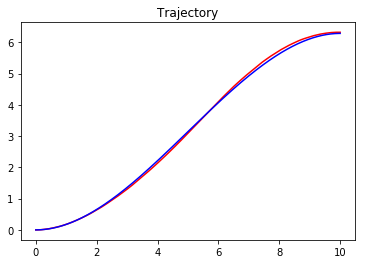

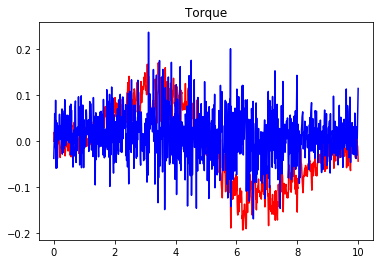

Value Loss : [ 28.60905266]
Policy Loss : [-1.55761099]
EPISODE 232 STATE [-0.03623576  0.00402686] REWARD  [ 1.95666089] ACTION ([ 0.05115327]) 05]) 26])               

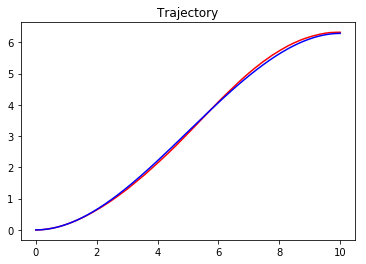

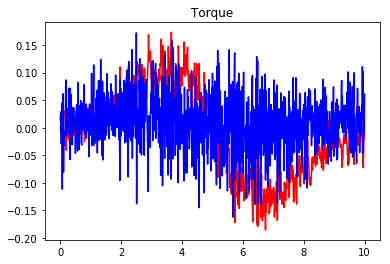

Value Loss : [ 31.46536255]
Policy Loss : [ 11.53971577]
EPISODE 233 STATE [-0.03309365  0.02285995] REWARD  [ 1.94118411] ACTION ([-0.0202129])  05]) 92])                 

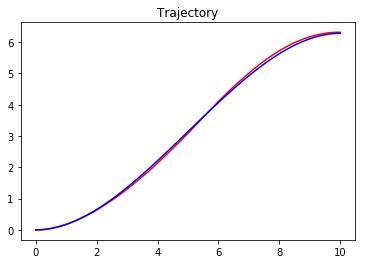

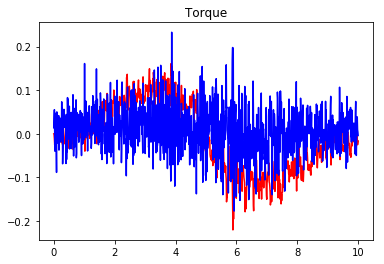

Value Loss : [ 31.0603981]
Policy Loss : [ 16.43305969]
EPISODE 234 STATE [-0.03193303  0.04352441] REWARD  [ 1.92239275] ACTION ([-0.01001207]) 2253994])              

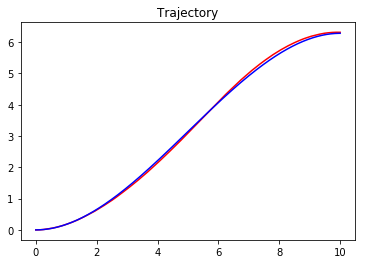

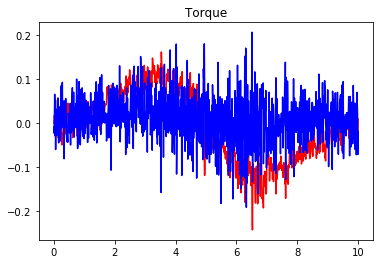

Value Loss : [ 29.58744621]
Policy Loss : [ 17.58365059]
EPISODE 235 STATE [-0.03289722  0.0002024 ] REWARD  [ 1.96368807] ACTION ([-0.0210117])  7849509])                    

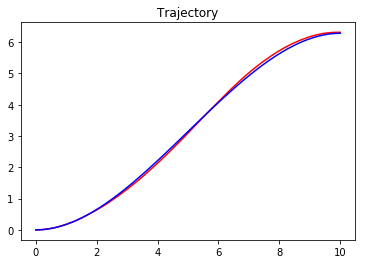

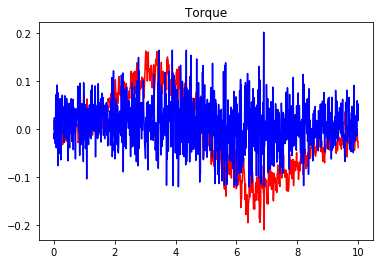

Value Loss : [ 27.82761383]
Policy Loss : [ 4.47394943]
EPISODE 236 STATE [-0.03534661  0.02476923] REWARD  [ 1.93714958] ACTION ([-0.04337764]) 05]) 47])                  

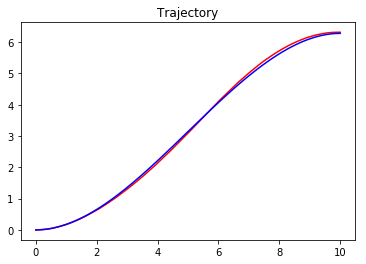

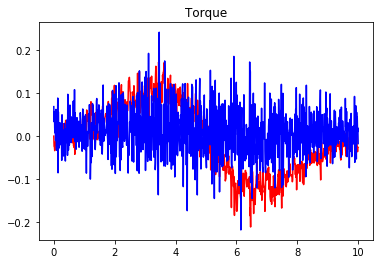

Value Loss : [ 26.3446579]
Policy Loss : [ 8.3348732]
EPISODE 237 STATE [-0.03346302  0.03276723] REWARD  [ 1.93122757] ACTION ([ 0.01187212]) 4716926])               

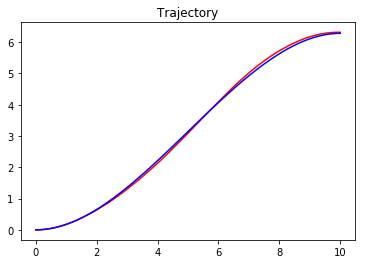

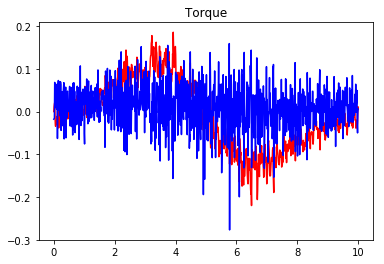

Value Loss : [ 31.73148727]
Policy Loss : [ 9.4967804]
EPISODE 238 STATE [-0.03573373  0.03020533] REWARD  [ 1.93150717] ACTION ([-0.01817667]) 7289042])               

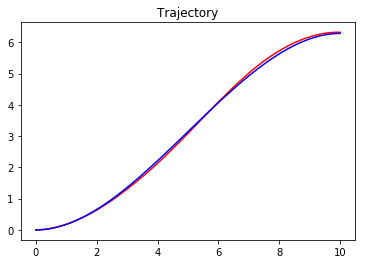

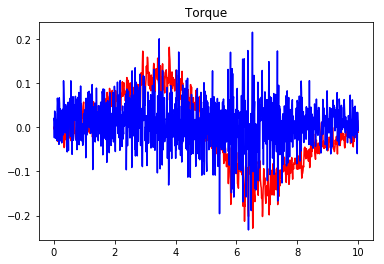

Value Loss : [ 41.34516907]
Policy Loss : [ 12.54999638]
EPISODE 239 STATE [-0.03198598  0.013128  ] REWARD  [ 1.95177879] ACTION ([-0.00711445]) 8861721])                

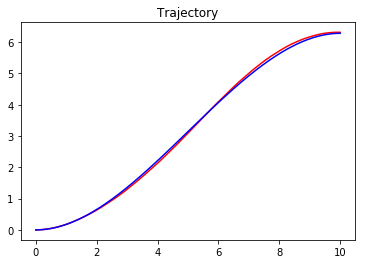

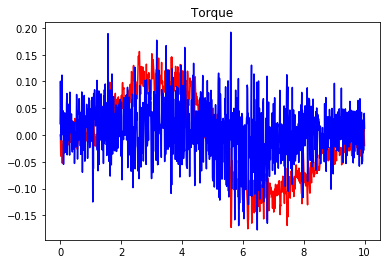

Value Loss : [ 30.01768112]
Policy Loss : [ 24.61105347]
EPISODE 240 STATE [-0.03463833  0.01496487] REWARD  [ 1.94740885] ACTION ([-0.00475436]) 5526504])           

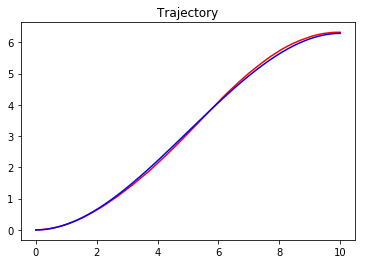

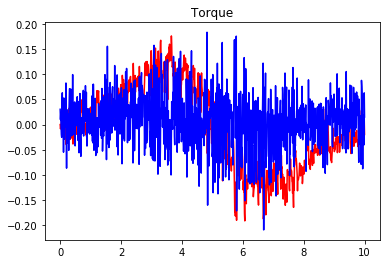

Value Loss : [ 27.5885582]
Policy Loss : [ 16.0172863]
EPISODE 241 STATE [-0.03692895  0.03230748] REWARD  [ 1.9283248] ACTION ([ 0.00947684])  7053485])               

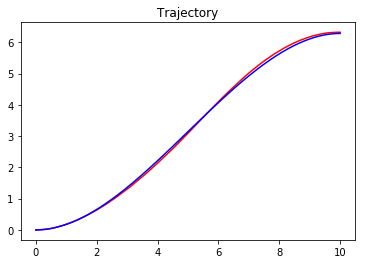

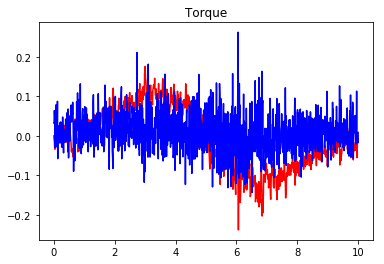

Value Loss : [ 31.35836029]
Policy Loss : [ 6.36016369]
EPISODE 242 STATE [-0.03494752  0.02961478] REWARD  [ 1.93283708] ACTION ([ 0.06802184]) 05]) 32])                      

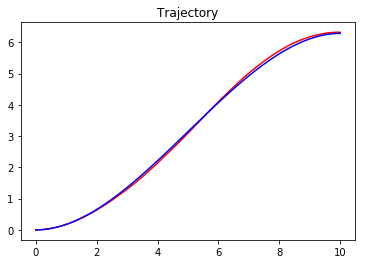

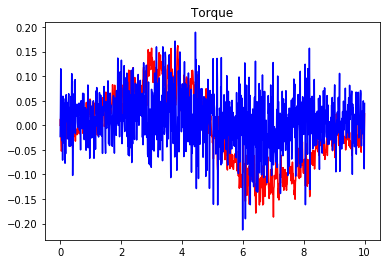

Value Loss : [ 29.66084862]
Policy Loss : [ 26.89917183]
EPISODE 243 STATE [-0.03270207  0.03446088] REWARD  [ 1.93033227] ACTION ([ 0.01061522]) 5])  81])              

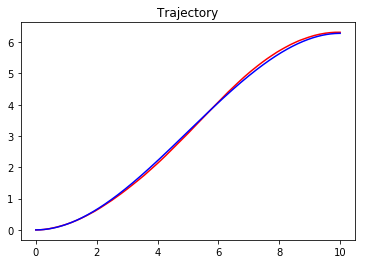

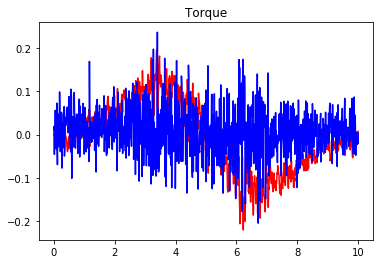

Value Loss : [ 31.02973747]
Policy Loss : [ 5.9481535]
EPISODE 244 STATE [-0.0365796   0.01559293] REWARD  [ 1.94491925] ACTION ([-0.00767111]) 6721433])          

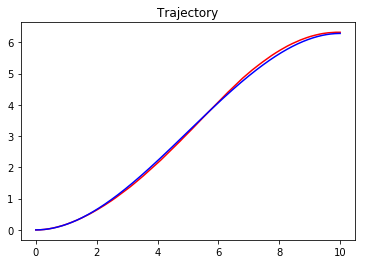

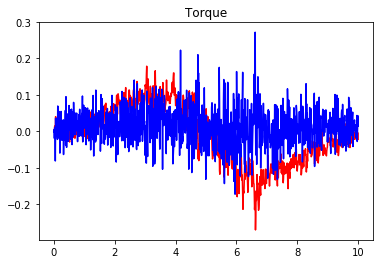

Value Loss : [ 30.37446213]
Policy Loss : [-4.99271345]
EPISODE 245 STATE [-0.03811324  0.02192509] REWARD  [ 1.93725071] ACTION ([-0.02739583]) 398161])                 

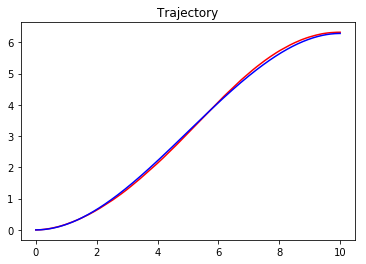

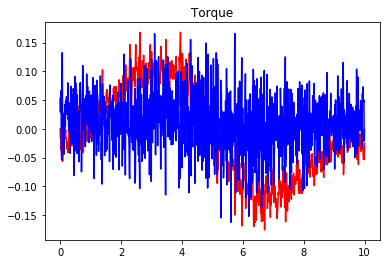

Value Loss : [ 29.78769684]
Policy Loss : [ 4.41842699]
EPISODE 246 STATE [-0.03412677  0.03180889] REWARD  [ 1.93151025] ACTION ([ 0.0140092])  06]) 8])                   

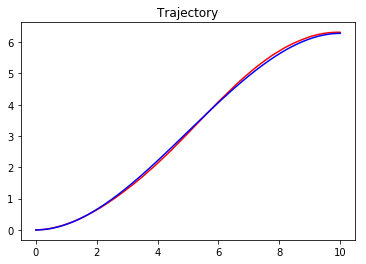

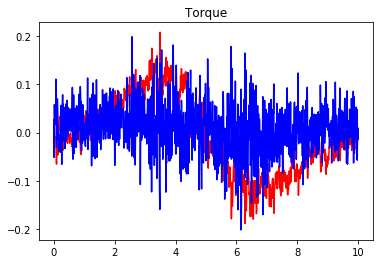

Value Loss : [ 28.55582619]
Policy Loss : [ 16.52591133]
EPISODE 247 STATE [-0.03345457  0.047087  ] REWARD  [ 1.91752816] ACTION ([-0.01935082]) 05]) 5])             

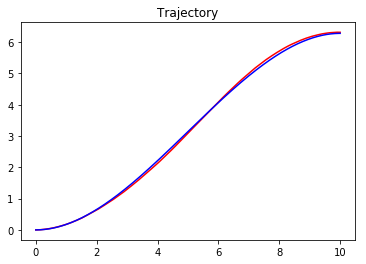

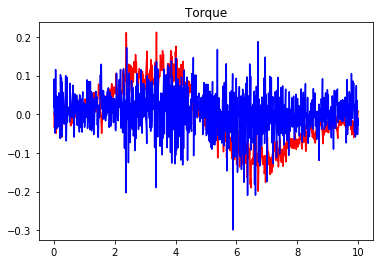

Value Loss : [ 37.00189209]
Policy Loss : [ 26.20198441]
EPISODE 248 STATE [-0.03754739  0.05039195] REWARD  [ 1.91044214] ACTION ([ 0.0225646])  05]) 79])                    

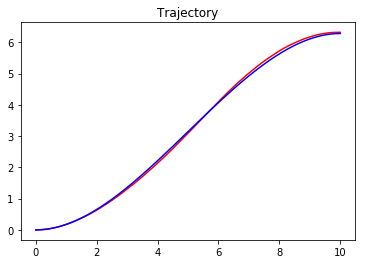

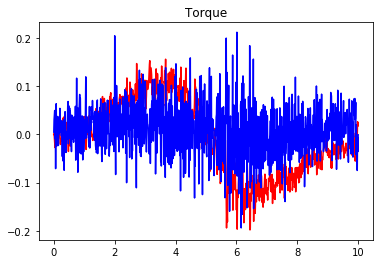

Value Loss : [ 25.79562569]
Policy Loss : [ 15.8428669]
EPISODE 249 STATE [-0.03442698  0.00169082] REWARD  [ 1.96072751] ACTION ([ 0.07376878]) 1818432])               

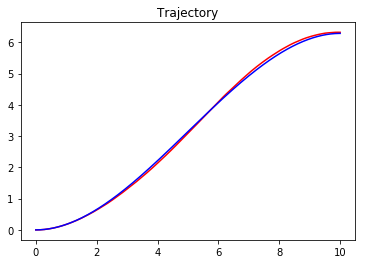

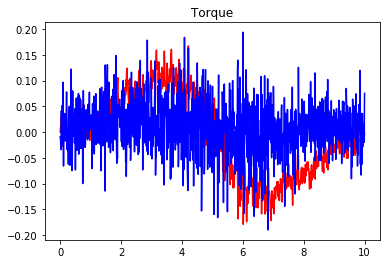

Value Loss : [ 23.80846405]
Policy Loss : [ 12.89912033]
EPISODE 250 STATE [-0.04016068  0.02220719] REWARD  [ 1.93500692] ACTION ([-0.01796064]) 05]) ]) )                    

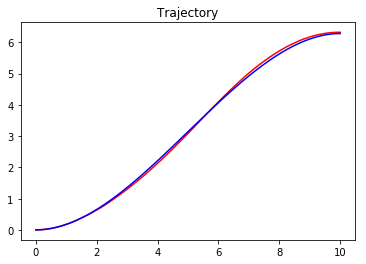

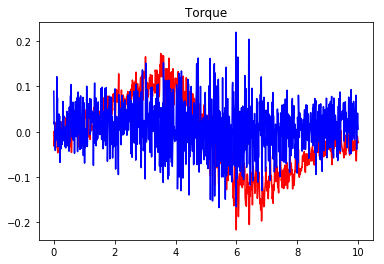

Value Loss : [ 26.15921783]
Policy Loss : [ 4.57132435]
EPISODE 251 STATE [-0.03420386  0.02772712] REWARD  [ 1.9353829] ACTION ([-0.06219522])  477036])             

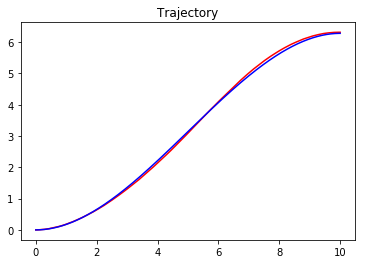

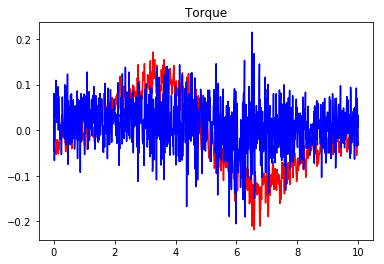

Value Loss : [ 35.24840546]
Policy Loss : [ 22.07720757]
EPISODE 252 STATE [-0.03687013  0.03014258] REWARD  [ 1.93047192] ACTION ([ 0.02033917]) 144011])                 

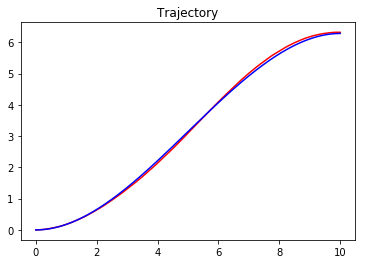

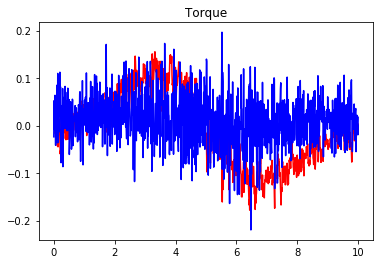

Value Loss : [ 27.4958477]
Policy Loss : [ 22.22463226]
EPISODE 253 STATE [-0.03715915  0.0183515 ] REWARD  [ 1.94165873] ACTION ([-0.07196338]) 3243366])               

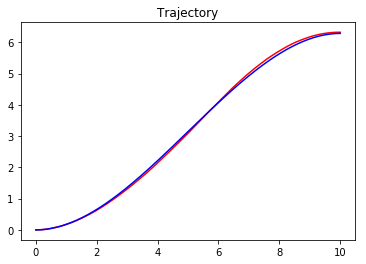

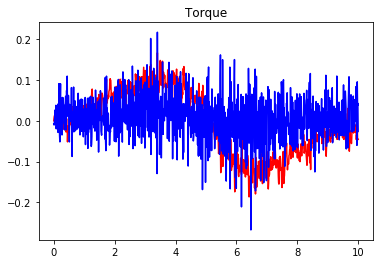

Value Loss : [ 26.90739822]
Policy Loss : [ 13.67370987]
EPISODE 254 STATE [-0.03529332  0.0497541 ] REWARD  [ 1.91322003] ACTION ([-0.07781332]) 8877268])                  

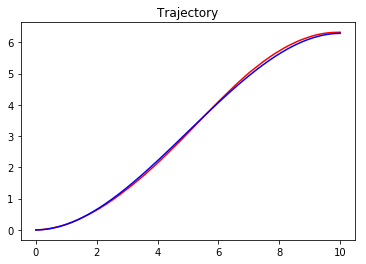

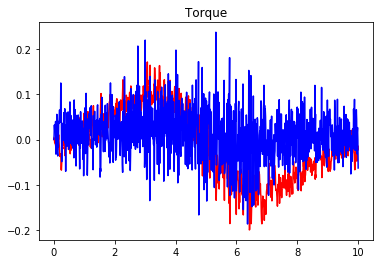

Value Loss : [ 24.89995003]
Policy Loss : [ 21.24971199]
EPISODE 255 STATE [-0.0329556   0.01474219] REWARD  [ 1.94925426] ACTION ([ 0.02519215]) 1725461])                     

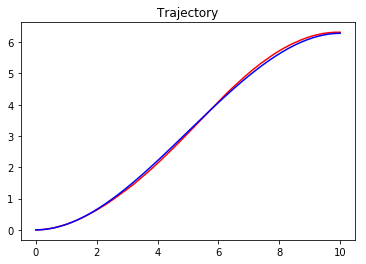

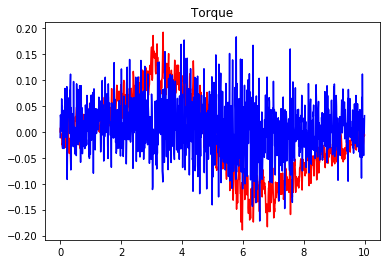

Value Loss : [ 25.28345299]
Policy Loss : [ 12.94828415]
EPISODE 256 STATE [-0.03517175  0.01257494] REWARD  [ 1.94924209] ACTION ([ 0.06214014]) 05]) 03])             

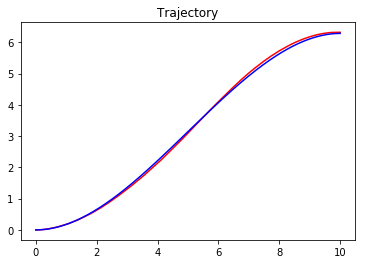

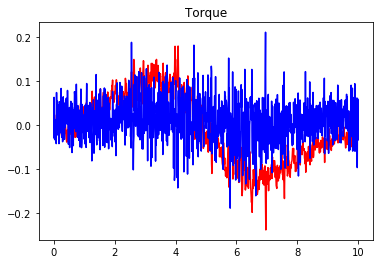

Value Loss : [ 31.90538216]
Policy Loss : [ 5.38376808]
EPISODE 257 STATE [-0.03714315  0.0216768 ] REWARD  [ 1.93842702] ACTION ([ 0.02950403]) 1571823])             

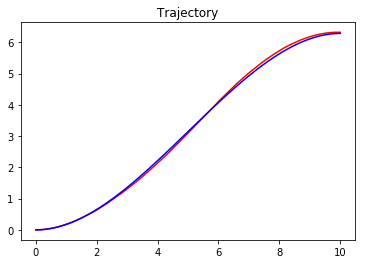

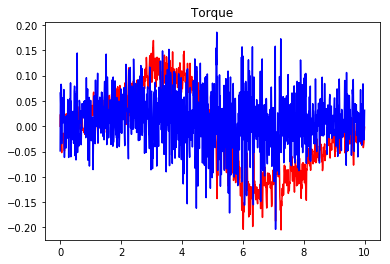

Value Loss : [ 29.92120361]
Policy Loss : [ 8.9196949]
EPISODE 258 STATE [-0.03609028  0.01511051] REWARD  [ 1.9458644] ACTION ([-0.00695876])  05]) 6])           

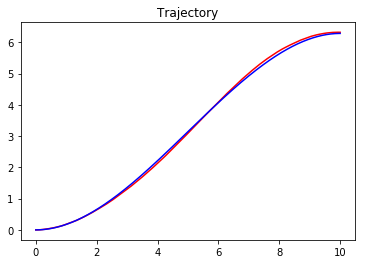

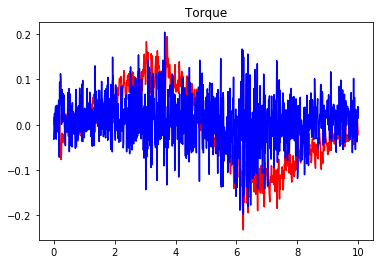

Value Loss : [ 29.05914497]
Policy Loss : [ 11.78055191]
EPISODE 259 STATE [-0.03386323  0.04166837] REWARD  [ 1.92229692] ACTION ([ 0.00675503]) 5299597])            

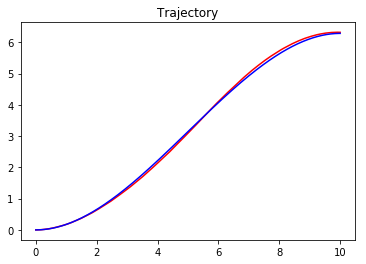

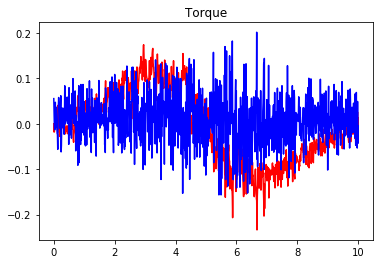

Value Loss : [ 28.54150772]
Policy Loss : [ 4.5835247]
EPISODE 260 STATE [-0.03692429  0.00935752] REWARD  [ 1.95072192] ACTION ([ 0.04591569]) 156502])                 

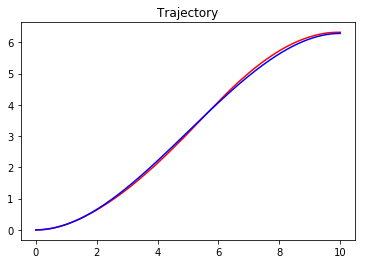

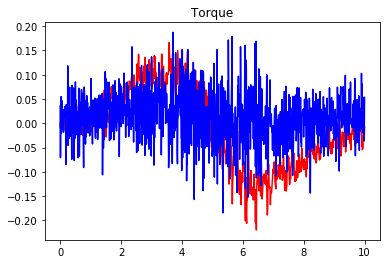

Value Loss : [ 25.88974762]
Policy Loss : [ 11.85048676]
EPISODE 261 STATE [-0.0384016   0.00438105] REWARD  [ 1.95422298] ACTION ([-0.0118246])  0624209])               

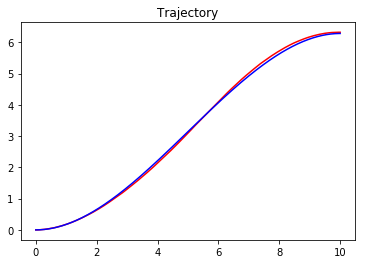

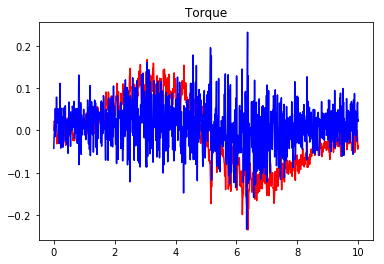

Value Loss : [ 35.26103592]
Policy Loss : [ 8.56500244]
EPISODE 262 STATE [-0.03373767  0.02711932] REWARD  [ 1.93642265] ACTION ([-0.04435245]) 05]) 1])                   

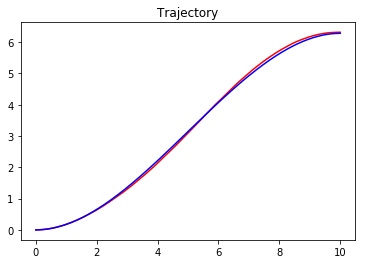

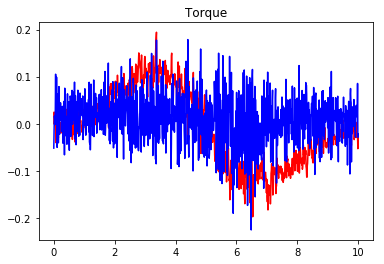

Value Loss : [ 30.49528503]
Policy Loss : [ 20.65514183]
EPISODE 263 STATE [-0.03358205  0.01475418] REWARD  [ 1.94863653] ACTION ([ 0.01786412]) 436071])              

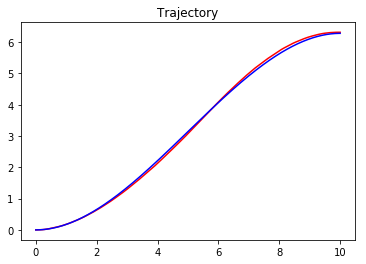

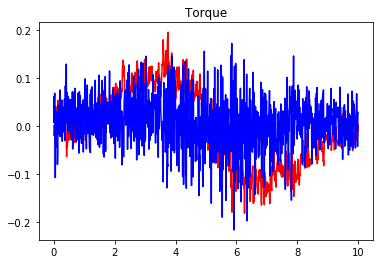

Value Loss : [ 33.24537659]
Policy Loss : [ 15.61216831]
EPISODE 264 STATE [-0.03500976  0.00540051] REWARD  [ 1.95648197] ACTION ([ 0.04951327]) 6]) 477])          

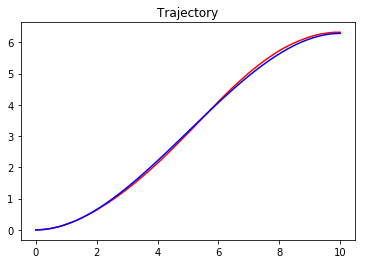

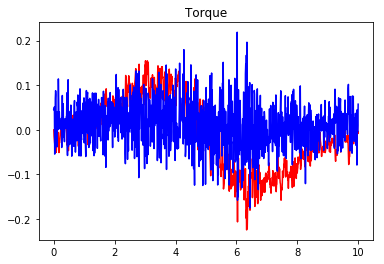

Value Loss : [ 26.66662788]
Policy Loss : [ 8.17916298]
EPISODE 265 STATE [-0.03419855  0.0130351 ] REWARD  [ 1.94972954] ACTION ([ 0.01694319]) 05]) 28])         

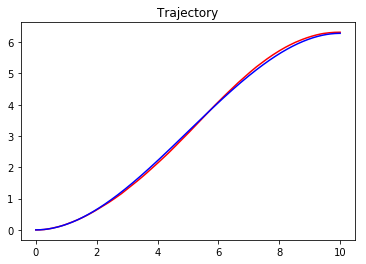

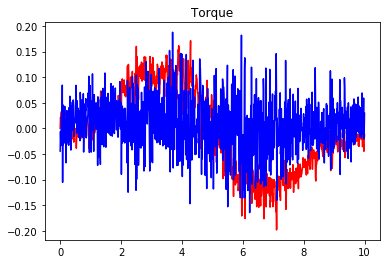

Value Loss : [ 29.03962517]
Policy Loss : [ 6.44525623]
EPISODE 266 STATE [-0.03361585 -0.01070516] REWARD  [ 1.96005361] ACTION ([-0.01838675]) 3381176])          

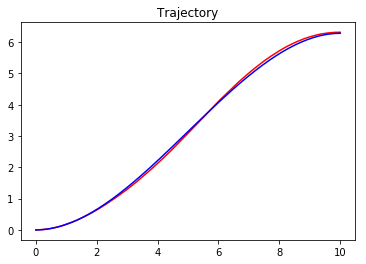

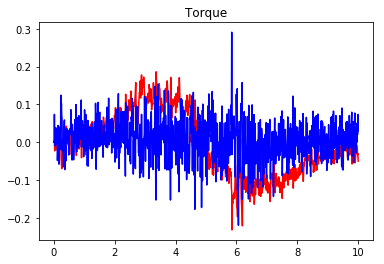

Value Loss : [ 32.62034988]
Policy Loss : [ 5.26600933]
EPISODE 267 STATE [-0.03544404  0.02654903] REWARD  [ 1.93532736] ACTION ([-0.04702355]) 05]) 5])                

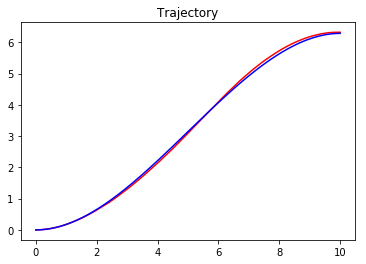

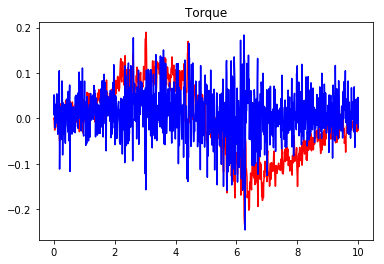

Value Loss : [ 31.78893852]
Policy Loss : [ 11.70219517]
EPISODE 268 STATE [-0.0350226  -0.00982965] REWARD  [ 1.95956414] ACTION ([ 0.03104594]) 7594744])                    

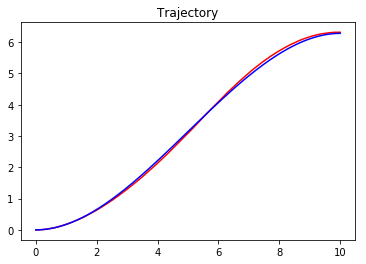

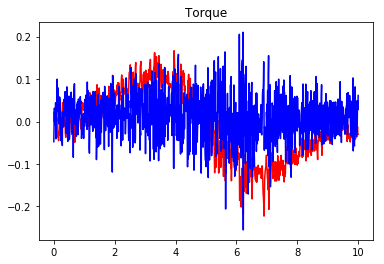

Value Loss : [ 36.82434464]
Policy Loss : [ 5.14947367]
EPISODE 269 STATE [-0.03699666  0.00825873] REWARD  [ 1.95173722] ACTION ([ 0.02803255]) 7090489])         

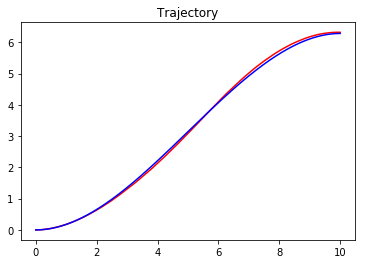

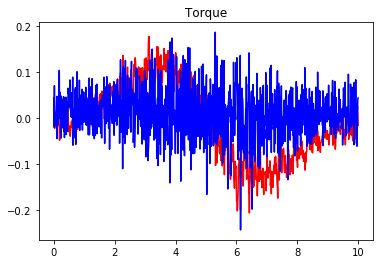

Value Loss : [ 24.8636322]
Policy Loss : [ 11.45697594]
EPISODE 270 STATE [-0.03247374  0.01031252] REWARD  [ 1.95407868] ACTION ([ 0.01065517]) 06]) 62])          

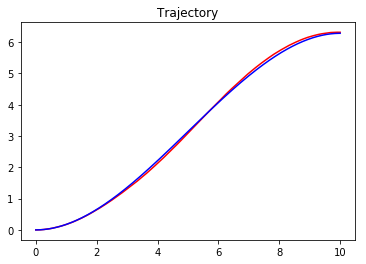

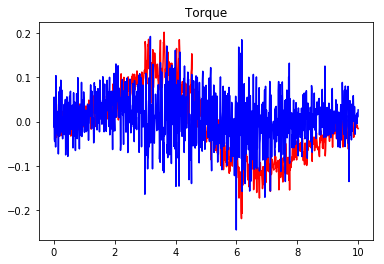

Value Loss : [ 34.31746292]
Policy Loss : [ 29.11145401]
EPISODE 271 STATE [-0.03340212  0.00823367] REWARD  [ 1.95523226] ACTION ([-0.04805847]) 4723339])        

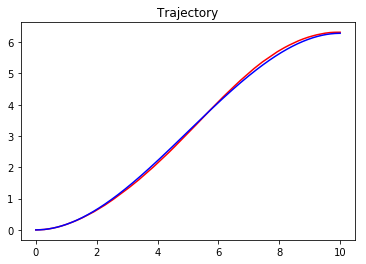

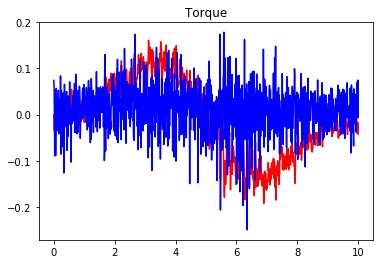

Value Loss : [ 35.03725052]
Policy Loss : [ 14.12142754]
EPISODE 272 STATE [-0.03363118  0.01569613] REWARD  [ 1.94766479] ACTION ([-0.00687717]) 5460801])         

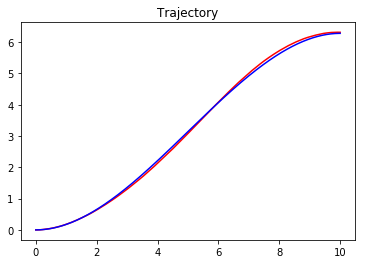

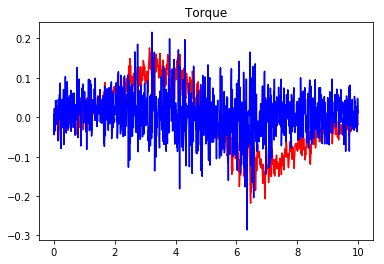

Value Loss : [ 35.8183403]
Policy Loss : [ 22.73012543]
EPISODE 273 STATE [-0.02955426  0.0229895 ] REWARD  [ 1.94448828] ACTION ([-0.04992224]) 0117746])            

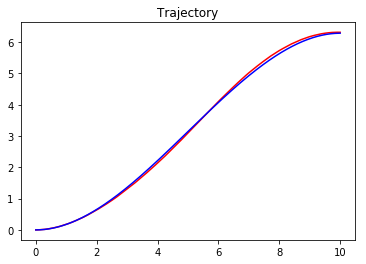

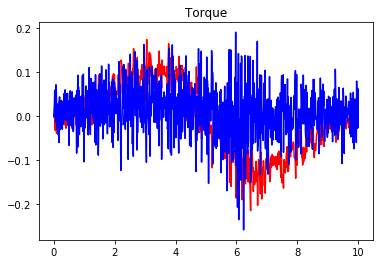

Value Loss : [ 33.20470047]
Policy Loss : [ 24.5398922]
EPISODE 274 STATE [-0.0331636   0.02369031] REWARD  [ 1.94030825] ACTION ([ 0.02497845]) 4533639])               

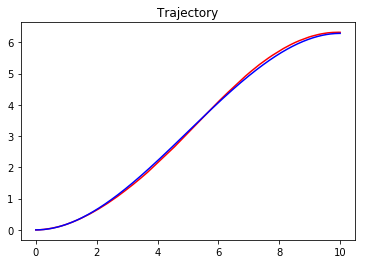

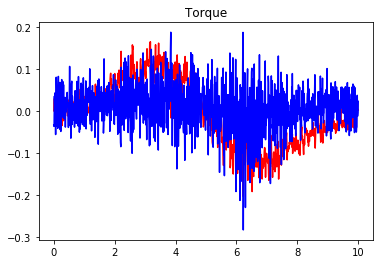

Value Loss : [ 31.12376785]
Policy Loss : [ 24.42371559]
EPISODE 275 STATE [-0.03370542  0.00972108] REWARD  [ 1.9534704] ACTION ([ 0.0153884])   1133285])                      

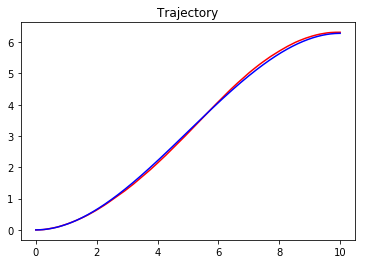

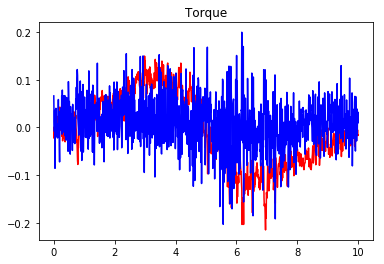

Value Loss : [ 27.86413574]
Policy Loss : [ 11.60926723]
EPISODE 276 STATE [-0.03567196  0.01893657] REWARD  [ 1.94252067] ACTION ([ 0.03470442]) 06]) 8])                    

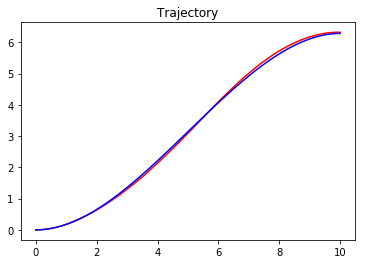

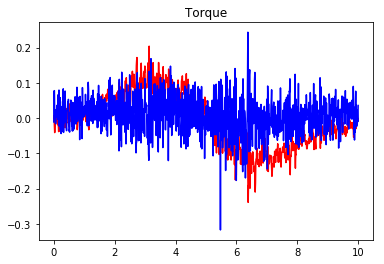

Value Loss : [ 28.08666611]
Policy Loss : [ 11.77427292]
EPISODE 277 STATE [-0.03478021  0.02946419] REWARD  [ 1.93314433] ACTION ([ 0.01002919]) 05]) 18])                 

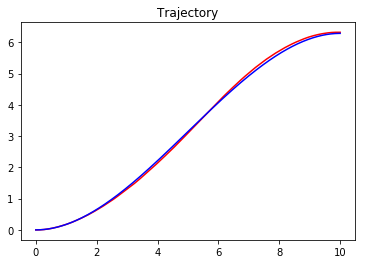

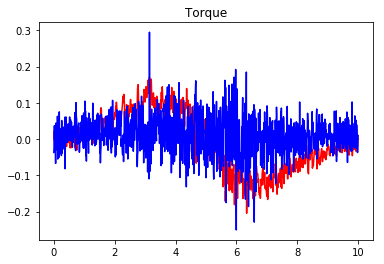

Value Loss : [ 26.97441864]
Policy Loss : [ 13.85118008]
EPISODE 278 STATE [-0.03504635  0.02975502] REWARD  [ 1.93260603] ACTION ([-0.01042526]) 05]) 6])              

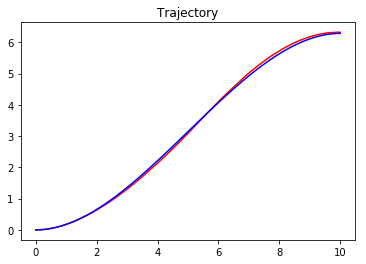

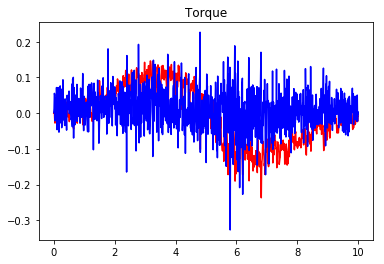

Value Loss : [ 36.3479805]
Policy Loss : [ 8.20597935]
EPISODE 279 STATE [-0.03427116  0.04461389] REWARD  [ 1.91909213] ACTION ([-0.05433029]) 05]) 89])       

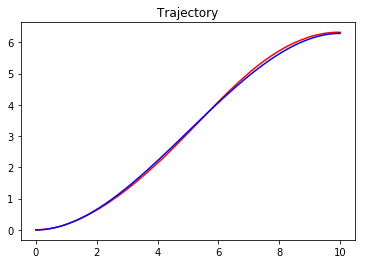

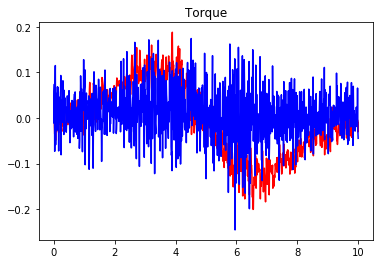

Value Loss : [ 29.11414528]
Policy Loss : [ 8.47329426]
EPISODE 280 STATE [-0.03426875  0.02537764] REWARD  [ 1.93759948] ACTION ([-0.05134169]) 1879554])         

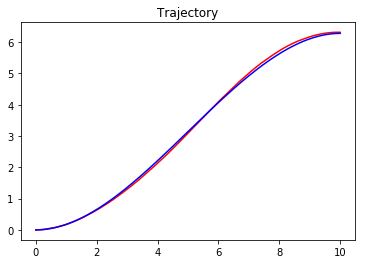

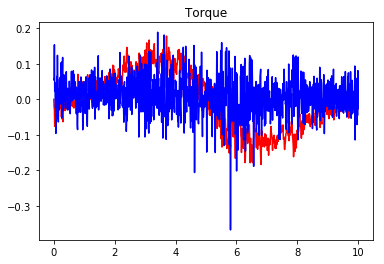

Value Loss : [ 30.56565857]
Policy Loss : [ 18.26322556]
EPISODE 281 STATE [-0.03552097  0.02997235] REWARD  [ 1.93193771] ACTION ([ 0.031828]) ) 05]) 92])              

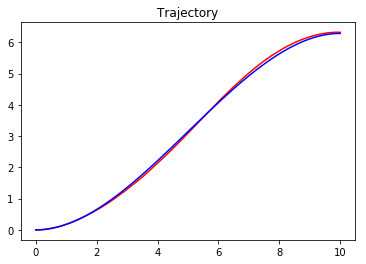

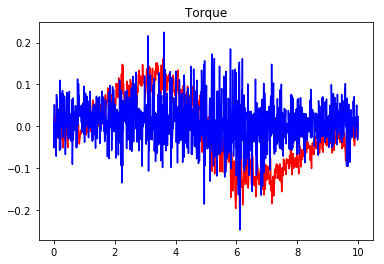

Value Loss : [ 25.96616364]
Policy Loss : [ 7.13381147]
EPISODE 282 STATE [-0.03624544 -0.017188  ] REWARD  [ 1.95109701] ACTION ([ 0.02338505]) 2805592])            

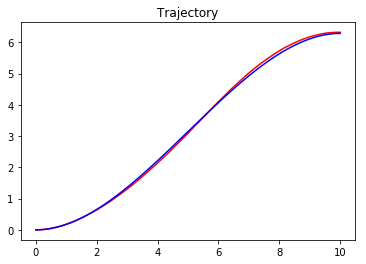

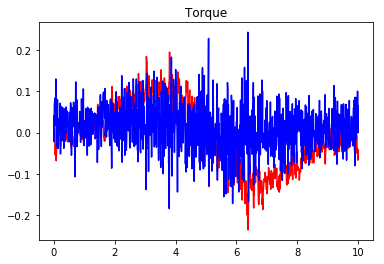

Value Loss : [ 33.12906647]
Policy Loss : [ 15.10029697]
EPISODE 283 STATE [-0.03494469  0.02037276] REWARD  [ 1.94181979] ACTION ([ 0.05522659]) 380853])            

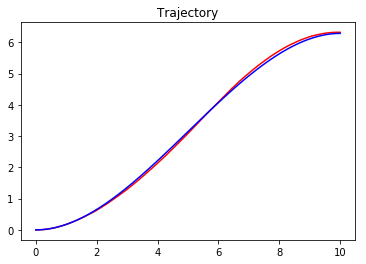

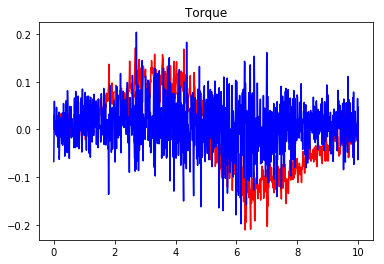

Value Loss : [ 25.78578949]
Policy Loss : [ 11.37093353]
EPISODE 284 STATE [-0.03516069  0.02001974] REWARD  [ 1.94195588] ACTION ([ 0.01265202]) 2206638])             

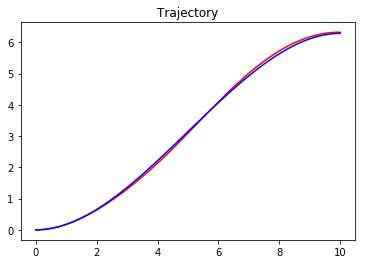

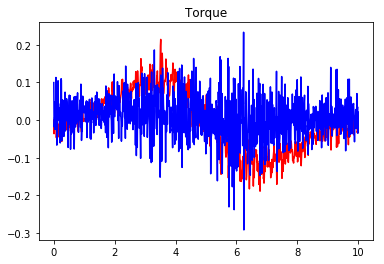

Value Loss : [ 35.17816544]
Policy Loss : [ 4.05581284]
EPISODE 285 STATE [-0.03571632  0.02458589] REWARD  [ 1.93697097] ACTION ([-0.04167518]) 3000935])        

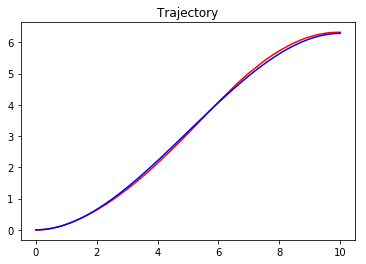

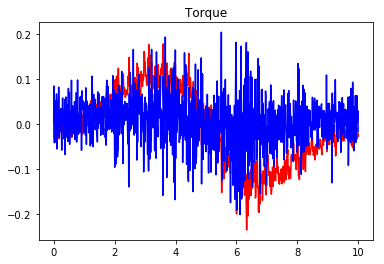

Value Loss : [ 28.63975906]
Policy Loss : [ 16.61836624]
EPISODE 286 STATE [-0.03522856  0.02047908] REWARD  [ 1.94144192] ACTION ([-0.02072893]) 3754222])         

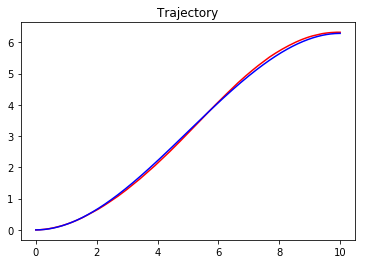

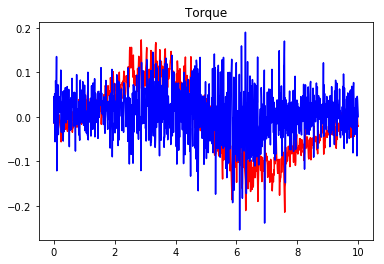

Value Loss : [ 33.34557343]
Policy Loss : [ 15.86735916]
EPISODE 287 STATE [-0.03411061  0.00502242] REWARD  [ 1.9577253] ACTION ([ 0.04130304])  749148])          

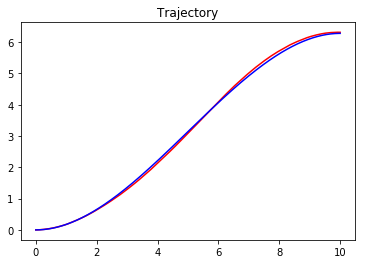

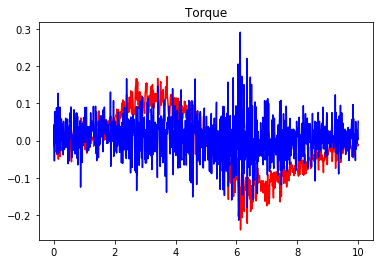

Value Loss : [ 26.63041306]
Policy Loss : [-0.32603386]
EPISODE 288 STATE [-0.03281301 -0.0019584 ] REWARD  [ 1.96592412] ACTION ([-0.00155833]) 8698654])                

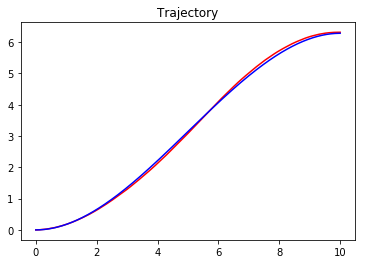

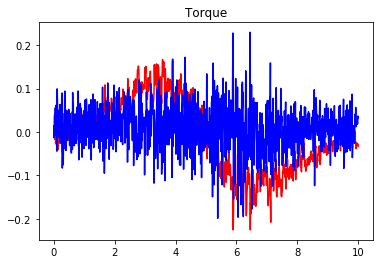

Value Loss : [ 31.39360809]
Policy Loss : [ 12.40166092]
EPISODE 289 STATE [-0.03131996 -0.0093397 ] REWARD  [ 1.96363315] ACTION ([ 0.07015957]) 05]) 91])       

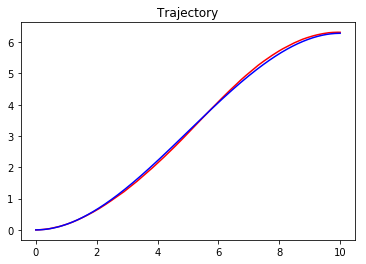

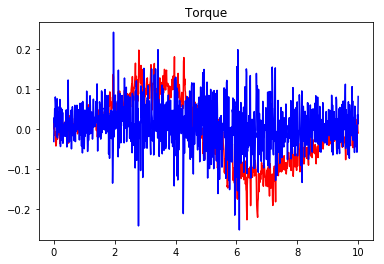

Value Loss : [ 38.85093307]
Policy Loss : [ 19.70227814]
EPISODE 290 STATE [-0.03634905  0.01670287] REWARD  [ 1.94405351] ACTION ([ 0.00846907]) 60587]) )        

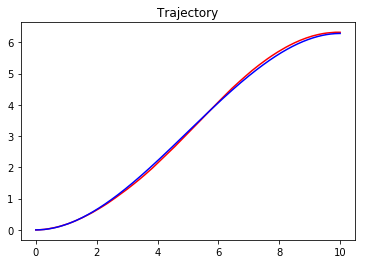

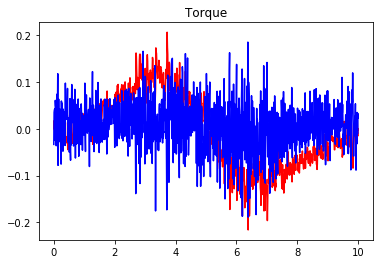

Value Loss : [ 27.42208672]
Policy Loss : [ 6.2079463]
EPISODE 291 STATE [-0.037892    0.02553499] REWARD  [ 1.93395174] ACTION ([ 0.02410911]) 05]) 19])              

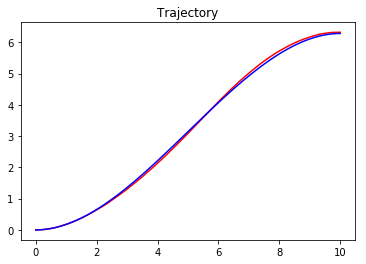

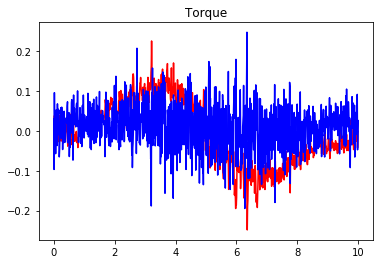

Value Loss : [ 26.00784111]
Policy Loss : [ 16.76438522]
EPISODE 292 STATE [-0.03682973  0.00786737] REWARD  [ 1.95228486] ACTION ([ 0.01749652]) 05]) 21])               

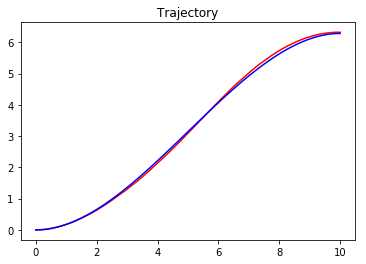

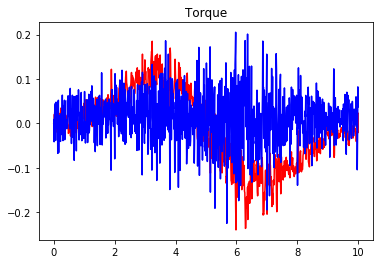

Value Loss : [ 36.89521027]
Policy Loss : [-8.54489899]
EPISODE 293 STATE [-0.03685805  0.03951726] REWARD  [ 1.92146385] ACTION ([ 0.032248]) ) 4482588])          

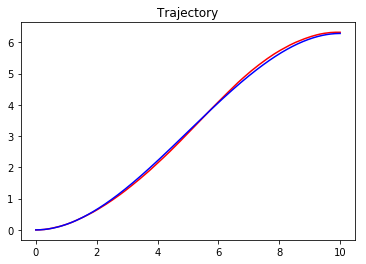

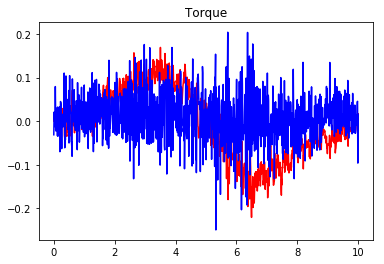

Value Loss : [ 32.67396545]
Policy Loss : [ 4.71839523]
EPISODE 294 STATE [-0.03644402  0.03390342] REWARD  [ 1.9272541] ACTION ([-0.0147911]) ) 5494259])                   

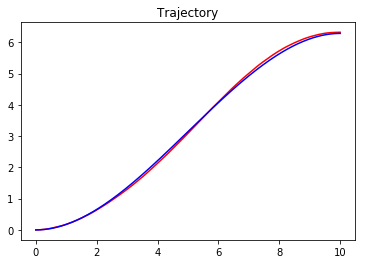

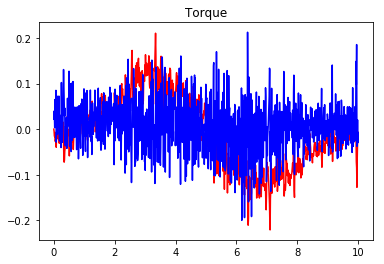

Value Loss : [ 39.86714935]
Policy Loss : [ 4.10226917]
EPISODE 295 STATE [-0.03388797  0.02206629] REWARD  [ 1.94118905] ACTION ([ 0.01024708]) 1484998])           

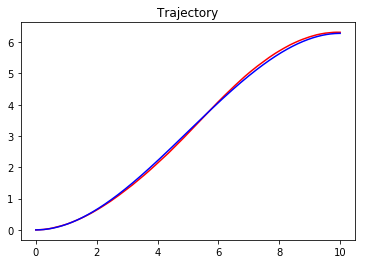

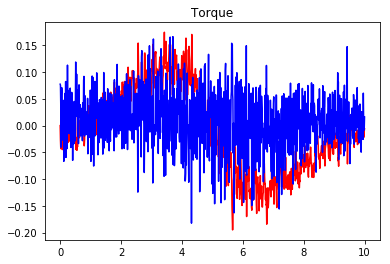

Value Loss : [ 23.08727264]
Policy Loss : [ 3.67229986]
EPISODE 296 STATE [-0.03329329  0.01934307] REWARD  [ 1.94442147] ACTION ([-0.02862438]) 5])4846])              

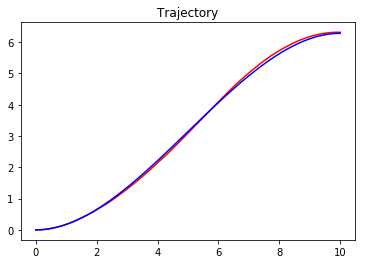

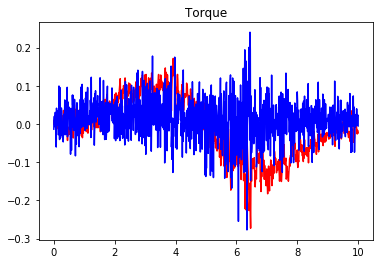

Value Loss : [ 35.96572495]
Policy Loss : [ 8.2214098]
EPISODE 297 STATE [-0.03808564  0.03643292] REWARD  [ 1.92323961] ACTION ([ 0.01911938]) 882434])                   

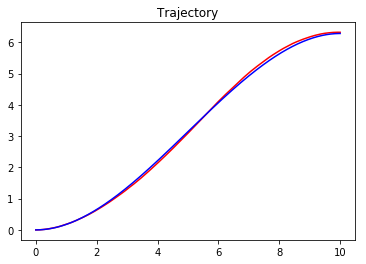

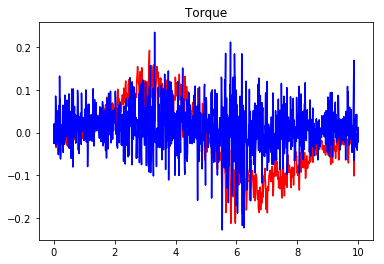

Value Loss : [ 35.12369156]
Policy Loss : [-4.74349499]
EPISODE 298 STATE [-0.03583444  0.01366116] REWARD  [ 1.94753448] ACTION ([-0.00185144]) 5431492])               

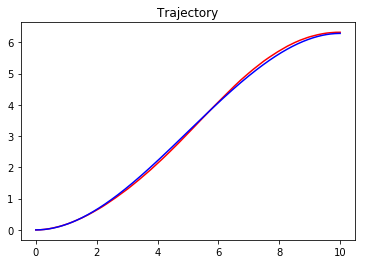

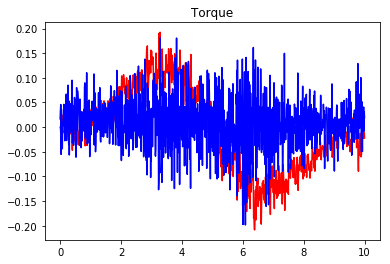

Value Loss : [ 31.33651543]
Policy Loss : [ 5.95507765]
EPISODE 299 STATE [-0.03255499  0.02448503] REWARD  [ 1.94012431] ACTION ([ 0.03794324]) 013593])                   

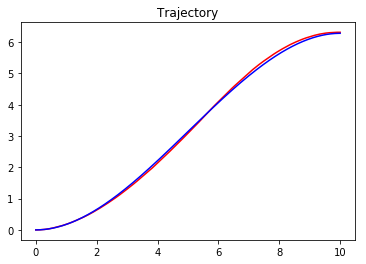

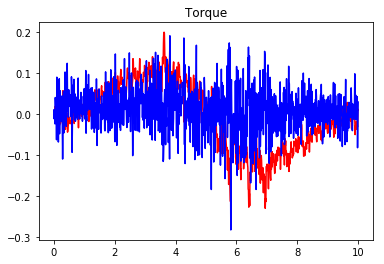

Value Loss : [ 36.68198395]
Policy Loss : [ 7.05176258]
EPISODE 300 STATE [-0.03800427  0.02635896] REWARD  [ 1.93304381] ACTION ([-0.00693339]) 05]) 68])                       

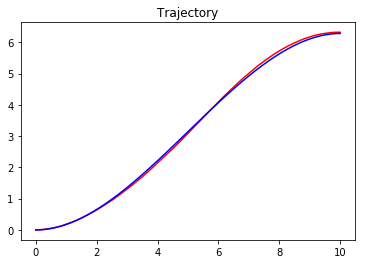

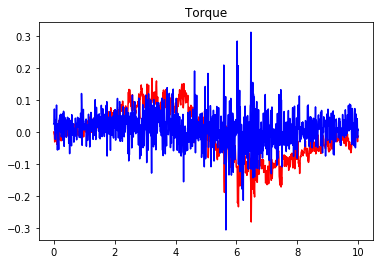

Value Loss : [ 26.3794136]
Policy Loss : [ 8.18806267]
EPISODE 301 STATE [-0.03444098 -0.00398672] REWARD  [ 1.96595057] ACTION ([ 0.05472765]) 05]) 4])        

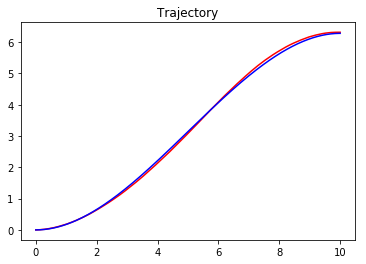

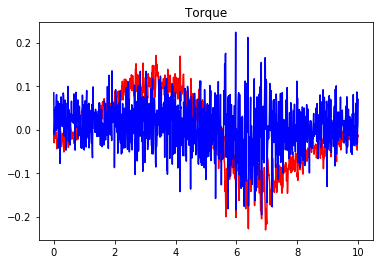

Value Loss : [ 35.8584404]
Policy Loss : [ 11.56013012]
EPISODE 302 STATE [-0.03692957  0.03306999] REWARD  [ 1.92758899] ACTION ([-0.09503957]) 8581889]) 05])                      

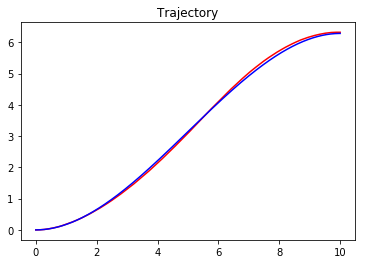

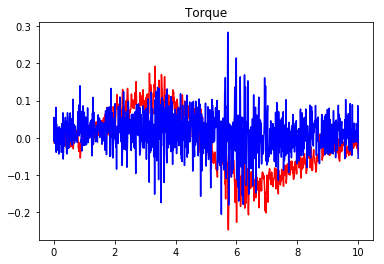

Value Loss : [ 35.38248444]
Policy Loss : [-2.5282321]
EPISODE 303 STATE [-0.03568946  0.04089682] REWARD  [ 1.92127063] ACTION ([-0.01574508]) 06]) 47])                     

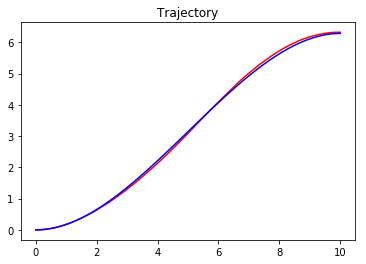

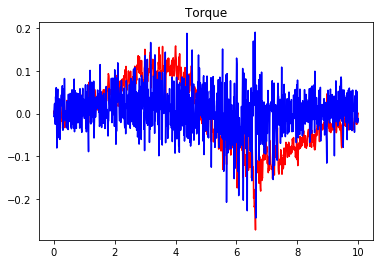

Value Loss : [ 30.07598877]
Policy Loss : [ 24.78916359]
EPISODE 304 STATE [-0.03655837  0.03128529] REWARD  [ 1.92966848] ACTION ([-0.05215962]) 0690366])                         

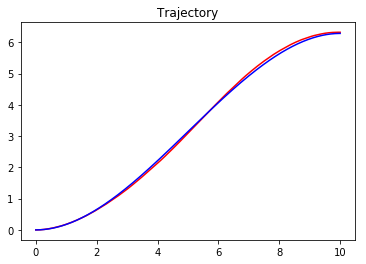

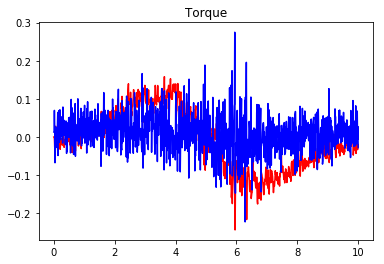

Value Loss : [ 23.58919907]
Policy Loss : [ 4.00907421]
EPISODE 305 STATE [-0.03570545 -0.00724487] REWARD  [ 1.9614775] ACTION ([ 0.01483389])  109745])                       

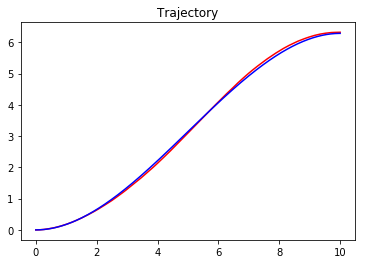

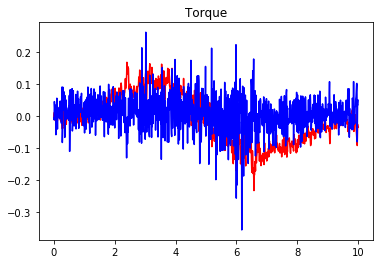

Value Loss : [ 35.466259]
Policy Loss : [ 27.85819817]
EPISODE 306 STATE [-0.0367971   0.00628221] REWARD  [ 1.95388437] ACTION ([-0.0142795])  9793081])                    

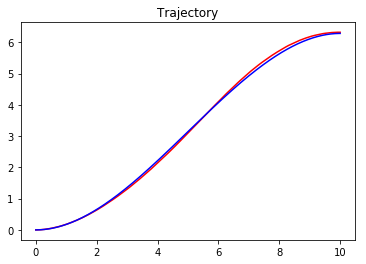

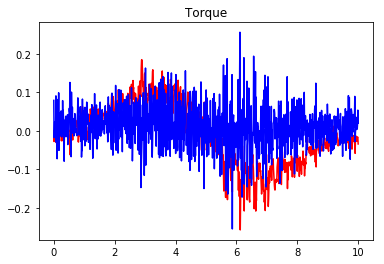

Value Loss : [ 35.23526001]
Policy Loss : [ 7.82818842]
EPISODE 307 STATE [-0.03440126  0.00678357] REWARD  [ 1.95570023] ACTION ([-0.00408279]) 0435732])          

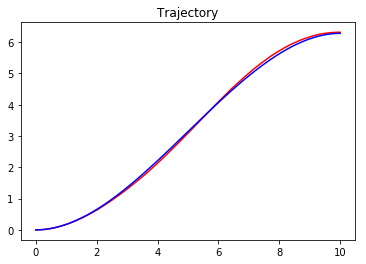

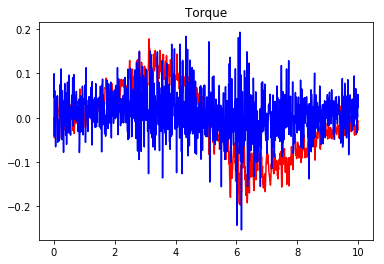

Value Loss : [ 25.31943512]
Policy Loss : [ 11.69598198]
EPISODE 308 STATE [-0.03326625  0.02729329] REWARD  [ 1.93670988] ACTION ([-0.00920707]) 3979298])                           

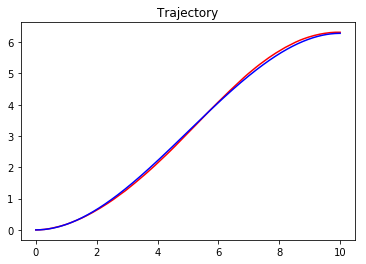

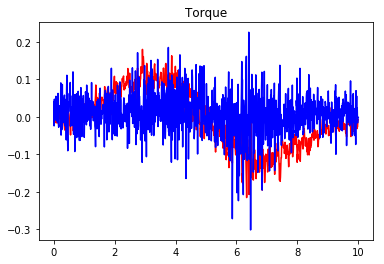

Value Loss : [ 33.85484695]
Policy Loss : [ 35.26786804]
EPISODE 309 STATE [-0.03220264  0.01767418] REWARD  [ 1.94710913] ACTION ([ 0.02324819]) 0044315])                 

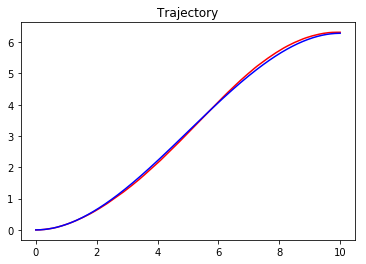

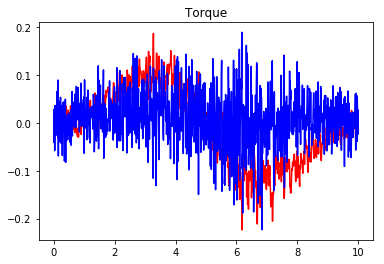

Value Loss : [ 24.08263016]
Policy Loss : [ 21.54309082]
EPISODE 310 STATE [-0.03484002  0.00235678] REWARD  [ 1.95966642] ACTION ([ 0.04584145]) 05]) 33])                    

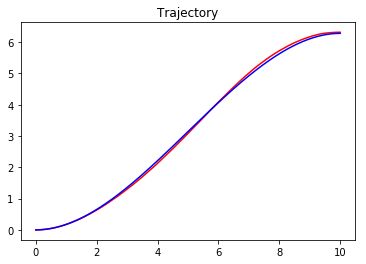

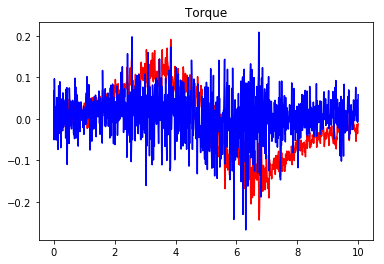

Value Loss : [ 30.48872375]
Policy Loss : [ 20.73598671]
EPISODE 311 STATE [-0.03854346  0.02797089] REWARD  [ 1.93096203] ACTION ([ 0.02687021]) 563665])                       

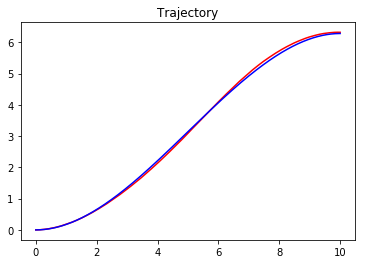

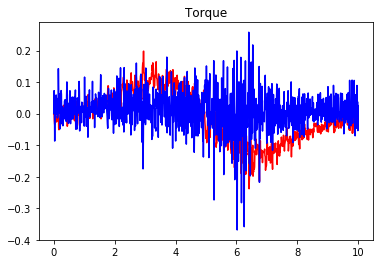

Value Loss : [ 36.40571594]
Policy Loss : [ 18.241642]
EPISODE 312 STATE [-0.03444053 -0.00458861] REWARD  [ 1.96534942] ACTION ([-0.03995968]) 2114858])                 

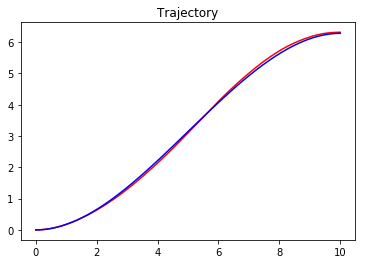

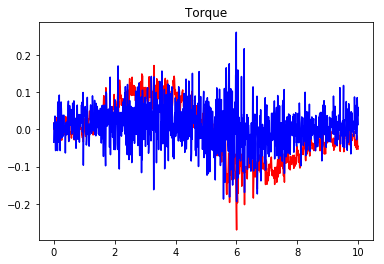

Value Loss : [ 25.13133621]
Policy Loss : [ 1.70043945]
EPISODE 313 STATE [-0.03416291  0.01559183] REWARD  [ 1.94725307] ACTION ([ 0.00380922]) 529684])           

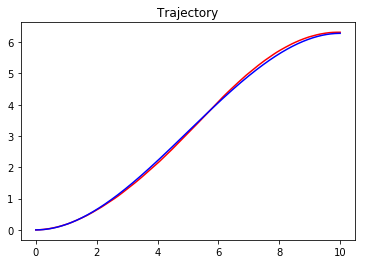

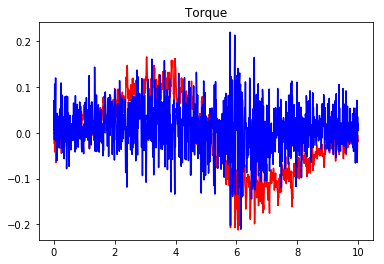

Value Loss : [ 27.42551422]
Policy Loss : [-6.05769491]
EPISODE 314 STATE [-0.03421161  0.02566101] REWARD  [ 1.9373795] ACTION ([-0.07426412])  05]) 01])               

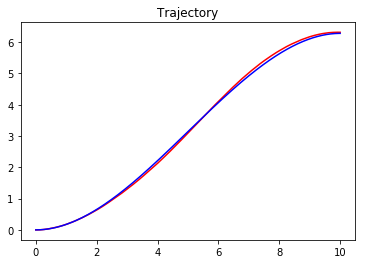

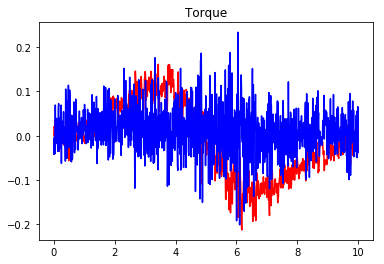

Value Loss : [ 29.56316376]
Policy Loss : [ 14.52250099]
EPISODE 315 STATE [-0.03679341 -0.03166084] REWARD  [ 1.93639152] ACTION ([ 0.07070945]) 758959])                     

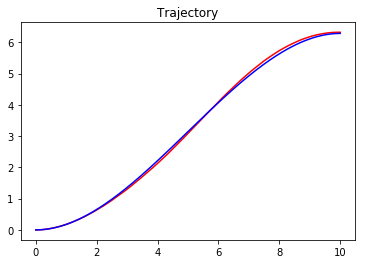

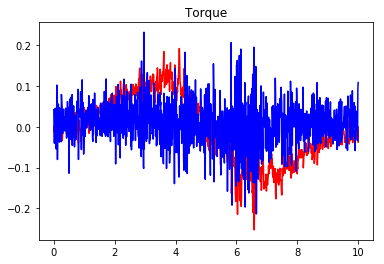

Value Loss : [ 32.05553818]
Policy Loss : [ 3.12225389]
EPISODE 316 STATE [-0.03493121  0.04049361] REWARD  [ 1.92238826] ACTION ([-0.01308025]) 5162105])                    

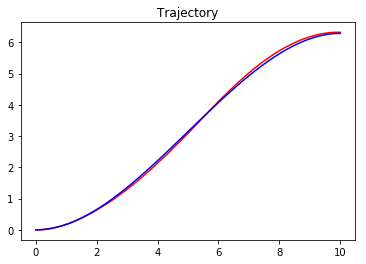

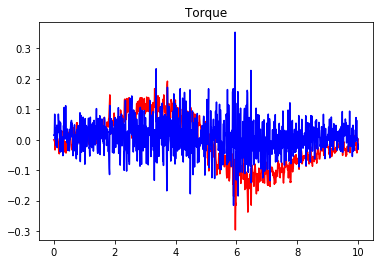

Value Loss : [ 25.81846428]
Policy Loss : [-10.56903172]
EPISODE 317 STATE [-0.03386595  0.00136107] REWARD  [ 1.96159773] ACTION ([ 0.02849792]) 7634815])                       

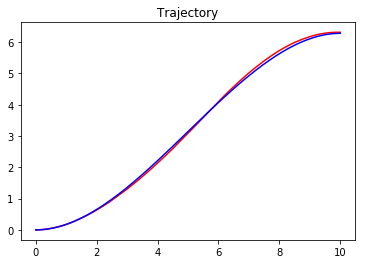

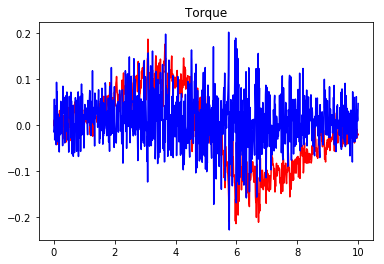

Value Loss : [ 32.73485947]
Policy Loss : [ 3.99814939]
EPISODE 318 STATE [-0.03768724  0.02617187] REWARD  [ 1.93353062] ACTION ([-0.03032608]) 9002275])                   

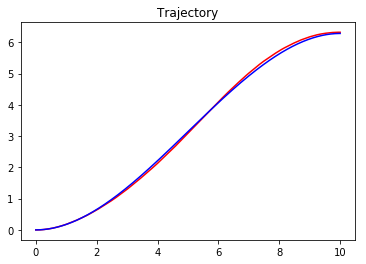

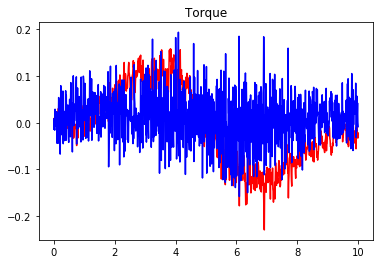

Value Loss : [ 33.79489517]
Policy Loss : [-4.21903849]
EPISODE 319 STATE [-0.03312674  0.04574552] REWARD  [ 1.91912108] ACTION ([-0.00597062]) 2781465])              

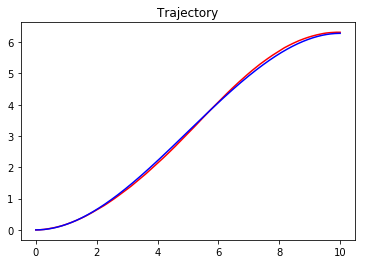

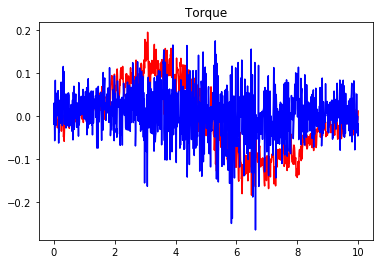

Value Loss : [ 33.1067009]
Policy Loss : [ 25.17664146]
EPISODE 320 STATE [-0.0364797   0.01449206] REWARD  [ 1.94609592] ACTION ([-0.00045523]) 228357])                  

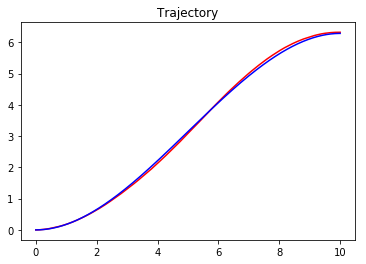

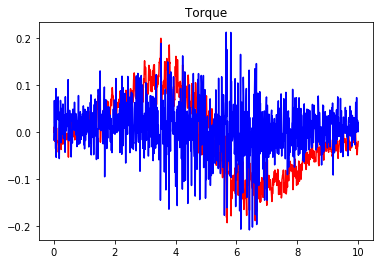

Value Loss : [ 30.83390427]
Policy Loss : [ 5.34433985]
EPISODE 321 STATE [-0.03315484  0.02795721] REWARD  [ 1.93617426] ACTION ([ 0.00522301]) 202409])                 

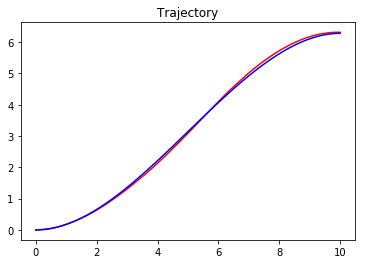

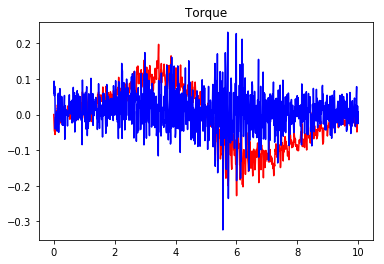

Value Loss : [ 31.05091095]
Policy Loss : [ 19.23188782]
EPISODE 322 STATE [-0.03498481  0.00854881] REWARD  [ 1.95339142] ACTION ([ 0.02591552]) 351659])           

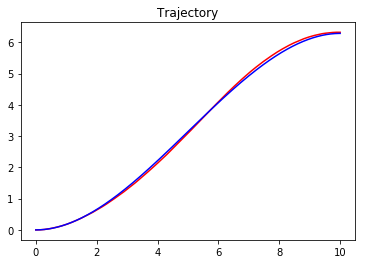

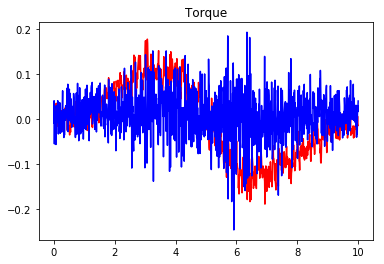

Value Loss : [ 28.98967171]
Policy Loss : [ 13.77349663]
EPISODE 323 STATE [-0.02989676  0.03031563] REWARD  [ 1.93704922] ACTION ([-0.05173861]) 6405374])           

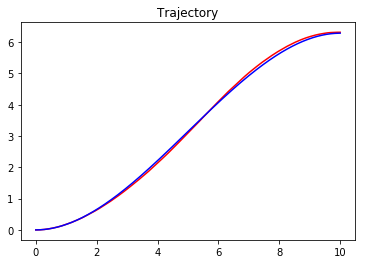

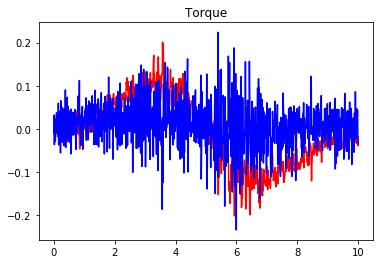

Value Loss : [ 27.4569931]
Policy Loss : [ 17.85656738]
EPISODE 324 STATE [-0.03340569  0.02134066] REWARD  [ 1.94236276] ACTION ([-0.08089432]) 3992098])                   

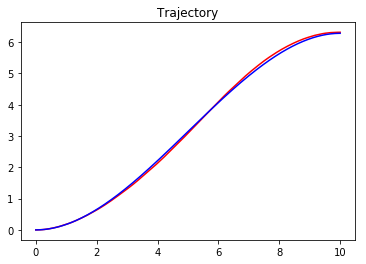

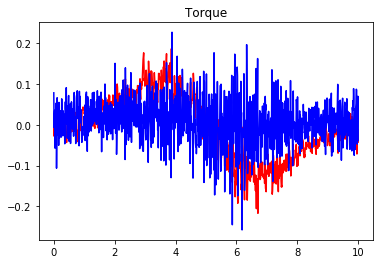

Value Loss : [ 38.00564957]
Policy Loss : [ 28.95582008]
EPISODE 325 STATE [-0.03453789  0.0248774 ] REWARD  [ 1.93782542] ACTION ([ 0.01164173]) 05]) 21])          

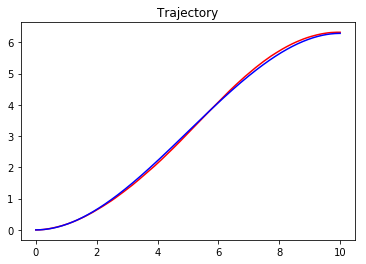

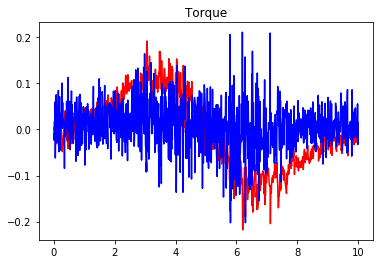

Value Loss : [ 29.50353813]
Policy Loss : [ 7.1996212]
EPISODE 326 STATE [-0.03390129  0.02960031] REWARD  [ 1.93386193] ACTION ([-0.04575541]) 05]) 6])                        

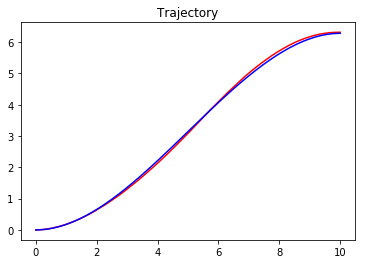

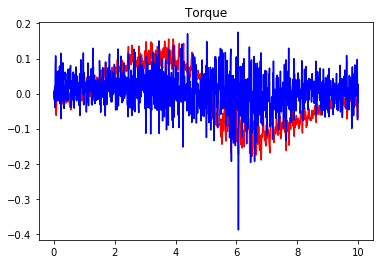

Value Loss : [ 34.41233063]
Policy Loss : [ 20.67884064]
EPISODE 327 STATE [-0.03607889  0.00858574] REWARD  [ 1.95229903] ACTION ([ 0.04424665]) 05]) 36])               

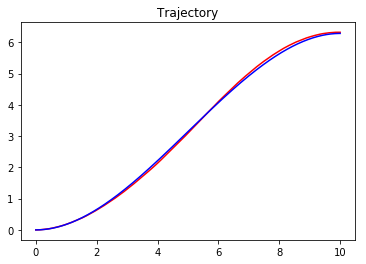

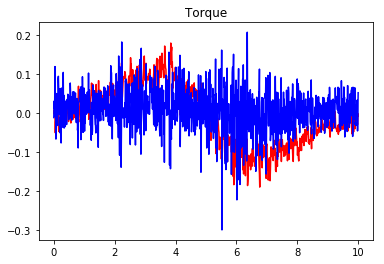

Value Loss : [ 26.60616684]
Policy Loss : [ 14.55781841]
EPISODE 328 STATE [-0.03698334 -0.01260302] REWARD  [ 1.95491989] ACTION ([ 0.01428393]) 05]) 69])          

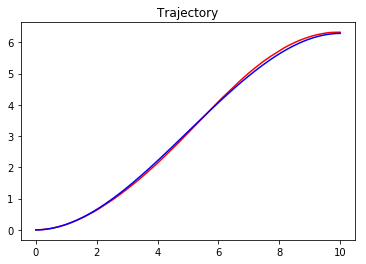

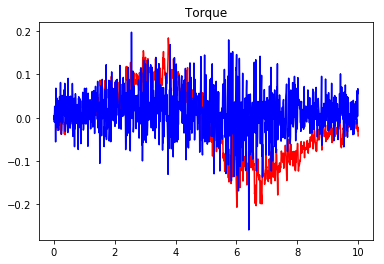

Value Loss : [ 24.44580269]
Policy Loss : [ 13.85786247]
EPISODE 329 STATE [-0.03747394  0.01362843] REWARD  [ 1.94598612] ACTION ([-0.01048093]) 1837254])                     

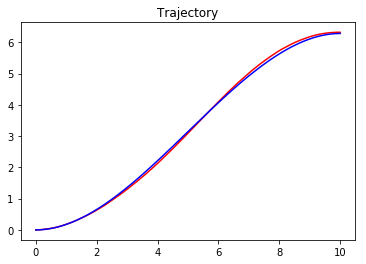

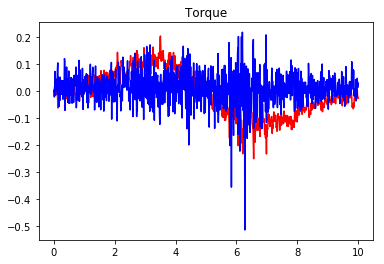

Value Loss : [ 46.78639984]
Policy Loss : [ 22.82507706]
EPISODE 330 STATE [-0.03769487 -0.00903269] REWARD  [ 1.95777969] ACTION ([ 0.0096765])  05]) 89])              

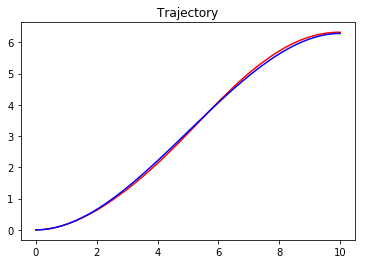

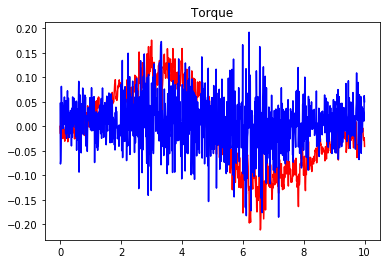

Value Loss : [ 21.58089066]
Policy Loss : [ 18.80408096]
EPISODE 331 STATE [-0.03250345  0.02783221] REWARD  [ 1.93692572] ACTION ([-0.03638031]) 95722]) )             

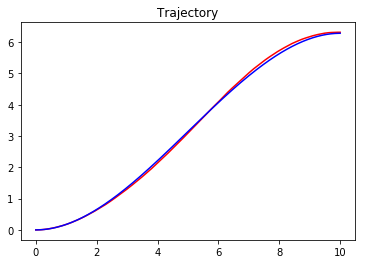

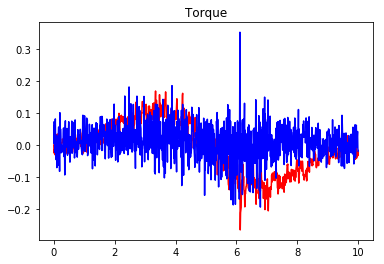

Value Loss : [ 29.47334099]
Policy Loss : [ 21.20972443]
EPISODE 332 STATE [-0.03562228  0.03792912] REWARD  [ 1.92417773] ACTION ([-0.03951838]) 05]) 28])             

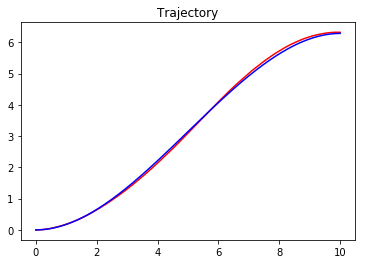

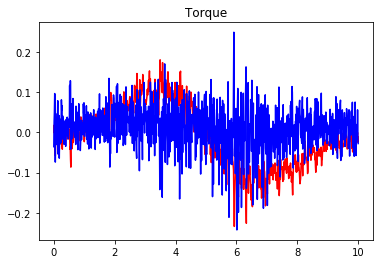

Value Loss : [ 26.73474884]
Policy Loss : [ 19.31188583]
EPISODE 333 STATE [-0.0367951  -0.00057943] REWARD  [ 1.96070264] ACTION ([ 0.05905082]) 9480536])             

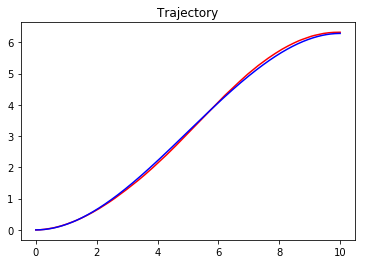

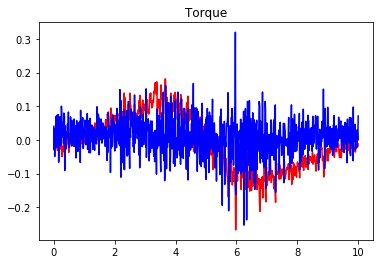

Value Loss : [ 30.11224174]
Policy Loss : [ 9.74713039]
EPISODE 334 STATE [-0.03474526 -0.0171611 ] REWARD  [ 1.95257145] ACTION ([ 0.05715161]) 985902])             

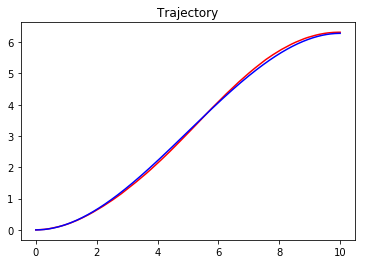

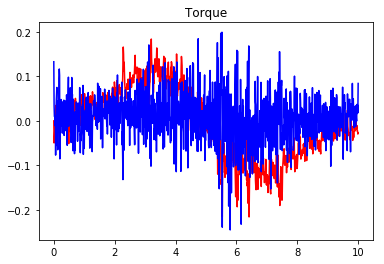

Value Loss : [ 32.46975327]
Policy Loss : [ 20.51794434]
EPISODE 335 STATE [-0.03378845  0.01860361] REWARD  [ 1.94466546] ACTION ([-0.02984421]) 4866581])        

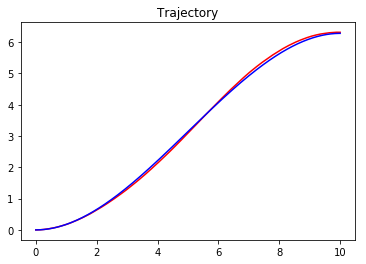

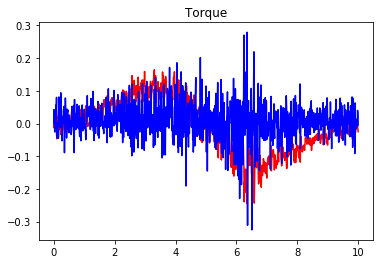

Value Loss : [ 29.48735809]
Policy Loss : [ 35.30628967]
EPISODE 336 STATE [-0.03539671  0.02262105] REWARD  [ 1.9391912] ACTION ([ 0.04306585])  05]) 29])                    

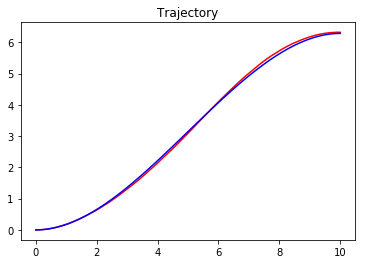

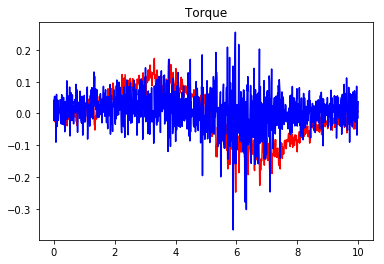

Value Loss : [ 34.84347153]
Policy Loss : [ 20.71552467]
EPISODE 337 STATE [-0.03367321  0.02805874] REWARD  [ 1.93557456] ACTION ([ 0.02121579]) 0929673])        

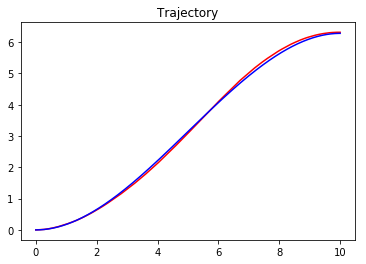

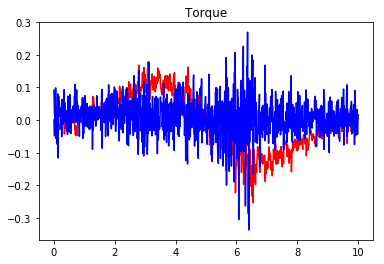

Value Loss : [ 35.23854446]
Policy Loss : [ 1.85277677]
EPISODE 338 STATE [-0.03303341 -0.01047587] REWARD  [ 1.9608447] ACTION ([-0.02192359])  791301])               

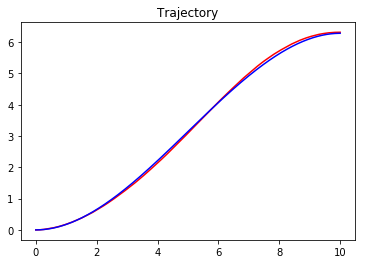

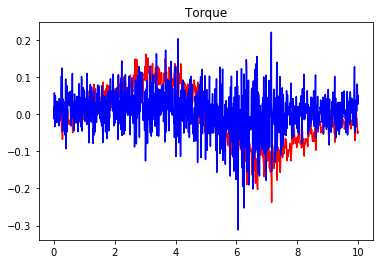

Value Loss : [ 36.05582809]
Policy Loss : [ 20.52225494]
EPISODE 339 STATE [-0.03380913 -0.00585304] REWARD  [ 1.96469705] ACTION ([ 0.01418408]) 1556455])                 

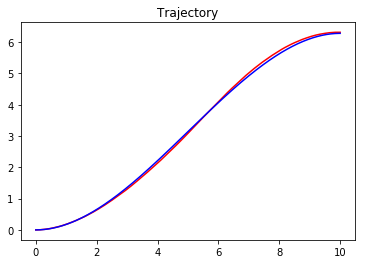

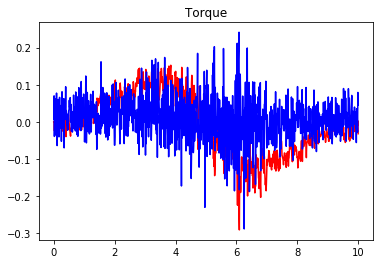

Value Loss : [ 25.59095573]
Policy Loss : [ 24.77081871]
EPISODE 340 STATE [-0.03994709  0.05577687] REWARD  [ 1.9030463] ACTION ([-0.10023232])  05]) 72])          

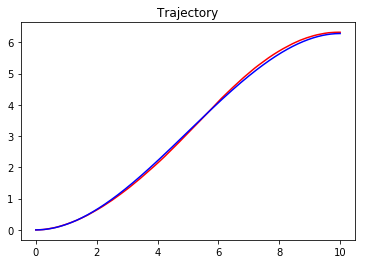

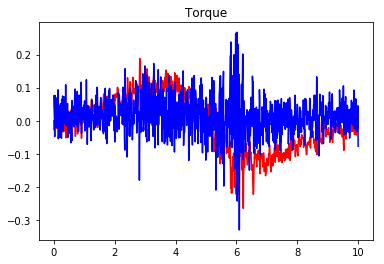

Value Loss : [ 25.67592049]
Policy Loss : [ 4.43444109]
EPISODE 341 STATE [-0.03468359  0.0097739 ] REWARD  [ 1.95247299] ACTION ([ 0.00347658]) 8873411])              

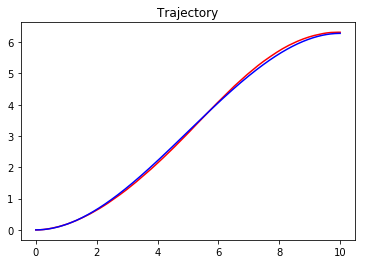

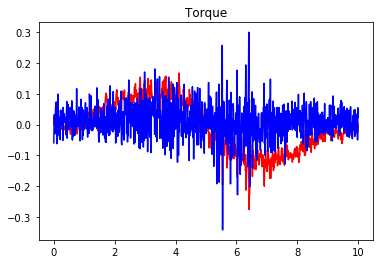

Value Loss : [ 29.42040634]
Policy Loss : [ 9.46152592]
EPISODE 342 STATE [-0.03652201 -0.03129525] REWARD  [ 1.93700876] ACTION ([ 0.04452941]) 148112])  06])               

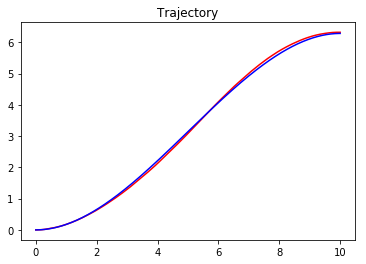

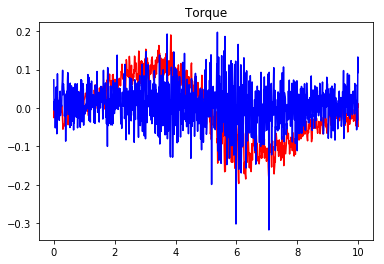

Value Loss : [ 31.0131855]
Policy Loss : [ 14.3688488]
EPISODE 343 STATE [-0.03393384  0.01740028] REWARD  [ 1.94570232] ACTION ([-0.01521901]) 3784591])          

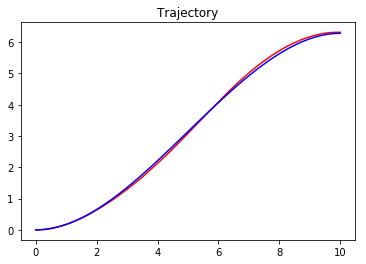

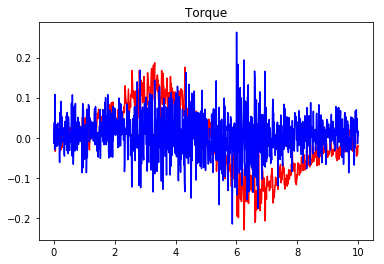

Value Loss : [ 23.78010559]
Policy Loss : [-2.39291716]
EPISODE 344 STATE [-0.0351438  0.0194323] REWARD  [ 1.942546] ACTION ([-0.00239668]) 8]) 4395154])                     

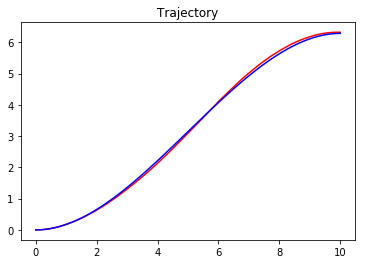

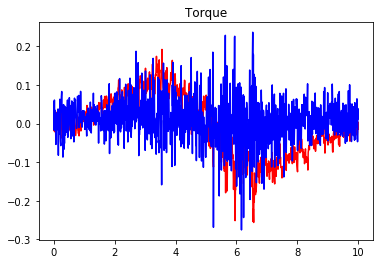

Value Loss : [ 33.89120102]
Policy Loss : [ 8.33362103]
EPISODE 345 STATE [-0.03701987  0.00647461] REWARD  [ 1.95347921] ACTION ([ 0.02216682]) 388963])               

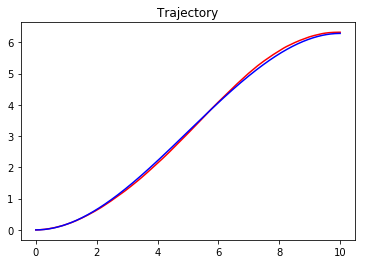

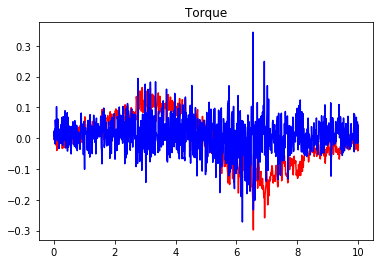

Value Loss : [ 50.44562531]
Policy Loss : [ 1.09200764]
EPISODE 346 STATE [-0.03223776 -0.02509006] REWARD  [ 1.94720381] ACTION ([ 0.04696339]) 05]) 4])                

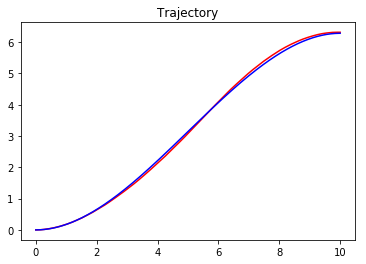

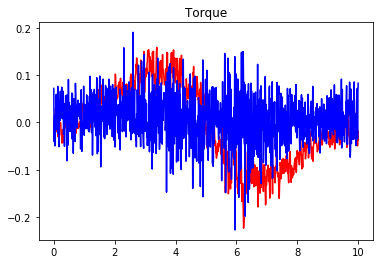

Value Loss : [ 25.07923698]
Policy Loss : [ 12.87684917]
EPISODE 347 STATE [-0.03278829  0.05278323] REWARD  [ 1.91277438] ACTION ([-0.01034411]) 1352537])             

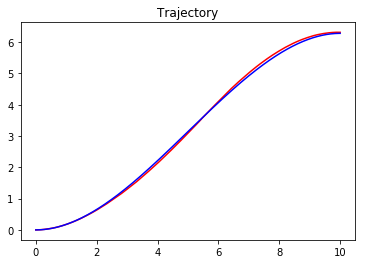

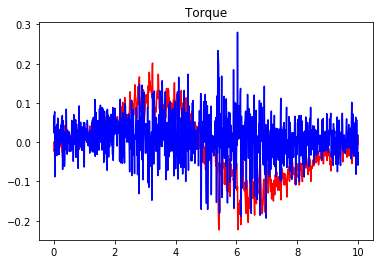

Value Loss : [ 28.67964172]
Policy Loss : [ 11.43436718]
EPISODE 348 STATE [-0.03325129 -0.00618174] REWARD  [ 1.96490854] ACTION ([ 0.02999478]) 2460642])           

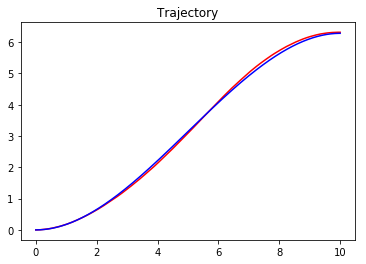

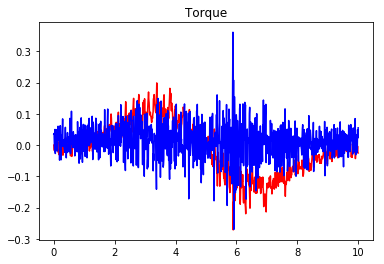

Value Loss : [ 36.35407639]
Policy Loss : [-0.37496272]
EPISODE 349 STATE [-0.04217169  0.0129505 ] REWARD  [ 1.94213814] ACTION ([-0.05587866]) 688197])                 

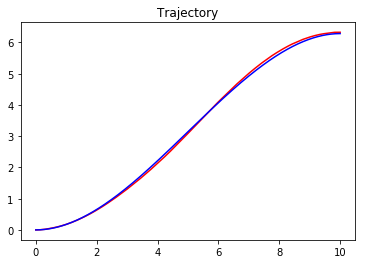

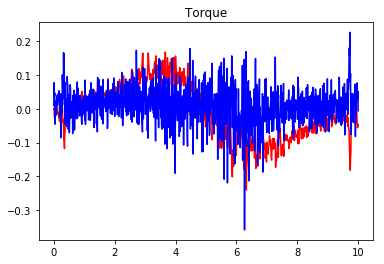

Value Loss : [ 34.0375824]
Policy Loss : [ 14.72870159]
EPISODE 350 STATE [-0.0336586   0.02869958] REWARD  [ 1.93496811] ACTION ([ 0.03103])2]) 05]) 51])               

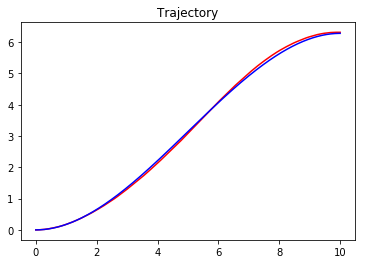

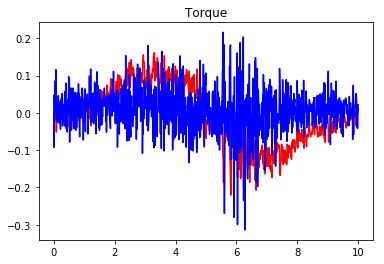

Value Loss : [ 32.3492775]
Policy Loss : [ 21.62597466]
EPISODE 351 STATE [-0.03669856  0.01080451] REWARD  [ 1.94951242] ACTION ([-0.04298066]) 8376425])              

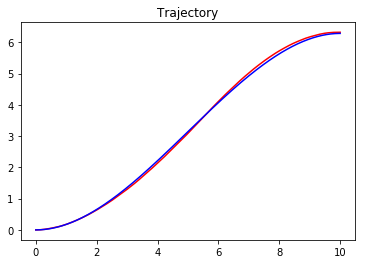

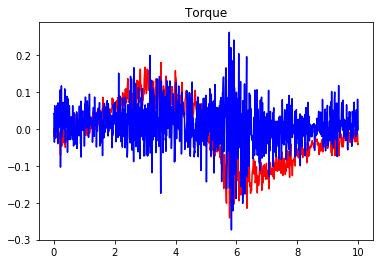

Value Loss : [ 34.70976257]
Policy Loss : [ 11.54156971]
EPISODE 352 STATE [-0.03713561 -0.02601961] REWARD  [ 1.94156332] ACTION ([ 0.05460375]) 600123])                    

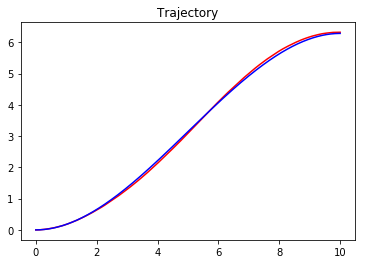

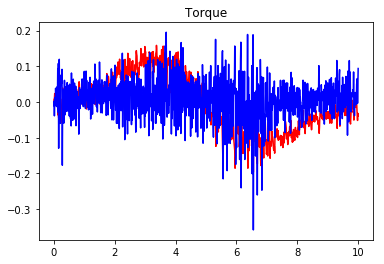

Value Loss : [ 23.99079323]
Policy Loss : [ 21.68580055]
EPISODE 353 STATE [-0.03446679 -0.01114327] REWARD  [ 1.95879615] ACTION ([ 0.03534543]) 05]) 12])             

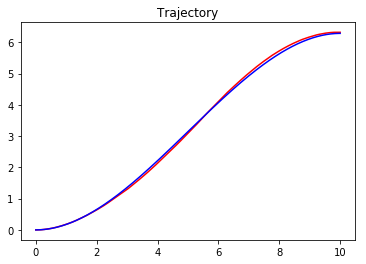

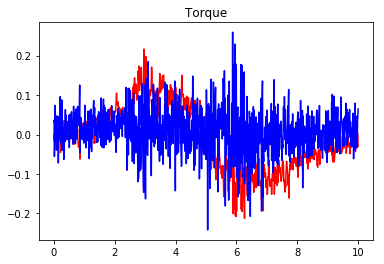

Value Loss : [ 24.43502808]
Policy Loss : [ 9.30901718]
EPISODE 354 STATE [-0.03675671  0.0126553 ] REWARD  [ 1.94763404] ACTION ([-0.02799647]) 05]) 63])              

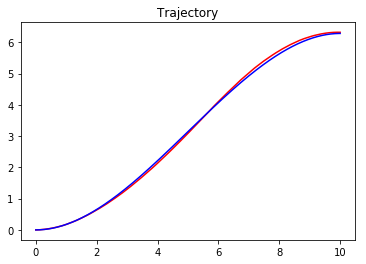

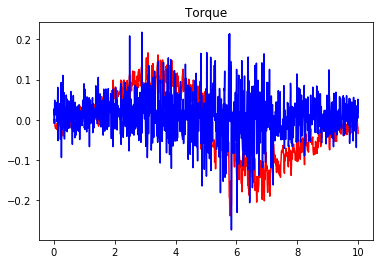

Value Loss : [ 29.6415062]
Policy Loss : [ 5.46201468]
EPISODE 355 STATE [-0.0381558  0.0156033] REWARD  [ 1.94339067] ACTION ([ 0.01340653])   5033053])         

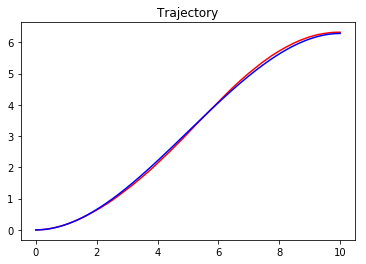

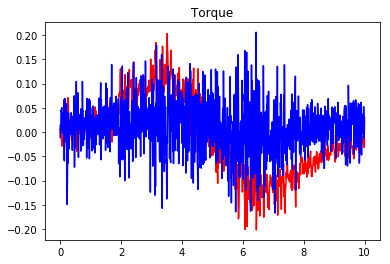

Value Loss : [ 24.67271233]
Policy Loss : [ 7.27157974]
EPISODE 356 STATE [-0.03430751  0.05549494] REWARD  [ 1.90874611] ACTION ([-0.02603724]) 05]) 26])             

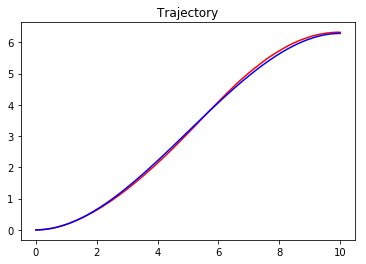

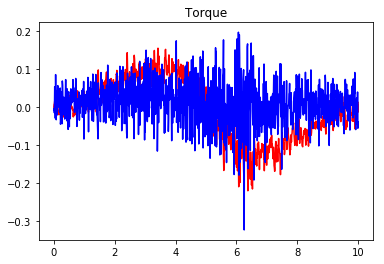

Value Loss : [ 29.21496964]
Policy Loss : [ 13.308918]
EPISODE 357 STATE [-0.03510465  0.04040774] REWARD  [ 1.92230295] ACTION ([-0.00302261]) 0743013])           

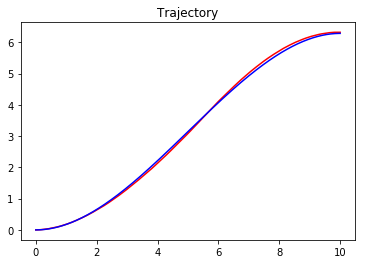

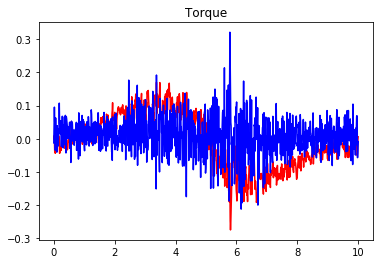

Value Loss : [ 35.25408173]
Policy Loss : [ 6.39706945]
EPISODE 358 STATE [-0.03393202 -0.00088085] REWARD  [ 1.9637668] ACTION ([ 0.021987])])  05]) 93])             

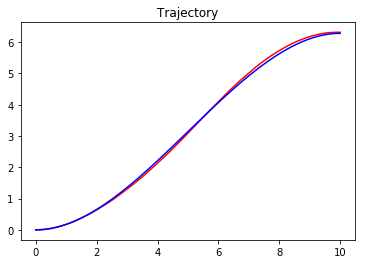

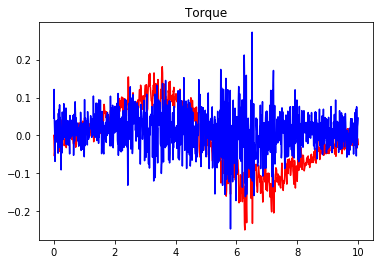

Value Loss : [ 35.19020844]
Policy Loss : [-0.16085446]
EPISODE 359 STATE [-0.0353816  0.025515 ] REWARD  [ 1.93639129] ACTION ([-0.06192722]) ) 05]) 04])         

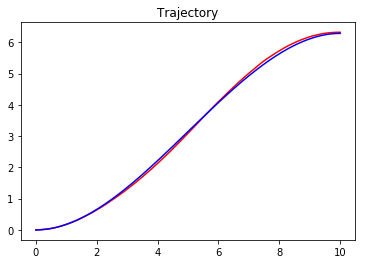

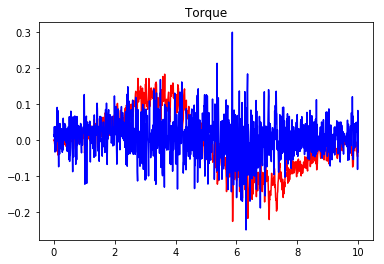

Value Loss : [ 41.62625504]
Policy Loss : [ 15.51128197]
EPISODE 360 STATE [-0.03543222  0.0410413 ] REWARD  [ 1.92138073] ACTION ([-0.06982786]) 6417403])               

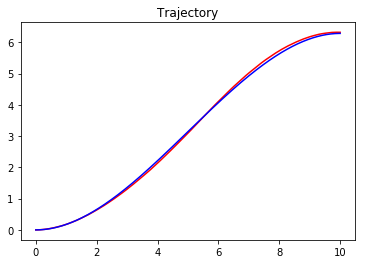

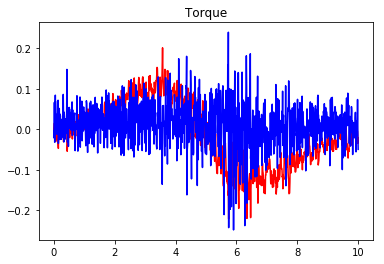

Value Loss : [ 33.49868393]
Policy Loss : [ 13.96644783]
EPISODE 361 STATE [-0.03221828  0.01990745] REWARD  [ 1.94491054] ACTION ([-0.01124197]) 05]) 36])         

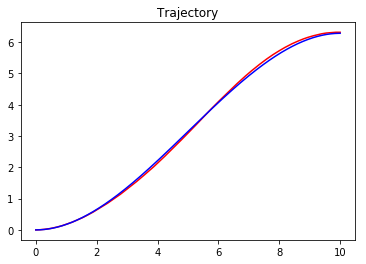

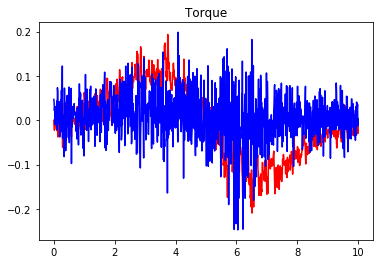

Value Loss : [ 32.54190826]
Policy Loss : [ 23.96664429]
EPISODE 362 STATE [-0.03321388 -0.0016655 ] REWARD  [ 1.96524393] ACTION ([-0.02513568]) 5654509])                  

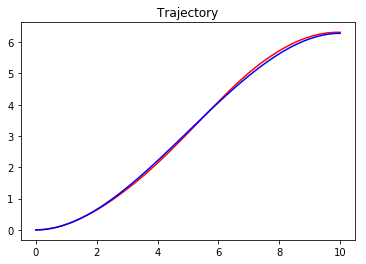

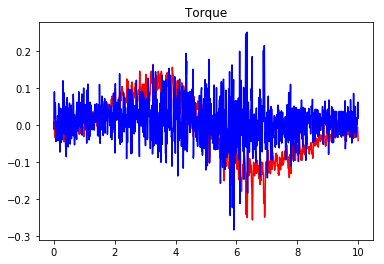

Value Loss : [ 42.0480423]
Policy Loss : [ 0.83727902]
EPISODE 363 STATE [-0.03728737  0.05214721] REWARD  [ 1.90903136] ACTION ([-0.08260698]) 05]) 37])           

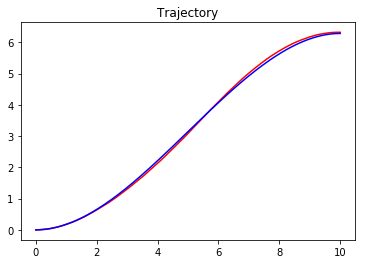

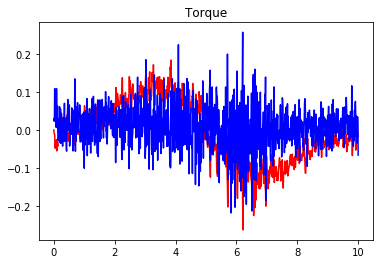

Value Loss : [ 29.75999832]
Policy Loss : [ 3.10813808]
EPISODE 364 STATE [-0.03748708  0.02093398] REWARD  [ 1.9388201] ACTION ([ 0.01540549])  8281072])           

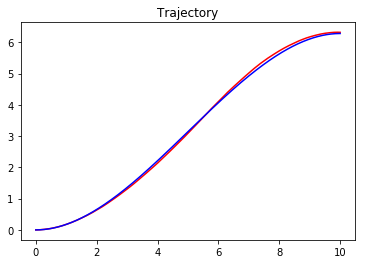

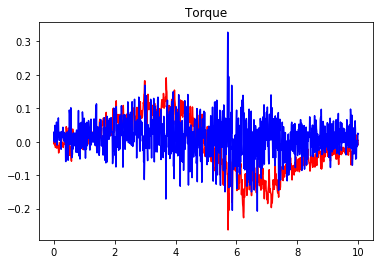

Value Loss : [ 29.77692223]
Policy Loss : [ 3.04097819]
EPISODE 365 STATE [-0.03247397  0.01966305] REWARD  [ 1.94490168] ACTION ([-0.03981528]) 06]) 75])         

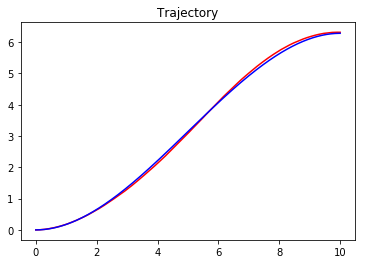

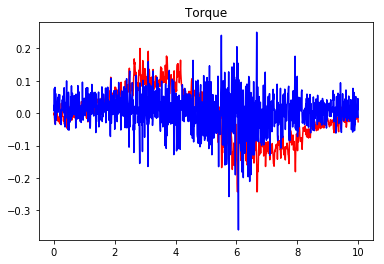

Value Loss : [ 36.63192749]
Policy Loss : [ 14.84350777]
EPISODE 366 STATE [-0.03618622  0.00092941] REWARD  [ 1.95978682] ACTION ([-0.01689285]) 06]) 01])         

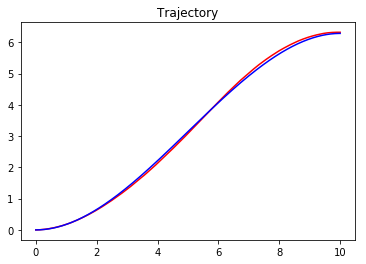

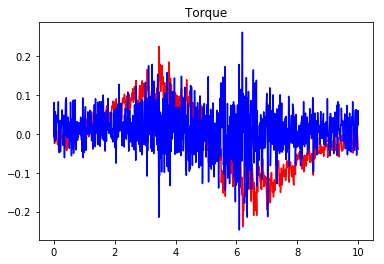

Value Loss : [ 29.17394066]
Policy Loss : [ 12.5343256]
EPISODE 367 STATE [-0.03510777  0.02254572] REWARD  [ 1.93954351] ACTION ([-0.0543951])  1486022])         

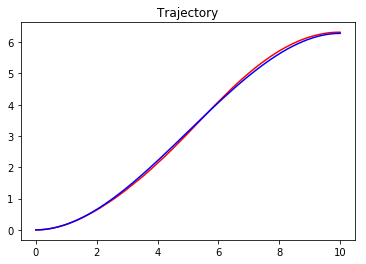

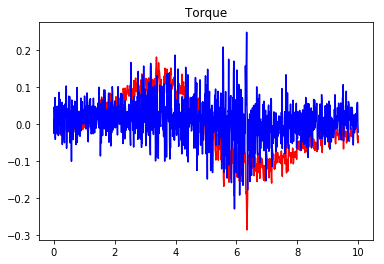

Value Loss : [ 25.06678391]
Policy Loss : [ 7.03399134]
EPISODE 368 STATE [-0.03479193  0.01811964] REWARD  [ 1.94416917] ACTION ([ 0.05810671]) 2363851])         

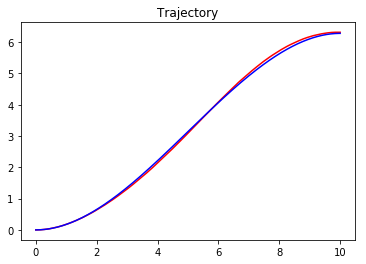

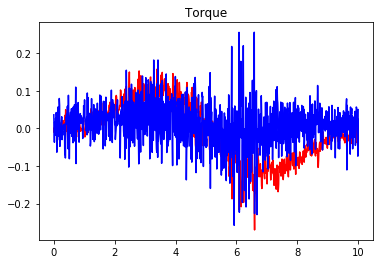

Value Loss : [ 27.37252617]
Policy Loss : [ 23.29795837]
EPISODE 369 STATE [-0.03211966  0.00360968] REWARD  [ 1.9610528] ACTION ([ 0.06623167])  2907683])                

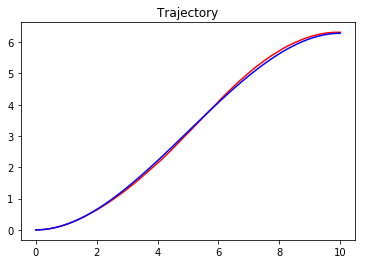

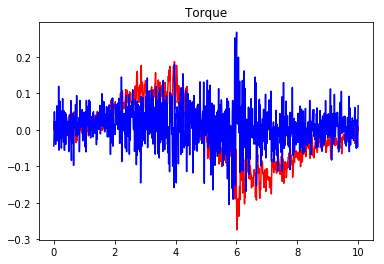

Value Loss : [ 29.75259781]
Policy Loss : [-1.46918583]
EPISODE 370 STATE [-0.03928606 -0.00514538] REWARD  [ 1.96012301] ACTION ([-0.03180544]) 5]) 115])              

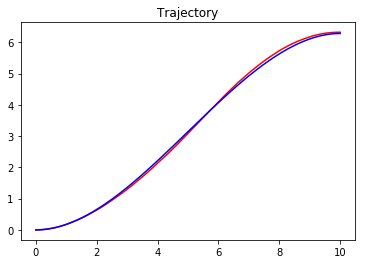

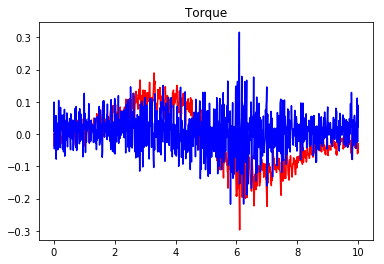

Value Loss : [ 37.94508743]
Policy Loss : [ 5.45386314]
EPISODE 371 STATE [-0.03589538  0.02647648] REWARD  [ 1.93496221] ACTION ([ 0.04021623]) 0163078])            

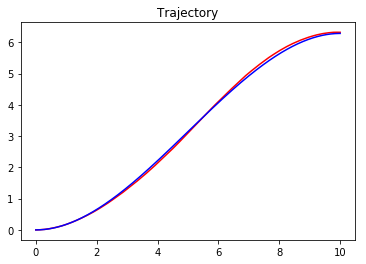

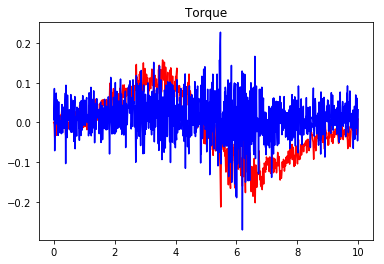

Value Loss : [ 29.01048851]
Policy Loss : [ 14.83070755]
EPISODE 372 STATE [-0.03700422  0.02144466] REWARD  [ 1.93878723] ACTION ([-0.05130789]) 648669])        

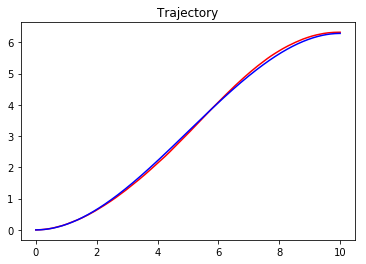

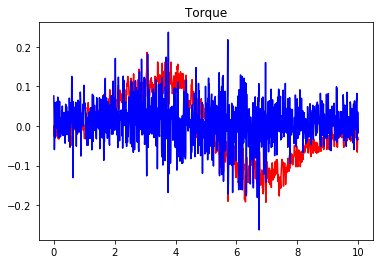

Value Loss : [ 29.37412834]
Policy Loss : [ 7.1378231]
EPISODE 373 STATE [-0.03870561  0.00729246] REWARD  [ 1.9510469] ACTION ([ 0.01256223])  69069]) )          

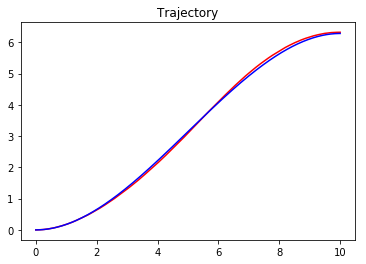

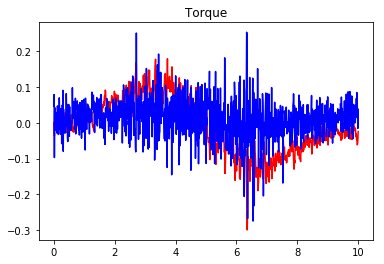

Value Loss : [ 21.85185242]
Policy Loss : [ 13.3925848]
EPISODE 374 STATE [-0.03456153  0.0058036 ] REWARD  [ 1.95651556] ACTION ([ 0.06572417]) 204654])                

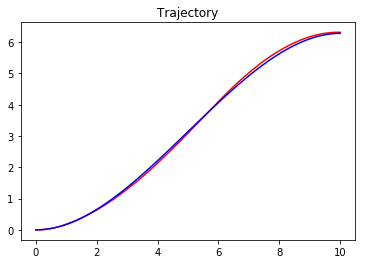

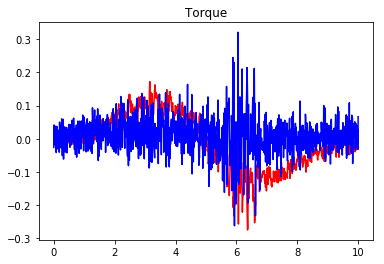

Value Loss : [ 38.5483017]
Policy Loss : [ 11.69501877]
EPISODE 375 STATE [-0.0368339   0.00039941] REWARD  [ 1.95969] ACTION ([ 0.05517314]) ]) 452608])            

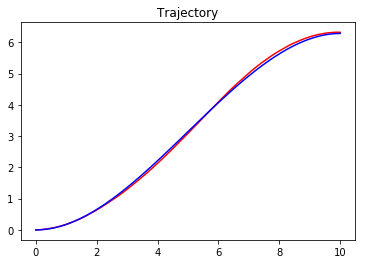

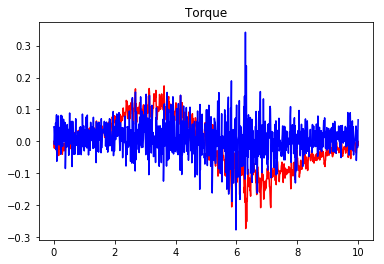

Value Loss : [ 36.09170151]
Policy Loss : [ 20.6192112]
EPISODE 376 STATE [-0.03316811  0.00790831] REWARD  [ 1.95578015] ACTION ([-0.05399993]) 3094134])         

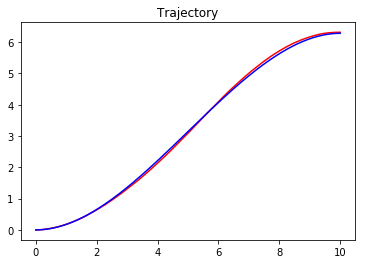

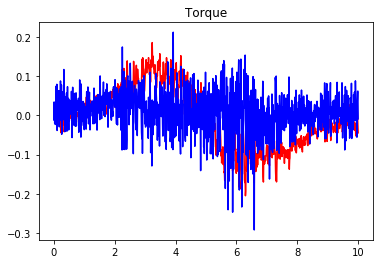

Value Loss : [ 34.29701233]
Policy Loss : [ 25.79707718]
EPISODE 377 STATE [-0.03581895  0.03703539] REWARD  [ 1.92484557] ACTION ([-0.02440134]) 0180836])               

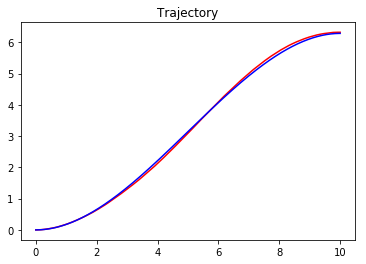

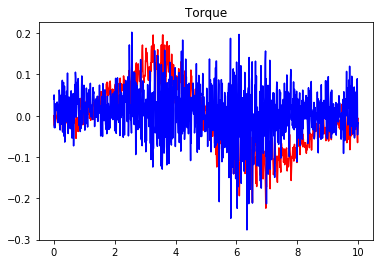

Value Loss : [ 37.54892731]
Policy Loss : [ 17.36966705]
EPISODE 378 STATE [-0.03708874  0.05228139] REWARD  [ 1.90909587] ACTION ([-0.05210377]) 06]) 73])              

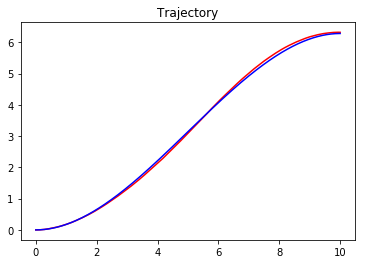

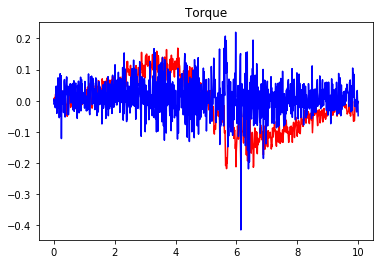

Value Loss : [ 23.28095055]
Policy Loss : [ 15.4497633]
EPISODE 379 STATE [-0.03498897  0.03493832] REWARD  [ 1.92766201] ACTION ([-0.0122597])  3777712])         

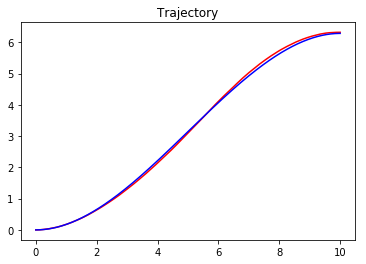

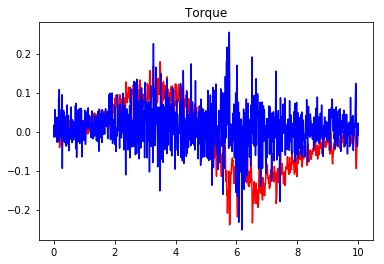

Value Loss : [ 26.31926727]
Policy Loss : [ 2.00255561]
EPISODE 380 STATE [-0.03736701  0.02925958] REWARD  [ 1.93084707] ACTION ([ 0.00721222]) 1651125])               

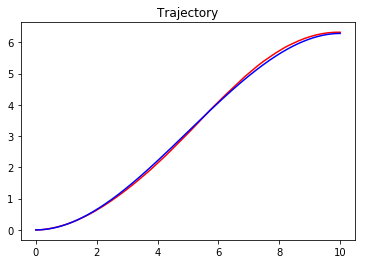

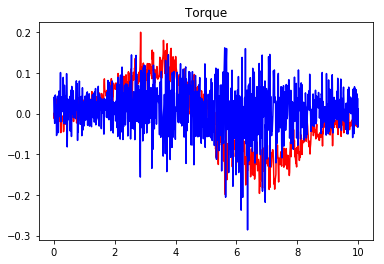

Value Loss : [ 34.98591995]
Policy Loss : [ 17.06098175]
EPISODE 381 STATE [-0.03567148  0.03778173] REWARD  [ 1.92427163] ACTION ([-0.02841865]) 05]) 16])               

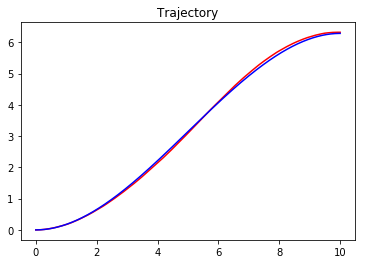

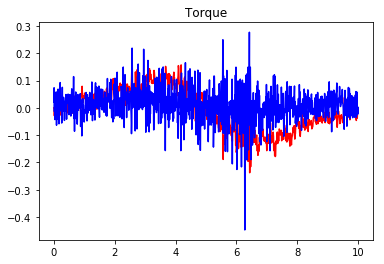

Value Loss : [ 28.62434769]
Policy Loss : [ 27.98797226]
EPISODE 382 STATE [-0.03819264  0.0208865 ] REWARD  [ 1.93818706] ACTION ([-0.08012467]) 3730417])                 

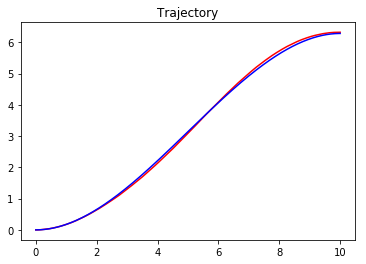

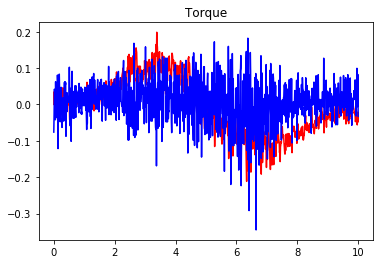

Value Loss : [ 25.26782417]
Policy Loss : [ 18.57835197]
EPISODE 383 STATE [-0.03775497  0.04356874] REWARD  [ 1.91672779] ACTION ([-0.06173883]) 05]) 49])               

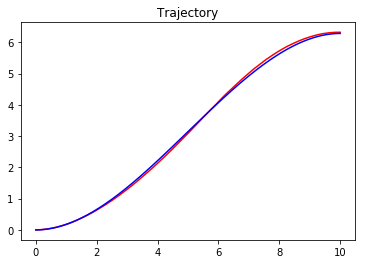

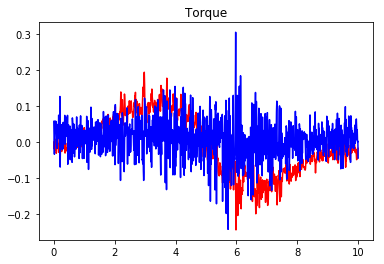

Value Loss : [ 22.27883911]
Policy Loss : [ 6.35272455]
EPISODE 384 STATE [-0.03360561  0.02155491] REWARD  [ 1.94196051] ACTION ([-0.00941801]) 05]) 81])           

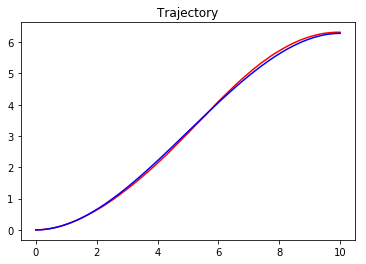

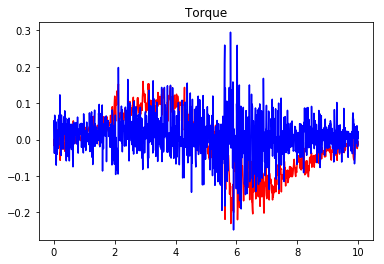

Value Loss : [ 28.54452133]
Policy Loss : [-2.50265408]
EPISODE 385 STATE [-0.03576547  0.01798797] REWARD  [ 1.94335818] ACTION ([ 0.009694]) ) 05]) 14])     

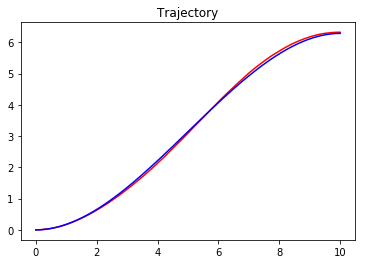

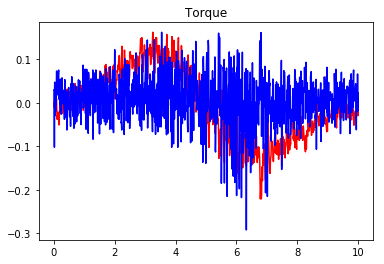

Value Loss : [ 31.0122776]
Policy Loss : [ 25.52188683]
EPISODE 386 STATE [-0.03426949  0.01103372] REWARD  [ 1.95163098] ACTION ([ 0.01353451]) 06]) 32])              

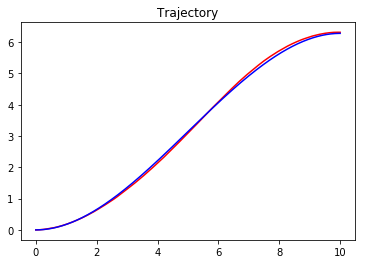

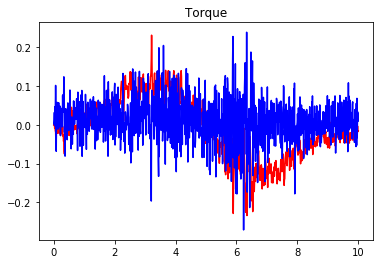

Value Loss : [ 30.34632492]
Policy Loss : [ 19.7519989]
EPISODE 387 STATE [-0.03556573  0.01669054] REWARD  [ 1.94482125] ACTION ([ 0.03347426]) 5]) 13])          

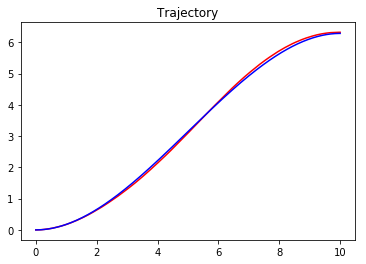

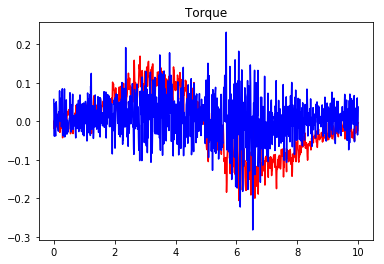

Value Loss : [ 22.57314491]
Policy Loss : [ 17.34350204]
EPISODE 388 STATE [-0.03495242  0.04921483] REWARD  [ 1.91406048] ACTION ([ 0.00168233]) 295213])                 

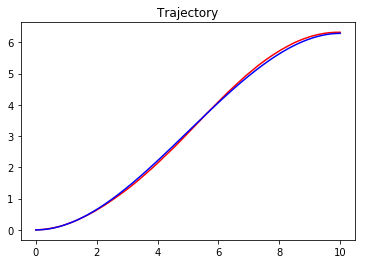

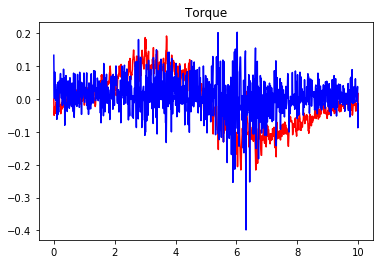

Value Loss : [ 25.65762711]
Policy Loss : [ 24.46795845]
EPISODE 389 STATE [-0.03530345  0.03042963] REWARD  [ 1.93170567] ACTION ([-0.00201535]) 8730114])           

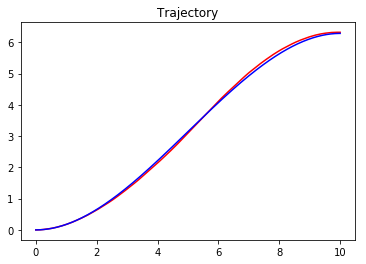

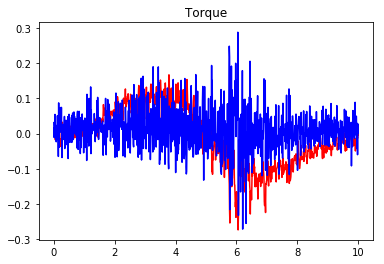

Value Loss : [ 35.31567764]
Policy Loss : [ 6.82927036]
EPISODE 390 STATE [-0.03278579  0.02866978] REWARD  [ 1.93584127] ACTION ([-0.02126806]) 05]) 46])     

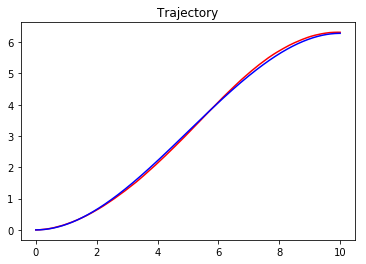

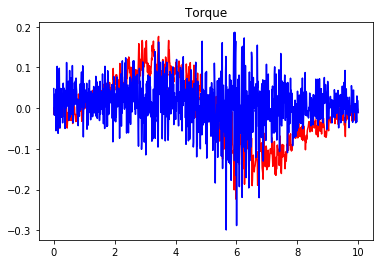

Value Loss : [ 28.72204781]
Policy Loss : [ 13.9452734]
EPISODE 391 STATE [-0.03402412 -0.00642101] REWARD  [ 1.9639226] ACTION ([-0.02496055])  1695865])          

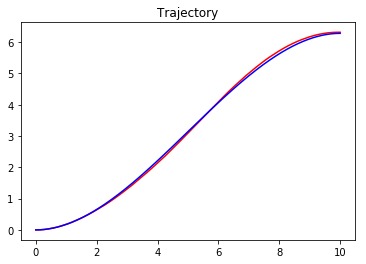

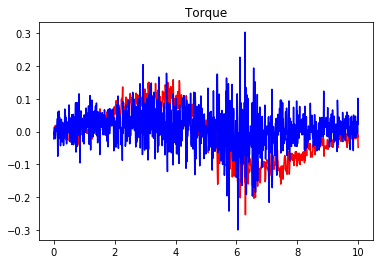

Value Loss : [ 26.7024498]
Policy Loss : [ 17.27636147]
EPISODE 392 STATE [-0.03905435  0.00640535] REWARD  [ 1.95158918] ACTION ([ 0.01322232]) 1767697])                  

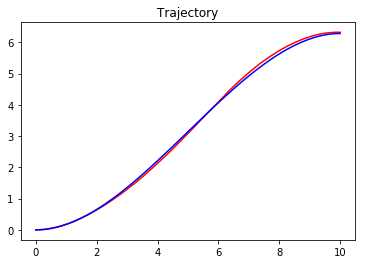

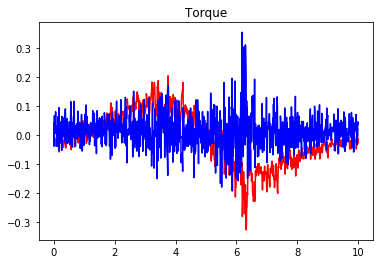

Value Loss : [ 46.40642166]
Policy Loss : [-19.91901016]
EPISODE 393 STATE [-0.03489339  0.00225302] REWARD  [ 1.959718] ACTION ([-0.01141962]) ) 2966266])              

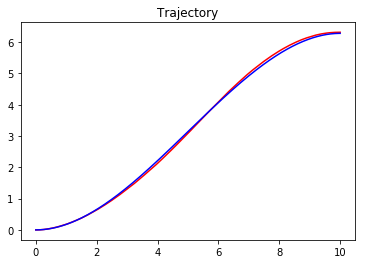

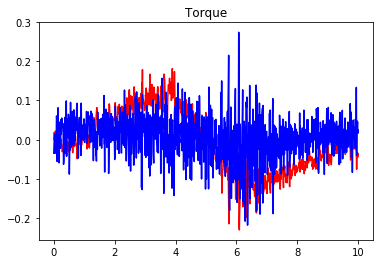

Value Loss : [ 31.09539032]
Policy Loss : [ 9.53817749]
EPISODE 394 STATE [-0.03541612  0.04162475] REWARD  [ 1.92083855] ACTION ([-0.01644515]) 4306]) ])              

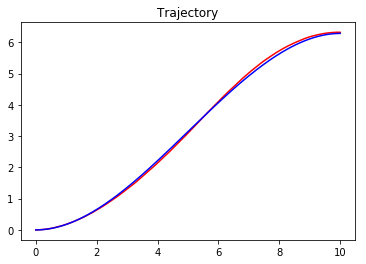

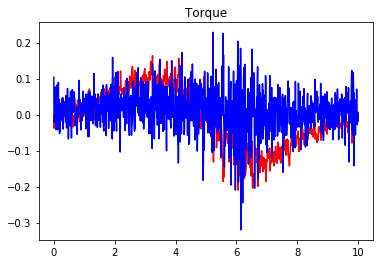

Value Loss : [ 32.75088882]
Policy Loss : [ 19.97514343]
EPISODE 395 STATE [-0.0332775  0.0194861] REWARD  [ 1.94429699] ACTION ([-0.04061925]) ) 05]) 88])      

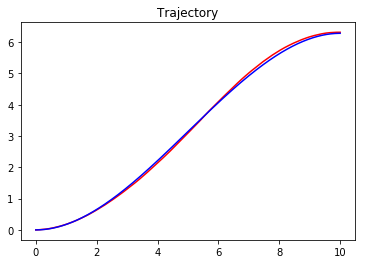

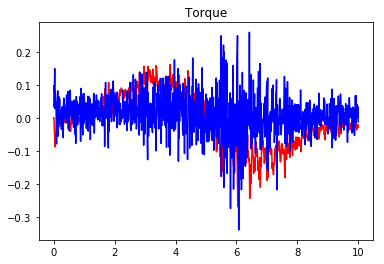

Value Loss : [ 40.31163025]
Policy Loss : [ 19.53483009]
EPISODE 396 STATE [-0.03680035  0.02053133] REWARD  [ 1.93987471] ACTION ([-0.04172397]) 9555644])           

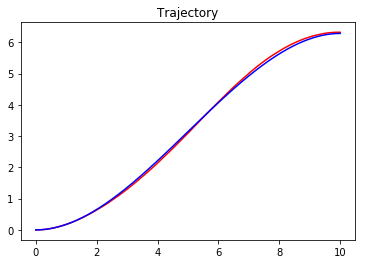

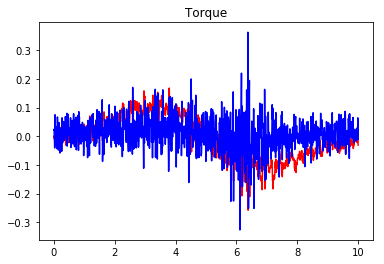

Value Loss : [ 22.73503304]
Policy Loss : [ 18.8654747]
EPISODE 397 STATE [-0.03687496  0.01474817] REWARD  [ 1.94546344] ACTION ([ 0.02658059]) 1121559])         

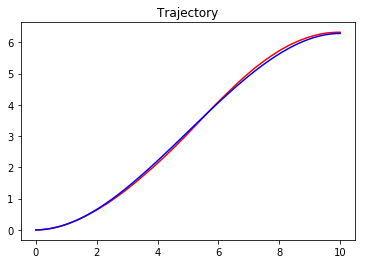

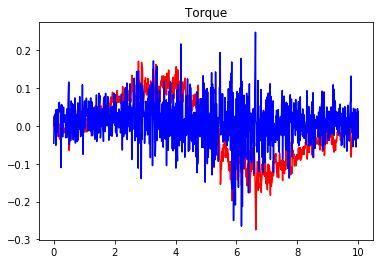

Value Loss : [ 27.76658821]
Policy Loss : [ 15.01287174]
EPISODE 398 STATE [-0.03442846  0.03628455] REWARD  [ 1.92690917] ACTION ([-0.03592733]) 2615488])                

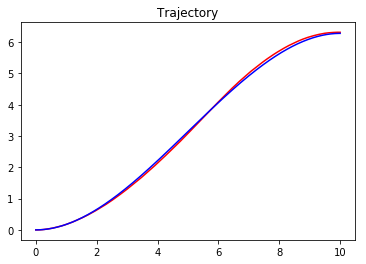

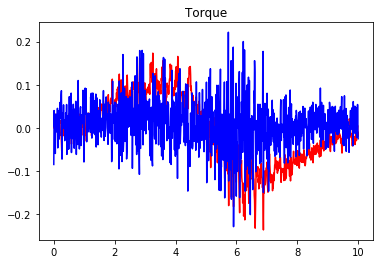

Value Loss : [ 29.79887962]
Policy Loss : [ 6.93820047]
EPISODE 399 STATE [-0.03312715 -0.00931052] REWARD  [ 1.96191225] ACTION ([ 0.05995971]) 05]) 74])       

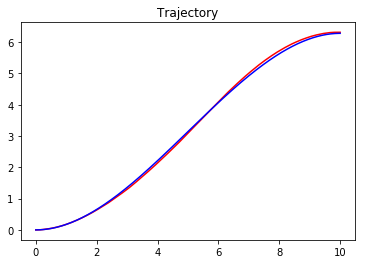

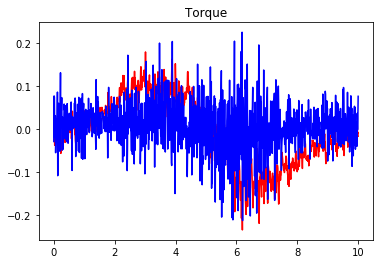

Value Loss : [ 28.12105179]
Policy Loss : [ 19.34210777]
EPISODE 400 STATE [-0.03727945  0.01686626] REWARD  [ 1.94299665] ACTION ([ 0.01224882]) 05]) 31])               

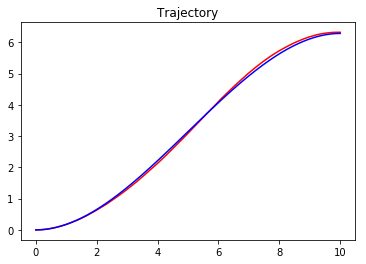

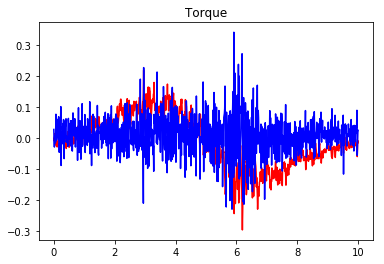

Value Loss : [ 30.42246246]
Policy Loss : [ 8.88201427]
EPISODE 401 STATE [-0.03923623  0.04039182] REWARD  [ 1.91833727] ACTION ([-0.00878924]) 6949826])                    

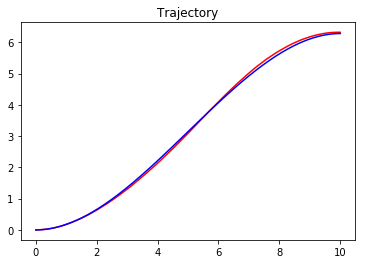

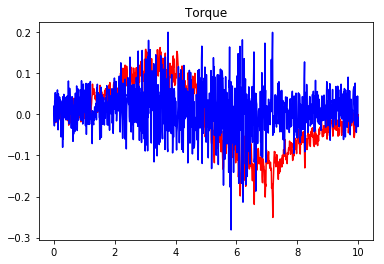

Value Loss : [ 44.56926346]
Policy Loss : [ 6.09036016]
EPISODE 402 STATE [-0.03435293  0.02085687] REWARD  [ 1.94191897] ACTION ([-0.00503463]) 4404558])                

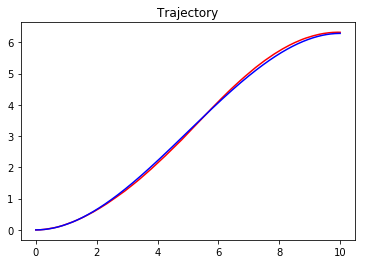

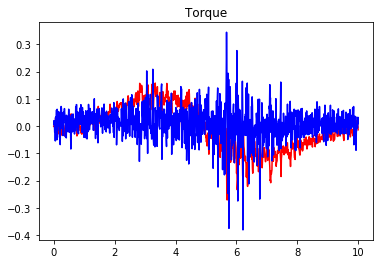

Value Loss : [ 38.32482529]
Policy Loss : [ 10.36623383]
EPISODE 403 STATE [-0.03572579 -0.0030956 ] REWARD  [ 1.96424519] ACTION ([ 0.00156451]) 9351851])     

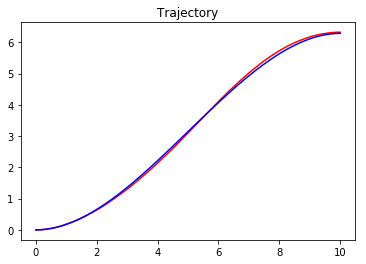

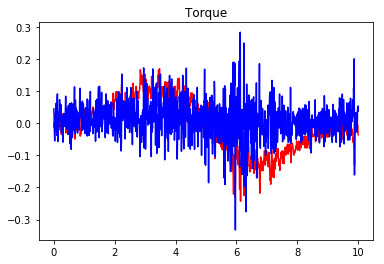

Value Loss : [ 33.13333511]
Policy Loss : [ 4.56212234]
EPISODE 404 STATE [-0.03205543  0.04354613] REWARD  [ 1.92225348] ACTION ([ 0.00228031]) 753905])                   

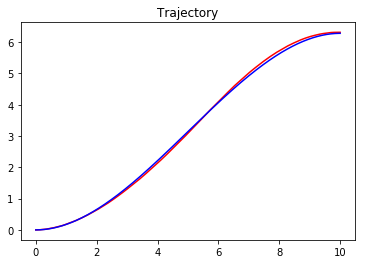

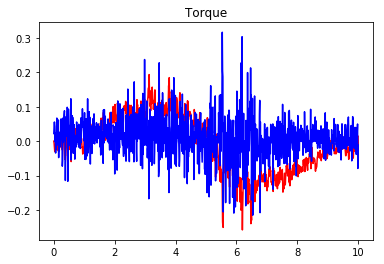

Value Loss : [ 34.53484726]
Policy Loss : [ 17.16568947]
EPISODE 405 STATE [-0.03702082  0.03506796] REWARD  [ 1.92557727] ACTION ([-0.02234779]) 05]) 28])                

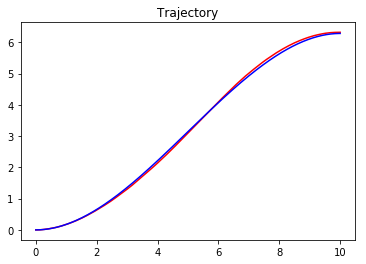

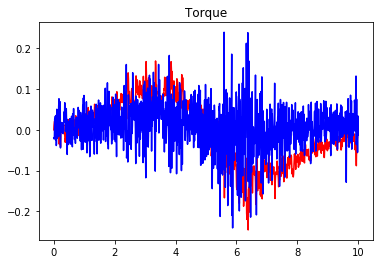

Value Loss : [ 23.73859024]
Policy Loss : [ 20.50222397]
EPISODE 406 STATE [-0.03636809  0.02887368] REWARD  [ 1.93218329] ACTION ([-0.01313831]) 1593872])                  

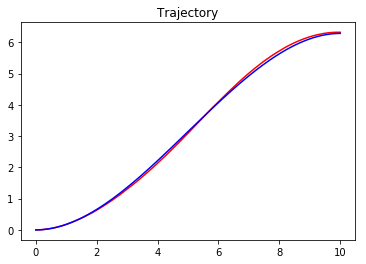

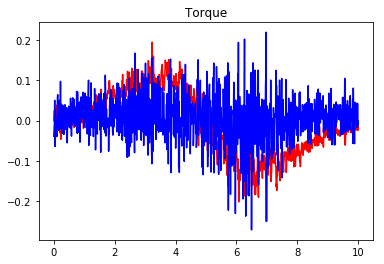

Value Loss : [ 44.13787079]
Policy Loss : [ 20.91677666]
EPISODE 407 STATE [-0.03926775 -0.01480503] REWARD  [ 1.95054064] ACTION ([-0.00106537]) 46347]) )             

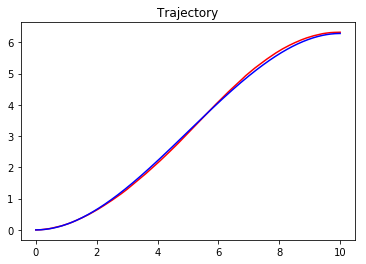

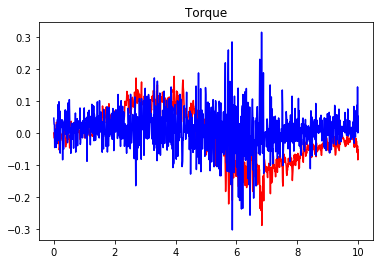

Value Loss : [ 73.63272858]
Policy Loss : [-33.25287247]
EPISODE 408 STATE [-0.03493623  0.04821307] REWARD  [ 1.91502665] ACTION ([ 0.0296734])  05]) 68])           

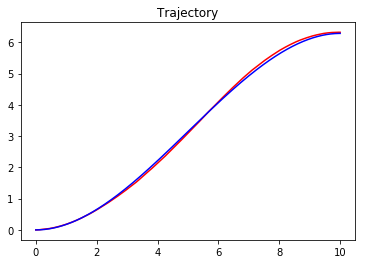

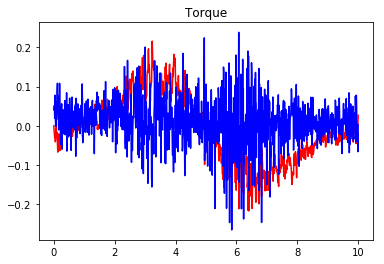

Value Loss : [ 30.17785645]
Policy Loss : [ 17.41307449]
EPISODE 409 STATE [-0.03473146  0.00716955] REWARD  [ 1.9549994] ACTION ([-0.00317752])  06]) 87])   

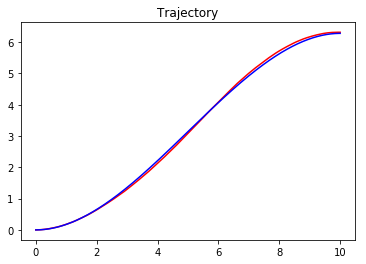

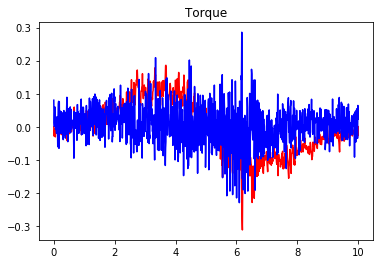

Value Loss : [ 30.11812973]
Policy Loss : [ 12.69588184]
EPISODE 410 STATE [-0.03424196  0.03428522] REWARD  [ 1.92901212] ACTION ([ 0.02346931]) 1686517])                  

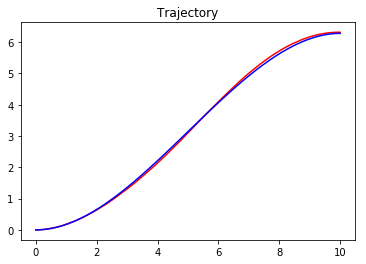

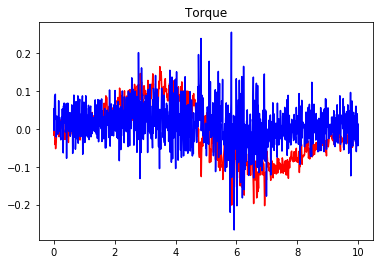

Value Loss : [ 25.87531471]
Policy Loss : [ 26.09280205]
EPISODE 411 STATE [-0.03931753 -0.01456674] REWARD  [ 1.95072848] ACTION ([ 0.03197092]) 4894558])           

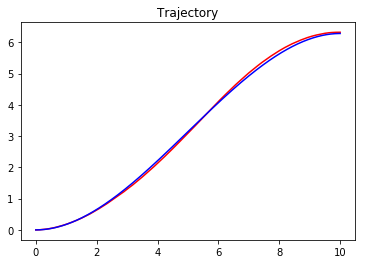

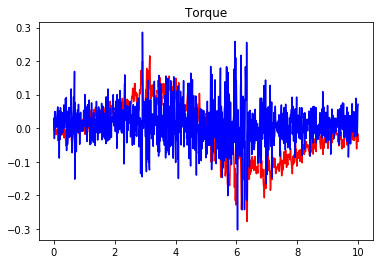

Value Loss : [ 32.14564133]
Policy Loss : [ 10.11626148]
EPISODE 412 STATE [-0.03571884 -0.00500203] REWARD  [ 1.96370216] ACTION ([ 0.08721461]) 4799436])               

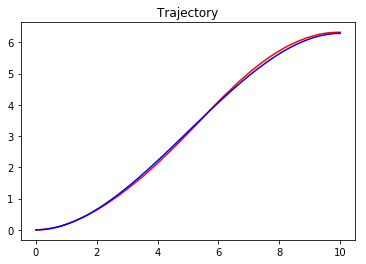

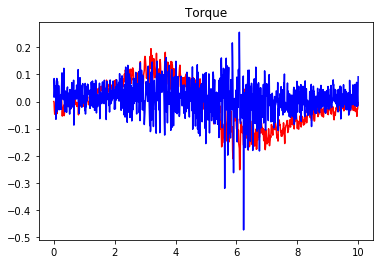

Value Loss : [ 26.33445549]
Policy Loss : [ 21.875]
EPISODE 413 STATE [-0.03554433  0.01819598] REWARD  [ 1.94336807] ACTION ([ 0.01733876])                  

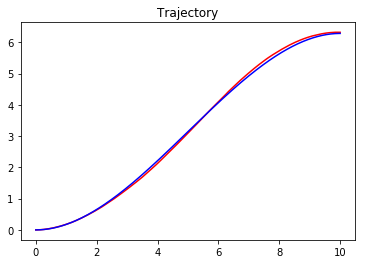

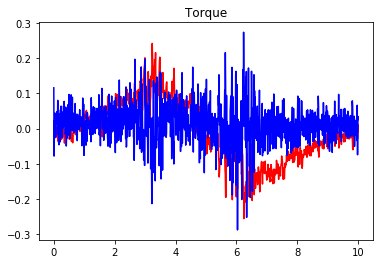

Value Loss : [ 30.87432861]
Policy Loss : [ 5.48546124]
EPISODE 414 STATE [-0.03835659  0.02149168] REWARD  [ 1.937439] ACTION ([ 0.03163103]) ) 041544])                    

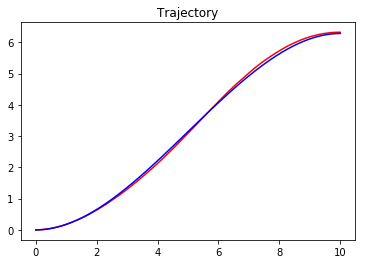

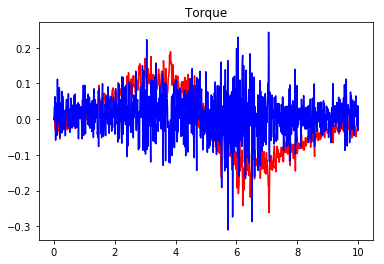

Value Loss : [ 58.28477478]
Policy Loss : [-10.65571308]
EPISODE 415 STATE [-0.03557279  0.04845424] REWARD  [ 1.91418321] ACTION ([-0.11077298]) 05]) 59])            

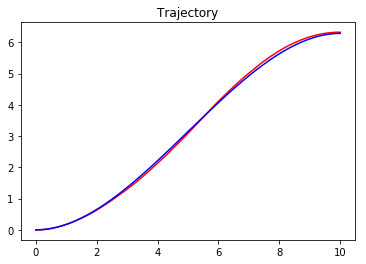

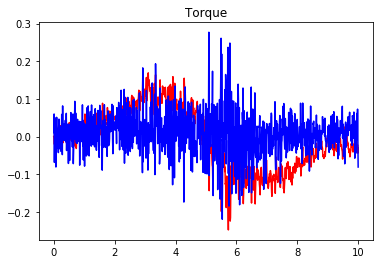

Value Loss : [ 31.66363525]
Policy Loss : [ 10.3617878]
EPISODE 416 STATE [-0.03552176  0.02886502] REWARD  [ 1.93300814] ACTION ([ 0.02937078]) 1860818])                   

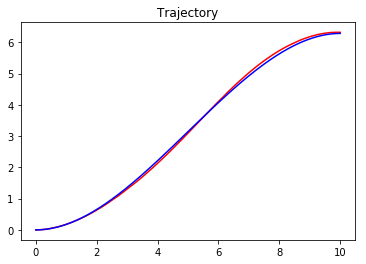

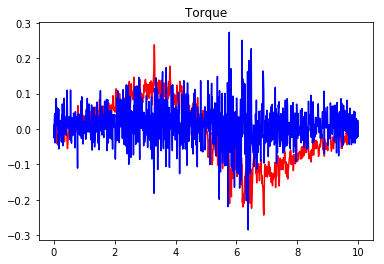

Value Loss : [ 39.74342346]
Policy Loss : [-2.7664094]
EPISODE 417 STATE [-0.03695043  0.02293774] REWARD  [ 1.93738426] ACTION ([ 0.03073427]) 363063])                

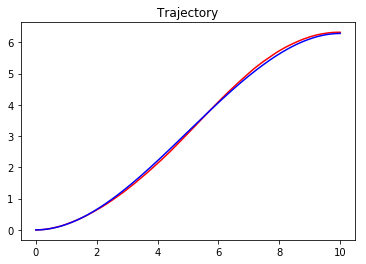

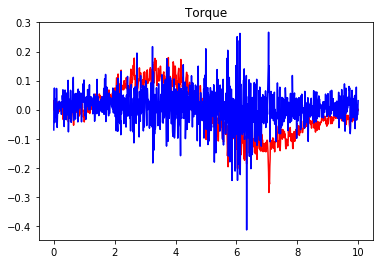

Value Loss : [ 67.30368805]
Policy Loss : [-5.84868336]
EPISODE 418 STATE [-0.0366266 -0.0018394] REWARD  [ 1.96212181] ACTION ([ 0.02048483])   4625411])              

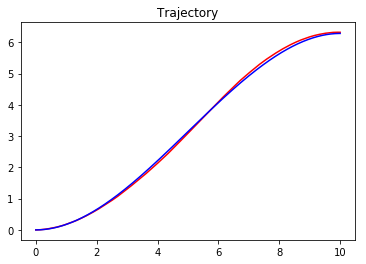

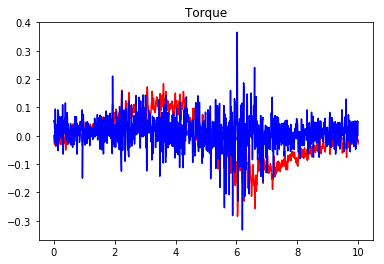

Value Loss : [ 37.93355179]
Policy Loss : [ 16.30128098]
EPISODE 419 STATE [-0.03612141  0.03305092] REWARD  [ 1.92838656] ACTION ([-0.01313478]) 3677033])               

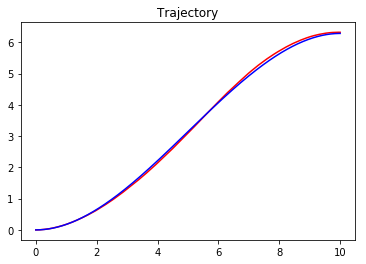

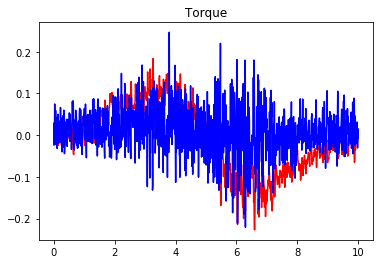

Value Loss : [ 26.93402481]
Policy Loss : [ 13.38460827]
EPISODE 420 STATE [-0.037897    0.01849993] REWARD  [ 1.94080288] ACTION ([-0.00926566]) 7977065])               

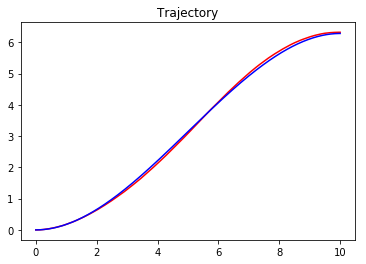

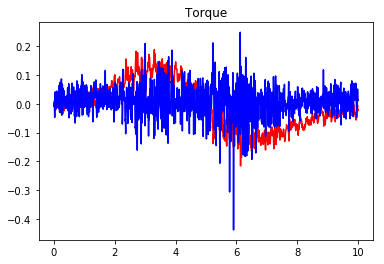

Value Loss : [ 32.34841919]
Policy Loss : [ 25.77427483]
EPISODE 421 STATE [-0.03365746  0.02417295] REWARD  [ 1.93936115] ACTION ([ 0.03055748]) 4472415])             

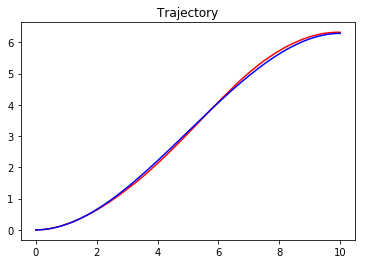

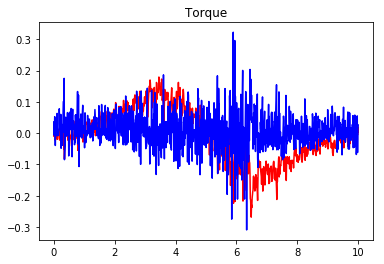

Value Loss : [ 40.88602066]
Policy Loss : [-1.94491482]
EPISODE 422 STATE [-0.03523666  0.03760571] REWARD  [ 1.92486018] ACTION ([-0.03514851]) 13332])              

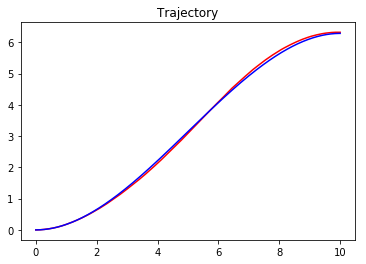

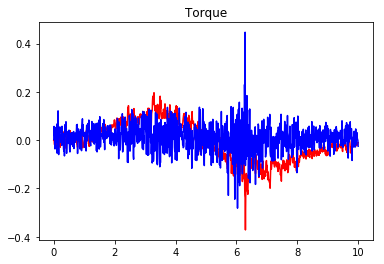

Value Loss : [ 37.88296127]
Policy Loss : [-3.30910921]
EPISODE 423 STATE [-0.03884102  0.02505757] REWARD  [ 1.93350217] ACTION ([ 0.01604941]) 6152933])               

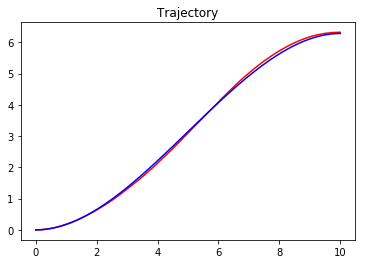

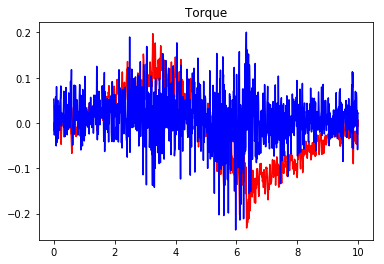

Value Loss : [ 28.24109459]
Policy Loss : [ 17.05137253]
EPISODE 424 STATE [-0.0361649   0.00546012] REWARD  [ 1.95530813] ACTION ([ 0.02386149]) 05]) 75])                     

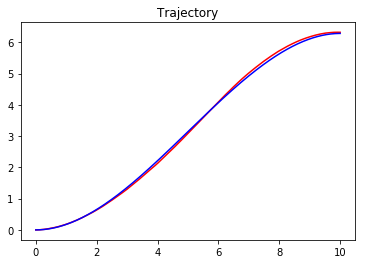

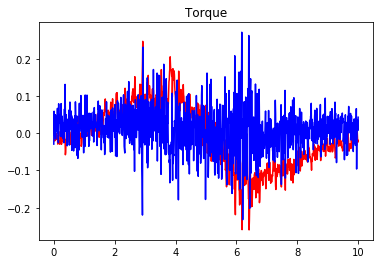

Value Loss : [ 25.30918121]
Policy Loss : [ 2.1588769]
EPISODE 425 STATE [-0.03580706 -0.00706543] REWARD  [ 1.96155829] ACTION ([-0.02284284]) 05]) 3])                  

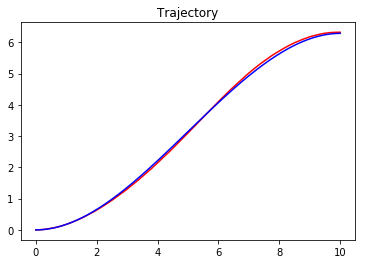

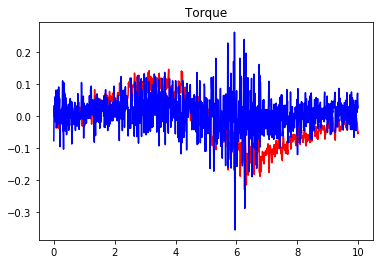

Value Loss : [ 29.7514782]
Policy Loss : [ 17.05218124]
EPISODE 426 STATE [-0.03845608  0.03888792] REWARD  [ 1.92052771] ACTION ([-0.0681071])  4454375])                     

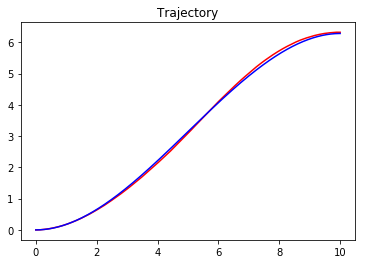

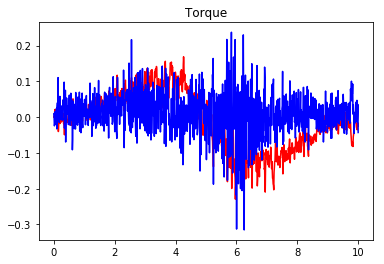

Value Loss : [ 36.94427872]
Policy Loss : [ 19.80324745]
EPISODE 427 STATE [-0.03555405  0.03282959] REWARD  [ 1.92914731] ACTION ([-0.0194689])  81612]) )              

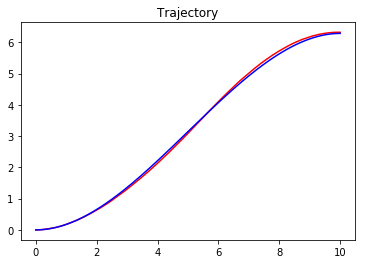

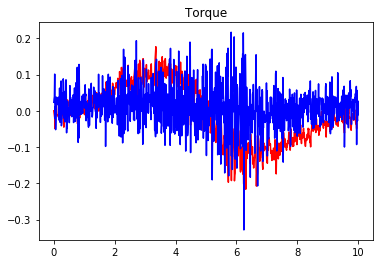

Value Loss : [ 26.87050056]
Policy Loss : [ 13.05751419]
EPISODE 428 STATE [-0.0390166  -0.02264689] REWARD  [ 1.94305666] ACTION ([-0.02151004]) 1992113])                   

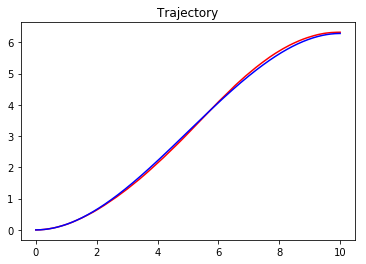

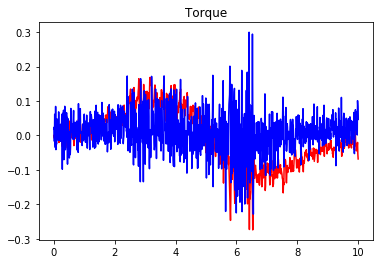

Value Loss : [ 30.85142899]
Policy Loss : [ 17.32346725]
EPISODE 429 STATE [-0.03419505  0.00616094] REWARD  [ 1.95651578] ACTION ([-0.03038445]) 05]) 81])         

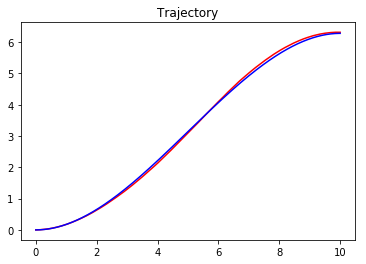

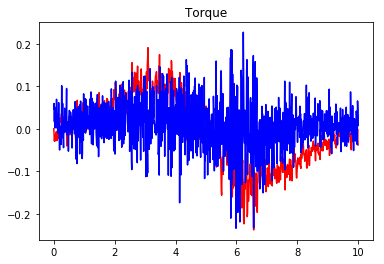

Value Loss : [ 26.74901009]
Policy Loss : [ 13.27630329]
EPISODE 430 STATE [-0.03524166  0.03089368] REWARD  [ 1.93131697] ACTION ([-0.10332369]) 05]) 96])                     

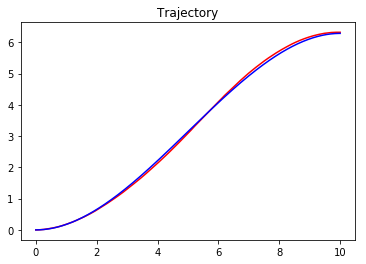

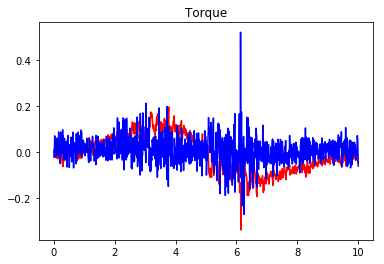

Value Loss : [ 29.56314278]
Policy Loss : [ 24.97719002]
EPISODE 431 STATE [-0.03267325  0.04286993] REWARD  [ 1.9223005] ACTION ([-0.03378551])  05]) 94])            

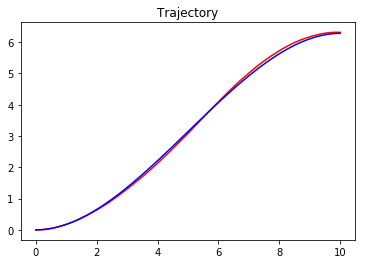

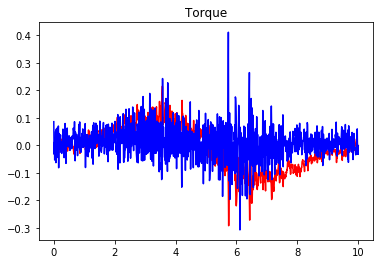

Value Loss : [ 37.70009995]
Policy Loss : [ 10.18483639]
EPISODE 432 STATE [-0.03597335  0.05484625] REWARD  [ 1.90774932] ACTION ([-0.0218727])  779409])                    

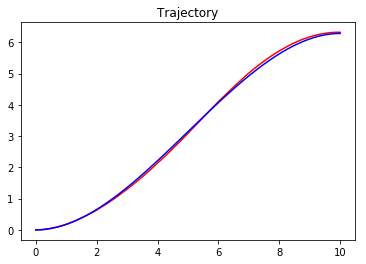

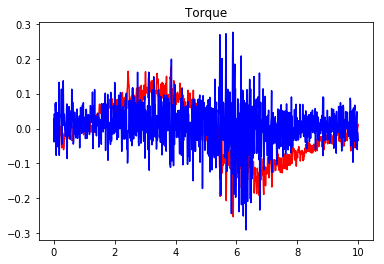

Value Loss : [ 31.19122124]
Policy Loss : [ 10.33097553]
EPISODE 433 STATE [-0.03672932  0.0291278 ] REWARD  [ 1.93158909] ACTION ([-0.03536127]) 5982699])                  

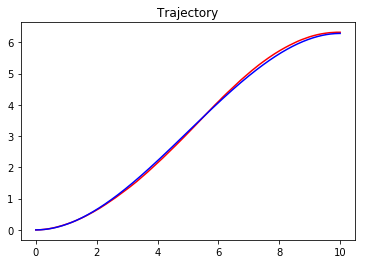

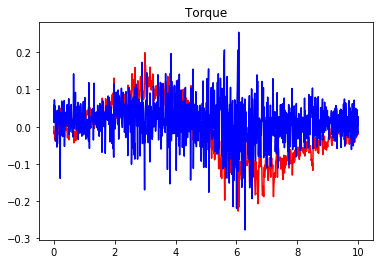

Value Loss : [ 25.3248806]
Policy Loss : [ 11.55435562]
EPISODE 434 STATE [-0.03260867  0.02063438] REWARD  [ 1.94382293] ACTION ([-0.03480672]) 05]) 9])                 

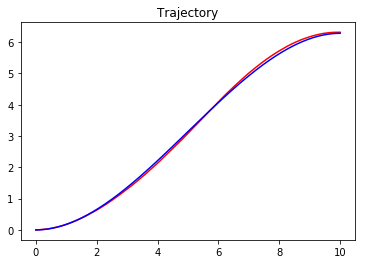

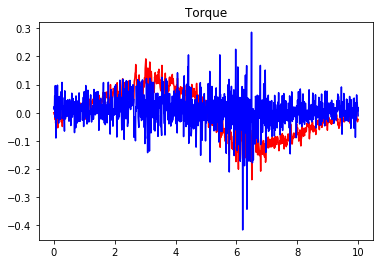

Value Loss : [ 22.7274437]
Policy Loss : [ 16.06417465]
EPISODE 435 STATE [-0.03449841 -0.00356818] REWARD  [ 1.96590261] ACTION ([ 0.03727768]) 05]) 44])                  

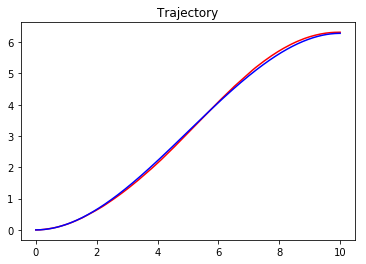

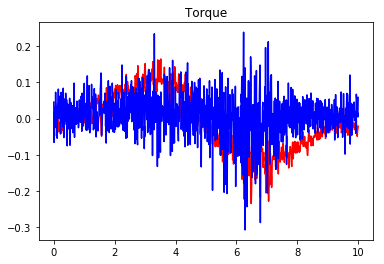

Value Loss : [ 26.95446587]
Policy Loss : [ 15.67537403]
EPISODE 436 STATE [-0.03827816  0.01430634] REWARD  [ 1.94454579] ACTION ([-0.015151])   05]) 91])                

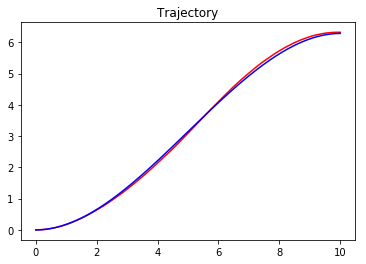

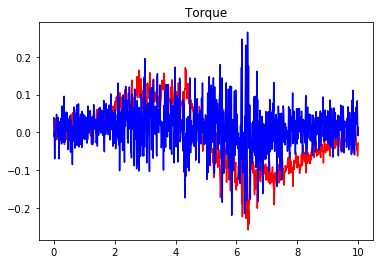

Value Loss : [ 21.53986359]
Policy Loss : [ 10.81588173]
EPISODE 437 STATE [-0.03621024 -0.00523438] REWARD  [ 1.96299607] ACTION ([ 0.08431733]) 05]) 59])                  

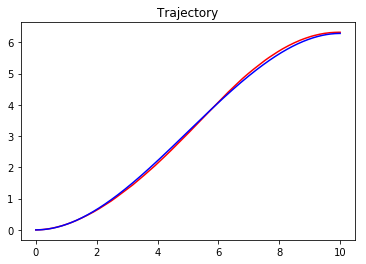

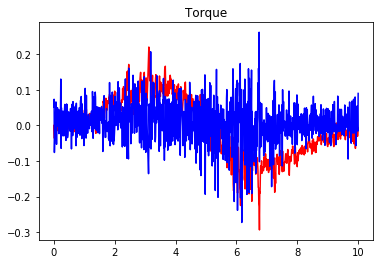

Value Loss : [ 44.85518646]
Policy Loss : [ 0.7936781]
EPISODE 438 STATE [-0.03439704 -0.00156797] REWARD  [ 1.96400275] ACTION ([ 0.03485077]) 6825538])               

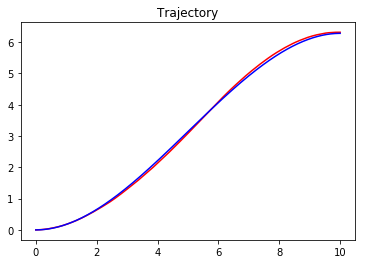

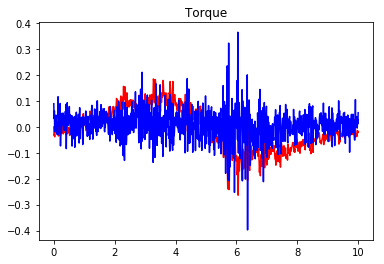

Value Loss : [ 30.34900093]
Policy Loss : [ 8.36643124]
EPISODE 439 STATE [-0.03425103  0.05061236] REWARD  [ 1.91341355] ACTION ([-0.0910632])  6601356])                  

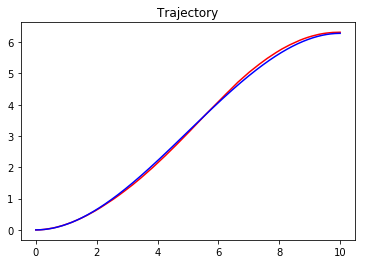

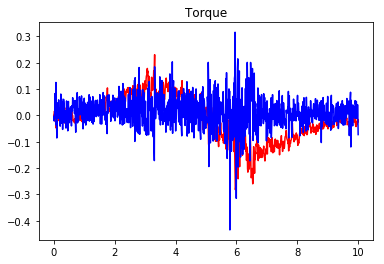

Value Loss : [ 46.78785324]
Policy Loss : [ 14.31672382]
EPISODE 440 STATE [-0.03257603  0.00473181] REWARD  [ 1.95949769] ACTION ([ 0.00952403]) 6318165])                 

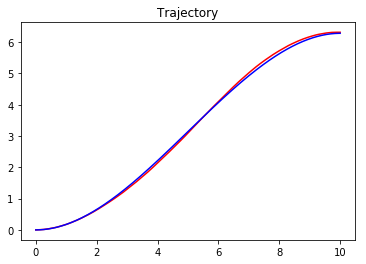

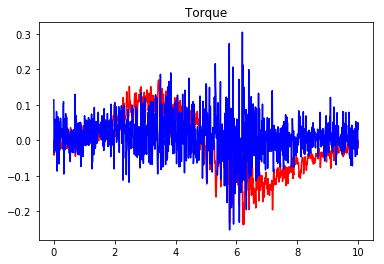

Value Loss : [ 33.54288483]
Policy Loss : [ 11.91797352]
EPISODE 441 STATE [-0.03431357  0.0199103 ] REWARD  [ 1.94288097] ACTION ([ 0.00687666]) 05]) 45])                 

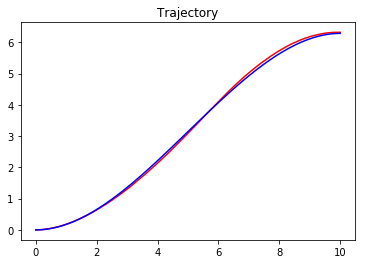

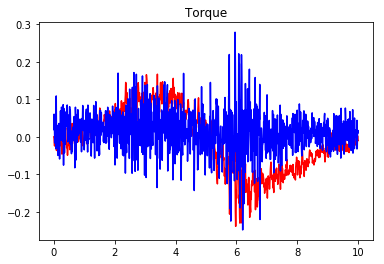

Value Loss : [ 29.69332123]
Policy Loss : [ 6.93873215]
EPISODE 442 STATE [-0.03875756  0.02613021] REWARD  [ 1.93254085] ACTION ([ 0.00100742]) 06]) 51])                        

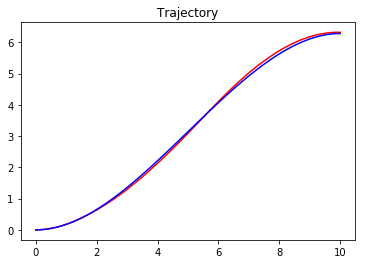

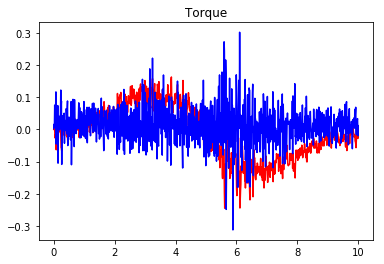

Value Loss : [ 35.8979454]
Policy Loss : [ 1.46134079]
EPISODE 443 STATE [-0.03282258  0.03067507] REWARD  [ 1.93386635] ACTION ([-0.03441708]) 1692302])                       

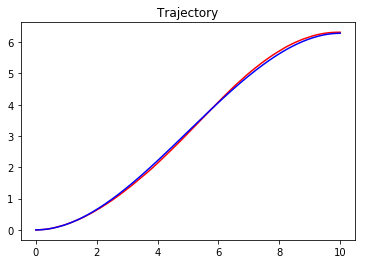

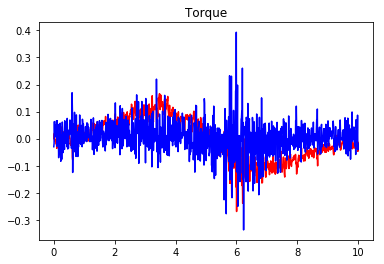

Value Loss : [ 29.47822571]
Policy Loss : [ 6.74774551]
EPISODE 444 STATE [-0.0336714   0.02370938] REWARD  [ 1.93979857] ACTION ([-0.06964441]) 9103491])                  

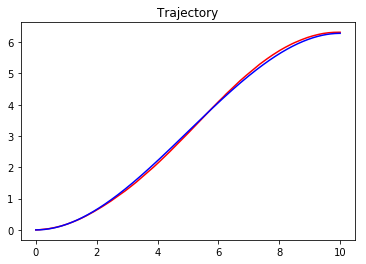

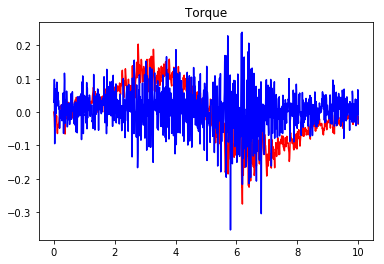

Value Loss : [ 28.00878525]
Policy Loss : [ 15.12560844]
EPISODE 445 STATE [-0.03671201 -0.0074205 ] REWARD  [ 1.96033171] ACTION ([ 0.07130958]) 7212968])             

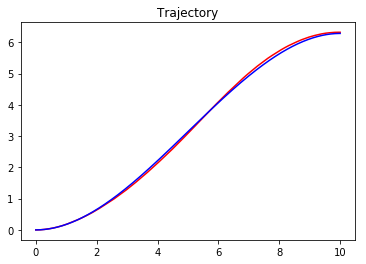

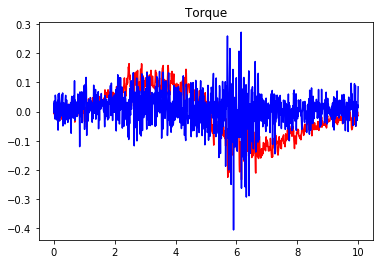

Value Loss : [ 31.75733948]
Policy Loss : [ 27.29730606]
EPISODE 446 STATE [-0.03573592 -0.00203258] REWARD  [ 1.96317369] ACTION ([-0.03990497]) 7004051])              

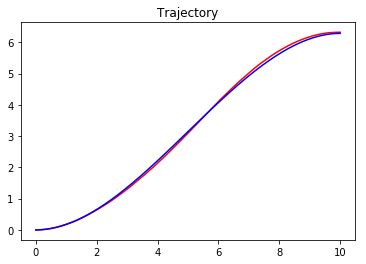

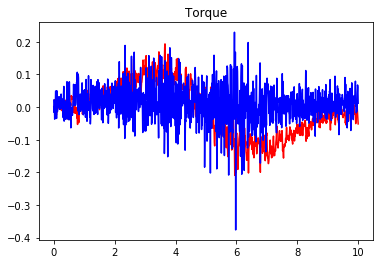

Value Loss : [ 22.84592247]
Policy Loss : [ 3.40668225]
EPISODE 447 STATE [-0.03921272  0.02630055] REWARD  [ 1.93193779] ACTION ([ 0.0153913])  8064832])                

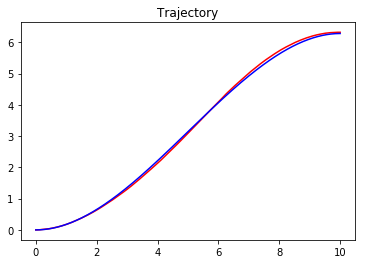

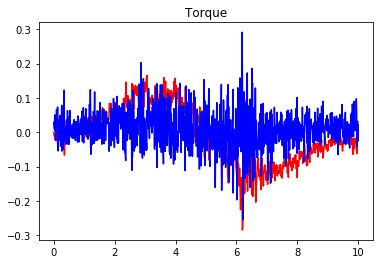

Value Loss : [ 20.26836395]
Policy Loss : [ 2.21512985]
EPISODE 448 STATE [-0.03387087  0.04325985] REWARD  [ 1.92076997] ACTION ([-0.0537005])  7619346])                        

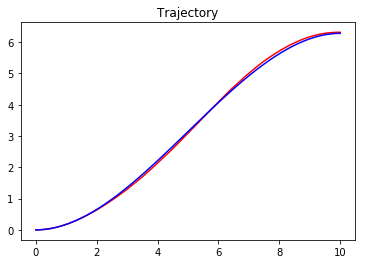

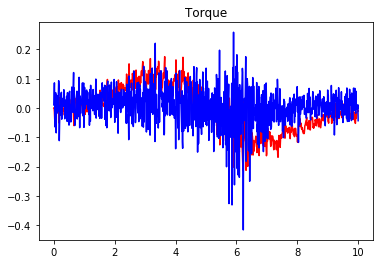

Value Loss : [ 31.90094566]
Policy Loss : [ 21.25444221]
EPISODE 449 STATE [-0.03902161  0.02336599] REWARD  [ 1.93497336] ACTION ([-0.02779351]) 05]) 37])                 

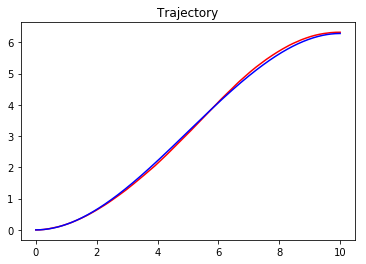

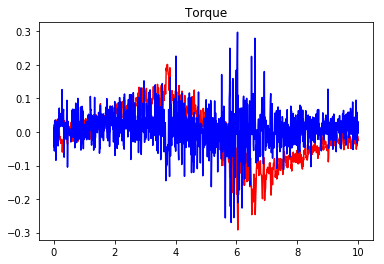

Value Loss : [ 33.0096283]
Policy Loss : [-3.94548798]
EPISODE 450 STATE [-0.03515048  0.0263964 ] REWARD  [ 1.93575883] ACTION ([ 0.00633193]) 3275998])              

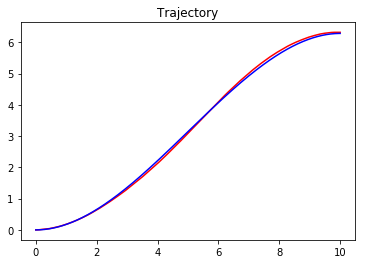

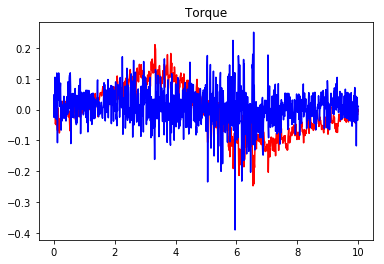

Value Loss : [ 33.31002808]
Policy Loss : [ 12.59828663]
EPISODE 451 STATE [-0.03368911  0.01830902] REWARD  [ 1.94504962] ACTION ([ 0.03785495]) 5256577])             

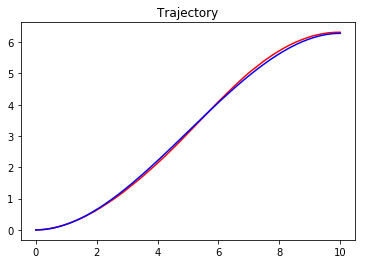

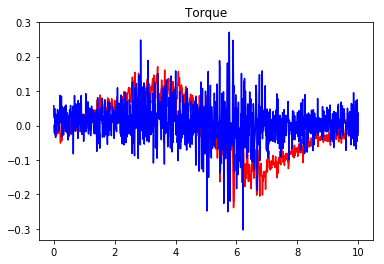

Value Loss : [ 29.84269142]
Policy Loss : [ 7.54442692]
EPISODE 452 STATE [-0.0371374   0.02641691] REWARD  [ 1.9338225] ACTION ([-0.08345455])  2521]) ])                

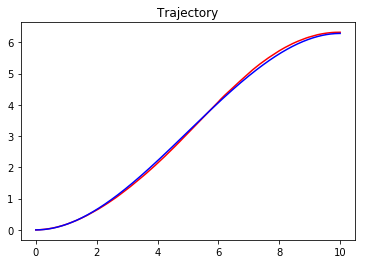

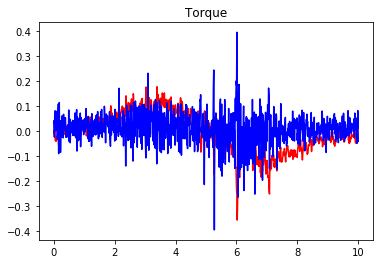

Value Loss : [ 49.58525085]
Policy Loss : [-1.56286752]
EPISODE 453 STATE [-0.03396834  0.03080814] REWARD  [ 1.93262964] ACTION ([-0.01243026]) 84533]) )                     

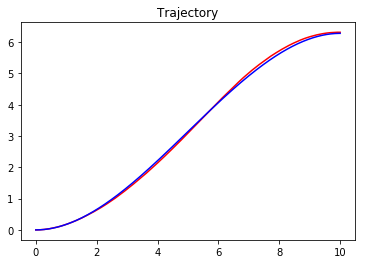

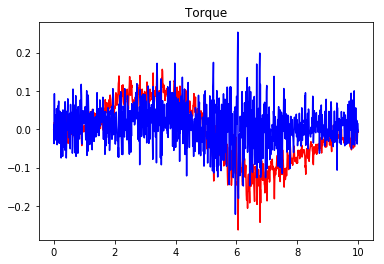

Value Loss : [ 33.51746368]
Policy Loss : [ 2.33115268]
EPISODE 454 STATE [-0.03774277  0.0040986 ] REWARD  [ 1.9551374] ACTION ([-0.03953507])  91121])                

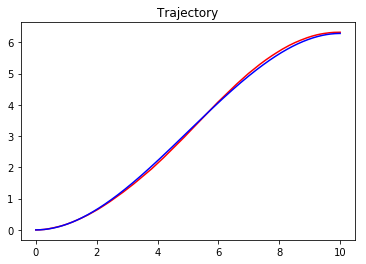

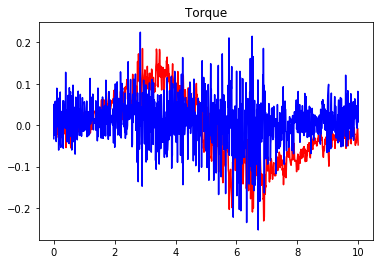

Value Loss : [ 33.84737396]
Policy Loss : [ 17.95855141]
EPISODE 455 STATE [-0.03580827  0.05092694] REWARD  [ 1.91161201] ACTION ([-0.01342008]) 05]) 55])           

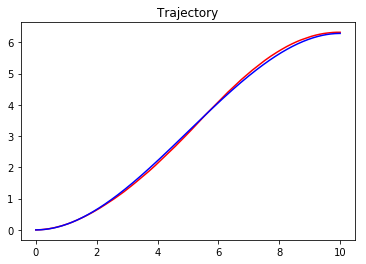

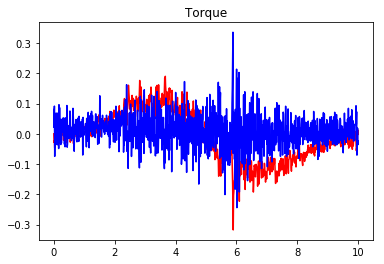

Value Loss : [ 28.65868759]
Policy Loss : [ 1.93986499]
EPISODE 456 STATE [-0.03703595  0.00187733] REWARD  [ 1.95802459] ACTION ([ 0.00289334]) 9041492])                 

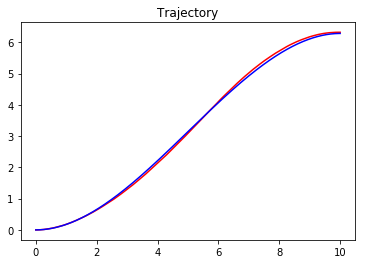

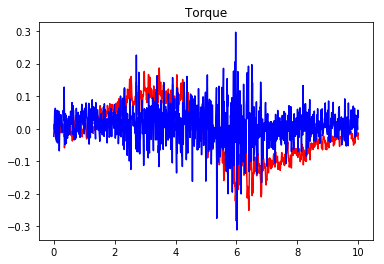

Value Loss : [ 31.29671288]
Policy Loss : [ 5.27719975]
EPISODE 457 STATE [-0.03423952  0.03460596] REWARD  [ 1.92870578] ACTION ([-0.00151497]) 05]) 91])                   

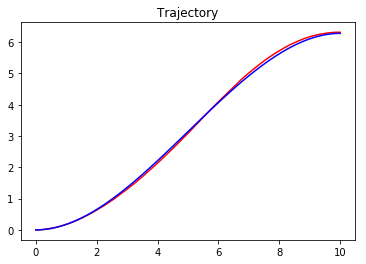

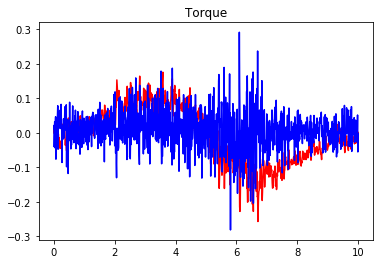

Value Loss : [ 34.30770111]
Policy Loss : [ 14.87148762]
EPISODE 458 STATE [-0.03820952  0.01777799] REWARD  [ 1.94120832] ACTION ([-0.05025062]) 05]) 22])           

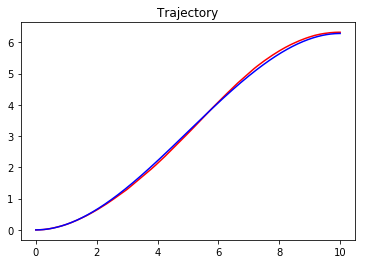

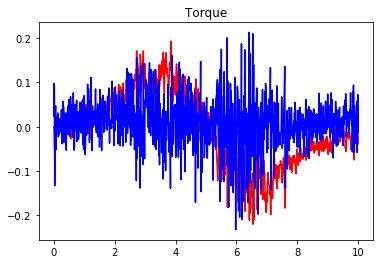

Value Loss : [ 32.85111237]
Policy Loss : [ 18.38760185]
EPISODE 459 STATE [-0.03493572  0.01461359] REWARD  [ 1.94746645] ACTION ([-0.03050598]) 5794686])               

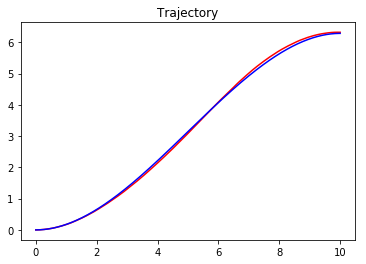

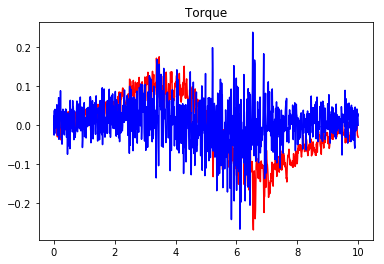

Value Loss : [ 27.71041679]
Policy Loss : [ 22.32854843]
EPISODE 460 STATE [-0.03468896 -0.00048692] REWARD  [ 1.96264266] ACTION ([ 0.00777223]) 0632574])                 

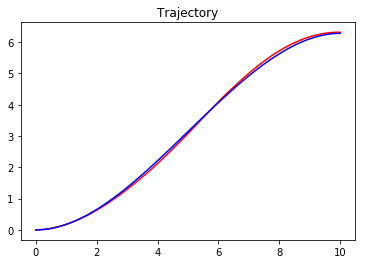

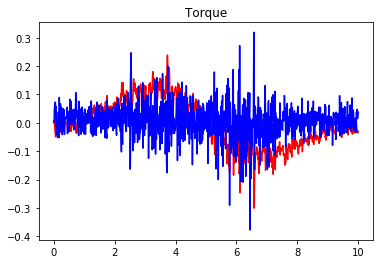

Value Loss : [ 37.50085831]
Policy Loss : [ 11.92111015]
EPISODE 461 STATE [-0.03647684 -0.00217248] REWARD  [ 1.96259869] ACTION ([-0.00583102]) 2135199])               

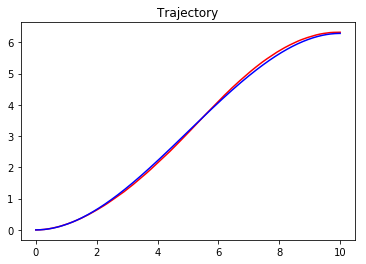

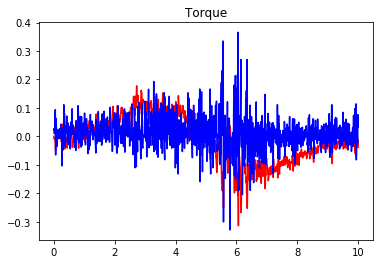

Value Loss : [ 34.60025024]
Policy Loss : [ 5.3959856]
EPISODE 462 STATE [-0.035803    0.01623737] REWARD  [ 1.94503639] ACTION ([-0.07293891]) 2023843])               

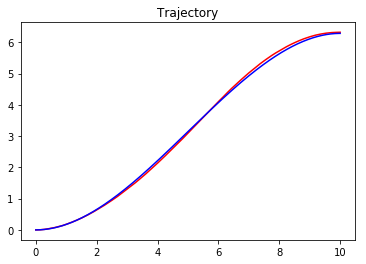

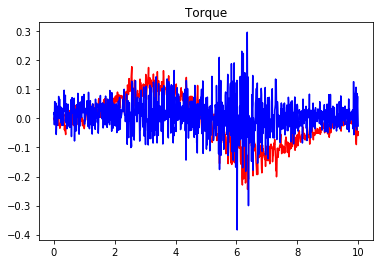

Value Loss : [ 29.29307365]
Policy Loss : [ 2.19196653]
EPISODE 463 STATE [-0.03652793  0.00444446] REWARD  [ 1.95596489] ACTION ([ 0.01808928]) 7299479])         

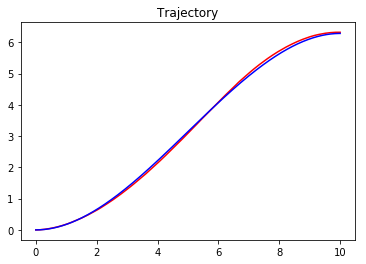

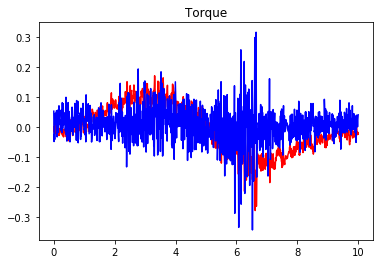

Value Loss : [ 27.53153419]
Policy Loss : [ 10.15681553]
EPISODE 464 STATE [-0.03492782  0.02793936] REWARD  [ 1.93447787] ACTION ([ 0.04579993]) 0642565]) 05])                  

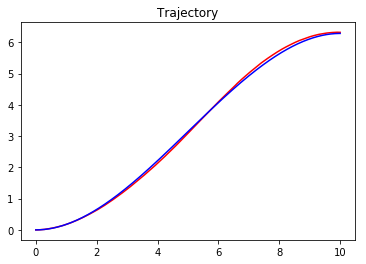

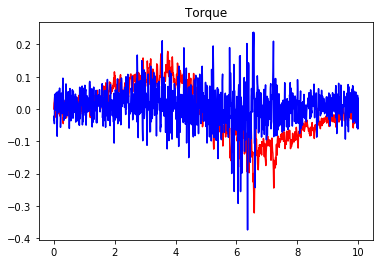

Value Loss : [ 47.77597427]
Policy Loss : [ 14.16764259]
EPISODE 465 STATE [-0.03634287  0.03733261] REWARD  [ 1.92405491] ACTION ([-0.00905864]) ]) 3986])                 

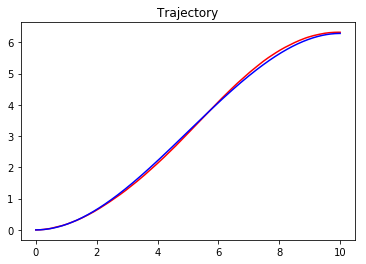

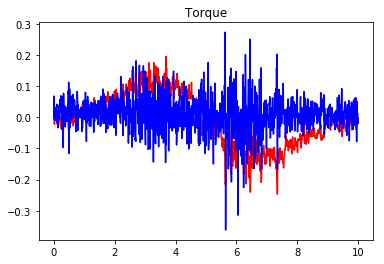

Value Loss : [ 46.9745369]
Policy Loss : [ 5.65646315]
EPISODE 466 STATE [-0.03651222  0.01281831] REWARD  [ 1.94770939] ACTION ([ 0.0572352])  6631424])          

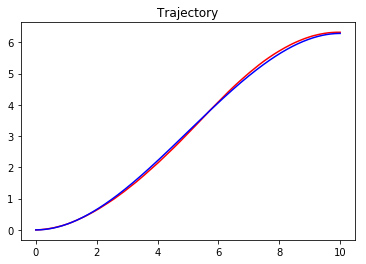

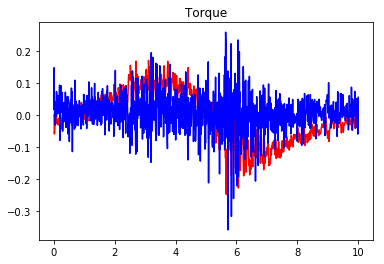

Value Loss : [ 32.56707382]
Policy Loss : [ 11.05832767]
EPISODE 467 STATE [-0.03480916  0.02098001] REWARD  [ 1.94135809] ACTION ([ 0.0156832])  05]) 77])           

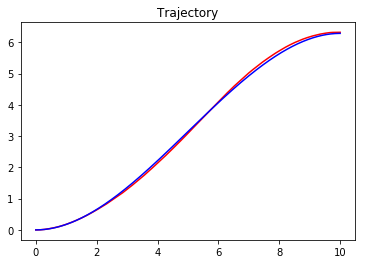

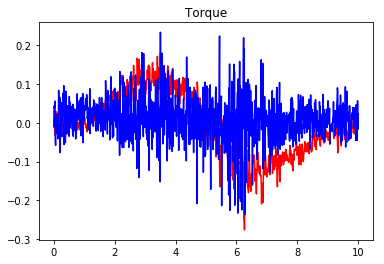

Value Loss : [ 27.49054527]
Policy Loss : [ 8.44925213]
EPISODE 468 STATE [-0.03342326  0.00182242] REWARD  [ 1.96156689] ACTION ([ 0.07227703]) 1905437])        

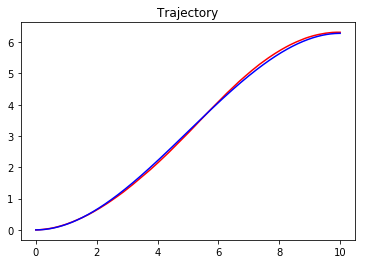

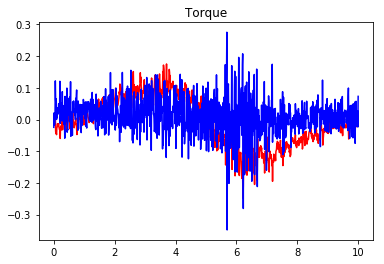

Value Loss : [ 30.47462845]
Policy Loss : [ 9.75784683]
EPISODE 469 STATE [-0.03326407  0.01493153] REWARD  [ 1.94876999] ACTION ([-0.00012721]) 0486672])           

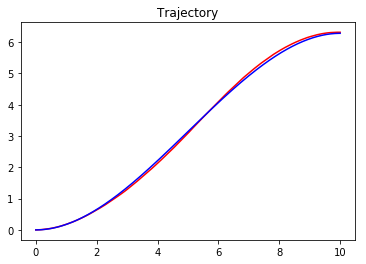

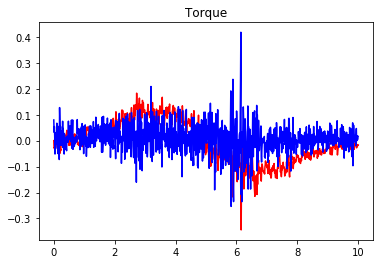

Value Loss : [ 27.07587051]
Policy Loss : [ 14.38096809]
EPISODE 470 STATE [-0.0364543   0.02078976] REWARD  [ 1.93995613] ACTION ([ 0.01938604]) 4854491])               

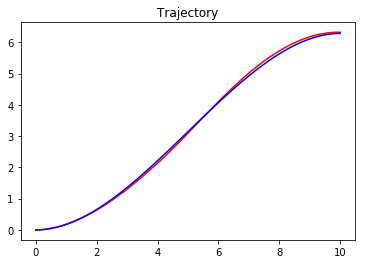

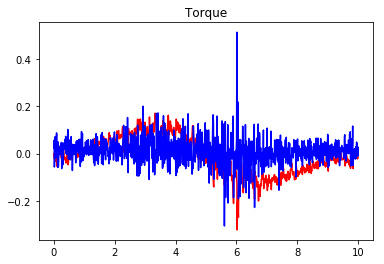

Value Loss : [ 25.73321915]
Policy Loss : [ 9.14114666]
EPISODE 471 STATE [-0.03514282  0.00072931] REWARD  [ 1.96099286] ACTION ([ 0.06880169]) 3141621])            

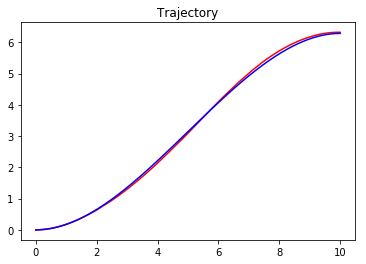

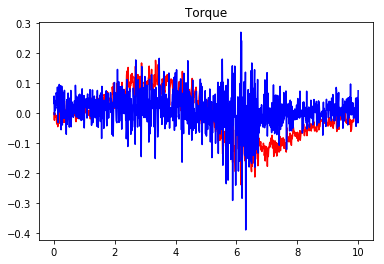

Value Loss : [ 28.90076828]
Policy Loss : [ 20.05478096]
EPISODE 472 STATE [-0.0345263 -0.0089352] REWARD  [ 1.96093293] ACTION ([-0.00229327]) ) 445788])            

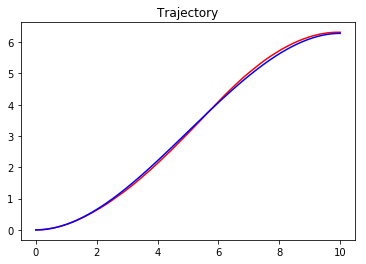

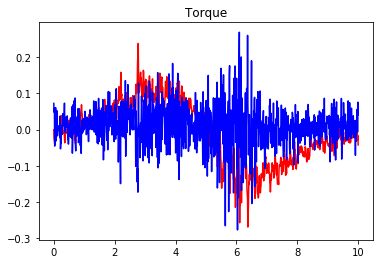

Value Loss : [ 24.5755043]
Policy Loss : [ 7.24661827]
EPISODE 473 STATE [-0.03556216  0.02363371] REWARD  [ 1.93804573] ACTION ([ 0.00922046]) 274147])               

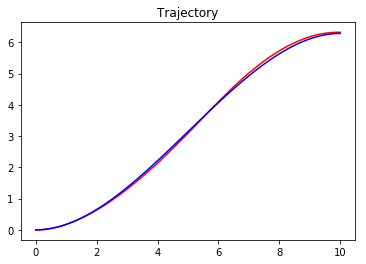

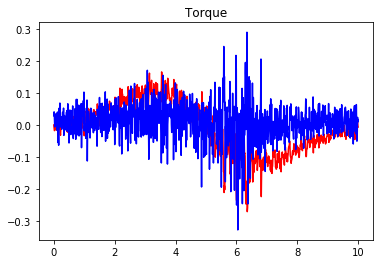

Value Loss : [ 30.40784645]
Policy Loss : [ 13.51856899]
EPISODE 474 STATE [-0.0326154  -0.00303605] REWARD  [ 1.96719164] ACTION ([ 0.05531011]) 80486]) )       

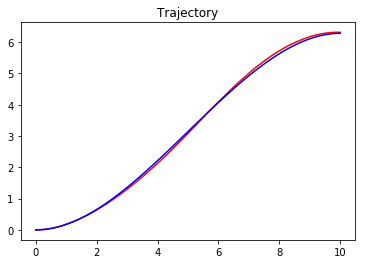

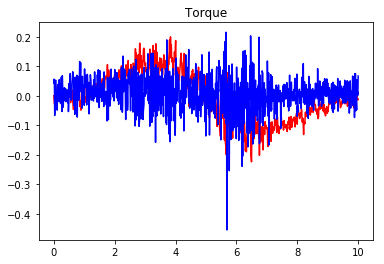

Value Loss : [ 30.90832329]
Policy Loss : [ 9.86365795]
EPISODE 475 STATE [-0.03314861  0.03188314] REWARD  [ 1.93238443] ACTION ([-0.02267849]) 206074])        

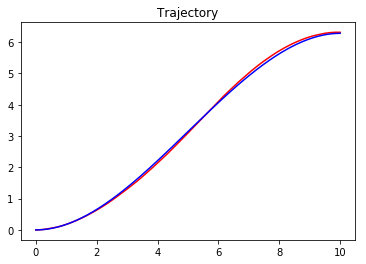

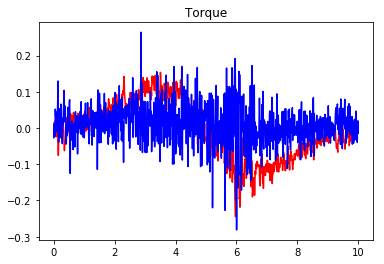

Value Loss : [ 20.62939835]
Policy Loss : [ 9.22565174]
EPISODE 476 STATE [-0.03496309  0.03307597] REWARD  [ 1.9294803] ACTION ([-0.04967979])  06]) 7])           

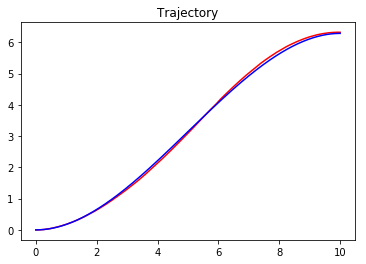

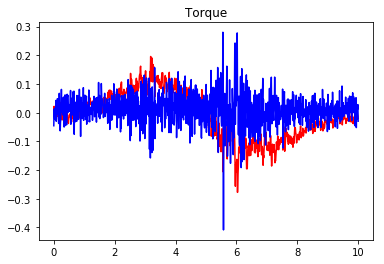

Value Loss : [ 22.47079086]
Policy Loss : [ 8.08647919]
EPISODE 477 STATE [-0.0334444   0.00791584] REWARD  [ 1.95550547] ACTION ([ 0.01415883]) 1711617])            

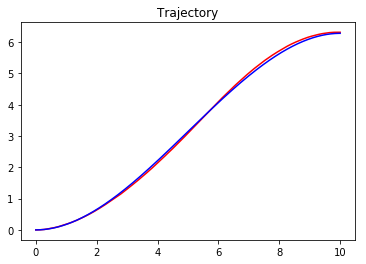

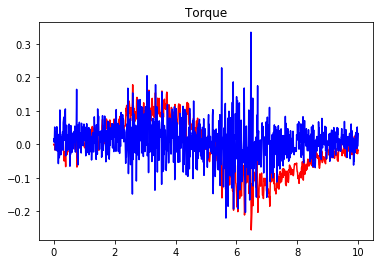

Value Loss : [ 21.49826813]
Policy Loss : [ 12.42913532]
EPISODE 478 STATE [-0.03729995  0.04590258] REWARD  [ 1.91494273] ACTION ([-0.09903388]) 443069])              

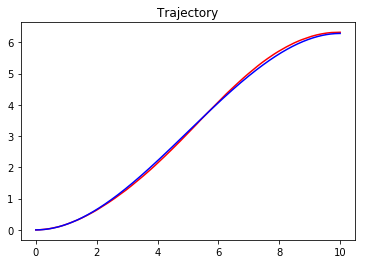

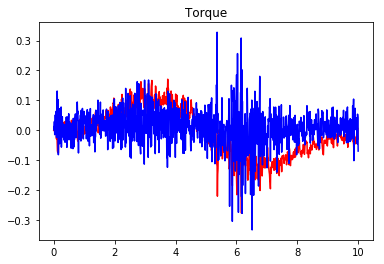

Value Loss : [ 32.48154831]
Policy Loss : [ 24.98406029]
EPISODE 479 STATE [-0.03240178  0.01431081] REWARD  [ 1.95021385] ACTION ([ 0.01964562]) 277385])        

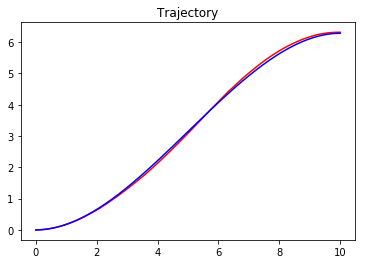

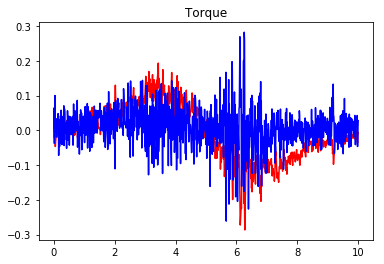

Value Loss : [ 24.65433693]
Policy Loss : [ 17.25266457]
EPISODE 480 STATE [-0.0352141   0.00382834] REWARD  [ 1.95784371] ACTION ([ 0.04841376]) 2167431])     

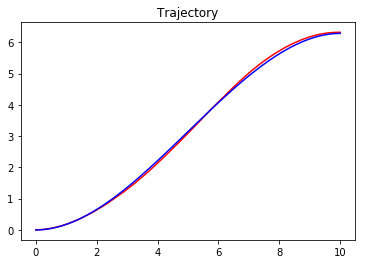

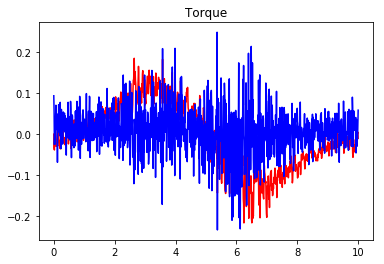

Value Loss : [ 29.30961227]
Policy Loss : [ 21.84961891]
EPISODE 481 STATE [-0.03340958  0.0318706 ] REWARD  [ 1.9321441] ACTION ([-0.02060049])  05]) 53])          

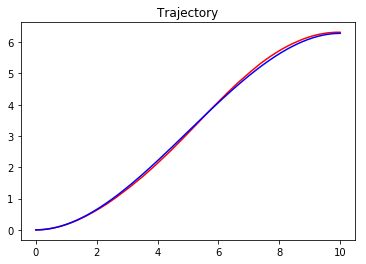

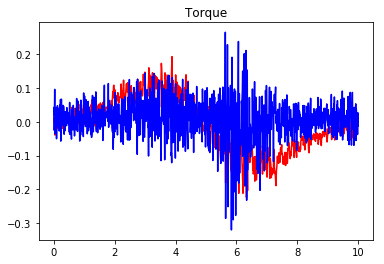

Value Loss : [ 30.83452225]
Policy Loss : [ 13.34307671]
EPISODE 482 STATE [-0.03347406  0.00431288] REWARD  [ 1.95904428] ACTION ([ 0.00651476]) 05]) 89])                      

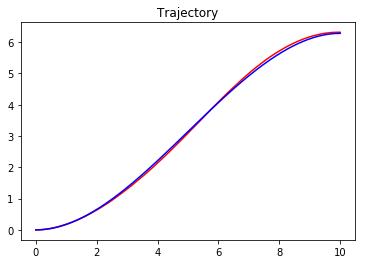

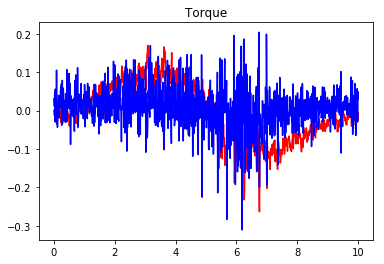

Value Loss : [ 25.76351166]
Policy Loss : [ 8.58857822]
EPISODE 483 STATE [-0.0388494   0.02435815] REWARD  [ 1.93417389] ACTION ([-0.08065238]) 05]) 48])                

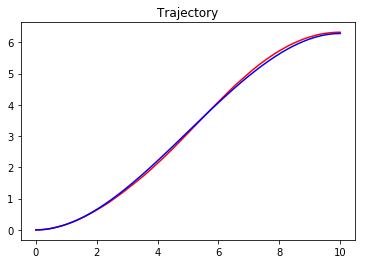

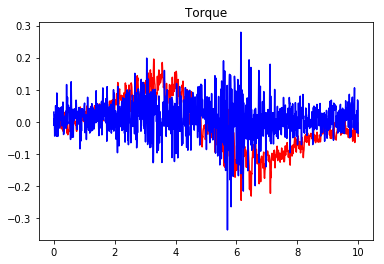

Value Loss : [ 27.70613861]
Policy Loss : [ 2.41876054]
EPISODE 484 STATE [-0.03667175  0.01024584] REWARD  [ 1.950089] ACTION ([ 0.01912829])   3951032])              

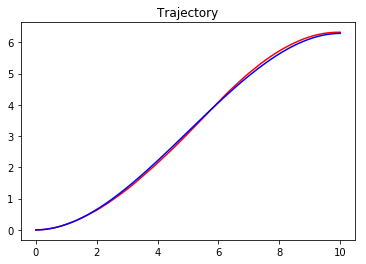

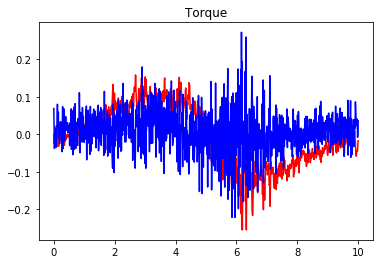

Value Loss : [ 20.83026314]
Policy Loss : [ 4.04042101]
EPISODE 485 STATE [-0.03886595  0.00964211] REWARD  [ 1.94857158] ACTION ([ 0.03344941]) 8145638])            

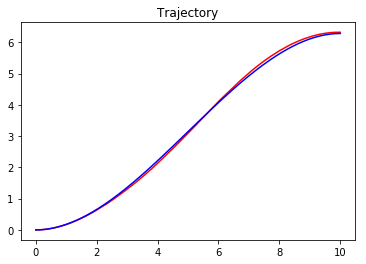

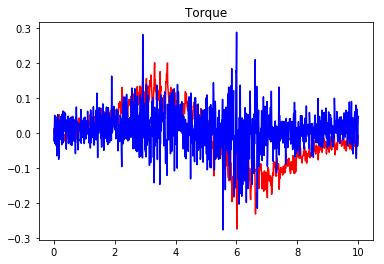

Value Loss : [ 29.45867157]
Policy Loss : [ 8.91151619]
EPISODE 486 STATE [-0.03577321  0.01821418] REWARD  [ 1.9431294] ACTION ([ 0.02035231])  7122145])          

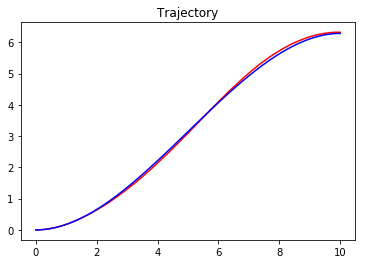

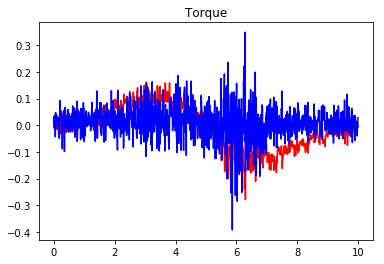

Value Loss : [ 32.62710953]
Policy Loss : [ 21.9556942]
EPISODE 487 STATE [-0.03818219  0.01071493] REWARD  [ 1.94817156] ACTION ([-0.07173185]) 8948078])             

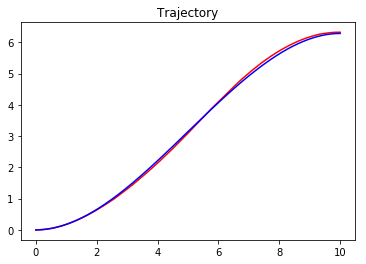

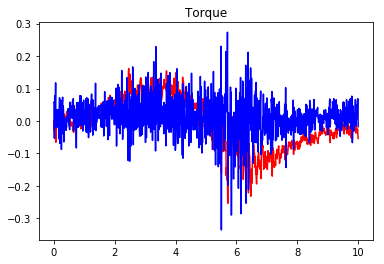

Value Loss : [ 25.42419052]
Policy Loss : [ 20.4003582]
EPISODE 488 STATE [-0.03476924 -0.01026285] REWARD  [ 1.95937832] ACTION ([ 0.10221422]) 656828])                

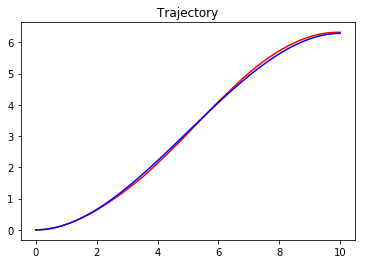

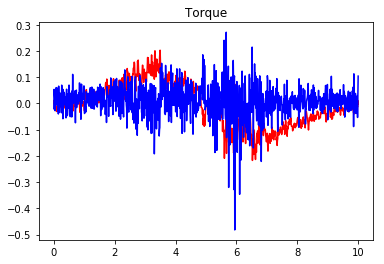

Value Loss : [ 32.94413757]
Policy Loss : [ 16.22577095]
EPISODE 489 STATE [-0.03648213  0.00286209] REWARD  [ 1.95757971] ACTION ([-0.04149967]) 6985593])                

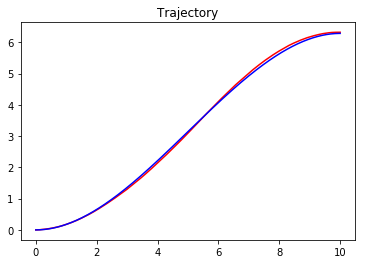

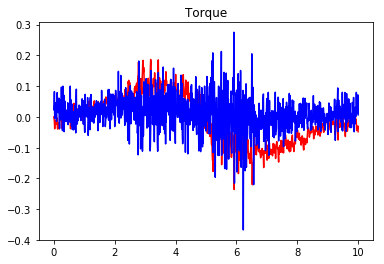

Value Loss : [ 19.18278694]
Policy Loss : [ 15.83897686]
EPISODE 490 STATE [-0.03668882 -0.00713738] REWARD  [ 1.9606362] ACTION ([ 0.07338028])  4702349])                   

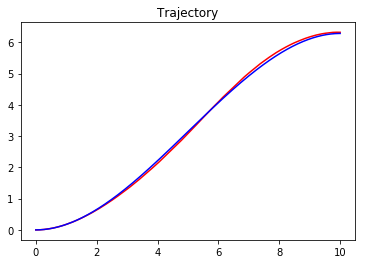

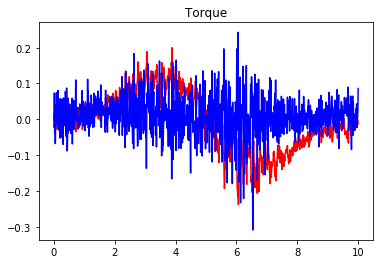

Value Loss : [ 22.93839645]
Policy Loss : [ 12.09211922]
EPISODE 491 STATE [-0.03538335 -0.00908377] REWARD  [ 1.95995752] ACTION ([ 0.04073959]) 2128909])                          

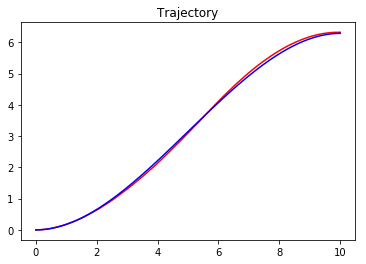

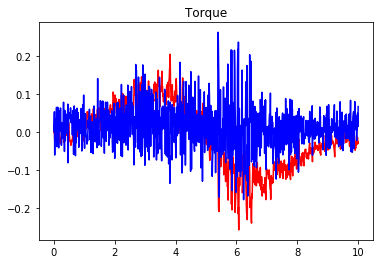

Value Loss : [ 26.68795395]
Policy Loss : [ 6.25018597]
EPISODE 492 STATE [-0.03177725  0.00783508] REWARD  [ 1.95719898] ACTION ([ 0.02934221]) 2704961])             

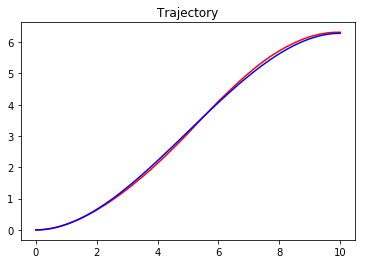

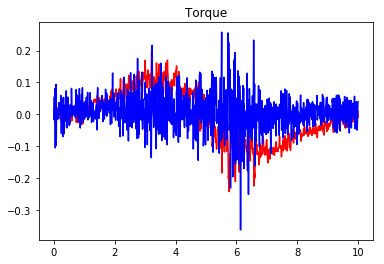

Value Loss : [ 28.6720295]
Policy Loss : [ 19.3649826]
EPISODE 493 STATE [-0.03287784  0.01899532] REWARD  [ 1.94516327] ACTION ([-0.03990407]) 05]) 2])                     

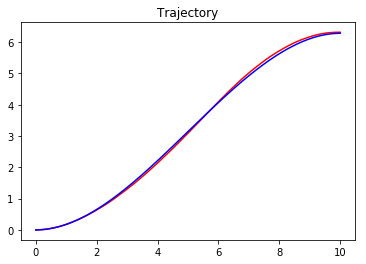

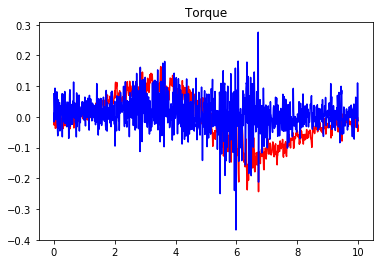

Value Loss : [ 31.98332596]
Policy Loss : [ 5.13317108]
EPISODE 494 STATE [-0.03289374 -0.00540612] REWARD  [ 1.96602853] ACTION ([-0.00910409]) 0240649])              

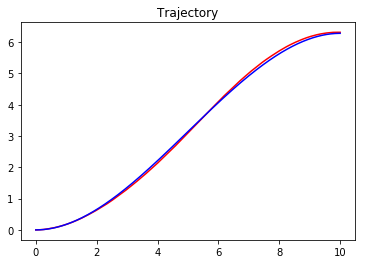

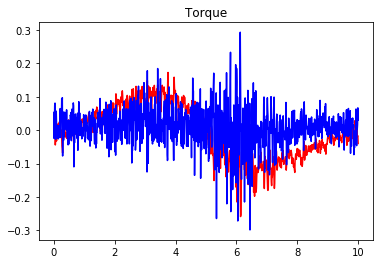

Value Loss : [ 25.09804916]
Policy Loss : [ 18.56691742]
EPISODE 495 STATE [-0.03419104 -0.00431766] REWARD  [ 1.96586126] ACTION ([-0.00709503]) 5539546])  

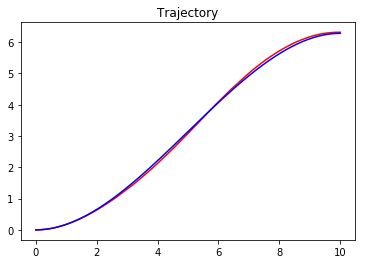

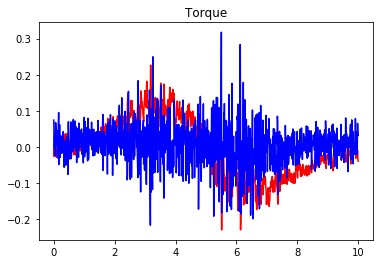

Value Loss : [ 24.76049995]
Policy Loss : [ 11.46156693]
EPISODE 496 STATE [-0.03586687  0.01224779] REWARD  [ 1.94889311] ACTION ([-0.05290788]) 1170126])        

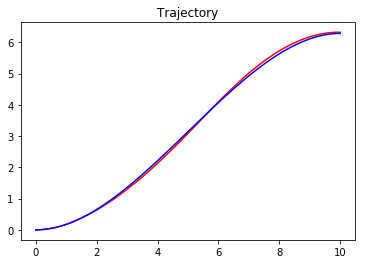

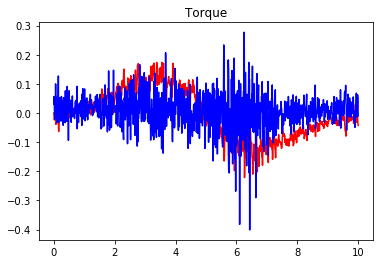

Value Loss : [ 29.78754616]
Policy Loss : [ 26.51618195]
EPISODE 497 STATE [-0.03525332  0.01980828] REWARD  [ 1.94207297] ACTION ([-0.00167158]) 0258257])          

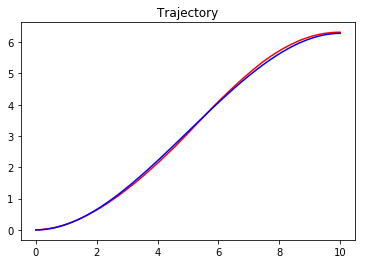

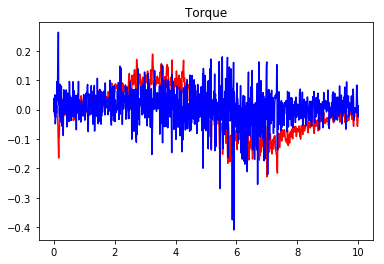

Value Loss : [ 35.68418503]
Policy Loss : [ 22.90102577]
EPISODE 498 STATE [-0.03502708  0.00981608] REWARD  [ 1.95209965] ACTION ([-0.04250042]) 8868]) ])         

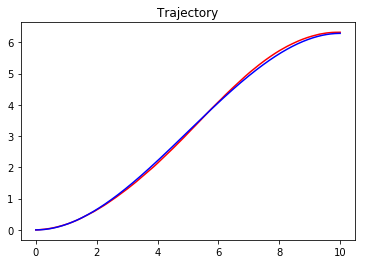

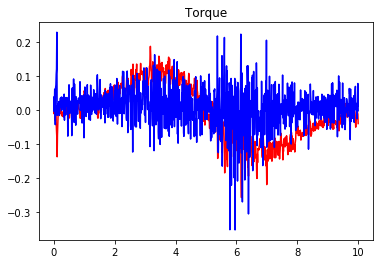

Value Loss : [ 26.70426369]
Policy Loss : [ 11.51700783]
EPISODE 499 STATE [-0.03956314  0.0082966 ] REWARD  [ 1.94922966] ACTION ([ 0.00399123]) 05]) 63])        

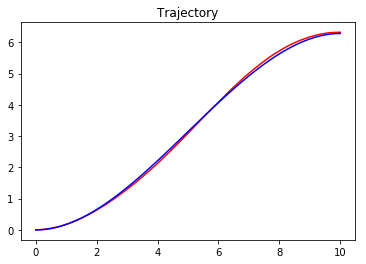

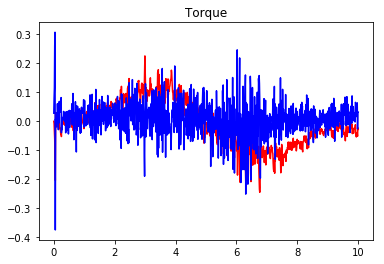

Value Loss : [ 23.33489227]
Policy Loss : [-0.38502592]
EPISODE 500 STATE [-0.03485773 -0.01365025] REWARD  [ 1.95593306] ACTION ([ 0.0089631])  7030741])         

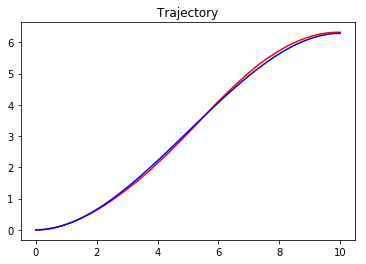

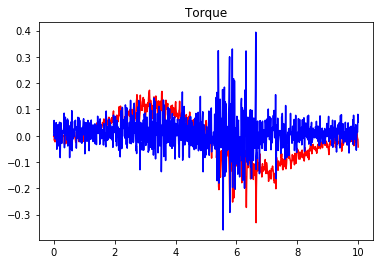

Value Loss : [ 91.40892792]
Policy Loss : [-39.21379089]


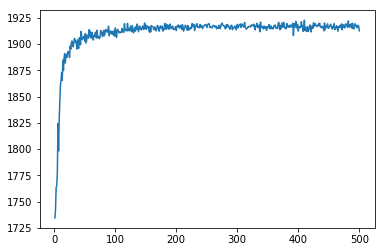

1922.56610339


In [10]:
tf.reset_default_graph()
global_step = tf.Variable(0, name="global_step", trainable=False)

q0 = q_d(0)
q_dot0 = q_d_dot(0)
Kp = 1
Kd = 1
pendolum = Robot(q0,q_dot0,Kp,Kd)
value = ValueEstimator(learning_rate=0.01)
policy = PolicyEstimator(learning_rate=0.0001)
with tf.Session() as sess:
    
    sess.run(tf.global_variables_initializer())
    
    rewards = run(Kp,Kd,pendolum,value,policy,500)
    
print(np.max(rewards))